In [1]:
import os, sys
import numpy as np
import json
import random
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import SGD, Adam
from torch.optim.lr_scheduler import StepLR
import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import time

## Setup

In [2]:
torch.manual_seed(12345)
k = 10000
device = torch.device("cuda:0" if torch.cuda.is_available() else 'cpu')
na_list = ['A', 'C', 'G', 'T'] #nucleic acids
aa_list = ['R', 'L', 'S', 'A', 'G', 'P', 'T', 'V', 'N', 'D', 'C', 'Q', 'E', 'H', 'I', 'K', 'M', 'F', 'W', 'Y'] #amino acids
hydrophobicity = {'G': 0, 'A': 41, 'L':97, 'M': 74, 'F':100, 'W':97, 'K':-23, 'Q':-10, 'E':-31, 'S':-5, 'P':-46, 'V':76, 'I':99, 'C':49, 'Y':63, 'H':8, 'R':-14, 'N':-28, 'D':-55, 'T':13}
NNK_freq = [0.09375]*3 + [0.0625]*5 + [0.03125]*13 #freq of 21 NNK codons including the stop codon
sum_20 = 0.0625*5 + 0.09375*3 + 0.03125*12 #sum of freq without the stop codon
pvals = [0.09375/sum_20]*3 + [0.0625/sum_20]*5 + [0.03125/sum_20]*12 #normalize freq for 20 codons
pvals = [0.09375/sum_20]*3 + [0.0625/sum_20]*5 + [0.03125/sum_20]*11 + \
        [1- sum([0.09375/sum_20]*3 + [0.0625/sum_20]*5 + [0.03125/sum_20]*11)] 
        #adjust sum to 1 due to numerical issue
aa_dict = dict(zip(aa_list, pvals))

## Dataset & Sampling

In [3]:
def construct_dataset():
    with open(aptamer_dataset_file, 'r') as f:
        aptamer_data = json.load(f)
    ds = []
    for aptamer in aptamer_data:
        peptides = aptamer_data[aptamer]
        for peptide in peptides:
            ds.append((aptamer, peptide))
    ds = list(set(ds)) #removed duplicates
    return ds


def construct_dataset_no_overlap():
    with open(aptamer_dataset_file, 'r') as f:
        aptamer_data = json.load(f)
    train = []
    test = []
    dictionary = {}
    i = 0
    for aptamer in aptamer_data:
        peptides = aptamer_data[aptamer]
        for peptide in peptides:
            if i < 480000:
                train.append((aptamer, peptide))
                dictionary[aptamer] = 1
                dictionary[peptide] = 1
                i += 1
            else:
                if peptide not in dictionary and aptamer not in dictionary:
                    test.append((aptamer, peptide))
    train = list(set(train)) #removed duplicates
    test = list(set(test)) #removed duplicates
    return train, test

# Sample x from P_X (assume apatamers follow uniform)
def get_x():
    x_idx = np.random.randint(0, 4, 40)
    x = ""
    for i in x_idx:
        x += na_list[i]
    return x

# Sample y from P_y (assume peptides follow NNK)
def get_y():
    y_idx = np.random.choice(20, 7, p=pvals)
    y = "M"
    for i in y_idx:
        y += aa_list[i]
    return y

# S'(train/test) contains S_train/S_test with double the size of S_train/S_test
def get_S_prime(kind="train"):
    if kind == "train":
        dset = S_train
    else:
        dset = S_test
    k = len(dset)
    S_prime_dict = dict.fromkeys(dset, 0) #indicator 0 means in S
    for _ in range(k):
        pair = (get_x(), get_y())
        S_prime_dict[pair] = 1 #indicator 1 means not in S
    S_prime = [[k,int(v)] for k,v in S_prime_dict.items()] 
    np.random.shuffle(S_prime)
    return S_prime

# S new contains unseen new examples
def get_S_new(k):
    S_new = []
    for i in range(k):
        pair = (get_x(), get_y())
        S_new.append(pair)
    np.random.shuffle(S_new)
    return S_new
    
# Returns pmf of an aptamer
def get_x_pmf():
    return 0.25**40

# Returns pmf of a peptide
def get_y_pmf(y):
    pmf = 1
    for char in y[1:]: #skips first char "M"
        pmf *= aa_dict[char]
    return pmf    

In [4]:
aptamer_dataset_file = "../data/aptamer_dataset.json"
overlap = False
if overlap:
    S = construct_dataset()
    n = len(S)
    m = int(0.8*n) #length of S_train
    S_train = S[:m]
    S_test = S[m:]
    print("Size of total samples:", n)
    print("Size of training samples:", m)
    print("Size of test samples:", n-m)
else:
    S_train, S_test = construct_dataset_no_overlap()
    S_train = S_train[:10000]
    S_test = S_test[:2000]
    n = len(S_train)+len(S_test)
    m = len(S_train)
    print("Size of total samples:", n)
    print("Size of training samples:", m)
    print("Size of test samples:", n-m)
S_prime_train = get_S_prime("train") #use for sgd 
S_prime_test = get_S_prime("test") #use for sgd 
S_new = get_S_new(10*n) #use for eval
train_ds = np.hstack((S_train, S_prime_train[:len(S_prime_train)//2]))

Size of total samples: 12000
Size of training samples: 10000
Size of test samples: 2000


## NN Model

In [5]:
class LinearNet(nn.Module):
    def __init__(self):
        super(LinearNet, self).__init__()
        self.name = "LinearNet"
        
        self.fc_apt_1 = nn.Linear(160, 200) 
        self.fc_apt_2 = nn.Linear(200, 250)
        self.fc_apt_3 = nn.Linear(250, 300)
        
        self.fc_pep_1 = nn.Linear(160, 200)
        self.fc_pep_2 = nn.Linear(200, 250)
        
        self.relu = nn.ReLU()
        
        self.fc_apt = nn.Sequential(self.fc_apt_1, self.fc_apt_2, self.fc_apt_3)
        self.fc_pep = nn.Sequential(self.fc_pep_1, self.fc_pep_2)
        
        self.fc1 = nn.Linear(550, 600)
        self.fc2 = nn.Linear(600, 1)
        
    def forward(self, apt, pep):
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        apt = self.fc_apt(apt)
        pep = self.fc_pep(pep)
        x = torch.cat((apt, pep), 1)
        x = self.fc2(self.fc1(x))
        x = torch.sigmoid(x)
        return x

In [6]:
class LinearConv1d(nn.Module):
    def __init__(self):
        super(LinearConv1d, self).__init__()
        self.name = "LinearConv1d"
        
        self.cnn_apt_1 = nn.Conv1d(4, 10, 3) 
        self.cnn_apt_2 = nn.Conv1d(10, 25, 3) 
        self.cnn_apt_3 = nn.Conv1d(25, 50, 3) 
        self.cnn_apt_4 = nn.Conv1d(50, 100, 1) 
        
        self.cnn_pep_1 = nn.Conv1d(20, 50, 3)
        self.cnn_pep_2 = nn.Conv1d(50, 100, 1)

        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool1d(2) 
        
        self.cnn_apt = nn.Sequential(self.cnn_apt_1, self.maxpool, self.relu, 
                                     self.cnn_apt_2, self.maxpool, self.relu,
                                     self.cnn_apt_3, self.maxpool, self.relu,
                                     self.cnn_apt_4, self.maxpool, self.relu)
        self.cnn_pep = nn.Sequential(self.cnn_pep_1, self.maxpool, self.relu,
                                     self.cnn_pep_2, self.maxpool, self.relu)
        
        self.fc1 = nn.Linear(200, 200)
        self.fc2 = nn.Linear(200, 1)
    
    def forward(self, apt, pep):
        apt = apt.permute(0, 2, 1)
        pep = pep.permute(0, 2, 1)
        apt = self.cnn_apt(apt)
        pep = self.cnn_pep(pep)
        #print(apt.size())
        #print(pep.size())
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        x = torch.cat((apt, pep), 1)
        x = self.fc1(x)
        x = self.fc2(x)
        x = torch.sigmoid(x)
        return x

In [7]:
class ConvNetSimple(nn.Module):
    def __init__(self):
        super(ConvNetSimple, self).__init__()
        self.name = "ConvNetSimple"
        
        self.cnn_apt_1 = nn.Conv1d(4, 25, 3) 
        self.cnn_apt_2 = nn.Conv1d(25, 50, 3)
        self.cnn_apt_3 = nn.Conv1d(50, 100, 3)
        self.cnn_apt_4 = nn.Conv1d(100, 250, 1)
        
        self.cnn_pep_1 = nn.Conv1d(20, 50, 3)
        self.cnn_pep_2 = nn.Conv1d(50, 100, 3)
        self.cnn_pep_3 = nn.Conv1d(100, 250, 1)
       
        self.relu = nn.ReLU()
        self.pool1 = nn.MaxPool1d(2)         
        self.fc1 = nn.Linear(500, 550)
        self.fc2 = nn.Linear(550, 600)
        self.fc3 = nn.Linear(600, 1)
        
    def forward(self, apt, pep):
        # apt input size [1, 40, 4]
        apt = apt.permute(0, 2, 1)
        
        apt = self.pool1(self.relu(self.cnn_apt_1(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_2(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_3(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_4(apt)))
        
        # pep input size [1, 8, 20]
        pep = pep.permute(0, 2, 1)

        pep = self.relu(self.cnn_pep_1(pep))
        pep = self.pool1(self.relu(self.cnn_pep_2(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_3(pep)))
    
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        
        x = torch.cat((apt, pep), 1)
        x = self.fc3(self.fc2(self.fc1(x)))
        x = torch.sigmoid(x)
        return x

In [8]:
class ConvNetSimpleBoost(nn.Module):
    def __init__(self):
        super(ConvNetSimpleBoost, self).__init__()
        self.name = "ConvNetSimpleBoost"
        
        self.cnn_apt_1 = nn.Conv1d(4, 100, 3) 
        self.cnn_apt_2 = nn.Conv1d(100, 200, 3)
        self.cnn_apt_3 = nn.Conv1d(200, 250, 3)
        self.cnn_apt_4 = nn.Conv1d(250, 300, 1)
        
        self.cnn_pep_1 = nn.Conv1d(20, 100, 3)
        self.cnn_pep_2 = nn.Conv1d(100, 200, 3)
        self.cnn_pep_3 = nn.Conv1d(200, 250, 1)
       
        self.relu = nn.ReLU()
        self.pool1 = nn.MaxPool1d(2)         
        self.fc1 = nn.Linear(550, 600)
        self.fc2 = nn.Linear(600, 1)
        
    def forward(self, apt, pep):
        # apt input size [1, 40, 4]
        apt = apt.permute(0, 2, 1)
        
        apt = self.pool1(self.relu(self.cnn_apt_1(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_2(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_3(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_4(apt)))
        
        # pep input size [1, 8, 20]
        pep = pep.permute(0, 2, 1)

        pep = self.relu(self.cnn_pep_1(pep))
        pep = self.pool1(self.relu(self.cnn_pep_2(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_3(pep)))
    
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        
        x = torch.cat((apt, pep), 1)
        x = self.fc2(self.fc1(x))
        x = torch.sigmoid(x)
        return x

In [9]:
class ConvNetComplex(nn.Module):
    def __init__(self):
        super(ConvNetComplex, self).__init__()
        self.name = "ConvNetComplex"
        
        self.cnn_apt_1 = nn.Conv1d(4, 25, 3) 
        self.cnn_apt_2 = nn.Conv1d(25, 50, 3)
        self.cnn_apt_3 = nn.Conv1d(50, 100, 3)
        self.cnn_apt_4 = nn.Conv1d(100, 200, 3)
        self.cnn_apt_5 = nn.Conv1d(200, 400, 1)
        self.cnn_apt_6 = nn.Conv1d(400, 800, 1)
        
        self.cnn_pep_1 = nn.Conv1d(20, 50, 3)
        self.cnn_pep_2 = nn.Conv1d(50, 100, 1)
        self.cnn_pep_3 = nn.Conv1d(100, 200, 1)
        self.cnn_pep_4 = nn.Conv1d(200, 400, 1)
        self.cnn_pep_5 = nn.Conv1d(400, 800, 1)
        
        self.relu = nn.ReLU()
        self.pool1 = nn.MaxPool1d(2)         
        self.fc1 = nn.Linear(1600, 1800)
        self.fc2 = nn.Linear(1800, 1)
        
    def forward(self, apt, pep):
        # apt input size [1, 40, 4]
        apt = apt.permute(0, 2, 1)
        
        apt = self.relu(self.cnn_apt_1(apt))
        apt = self.relu(self.cnn_apt_2(apt))
        apt = self.pool1(self.relu(self.cnn_apt_3(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_4(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_5(apt)))        
        apt = self.pool1(self.relu(self.cnn_apt_6(apt)))        

        # pep input size [1, 8, 20]
        pep = pep.permute(0, 2, 1)
        
        pep = self.relu(self.cnn_pep_1(pep))
        pep = self.relu(self.cnn_pep_2(pep))
        pep = self.relu(self.cnn_pep_3(pep))
        pep = self.pool1(self.relu(self.cnn_pep_4(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_5(pep)))
        
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        
        x = torch.cat((apt, pep), 1)
        x = self.fc2(self.fc1(x))
        x = torch.sigmoid(x)
        return x

In [10]:
class VariedChannelsNet(nn.Module):
    def __init__(self):
        super(VariedChannelsNet, self).__init__()
        self.name = "VariedChannelsNet"
        
        self.cnn_apt_1 = nn.Conv1d(4, 1000, 3, padding=2) 
        self.cnn_apt_2 = nn.Conv1d(1000, 800, 3, padding=2)
        self.cnn_apt_3 = nn.Conv1d(800, 600, 3, padding=2)
        self.cnn_apt_4 = nn.Conv1d(600, 400, 3, padding=2)
        self.cnn_apt_5 = nn.Conv1d(400, 200, 3, padding=2)
        self.cnn_apt_6 = nn.Conv1d(200, 100, 3, padding=2)
        
        self.cnn_pep_1 = nn.Conv1d(20, 500, 3, padding=2)
        self.cnn_pep_2 = nn.Conv1d(500, 450, 3, padding=2)
        self.cnn_pep_3 = nn.Conv1d(450, 400, 3, padding=2)
        self.cnn_pep_4 = nn.Conv1d(400, 350, 3, padding=2)
        self.cnn_pep_5 = nn.Conv1d(350, 250, 3, padding=2)
        self.cnn_pep_6 = nn.Conv1d(250, 200, 3, padding=2)
        
        self.relu = nn.ReLU()
        self.pool1 = nn.MaxPool1d(2)         
        self.fc1 = nn.Linear(600, 1)
        
    def forward(self, apt, pep):
        # apt input size [1, 40, 4]
        apt = apt.permute(0, 2, 1)
        
        apt = self.pool1(self.relu(self.cnn_apt_1(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_2(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_3(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_4(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_5(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_6(apt)))

        # pep input size [1, 8, 20]
        pep = pep.permute(0, 2, 1)
        
        pep = self.pool1(self.relu(self.cnn_pep_1(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_2(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_3(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_4(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_5(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_6(pep)))
        
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        
        x = torch.cat((apt, pep), 1)
        x = self.fc1(x)
        x = torch.sigmoid(x)
        return x

In [11]:
class MinimizedVCNet(nn.Module):
    def __init__(self):
        super(MinimizedVCNet, self).__init__()
        self.name = "MinimizedVCNet"
        
        self.cnn_apt_1 = nn.Conv1d(4, 1000, 3, padding=2) 
        self.cnn_apt_2 = nn.Conv1d(1000, 500, 3, padding=2)
        self.cnn_apt_3 = nn.Conv1d(500, 100, 3, padding=2)
        
        self.cnn_pep_1 = nn.Conv1d(20, 500, 3, padding=2)
        self.cnn_pep_2 = nn.Conv1d(500, 250, 3, padding=2)
        self.cnn_pep_3 = nn.Conv1d(250, 100, 3, padding=2)

        
        self.relu = nn.ReLU()
        self.pool1 = nn.MaxPool1d(2)         
        self.fc1 = nn.Linear(800, 1)
        
    def forward(self, apt, pep):
        # apt input size [1, 40, 4]
        apt = apt.permute(0, 2, 1)
        
        apt = self.pool1(self.relu(self.cnn_apt_1(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_2(apt)))
        apt = self.pool1(self.relu(self.cnn_apt_3(apt)))

        # pep input size [1, 8, 20]
        pep = pep.permute(0, 2, 1)
        
        pep = self.pool1(self.relu(self.cnn_pep_1(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_2(pep)))
        pep = self.pool1(self.relu(self.cnn_pep_3(pep)))
        
        apt = apt.view(-1, 1).T
        pep = pep.view(-1, 1).T
        
        x = torch.cat((apt, pep), 1)
        x = self.fc1(x)
        x = torch.sigmoid(x)
        return x

In [12]:
def weights_init(m):
    if isinstance(m, nn.Conv2d):
        nn.init.xavier_uniform_(m.weight.data, gain=nn.init.calculate_gain('relu'))
        nn.init.zeros_(m.bias.data)
    if isinstance(m, nn.Linear):
        nn.init.kaiming_normal_(m.weight.data, nonlinearity='sigmoid')
        nn.init.zeros_(m.bias.data)

In [13]:
## Testing NN models
# model = ConvNetComplex()
# model.apply(weights_init)
# model.to(device)
# aptamer, peptide, (apt_prime, pep_prime), indicator = train_ds[0]
# a, p = convert(aptamer, peptide)
# output = model(a, p)
# print(output)

## Helper methods

In [14]:
## Takes a peptide and aptamer sequence and converts to one-hot matrix
def one_hot(sequence, seq_type='peptide'):
    if seq_type == 'peptide':
        letters = aa_list
    else:
        letters = na_list
    one_hot = np.zeros((len(sequence), len(letters)))
    for i in range(len(sequence)):
        char = sequence[i]
        for _ in range(len(letters)):
            idx = letters.index(char)
            one_hot[i][idx] = 1
    return one_hot

# Convert a pair to one-hot tensor
def convert(apt, pep): 
    apt = one_hot(apt, seq_type='aptamer') #(40, 4)
    pep = one_hot(pep, seq_type='peptide') #(8, 20)
    apt = torch.FloatTensor(np.reshape(apt, (-1, apt.shape[0], apt.shape[1]))).to(device) #(1, 40, 4)
    pep = torch.FloatTensor(np.reshape(pep, (-1, pep.shape[0], pep.shape[1]))).to(device) #(1, 8, 20)
    return apt, pep

# Getting the output of the model for a pair (aptamer, peptide)
def update(x, y):
    x.requires_grad=True
    y.requires_grad=True
    x = x.to(device)
    y = y.to(device)
    out = model(x, y)
    return out

# Generates the samples used to calculate loss
def loss_samples(k, ds='train'): # S_train/S_test
    if ds == 'train':
        dset = S_train
    else:
        dset = S_test
    pairs = []
    for (apt, pep) in dset[:k]:
        x, y = convert(apt, pep)
        pairs.append((x, y))
    return pairs

# Generates the samples used to calculate loss from S_prime_train/S_prime_test
def prime_loss_samples(k, ds='train'): # S_prime_train/S_prime_test
    if ds == "train":
        dset = S_prime_train[len(S_prime_train)//2:]    
    else:
        dset = S_prime_test[len(S_prime_test)//2:]
    pairs = []
    for (apt, pep), ind in dset[:k]:
        pmf = get_y_pmf(pep)
        x, y = convert(apt, pep)
        pairs.append((x, y, ind, pmf))
    return pairs

# First term of the loss
def get_log_out(dataset='train'):
    outs = []
    if dataset == 'train':
        dset = train_loss_samples
    else:
        dset = test_loss_samples
    for (apt, pep) in dset:
        out = update(apt, pep)
        outs.append(torch.log(out).cpu().detach().numpy().flatten()[0])
    return np.average(outs)

# Second term of loss
def get_out_prime(ds="train"):
    outs = []
    if ds == "train":
        dset = prime_train_loss_samples
        leng = m
    else:
        dset = prime_test_loss_samples
        leng = n-m
    for (apt, pep, ind, pmf) in dset:
        x = apt.to(device)
        y = pep.to(device)
        out = model(x, y)
        if ind == 0:
            factor = (2*leng*get_x_pmf()*pmf)/(1+leng*get_x_pmf()*pmf)
        else:
            factor = 2
        out_is = out.cpu().detach().numpy().flatten()[0] * factor
        outs.append(out_is)
    return np.average(outs)

## Plotting functions

def plot_train_loss(train_loss, iters, epoch, lamb, gamma, model_name):
    plt.plot(train_loss, 'b', label='Train loss')
    plt.ylabel("Train loss")
    plt.xlabel("%d number of samples" %iters)
    plt.title("Train loss at epoch %d," %epoch + " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/train_loss_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()

def plot_test_loss(test_loss, iters, epoch, lamb, gamma, model_name):
    plt.plot(test_loss, 'y', label='Test loss')
    plt.ylabel("Test loss")
    plt.xlabel("%d number of samples" %iters)
    plt.title("Test loss at epoch %d," %epoch + " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/test_loss_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    

def plot_recall(train_recall, test_recall, iters, epoch, lamb, gamma, model_name):
    plt.plot(train_recall, 'b', label='Train recall')
    plt.plot(test_recall, 'y', label='Test recall')
    plt.ylabel("Recall (%)")
    plt.xlabel("%d number of samples" %iters)
    plt.title("Recall at epoch %d," %epoch + " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/recall_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    
    
    
def plot_fp(fp, iters, epoch, lamb, gamma, model_name):
    plt.plot(fp, 'y', label='FPR')
    plt.ylabel("False positive rate (%)")
    plt.xlabel("%d number of samples" %iters)
    plt.title("False positive rate at epoch %d," %epoch + " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/fp_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    

def plot_ecdf_test(test_score, iters, epoch, lamb, gamma, model_name):
    test_idx = np.argsort(test_score)
    test_id = test_idx >= 4000
    test = np.sort(test_score)
    test_c = ""
    for m in test_id:
        if m:
            test_c += "g"
        else:
            test_c += "y"
    s = test_score.size
    y = np.arange(1, s+1) / s
    plt.scatter(y, test, c=test_c, label='Test CDF')
    plt.ylabel("CDF")
    plt.xlabel("Most recent 5000 samples after training %d samples" %iters)
    plt.title('Test CDF at epoch %d' %epoch+ " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/test_cdf_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    

def plot_ecdf_train(train_score, iters, epoch, lamb, gamma, model_name):
    train_idx = np.argsort(train_score)
    train_id = train_idx >= 4000
    train = np.sort(train_score)
    train_c = "" #colors
    for l in train_id:
        if l:
            train_c += "r"
        else:
            train_c += "b"
    s = train_score.size
    y = np.arange(1, s+1) / s
    plt.scatter(y, train, c=train_c, label='Train CDF')
    plt.ylabel("CDF")
    plt.xlabel("Most recent 5000 samples after training %d samples" %iters)
    plt.title('Train CDF at epoch %d' %epoch+ " Lambda :%.5f" %lamb + ", Gamma:%.5f" %gamma)
    plt.legend()
    plt.savefig('plots/mle/%s/train_cdf_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    

def histogram(eval_scores, train_scores, test_scores, model_name):
    fig, ax = plt.subplots()
    plt.xlim(0, 1.1)
    sns.distplot(eval_scores , color="skyblue", label='New: not in dataset', ax=ax)
    sns.distplot(train_scores , color="gold", label='Train: in dataset', ax=ax)
    sns.distplot(test_scores, color='red', label='Test: in dataset', ax=ax)
    ax.set_title("Distribution of Scores")
    ax.figure.set_size_inches(7, 4)
    ax.legend()
    plt.savefig('plots/mle/%s/histogram_%s.png' %(model_name, time.strftime("%m%d_%H%M")), bbox_inches='tight')
    plt.show()
    plt.close()
    

In [15]:
train_loss_samples = loss_samples(k, 'train')
test_loss_samples = loss_samples(k, 'test')
prime_train_loss_samples = prime_loss_samples(k, 'train')
prime_test_loss_samples = prime_loss_samples(k, 'test')

## SGD

In [16]:
'''
lamb = hyperparameter
gamma = step size
run_from_checkpoint = path to a checkpointed model
save_checkpoings = file name
'''
def sgd(num_epochs=50,
        batch_size=64,
        l=3, #lambda
        gamma=1e-2, #starting lr
        run_from_checkpoint=None, 
        save_checkpoints=None): 
    
    init_epoch = 0
    
    if run_from_checkpoint is not None:
        checkpointed_model = run_from_checkpoint
        checkpoint = torch.load(checkpointed_model)
        model.load_state_dict(checkpoint['model_state_dict'])
        optim = SGD(model.parameters(), lr=gamma)
        optim.load_state_dict(checkpoint['optimizer_state_dict'])
        init_epoch = checkpoint['epoch']
        print("Reloading model: ", model_name, " at epoch: ", init_epoch)
    else:
        model.apply(weights_init)
        optim = SGD(model.parameters(), lr=gamma)
        
    total_epochs = init_epoch
    train_losses, train_recalls, train_outputs = [], [], []
    test_losses, test_recalls, test_outputs = [], [], []
    fp_rates, new_outputs = [], []
    train_correct, test_correct, new_wrong = 0, 0, 0
    iters = 0
    model_name = model.name
    scheduler = StepLR(optim, step_size=1, gamma=0.9) #Decays lr by gamma factor every step_size epochs. 
    
    for epoch in range(init_epoch, num_epochs+init_epoch):
        scheduler.step()
        curr_g = scheduler.get_lr()[0]
        print("Training Epoch: ", total_epochs, " with learning rate: ", curr_g)
        total_train_loss = 0
        for i, (aptamer, peptide, (apt_prime, pep_prime), indicator) in enumerate(tqdm.tqdm(train_ds)):
            iters += 1
            
            model.train()
            
            optim.zero_grad() 
            x, y = convert(aptamer, peptide) #sample x,y from S_train
            out = update(x, y) #get S_train output/score
            log_out = torch.log(out) 
            train_score = out.cpu().detach().numpy().flatten()[0] 
            if train_score > 0.5:
                train_correct += 1 
            train_outputs.append(train_score) 
            train_outputs = train_outputs[-1000:]

            optim.zero_grad() 
            y_pmf = get_y_pmf(pep_prime)
            x_prime, y_prime = convert(apt_prime, pep_prime) #sample x', y' from S_prime_train
            out_prime = update(x_prime, y_prime) #get score from S_prime_train
            if indicator == 0:
                factor = (2*m*get_x_pmf()*y_pmf)/(1+m*get_x_pmf()*y_pmf)
            else:
                factor = 2
            out_prime = out_prime*factor #adjust for IS
            
            total_train_loss += l*indicator*out_prime - log_out
            if i % batch_size == 0:
                (total_train_loss/batch_size).backward() 
                optim.step()
                total_train_loss = 0

            with torch.no_grad():
                model.eval()

                x_test, y_test = convert(S_test[i%(n-m)][0], S_test[i%(n-m)][1]) #sample x,y from test set
                test_score = model(x_test, y_test).cpu().detach().numpy().flatten()[0]
                if test_score > 0.5:
                    test_correct += 1 
                test_outputs.append(test_score) 
                test_outputs = test_outputs[-1000:] 

                #generate 10 unseen examples from S_new as compared 1 example from S_train/S_test for cdfs
                for x, y in S_new[10*i:10*(i+1)]:
                    x_new, y_new = convert(x, y) #generate unseen x'' and y'' from S_new
                    new_score = model(x_new, y_new).cpu().detach().numpy().flatten()[0] #get unknown score
                    if new_score > 0.5:
                        new_wrong += 1
                    new_outputs.append(new_score)
                    new_outputs = new_outputs[-4000:]
                if i % 100 == 0:
                    train_loss = l*get_out_prime("train") - get_log_out('train') #training loss
                    test_loss = l*get_out_prime("test") - get_log_out('test') #test loss
                    train_losses.append(train_loss)
                    test_losses.append(test_loss)
                    train_recall = 100*train_correct/iters #training recall
                    train_recalls.append(train_recall) 
                    test_recall = 100*test_correct/iters #test recall
                    test_recalls.append(test_recall)
                    fp = 10*new_wrong/iters #false positive rate
                    fp_rates.append(fp)
                    train_score = np.asarray(new_outputs + train_outputs) #combine train and unknown scores
                    test_score = np.asarray(new_outputs + test_outputs) #combibne test and unknown scores

                if i % 2000 == 0:
                    plot_recall(train_recalls, test_recalls, iters, total_epochs, l, curr_g, model_name)
                    plot_fp(fp_rates, 10*iters, total_epochs, l, curr_g, model_name)
                    plot_train_loss(train_losses, iters, total_epochs, l, curr_g, model_name)
                    plot_test_loss(test_losses, iters, total_epochs, l, curr_g, model_name)
                    plot_ecdf_train(train_score, iters, total_epochs, l, curr_g, model_name)
                    plot_ecdf_test(test_score, iters, total_epochs, l, curr_g, model_name)
                    histogram(new_outputs[-1000:], train_outputs, test_outputs, model_name)
                    print("New score: ", np.average(new_outputs[-500:]))
                    print("Train score: ", np.average(train_score[-500:]))
                    print("Test score: ", np.average(test_score[-500:]))

        # Save after every epoch
        total_epochs += 1
        if save_checkpoints is not None:
            print("Saving to: ", save_checkpoints)
            checkpoint_name = save_checkpoints
            torch.save({'epoch': total_epochs,
                        'model_state_dict': model.state_dict(), 
                        'optimizer_state_dict': optim.state_dict()}, checkpoint_name)


## Hyperparameter tuning

In [21]:
NUM_EPOCHS = 50
BATCH_SIZE = 64
LAMBDA = 2
GAMMA = 5e-2

/home/yuhaowan/anaconda3/lib/python3.7/site-packages/torch/optim/lr_scheduler.py:122: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
  0%|          | 0/10000 [00:00<?, ?it/s]

Training Epoch:  0  with learning rate:  0.04050000000000001


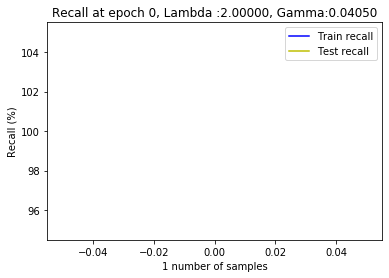

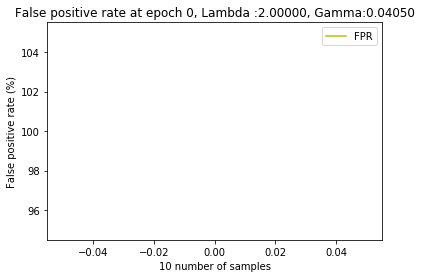

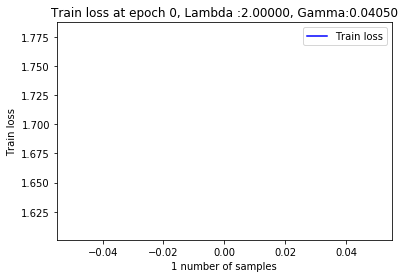

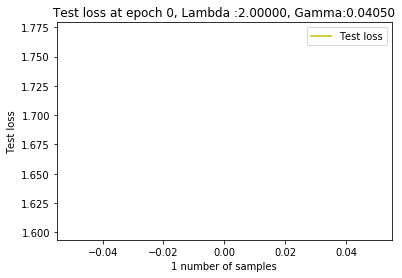

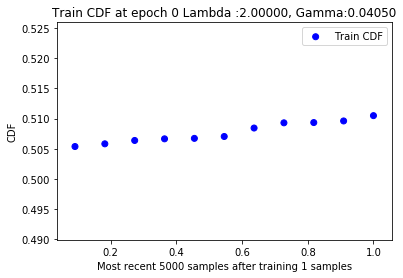

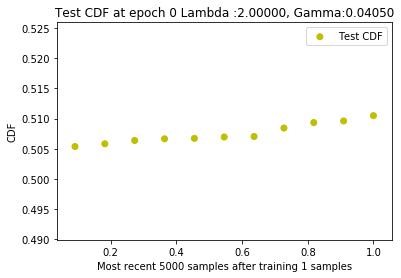

/home/yuhaowan/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:217: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/home/yuhaowan/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:209: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


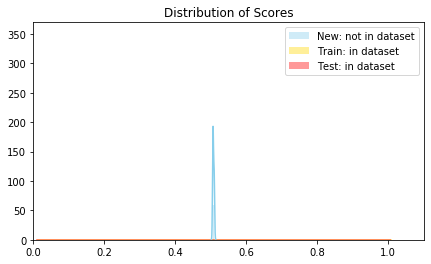

  0%|          | 5/10000 [00:43<84:29:51, 30.43s/it] 

New score:  0.5075816
Train score:  0.5077372
Test score:  0.5075238


 20%|█▉        | 1997/10000 [15:10<05:08, 25.95it/s]   

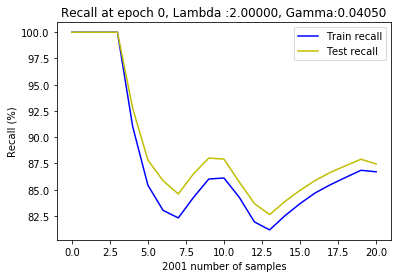

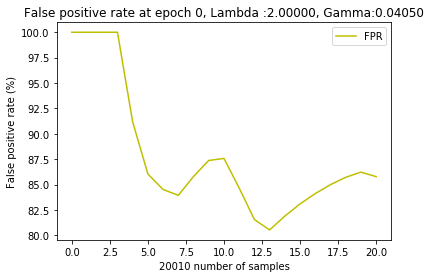

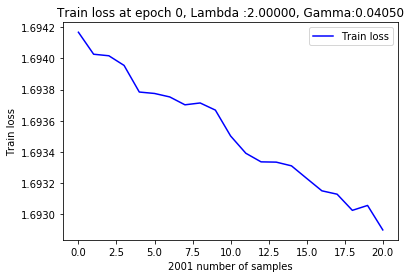

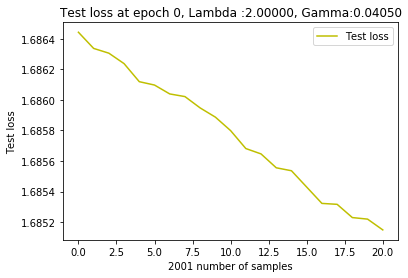

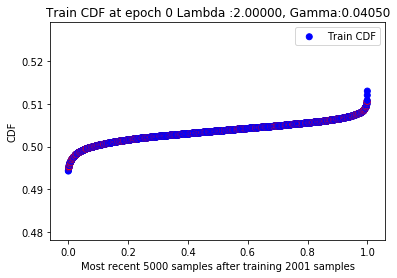

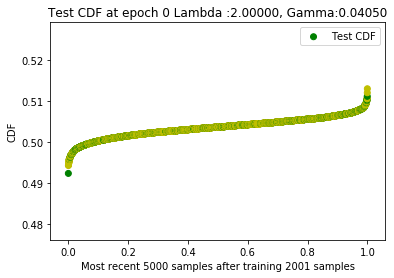

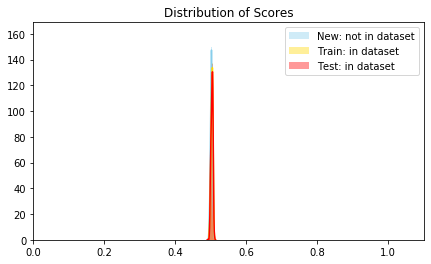

 20%|██        | 2005/10000 [15:33<5:06:33,  2.30s/it]

New score:  0.5007525
Train score:  0.5040995
Test score:  0.5042773


 40%|███▉      | 3998/10000 [30:40<04:27, 22.43it/s]   

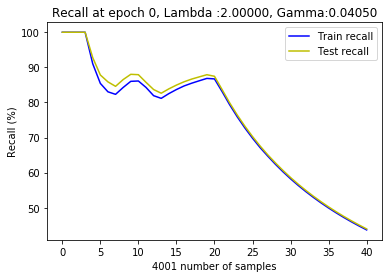

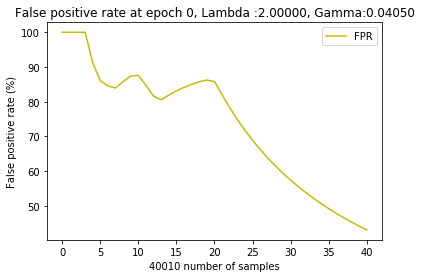

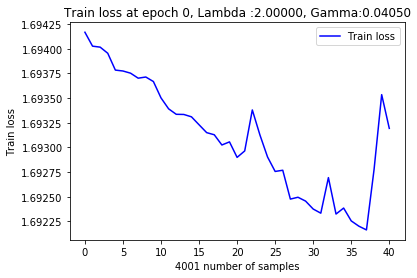

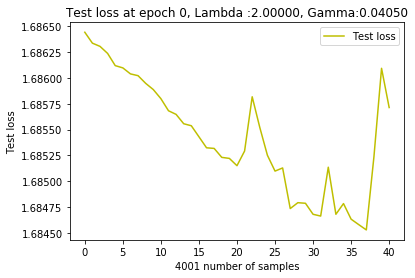

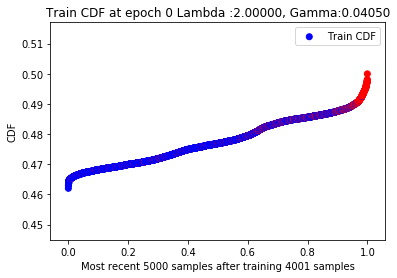

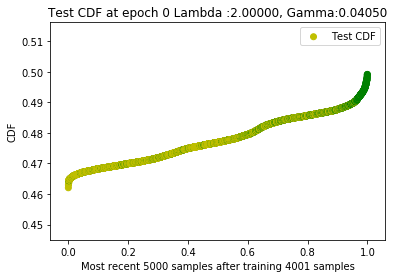

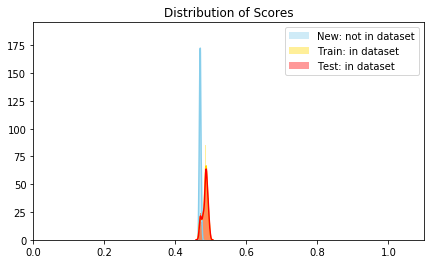

 40%|████      | 4004/10000 [31:12<5:33:13,  3.33s/it]

New score:  0.47028786
Train score:  0.47901502
Test score:  0.47928348


 60%|█████▉    | 5999/10000 [46:40<02:50, 23.45it/s]   

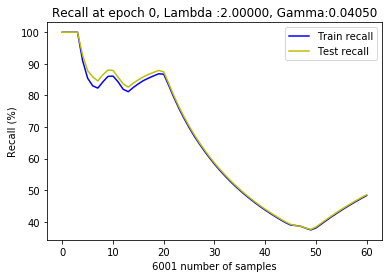

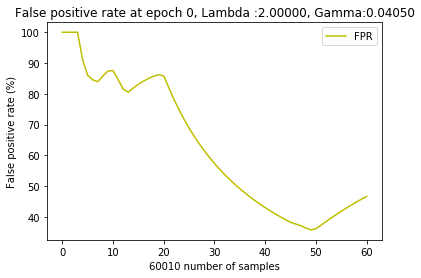

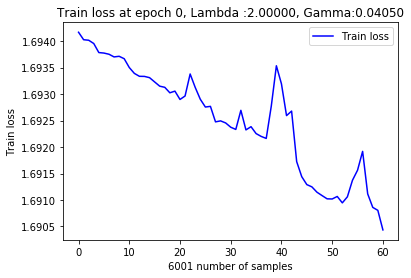

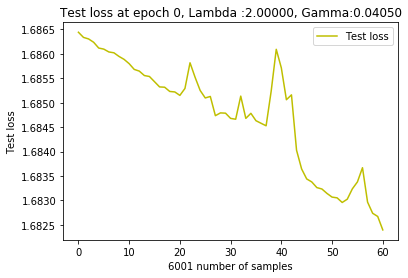

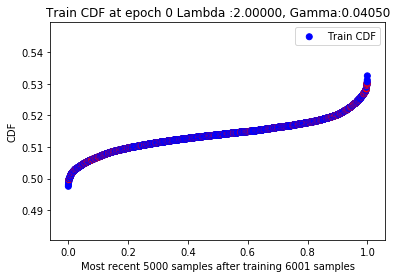

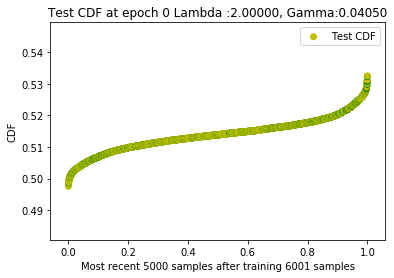

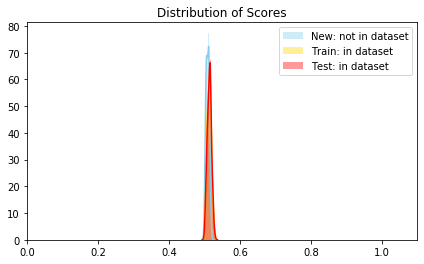

 60%|██████    | 6004/10000 [47:11<5:42:26,  5.14s/it]

New score:  0.5055306
Train score:  0.5161156
Test score:  0.51630396


 80%|███████▉  | 7998/10000 [1:02:00<01:20, 24.85it/s]  

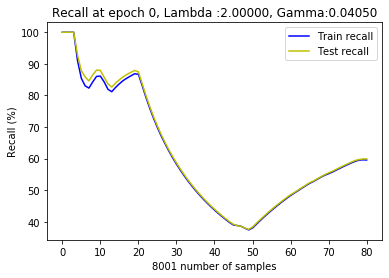

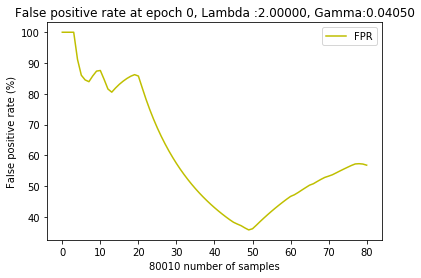

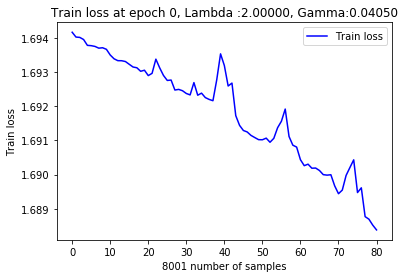

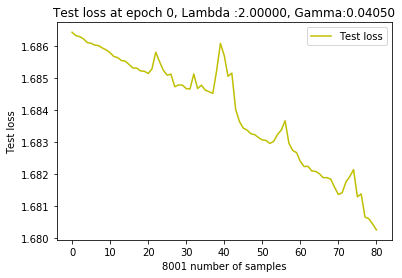

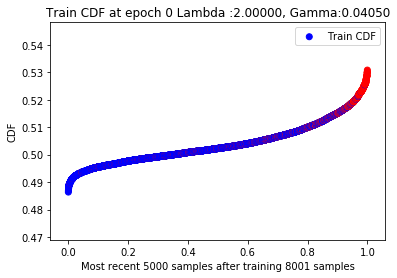

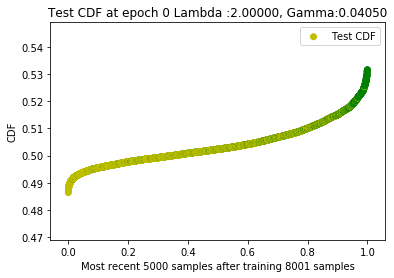

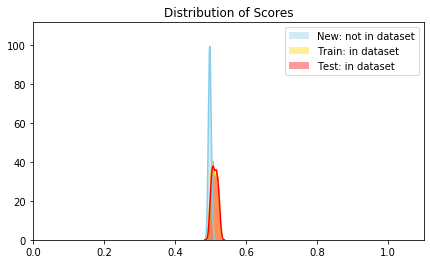

 80%|████████  | 8005/10000 [1:02:26<1:43:24,  3.11s/it]

New score:  0.49825287
Train score:  0.5070182
Test score:  0.5072227


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  1  with learning rate:  0.03645000000000001


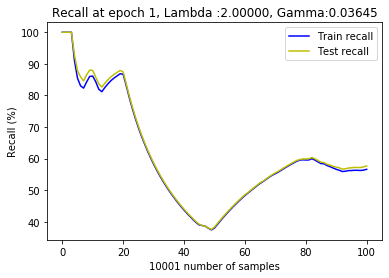

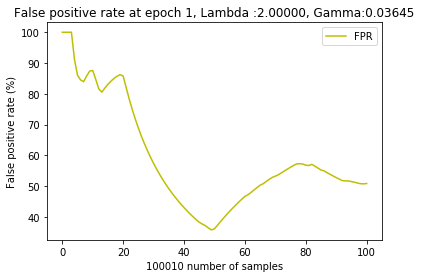

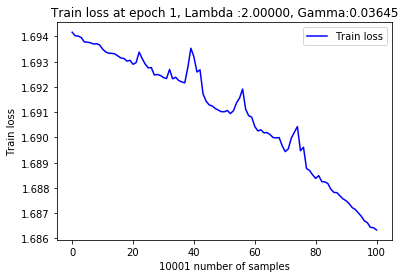

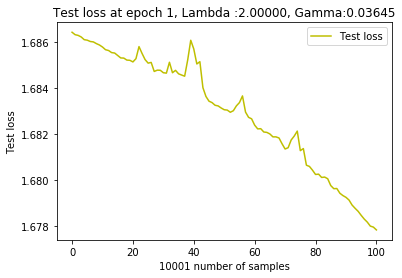

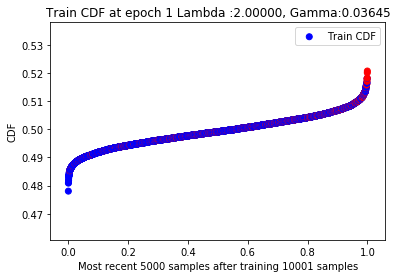

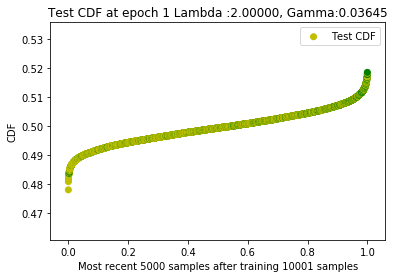

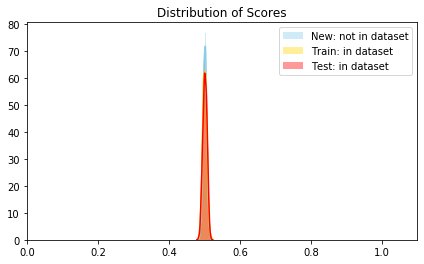

  0%|          | 5/10000 [00:43<85:15:26, 30.71s/it] 

New score:  0.50175554
Train score:  0.5023331
Test score:  0.5027309


 20%|█▉        | 1998/10000 [15:10<06:48, 19.58it/s]   

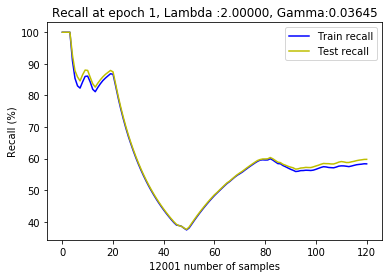

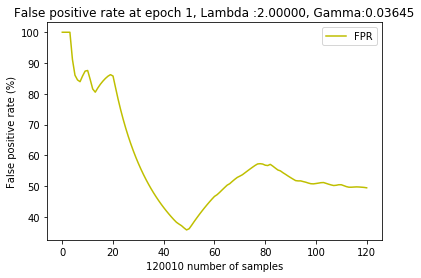

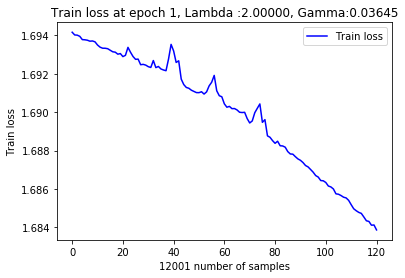

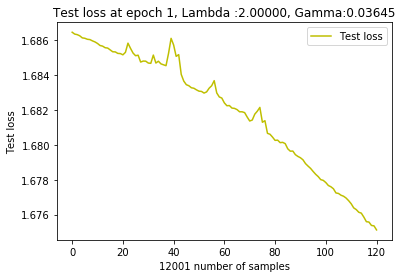

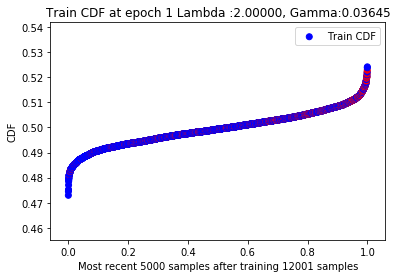

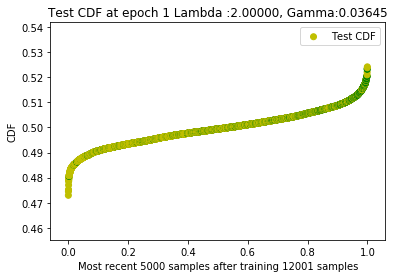

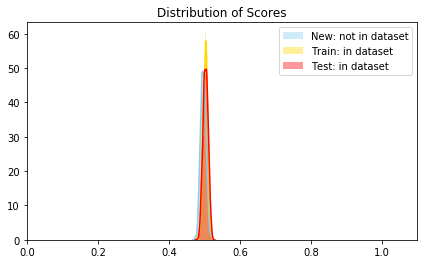

 20%|██        | 2005/10000 [15:42<7:03:14,  3.18s/it] 

New score:  0.49514905
Train score:  0.5036145
Test score:  0.5044587


 40%|███▉      | 3998/10000 [30:40<03:13, 30.96it/s]   

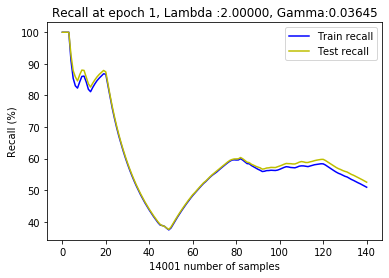

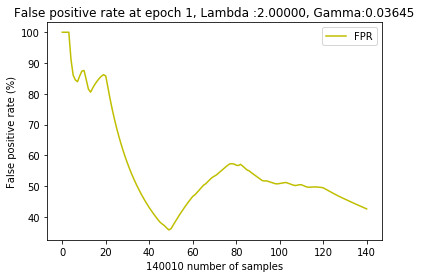

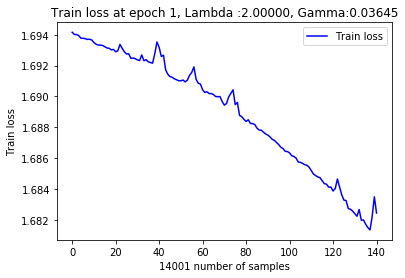

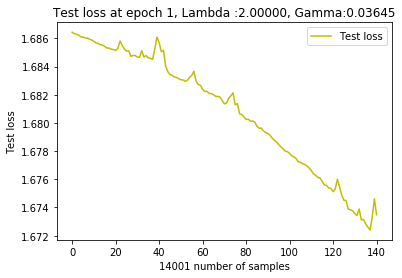

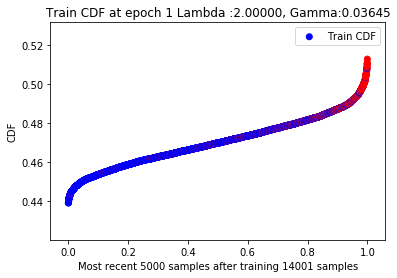

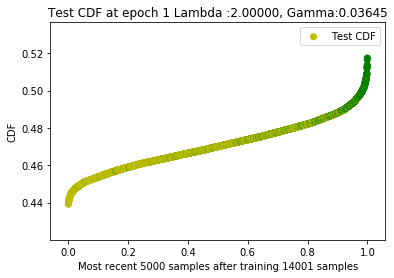

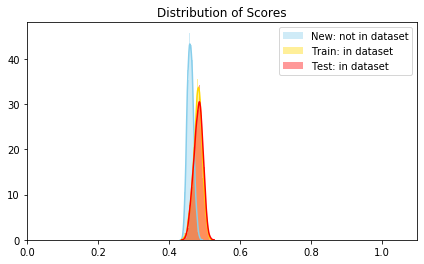

 40%|████      | 4004/10000 [31:09<5:20:35,  3.21s/it]

New score:  0.461411
Train score:  0.47611353
Test score:  0.4775085


 60%|█████▉    | 5997/10000 [46:40<02:09, 30.98it/s]   

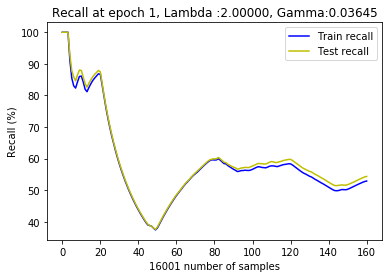

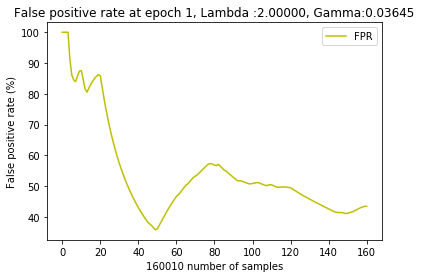

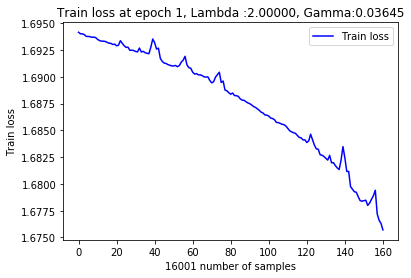

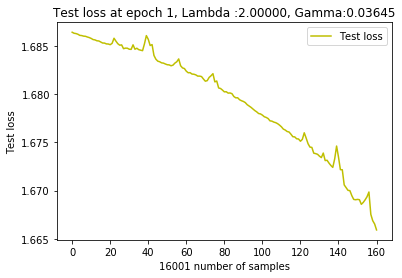

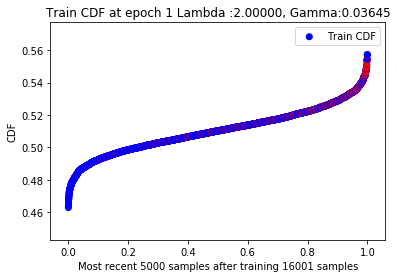

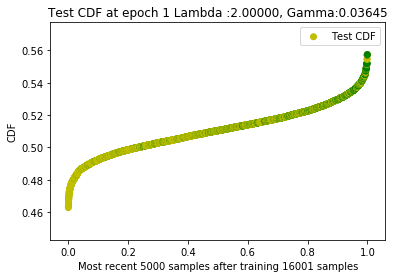

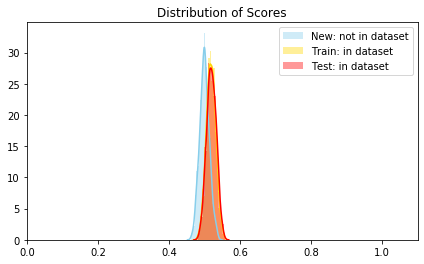

 60%|██████    | 6005/10000 [47:10<2:34:25,  2.32s/it]

New score:  0.49427274
Train score:  0.51860607
Test score:  0.5199328


 80%|███████▉  | 7998/10000 [1:01:30<01:03, 31.38it/s]  

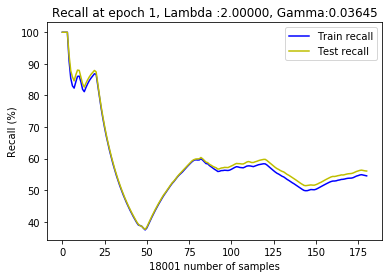

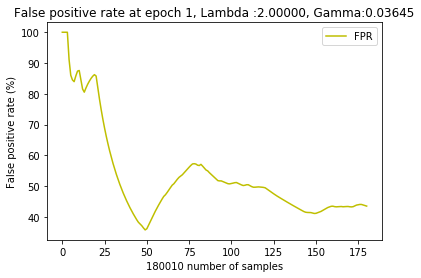

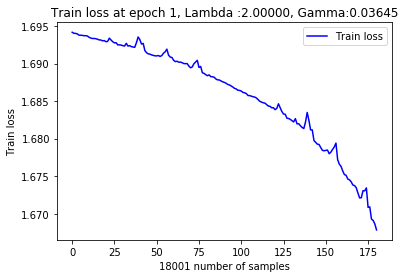

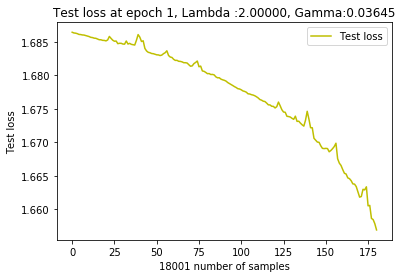

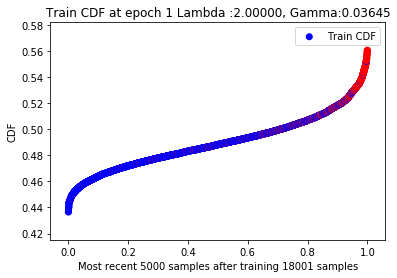

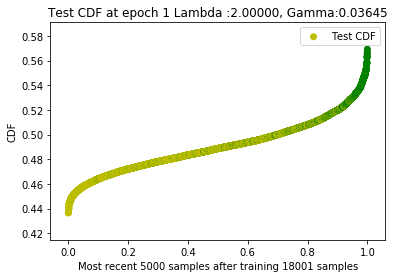

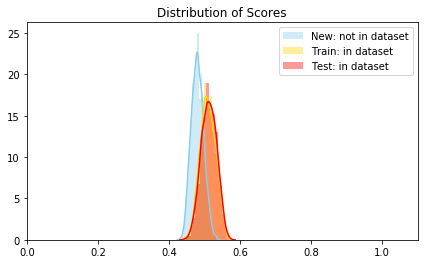

 80%|████████  | 8005/10000 [1:01:56<1:42:53,  3.09s/it]

New score:  0.48216397
Train score:  0.5015189
Test score:  0.5035715


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  2  with learning rate:  0.03280500000000001


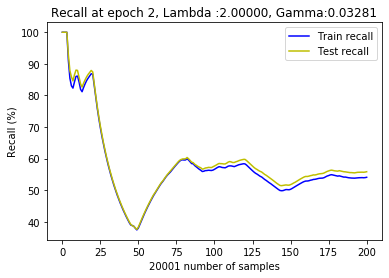

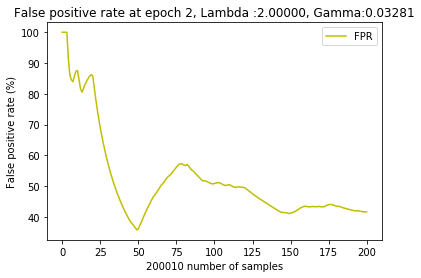

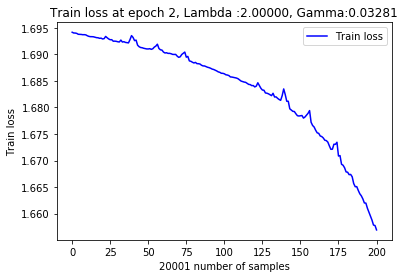

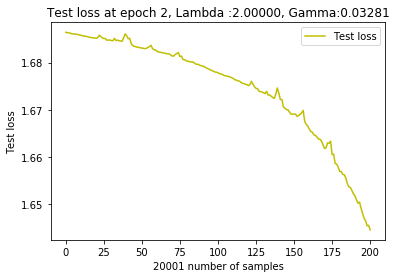

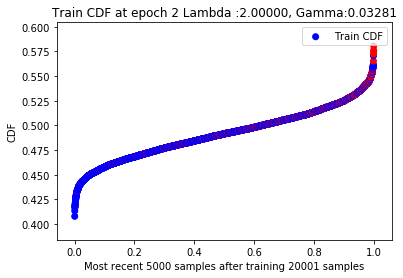

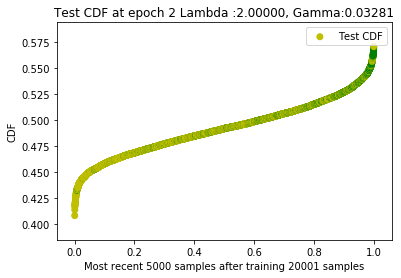

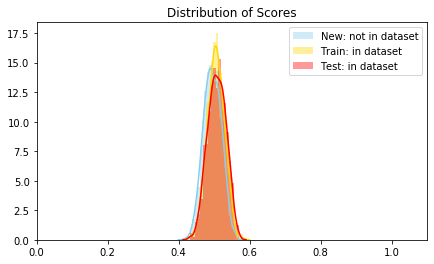

  0%|          | 5/10000 [00:43<84:47:55, 30.54s/it] 

New score:  0.49392164
Train score:  0.50564724
Test score:  0.50859964


 20%|█▉        | 1998/10000 [15:10<05:02, 26.43it/s]   

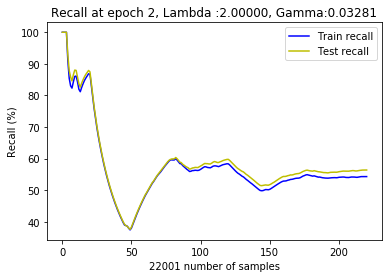

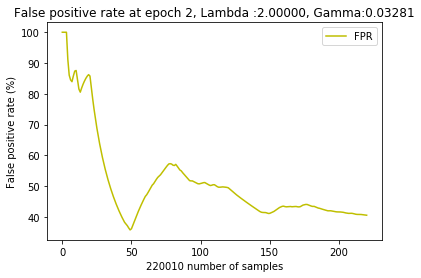

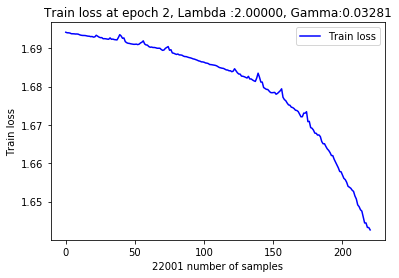

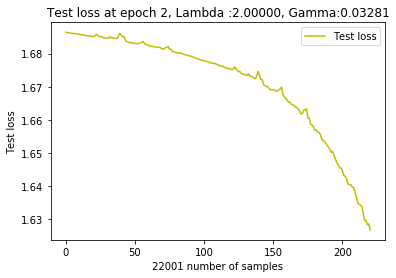

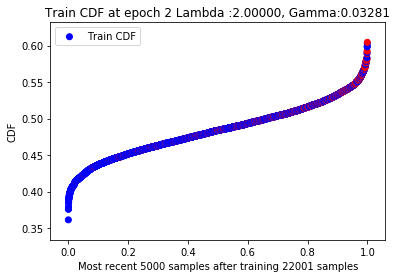

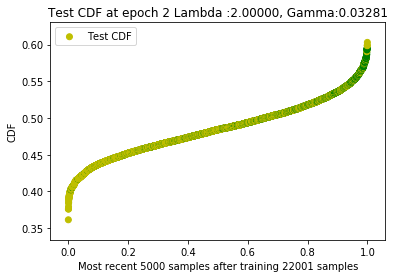

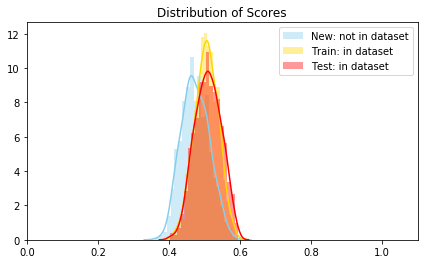

 20%|██        | 2005/10000 [15:35<6:49:32,  3.07s/it]

New score:  0.46868575
Train score:  0.50579756
Test score:  0.5110522


 60%|█████▉    | 5999/10000 [44:50<02:04, 32.12it/s]   

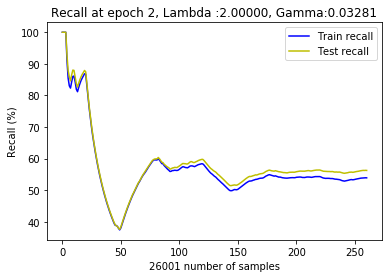

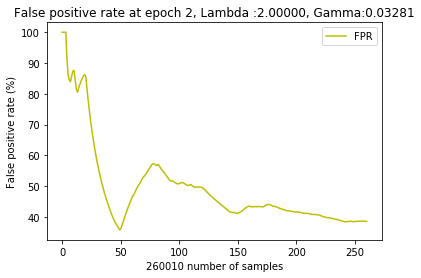

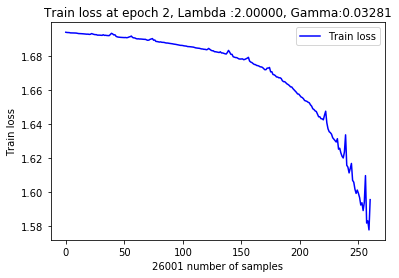

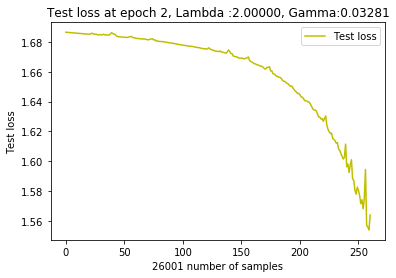

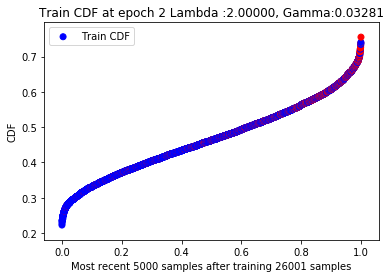

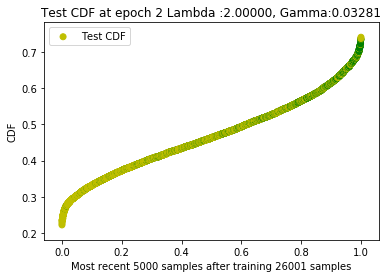

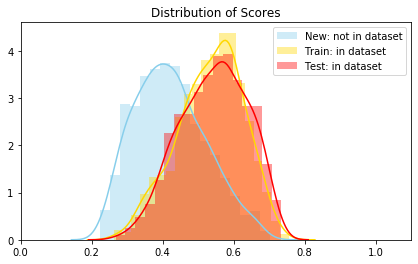

 60%|██████    | 6005/10000 [45:19<5:05:49,  4.59s/it]

New score:  0.38010707
Train score:  0.51958203
Test score:  0.53135926


 80%|███████▉  | 7999/10000 [1:00:00<01:29, 22.27it/s] 

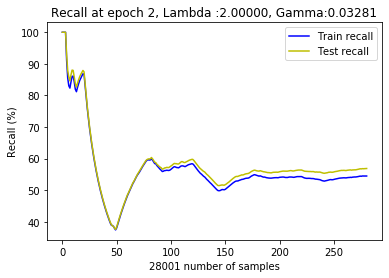

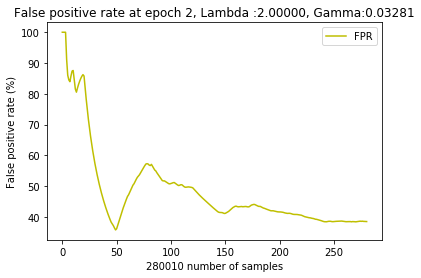

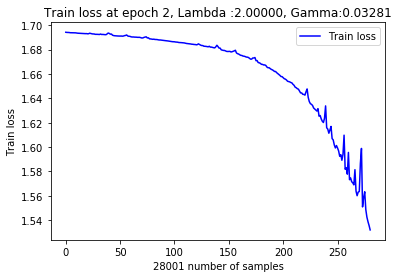

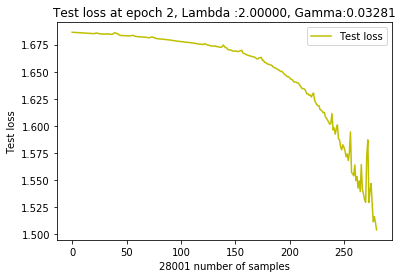

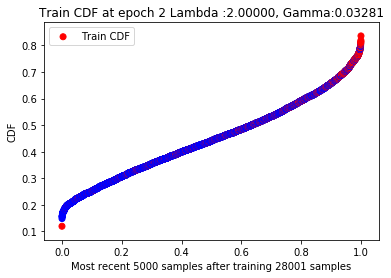

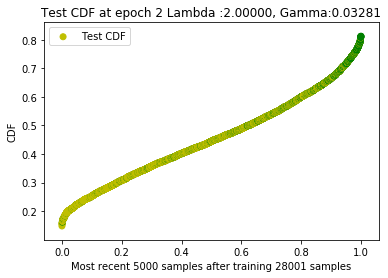

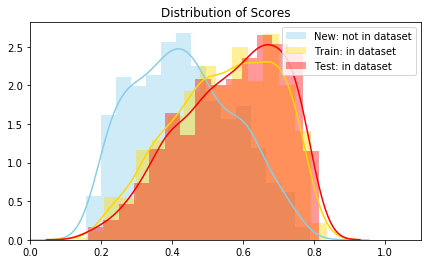

 80%|████████  | 8004/10000 [1:00:33<3:04:51,  5.56s/it]

New score:  0.42497197
Train score:  0.53449404
Test score:  0.55447537


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  3  with learning rate:  0.02952450000000001


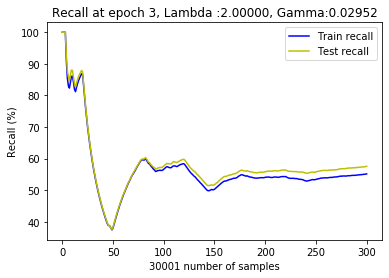

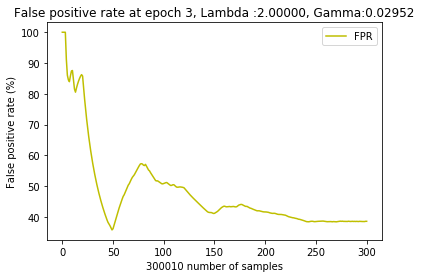

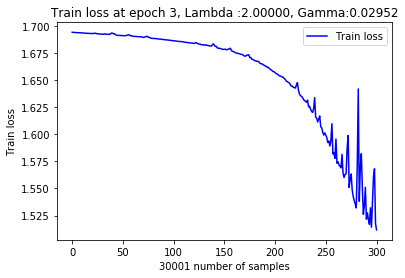

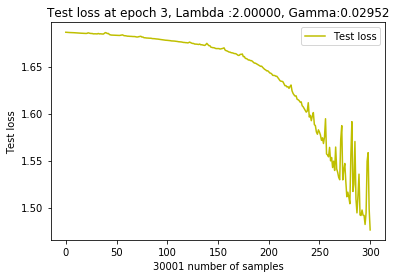

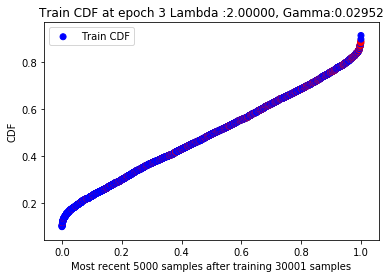

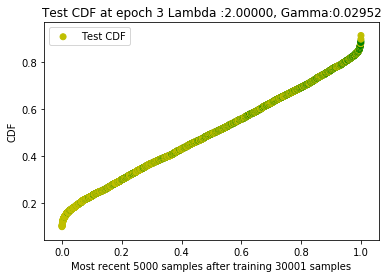

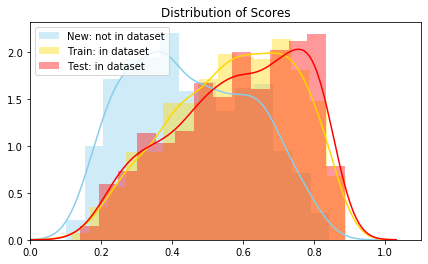

  0%|          | 4/10000 [01:04<125:36:52, 45.24s/it]

New score:  0.42190197
Train score:  0.587646
Test score:  0.60326046


 20%|██        | 2000/10000 [19:20<06:57, 19.17it/s]   

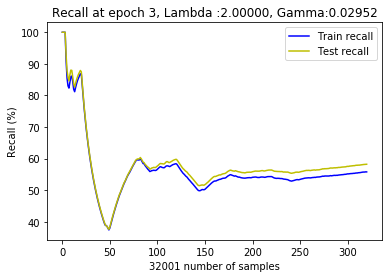

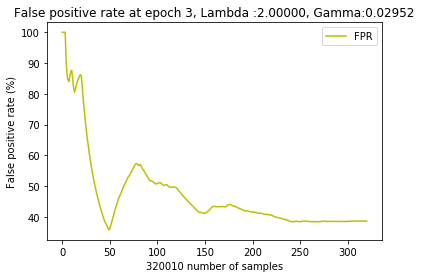

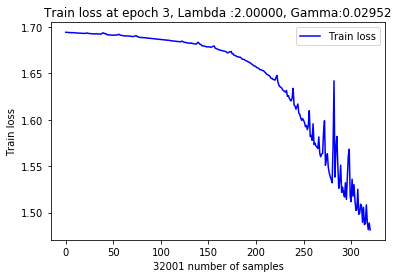

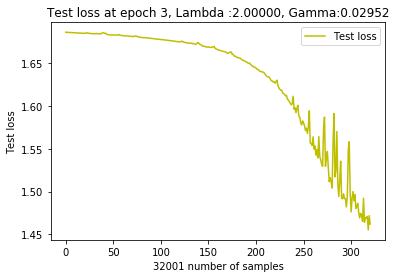

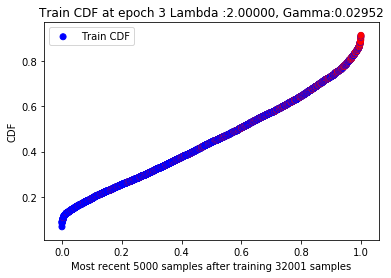

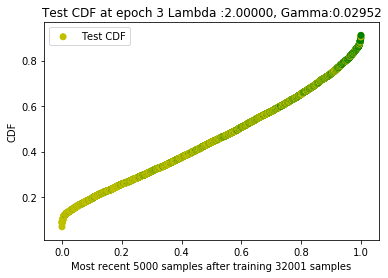

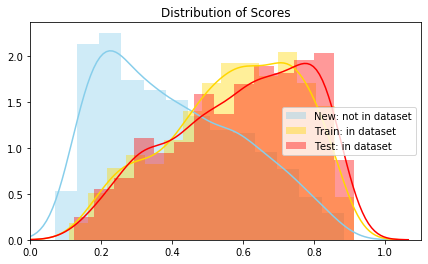

 20%|██        | 2005/10000 [19:48<21:46:34,  9.81s/it]

New score:  0.38771266
Train score:  0.56473476
Test score:  0.5889951


 40%|███▉      | 3998/10000 [37:30<04:18, 23.21it/s]   

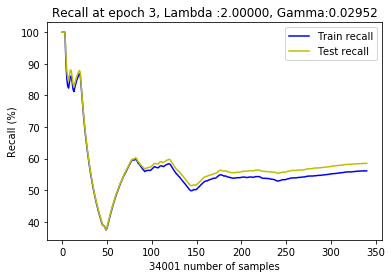

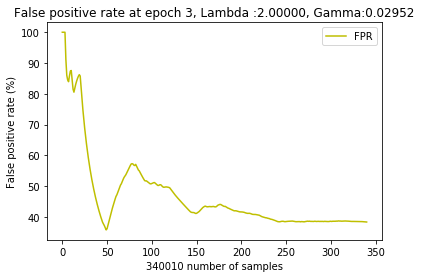

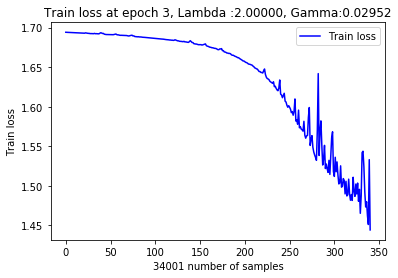

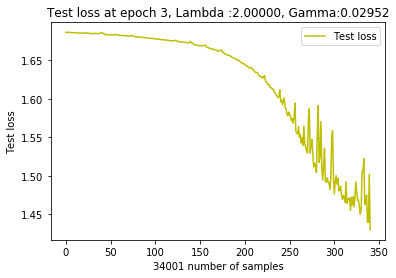

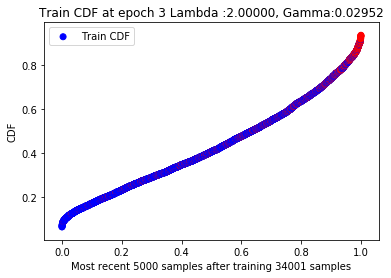

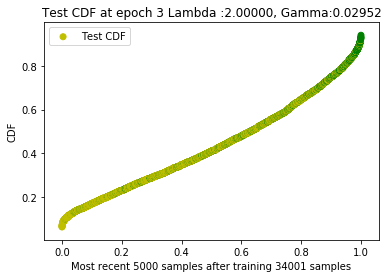

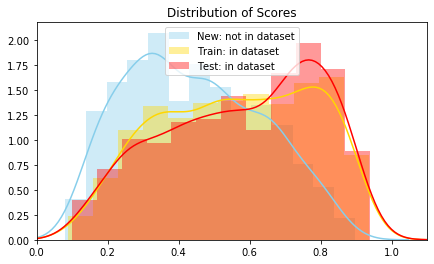

 40%|████      | 4004/10000 [38:07<6:07:51,  3.68s/it]

New score:  0.4354284
Train score:  0.54771745
Test score:  0.569449


 60%|██████    | 6000/10000 [54:30<02:48, 23.78it/s]   

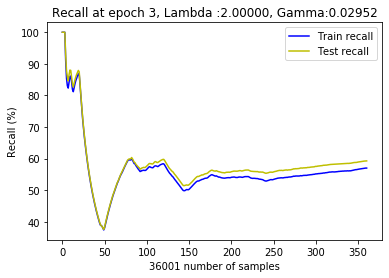

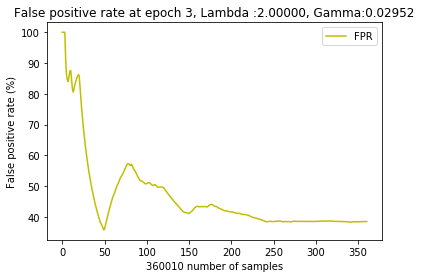

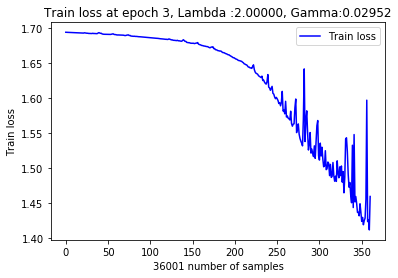

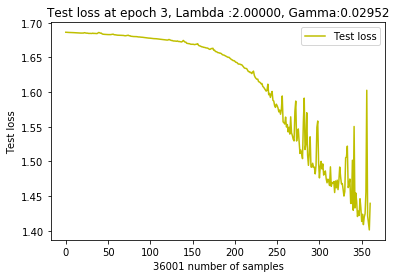

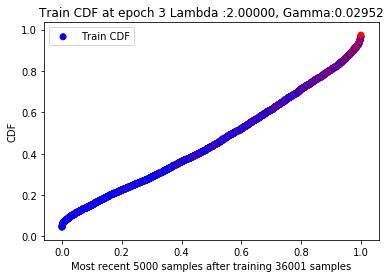

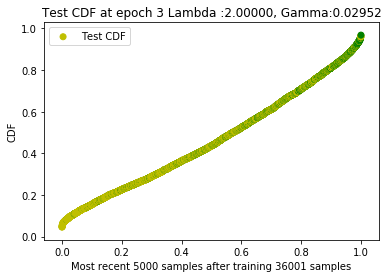

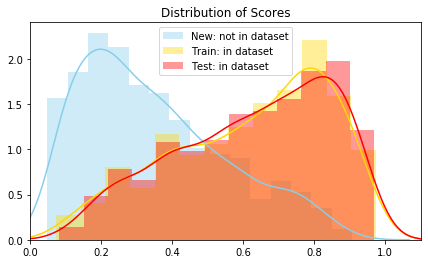

 60%|██████    | 6005/10000 [54:56<9:37:59,  8.68s/it] 

New score:  0.30175355
Train score:  0.6008842
Test score:  0.61417556


 80%|███████▉  | 7998/10000 [1:10:40<01:22, 24.27it/s]   

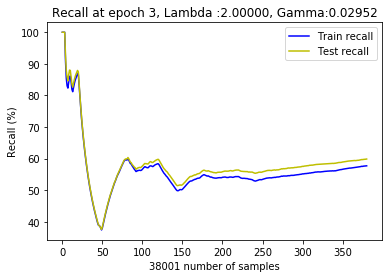

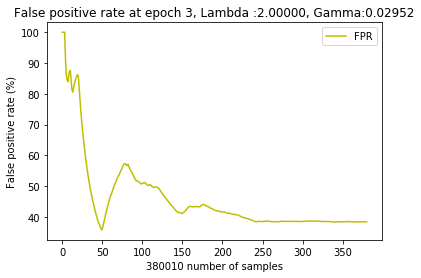

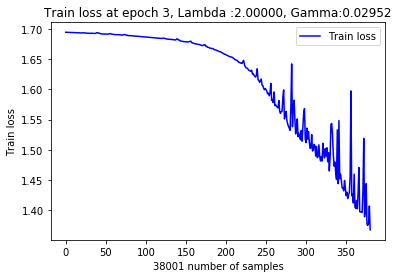

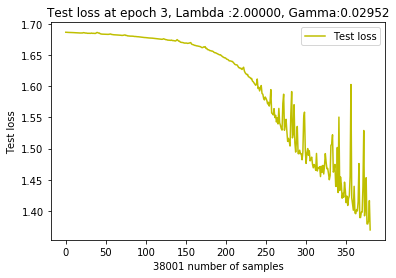

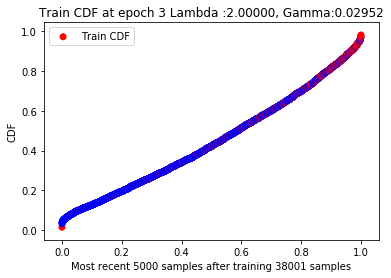

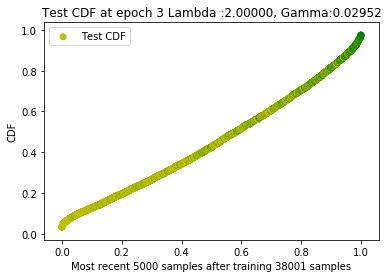

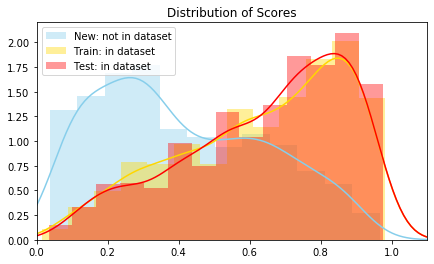

 80%|████████  | 8004/10000 [1:11:10<1:42:51,  3.09s/it]

New score:  0.3602231
Train score:  0.6247058
Test score:  0.63504404


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  4  with learning rate:  0.02657205000000001


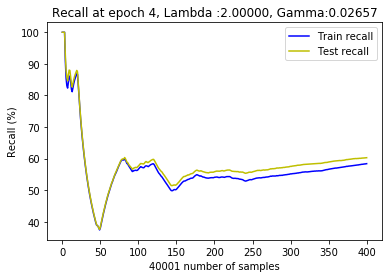

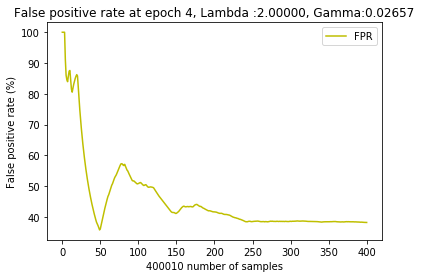

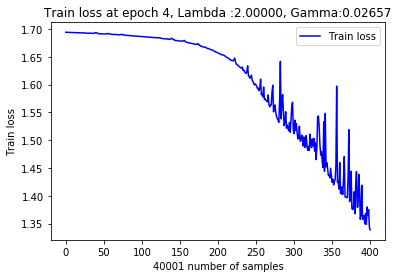

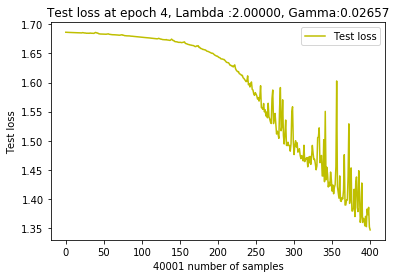

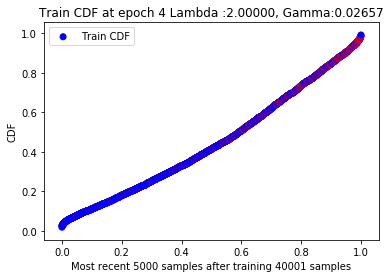

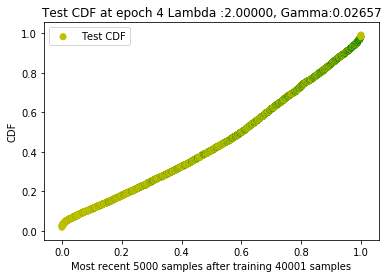

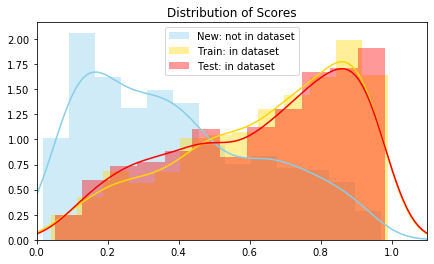

  0%|          | 4/10000 [00:42<83:12:13, 29.97s/it] 

New score:  0.372322
Train score:  0.6553205
Test score:  0.6442777


 20%|█▉        | 1998/10000 [16:40<06:42, 19.86it/s]   

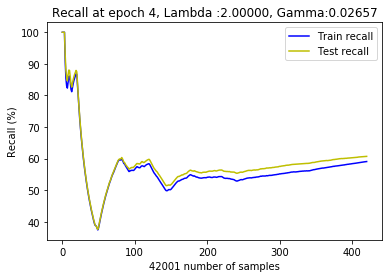

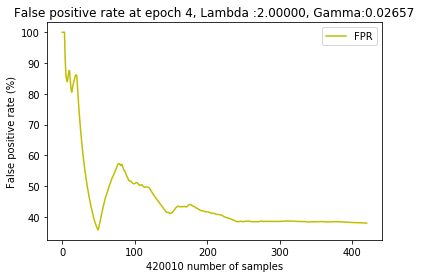

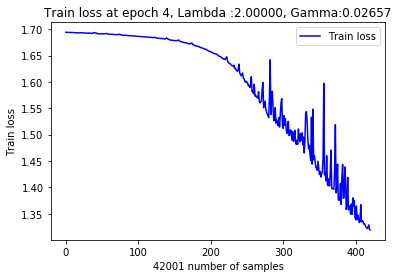

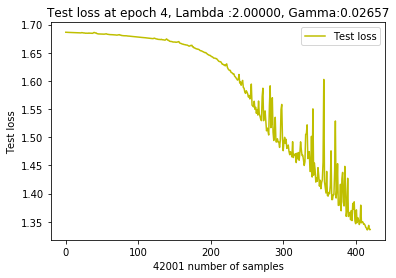

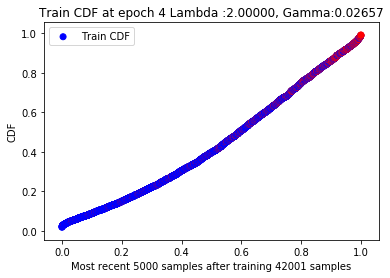

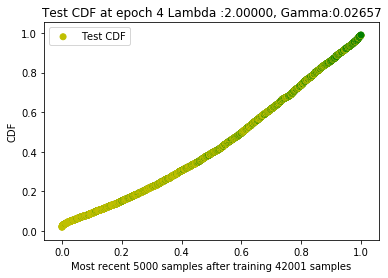

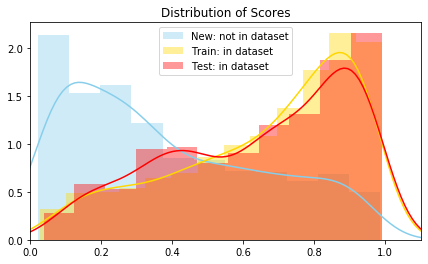

 20%|██        | 2004/10000 [17:12<7:53:00,  3.55s/it] 

New score:  0.37658447
Train score:  0.6535322
Test score:  0.65255153


 40%|███▉      | 3998/10000 [33:30<04:21, 22.92it/s]   

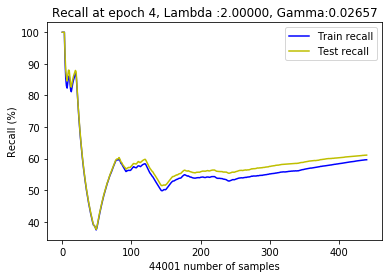

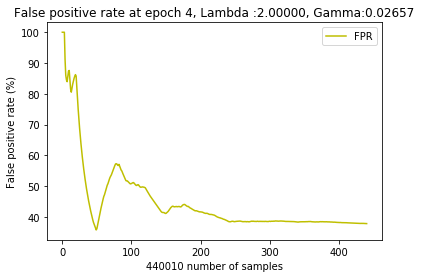

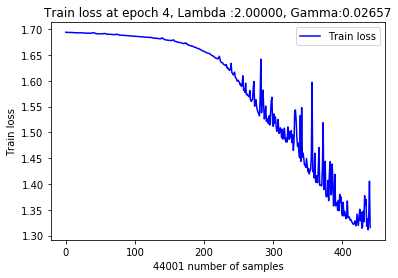

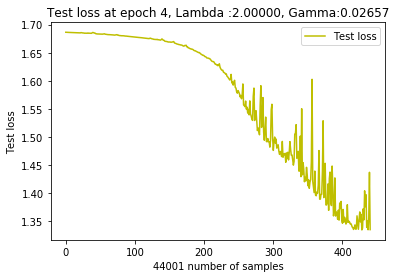

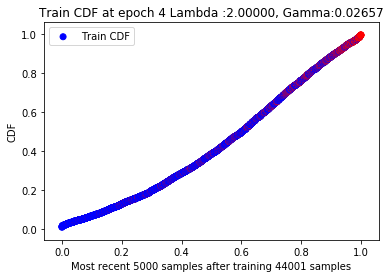

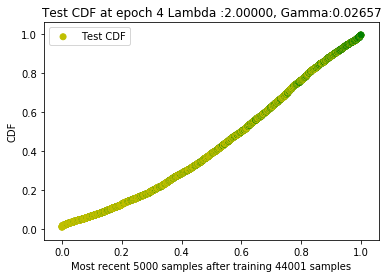

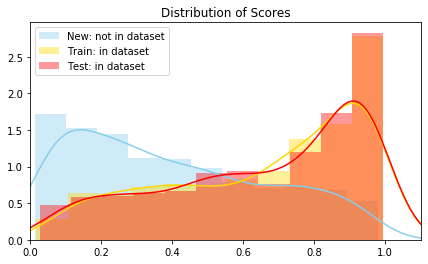

 40%|████      | 4005/10000 [34:04<5:40:07,  3.40s/it]

New score:  0.4113769
Train score:  0.65011835
Test score:  0.64572877


 60%|█████▉    | 5999/10000 [51:30<02:51, 23.29it/s]   

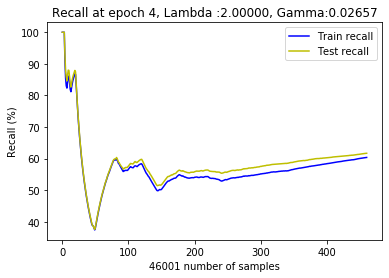

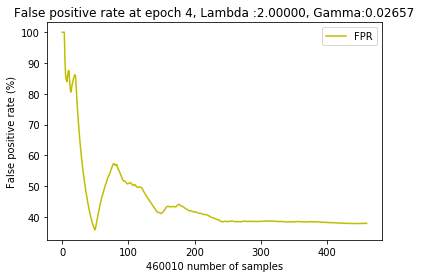

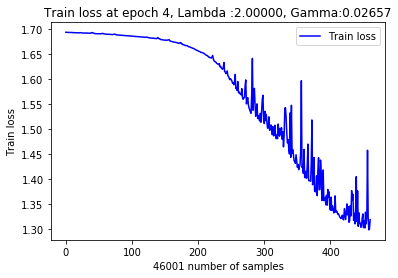

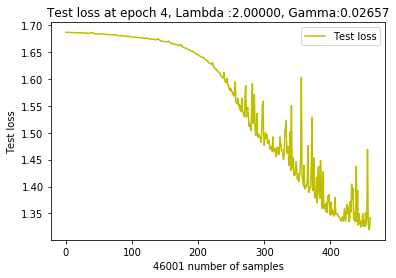

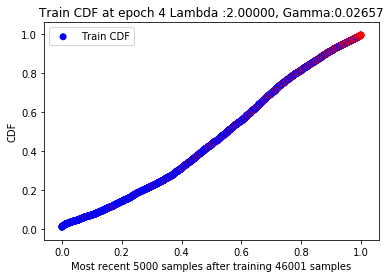

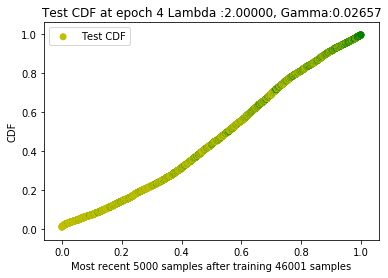

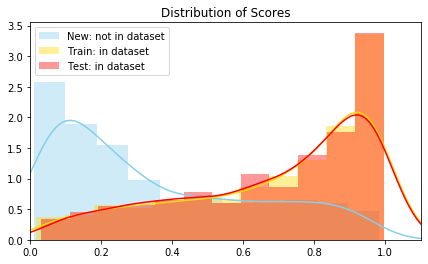

 60%|██████    | 6004/10000 [52:08<6:29:44,  5.85s/it]

New score:  0.33034876
Train score:  0.6768678
Test score:  0.68388385


 80%|███████▉  | 7997/10000 [1:06:30<01:02, 32.00it/s]  

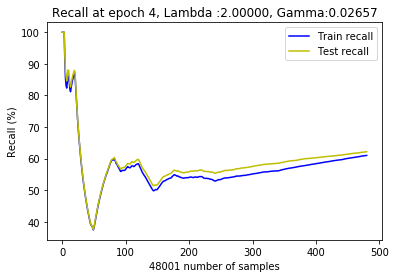

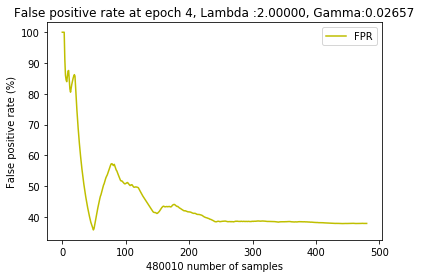

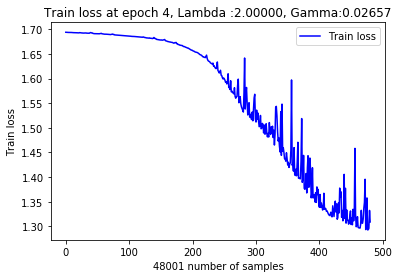

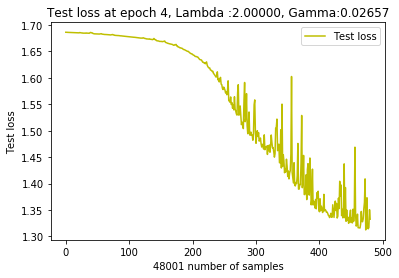

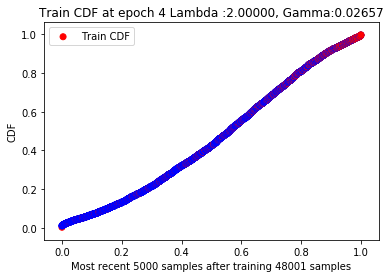

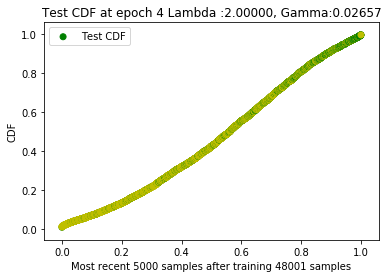

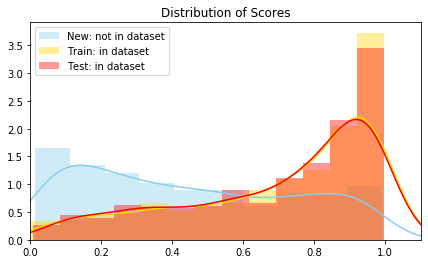

 80%|████████  | 8005/10000 [1:06:58<1:20:08,  2.41s/it]

New score:  0.4161985
Train score:  0.693916
Test score:  0.69360054


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  5  with learning rate:  0.02391484500000001


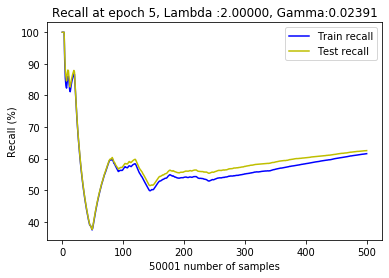

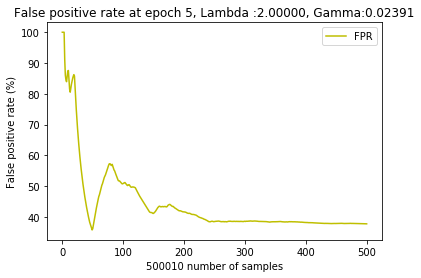

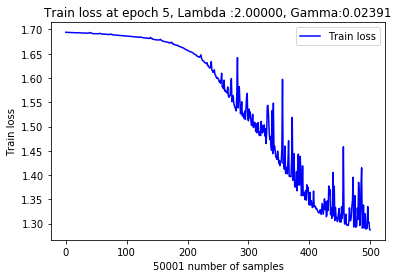

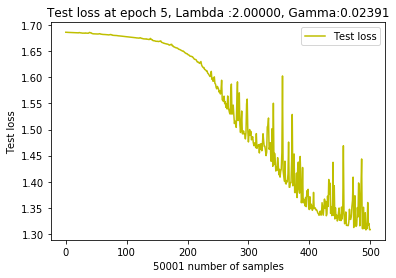

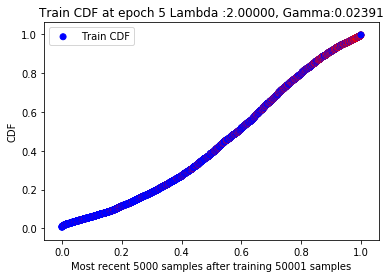

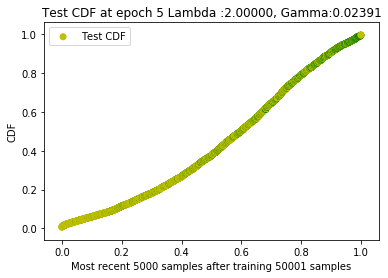

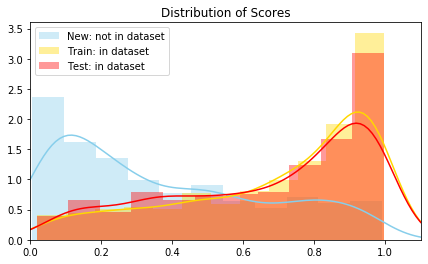

  0%|          | 5/10000 [00:45<88:07:24, 31.74s/it] 

New score:  0.35744593
Train score:  0.69711316
Test score:  0.6681982


 20%|██        | 2000/10000 [15:00<04:54, 27.19it/s]   

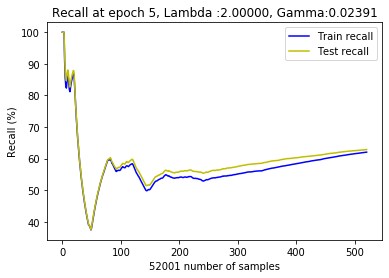

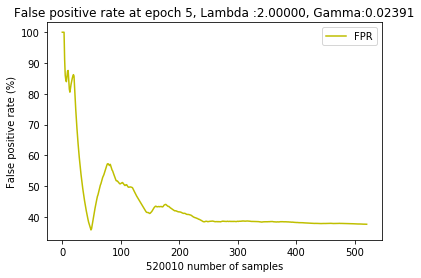

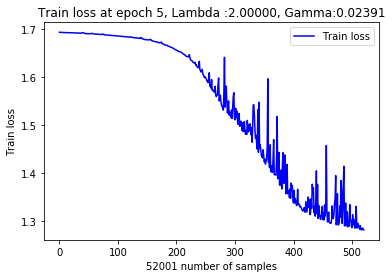

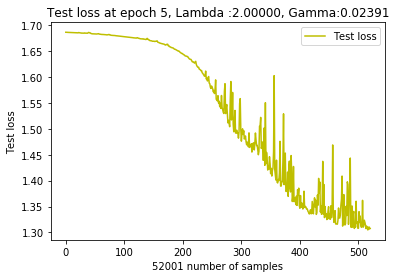

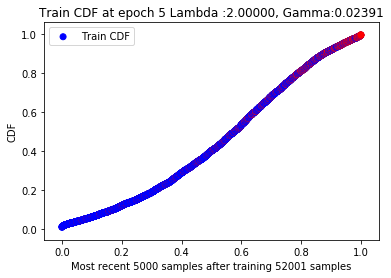

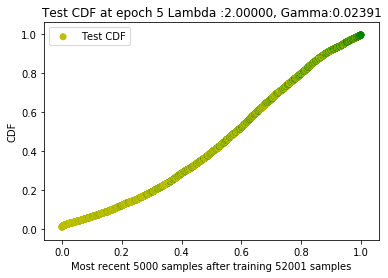

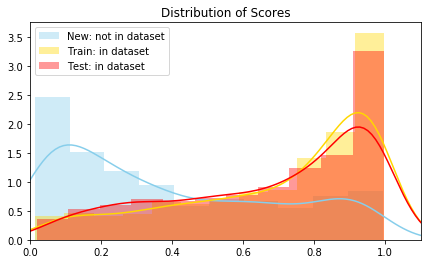

 20%|██        | 2005/10000 [15:34<22:39:52, 10.21s/it]

New score:  0.38075262
Train score:  0.69619495
Test score:  0.6882048


 40%|███▉      | 3997/10000 [29:40<03:17, 30.35it/s]   

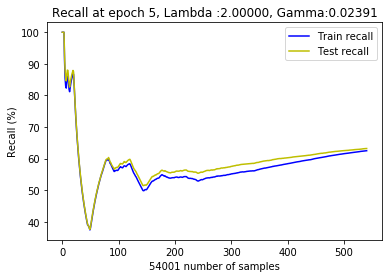

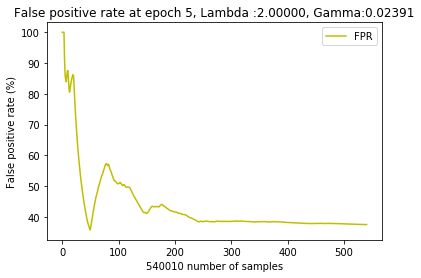

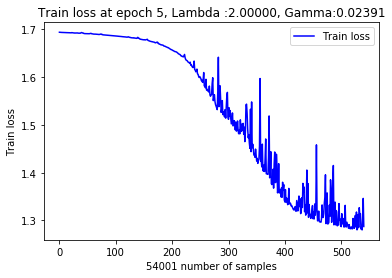

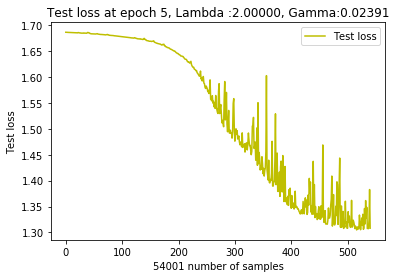

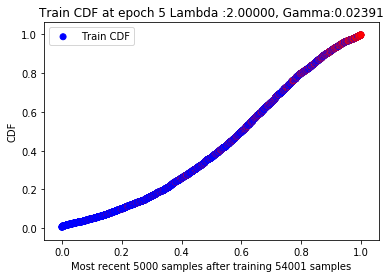

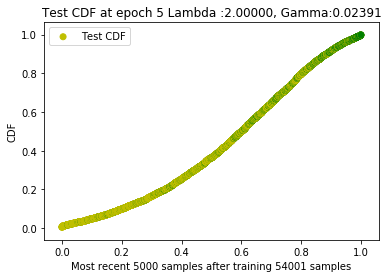

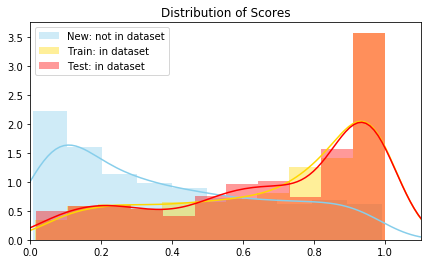

 40%|████      | 4005/10000 [30:10<3:56:06,  2.36s/it]

New score:  0.39237225
Train score:  0.6762588
Test score:  0.66633564


 60%|█████▉    | 5997/10000 [44:20<02:09, 30.88it/s]   

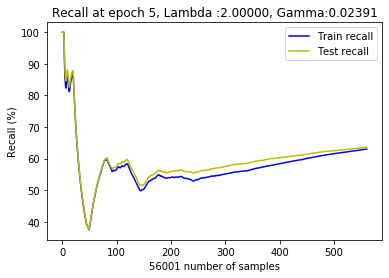

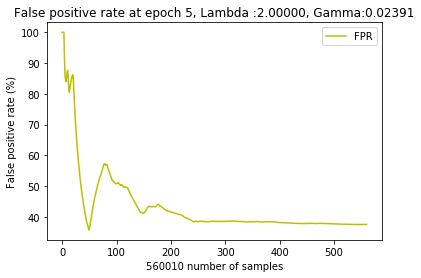

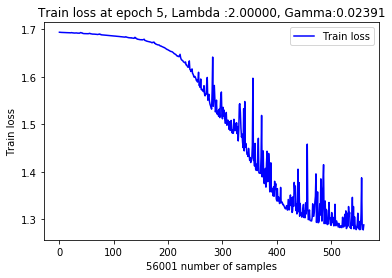

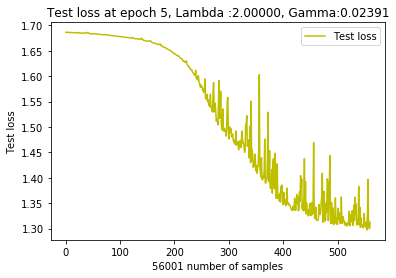

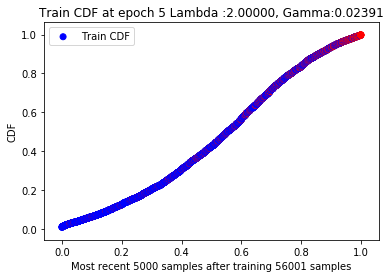

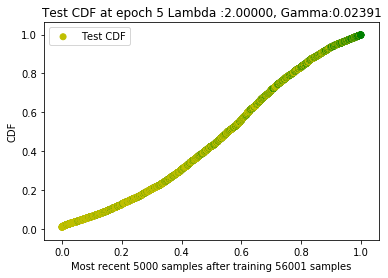

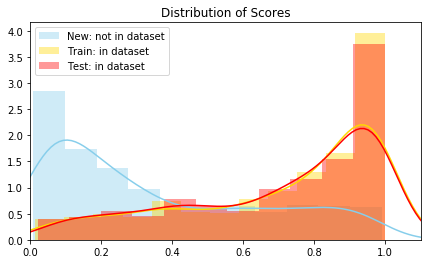

 60%|██████    | 6005/10000 [44:47<2:35:43,  2.34s/it]

New score:  0.33857414
Train score:  0.6953508
Test score:  0.7027494


 80%|████████  | 8000/10000 [58:50<01:04, 31.02it/s]   

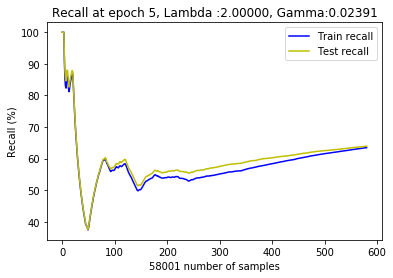

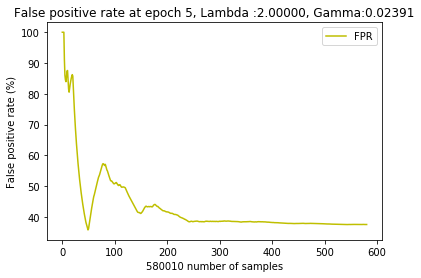

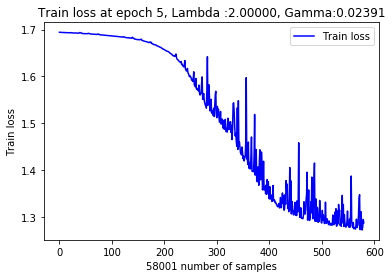

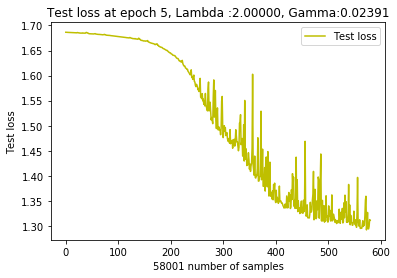

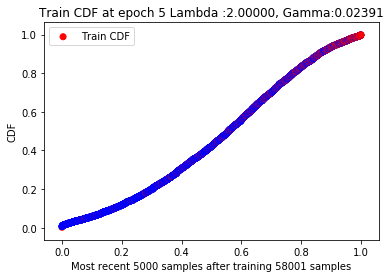

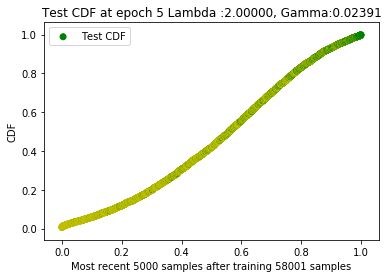

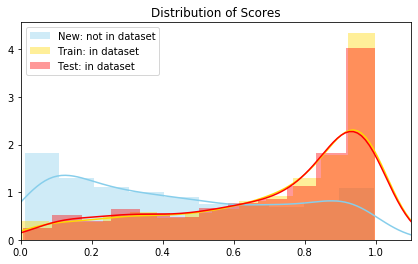

 80%|████████  | 8004/10000 [59:20<5:10:50,  9.34s/it]

New score:  0.43603367
Train score:  0.70779055
Test score:  0.70645624


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  6  with learning rate:  0.021523360500000012


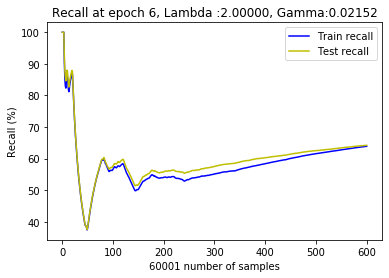

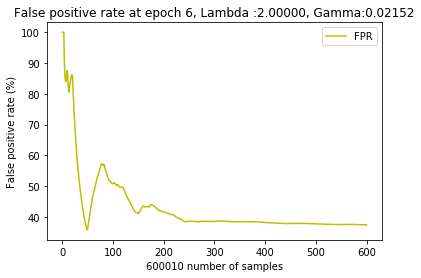

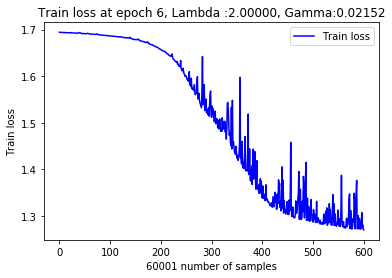

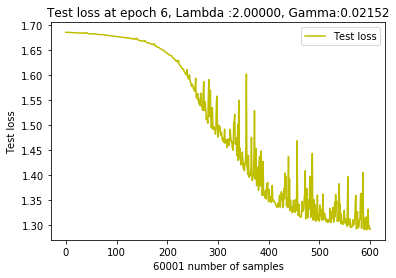

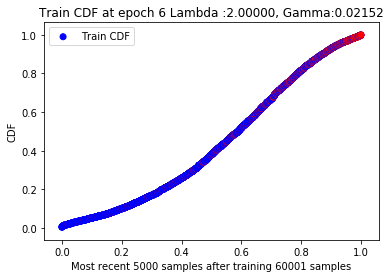

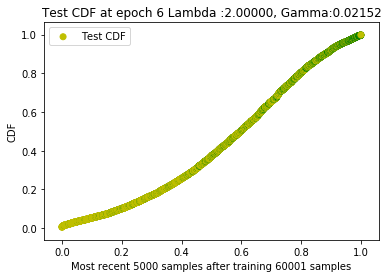

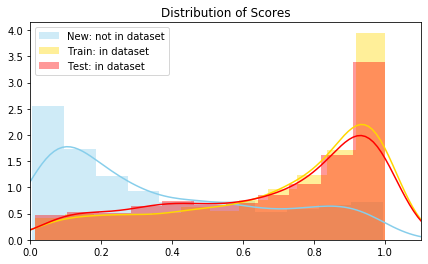

  0%|          | 5/10000 [00:42<83:04:49, 29.92s/it] 

New score:  0.35387456
Train score:  0.7085497
Test score:  0.6769801


 20%|█▉        | 1997/10000 [14:40<05:05, 26.19it/s]   

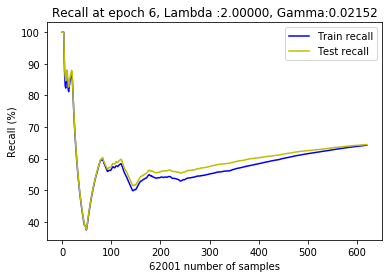

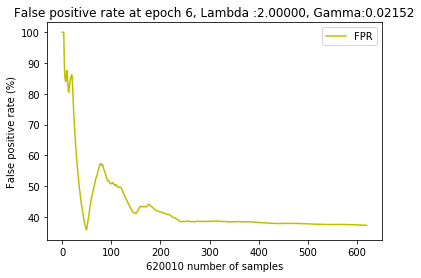

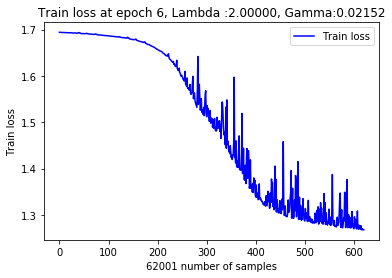

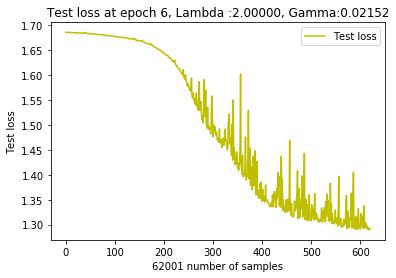

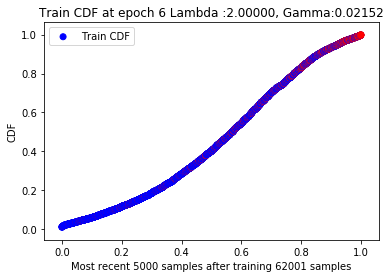

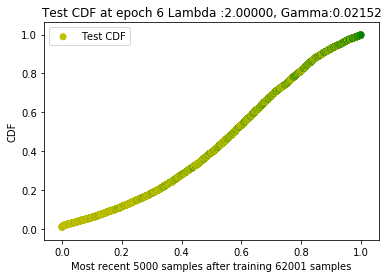

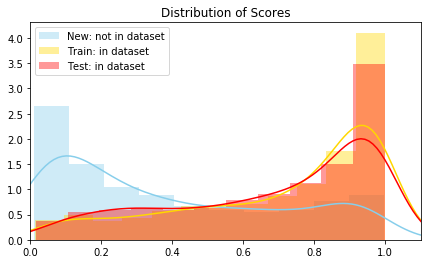

 20%|██        | 2004/10000 [15:09<4:58:48,  2.24s/it]

New score:  0.38007152
Train score:  0.7089425
Test score:  0.6996528


 40%|████      | 4000/10000 [29:10<03:07, 32.02it/s]   

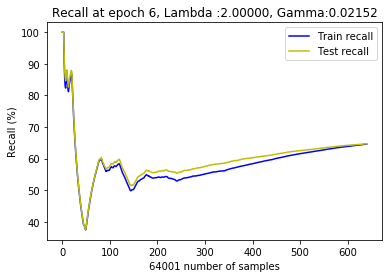

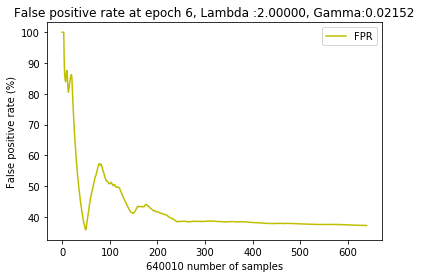

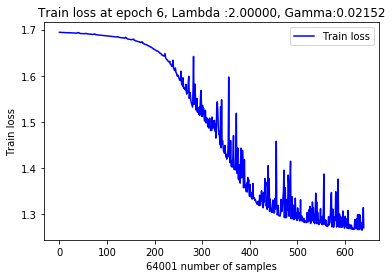

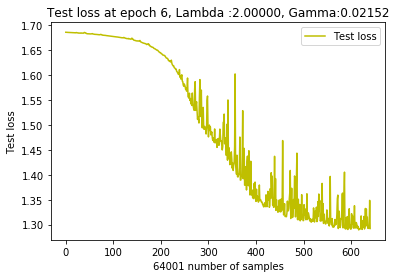

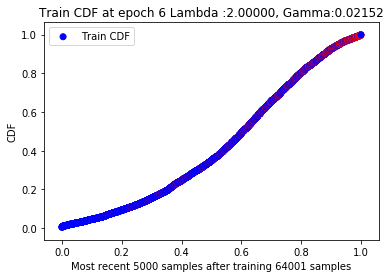

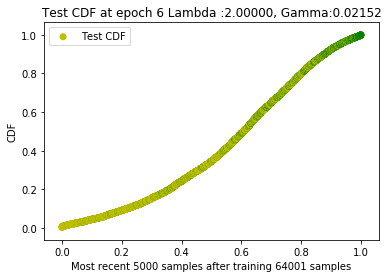

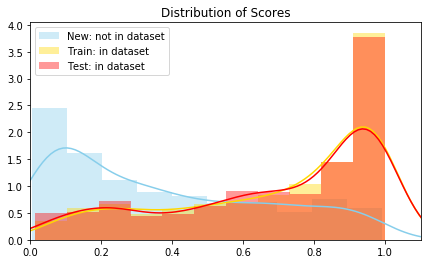

 40%|████      | 4005/10000 [29:35<14:43:17,  8.84s/it]

New score:  0.38006467
Train score:  0.6839064
Test score:  0.6731791


 60%|█████▉    | 5997/10000 [43:30<02:05, 31.98it/s]   

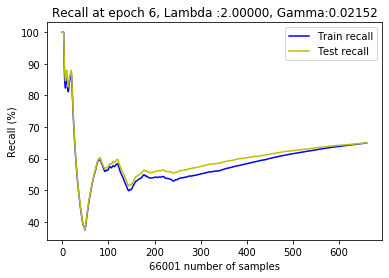

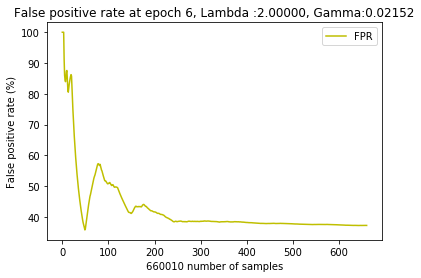

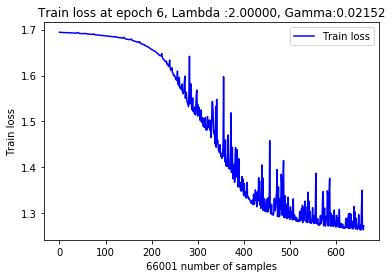

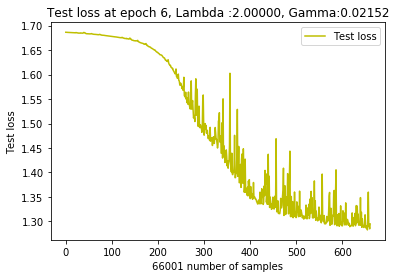

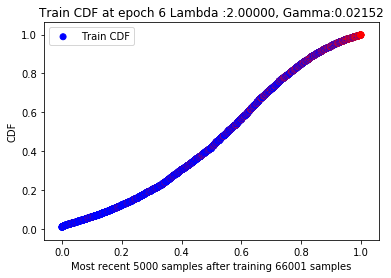

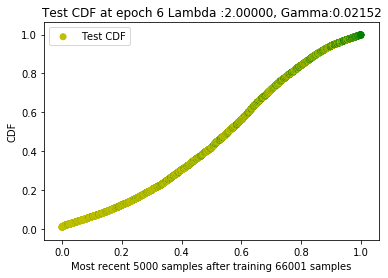

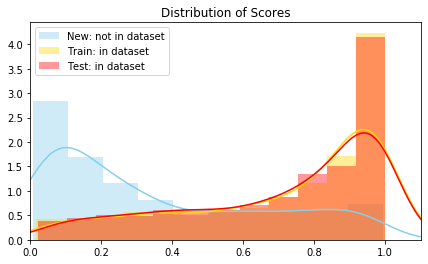

 60%|██████    | 6005/10000 [43:58<2:29:44,  2.25s/it]

New score:  0.34169966
Train score:  0.70375454
Test score:  0.7126003


 80%|████████  | 8000/10000 [57:50<01:01, 32.60it/s]  

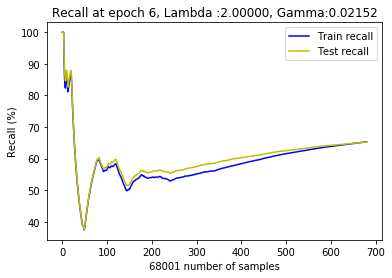

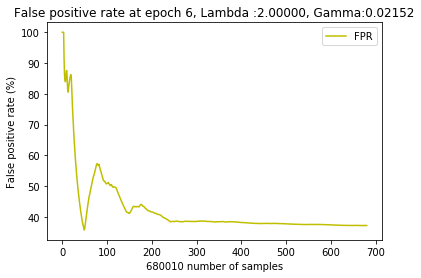

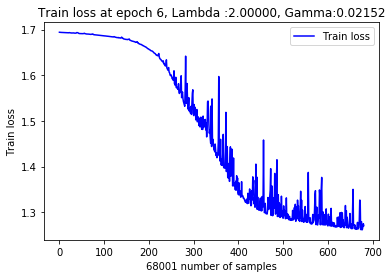

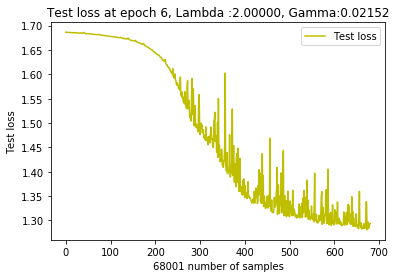

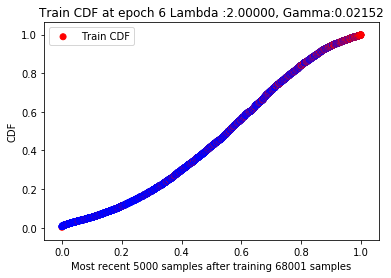

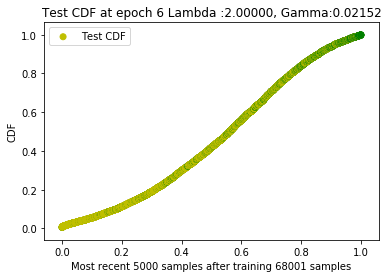

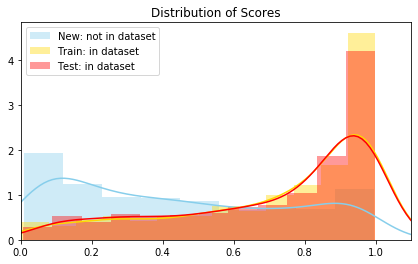

 80%|████████  | 8005/10000 [58:22<4:59:49,  9.02s/it]

New score:  0.4439563
Train score:  0.7127222
Test score:  0.71071935


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  7  with learning rate:  0.01937102445000001


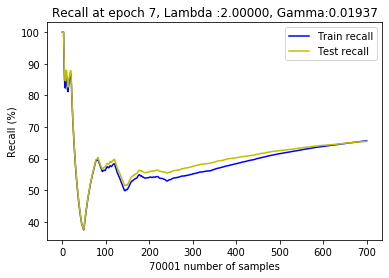

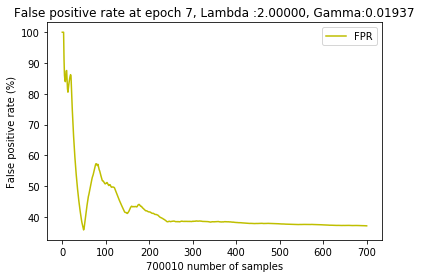

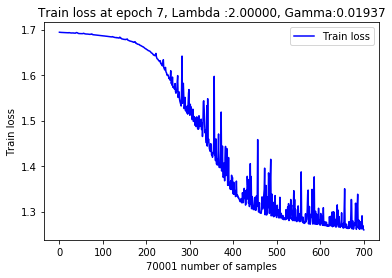

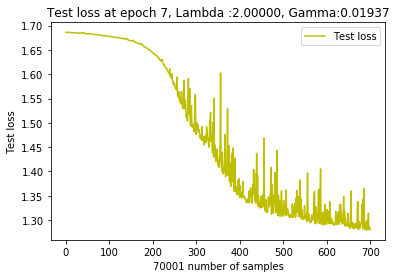

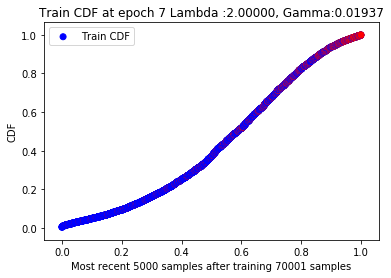

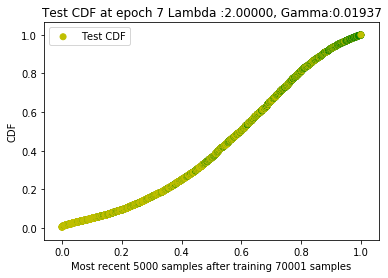

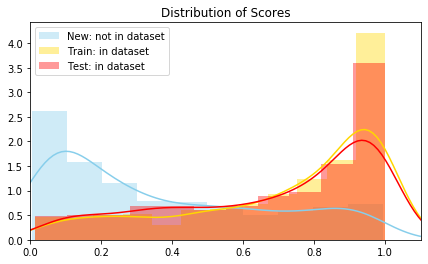

  0%|          | 5/10000 [00:42<82:56:09, 29.87s/it] 

New score:  0.35198724
Train score:  0.71433485
Test score:  0.68238336


 20%|█▉        | 1999/10000 [14:50<05:08, 25.97it/s]   

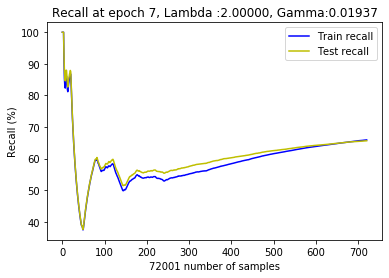

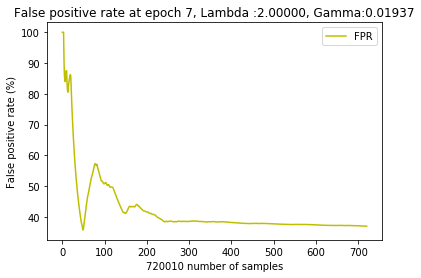

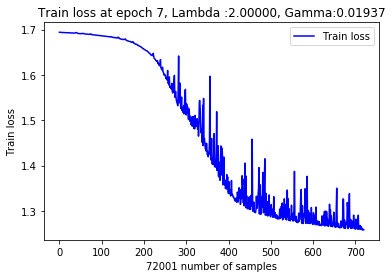

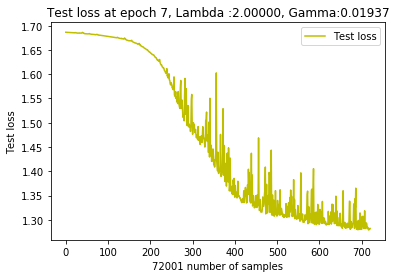

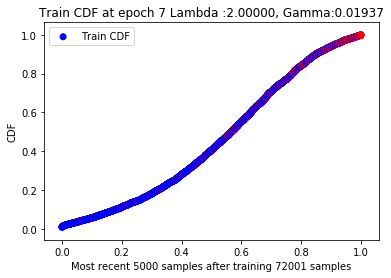

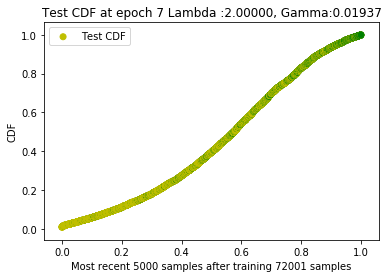

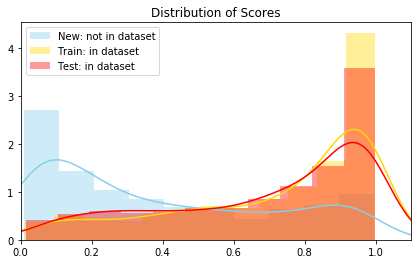

 20%|██        | 2005/10000 [15:13<9:58:11,  4.49s/it] 

New score:  0.37936136
Train score:  0.7164789
Test score:  0.7067856


 40%|███▉      | 3998/10000 [29:10<03:21, 29.84it/s]   

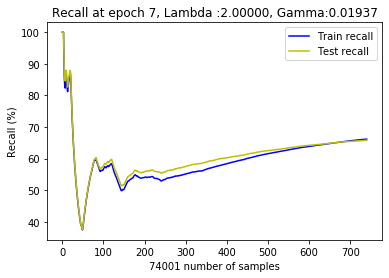

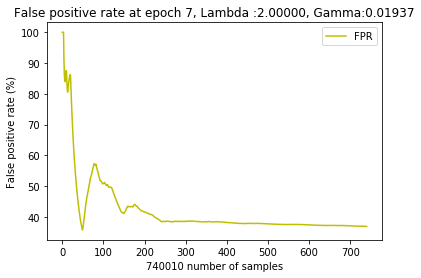

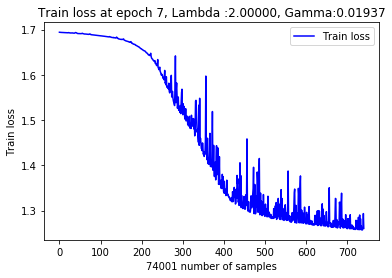

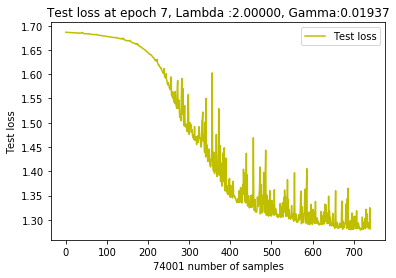

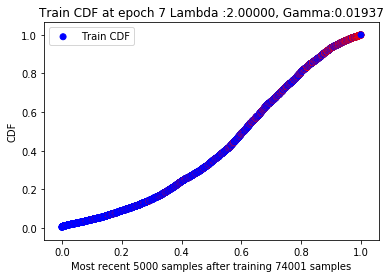

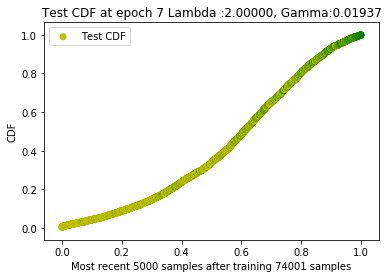

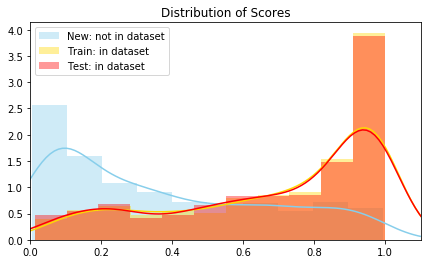

 40%|████      | 4005/10000 [29:42<5:11:42,  3.12s/it]

New score:  0.37221575
Train score:  0.6891271
Test score:  0.6783057


 60%|██████    | 6000/10000 [43:40<01:58, 33.66it/s]   

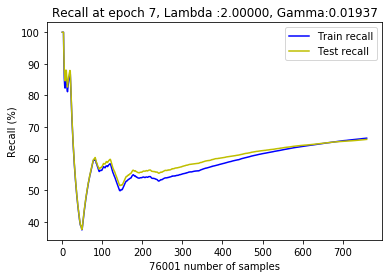

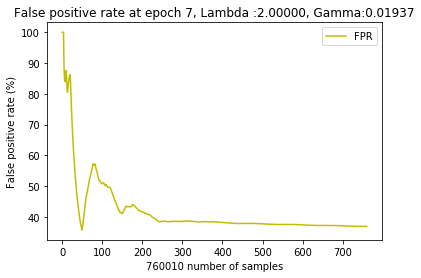

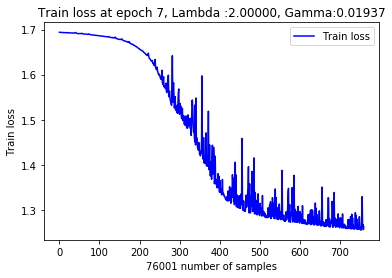

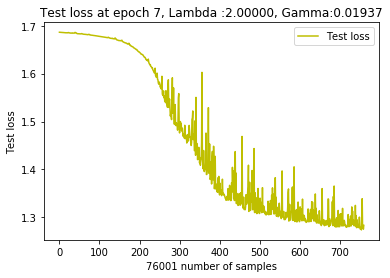

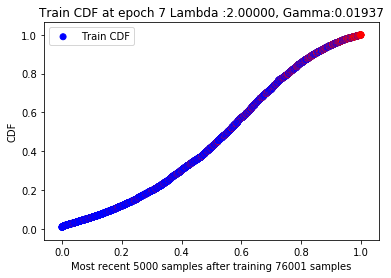

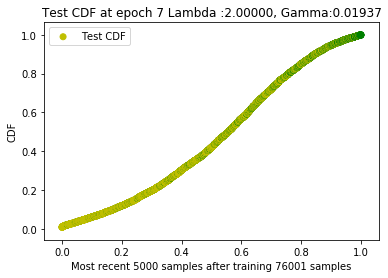

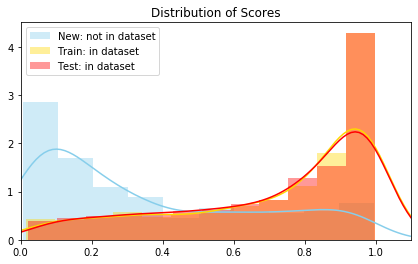

 60%|██████    | 6004/10000 [44:09<9:51:21,  8.88s/it] 

New score:  0.3441438
Train score:  0.70975345
Test score:  0.7202067


 80%|████████  | 8000/10000 [58:10<01:03, 31.71it/s]   

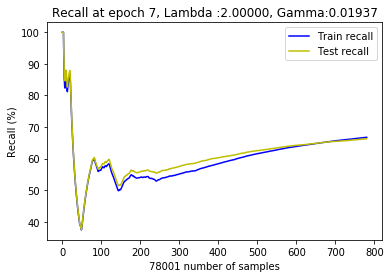

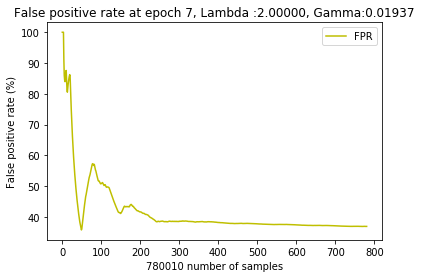

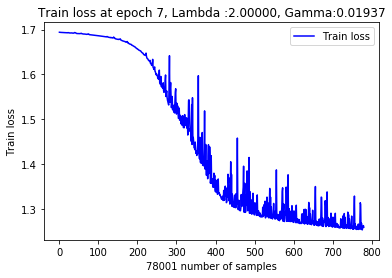

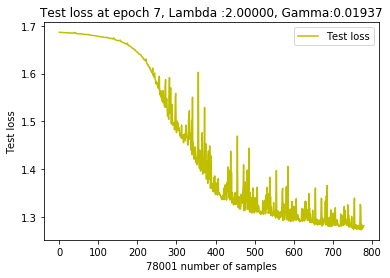

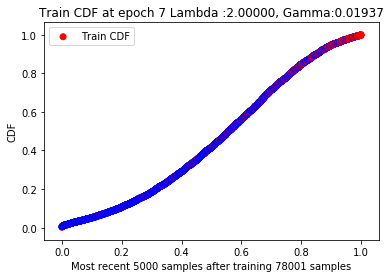

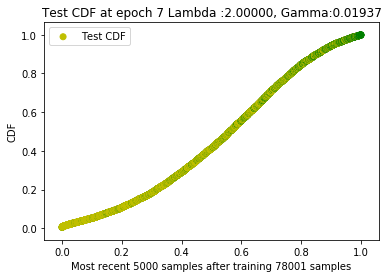

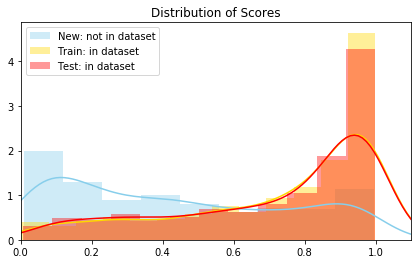

 80%|████████  | 8005/10000 [58:37<5:01:27,  9.07s/it]

New score:  0.44503248
Train score:  0.715292
Test score:  0.7128163


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  8  with learning rate:  0.01743392200500001


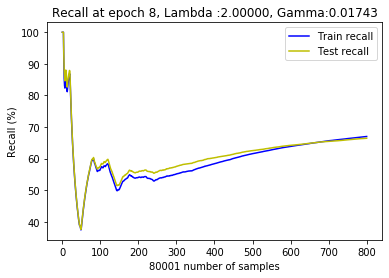

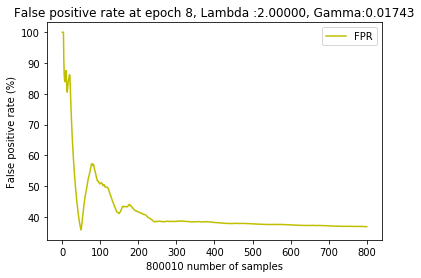

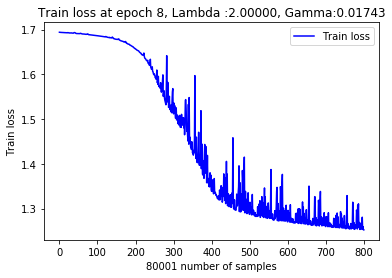

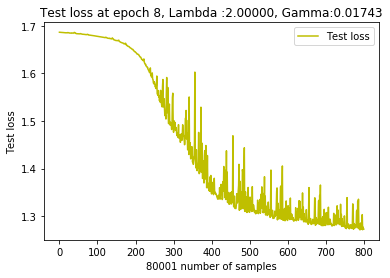

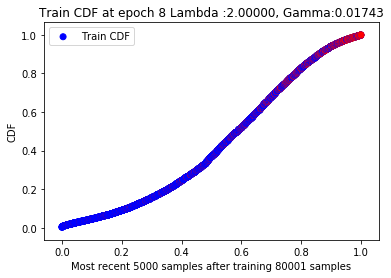

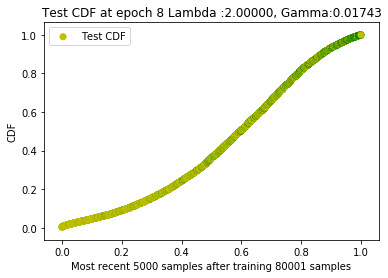

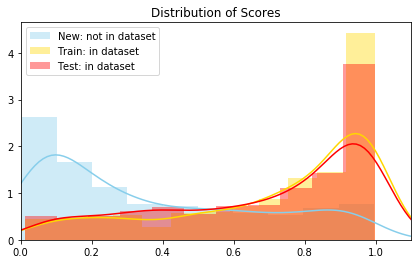

  0%|          | 5/10000 [00:44<87:13:12, 31.41s/it] 

New score:  0.35076135
Train score:  0.7176778
Test score:  0.6860876


 20%|██        | 2000/10000 [15:20<05:16, 25.30it/s]   

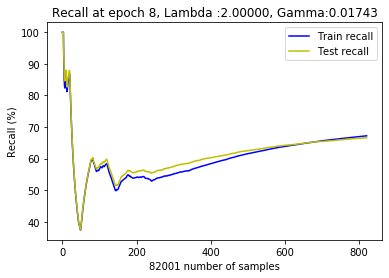

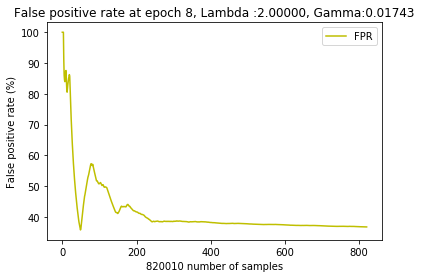

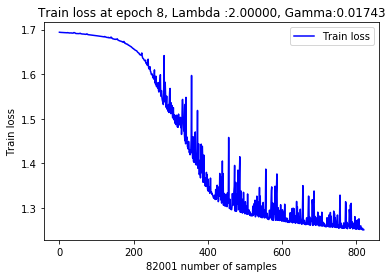

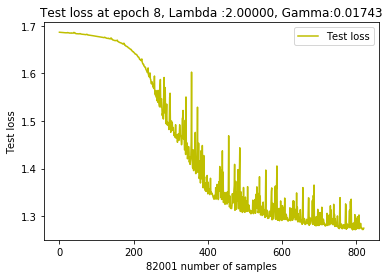

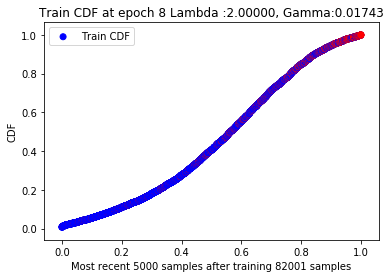

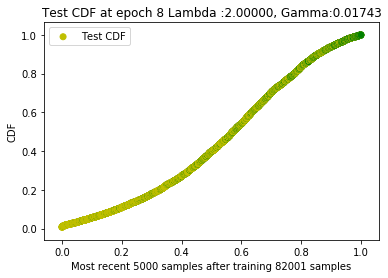

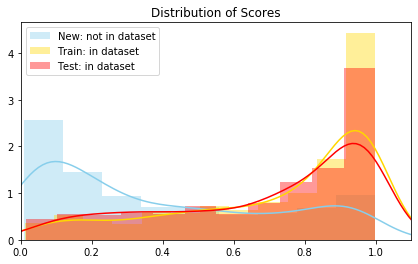

 20%|██        | 2005/10000 [15:45<20:36:14,  9.28s/it]

New score:  0.3783401
Train score:  0.7214706
Test score:  0.7119095


 40%|███▉      | 3999/10000 [30:20<03:22, 29.60it/s]   

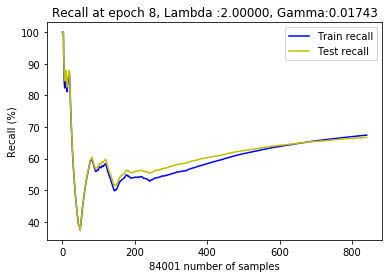

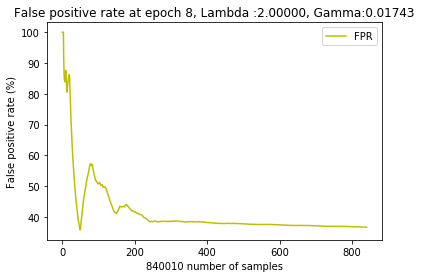

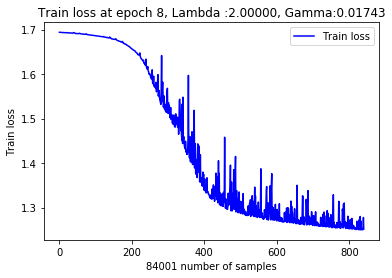

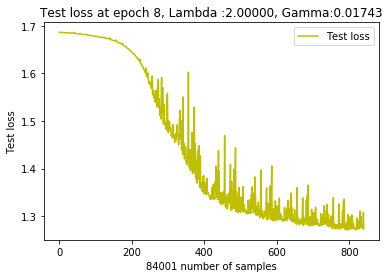

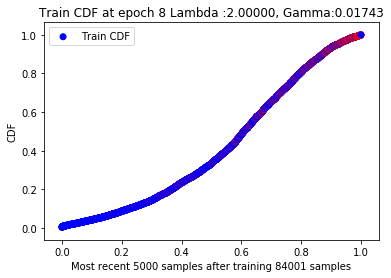

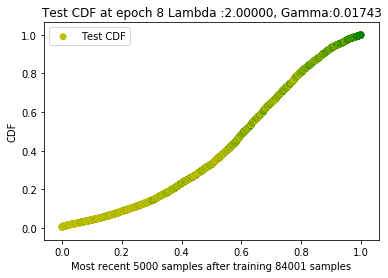

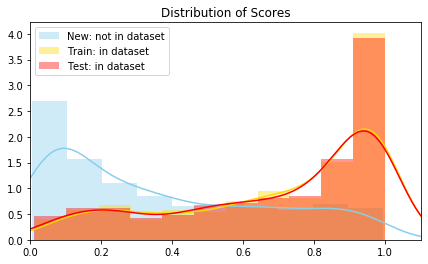

 40%|████      | 4004/10000 [30:44<7:43:12,  4.64s/it] 

New score:  0.3650647
Train score:  0.69221604
Test score:  0.6814569


 60%|█████▉    | 5998/10000 [45:20<02:03, 32.53it/s]   

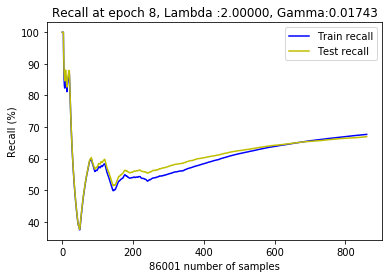

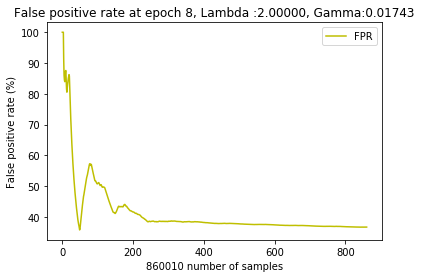

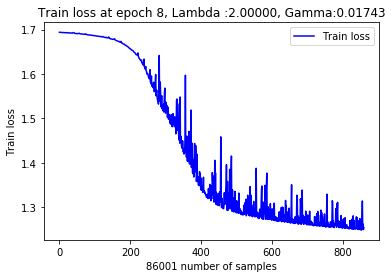

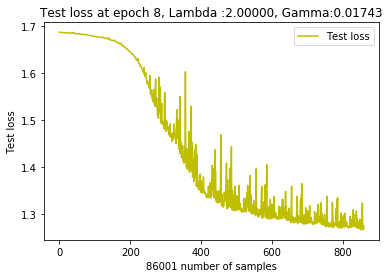

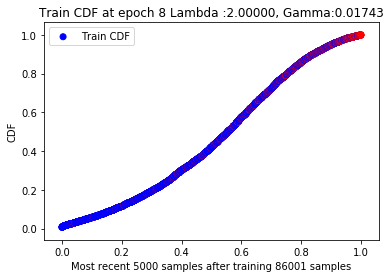

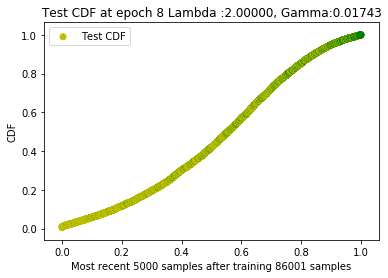

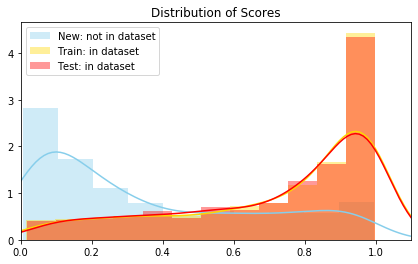

 60%|██████    | 6004/10000 [45:47<3:28:18,  3.13s/it]

New score:  0.34582835
Train score:  0.7138596
Test score:  0.725555


 80%|███████▉  | 7998/10000 [1:00:20<01:03, 31.50it/s] 

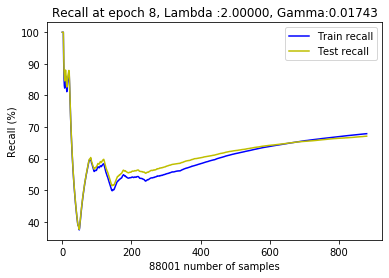

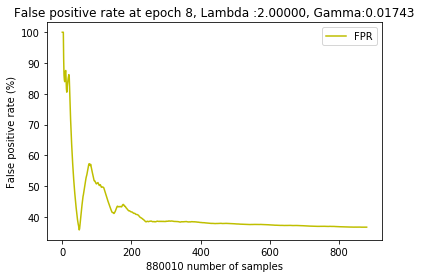

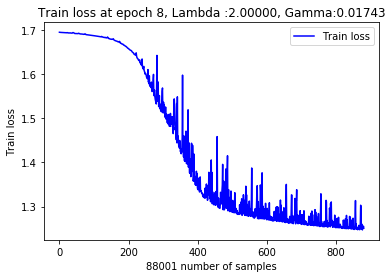

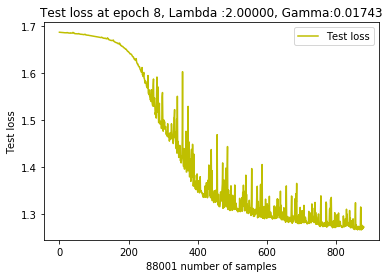

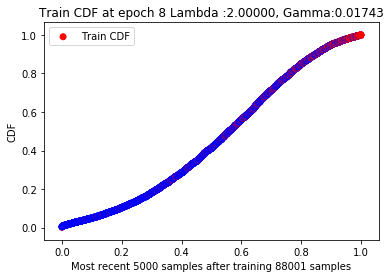

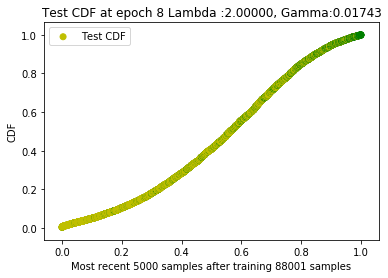

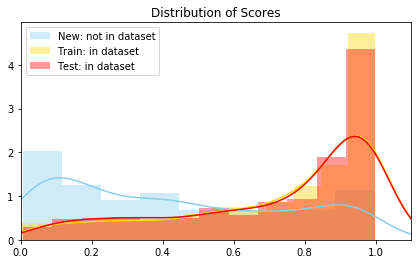

 80%|████████  | 8005/10000 [1:00:47<1:46:11,  3.19s/it]

New score:  0.44191724
Train score:  0.7172659
Test score:  0.71421653


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  9  with learning rate:  0.015690529804500006


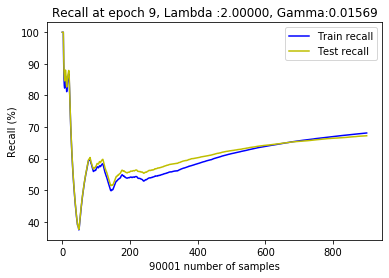

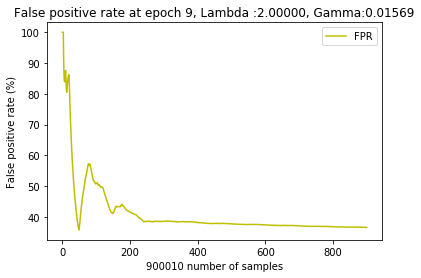

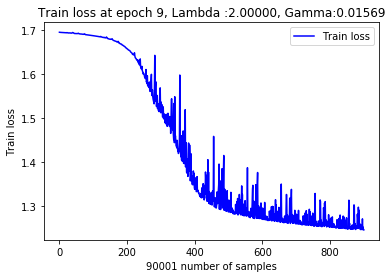

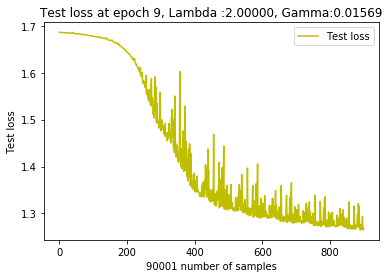

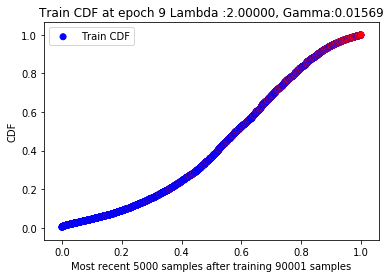

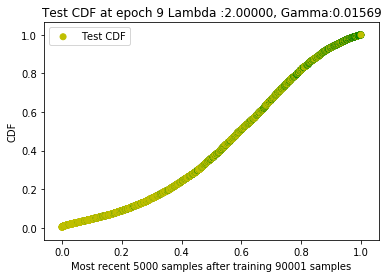

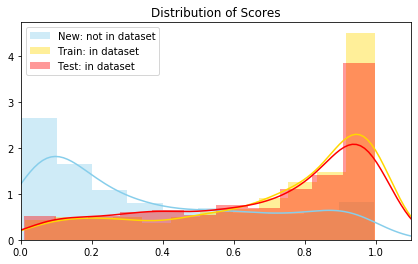

  0%|          | 5/10000 [00:43<83:27:57, 30.06s/it] 

New score:  0.35192317
Train score:  0.7211919
Test score:  0.68994594


 20%|█▉        | 1998/10000 [15:10<04:57, 26.93it/s]   

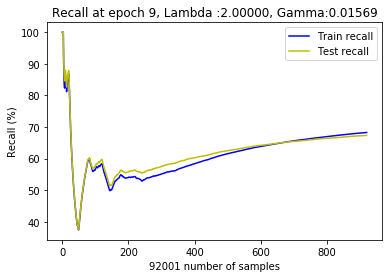

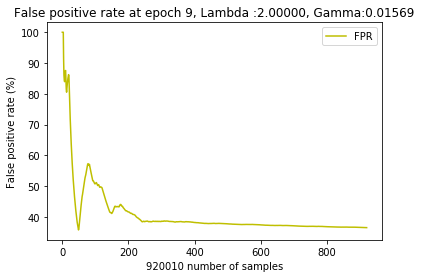

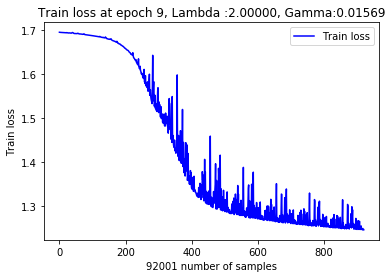

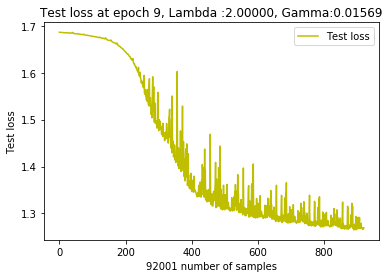

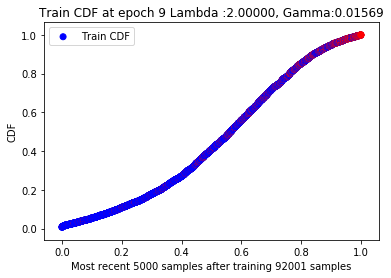

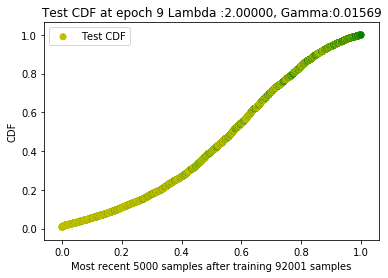

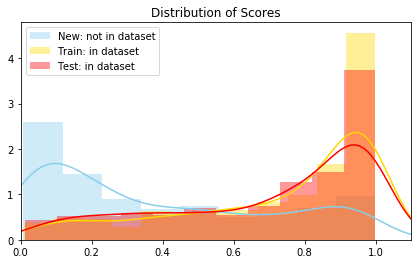

 20%|██        | 2005/10000 [15:39<6:58:13,  3.14s/it]

New score:  0.37704393
Train score:  0.7253161
Test score:  0.7156696


 40%|████      | 4000/10000 [30:10<03:23, 29.50it/s]   

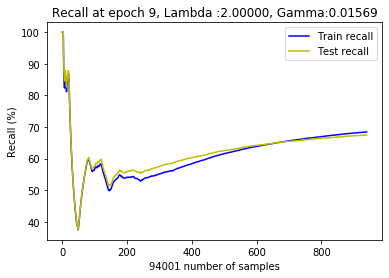

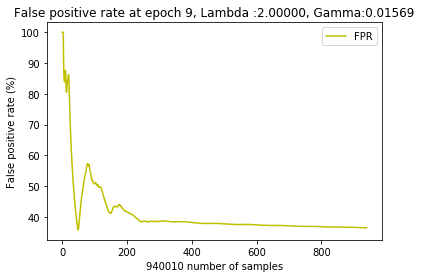

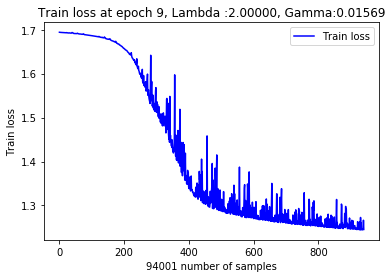

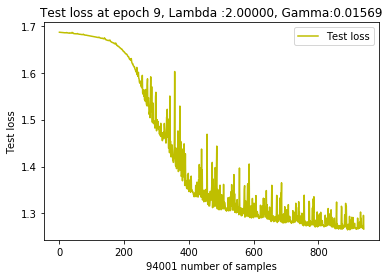

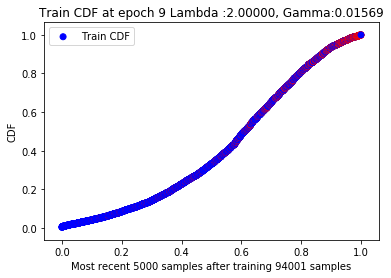

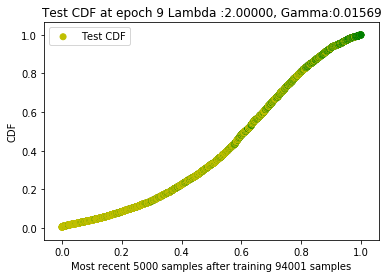

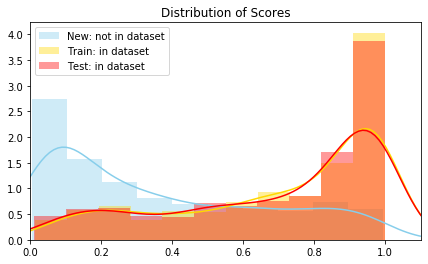

 40%|████      | 4004/10000 [30:42<16:05:04,  9.66s/it]

New score:  0.35945746
Train score:  0.69479764
Test score:  0.68378603


 60%|█████▉    | 5997/10000 [45:10<02:10, 30.75it/s]   

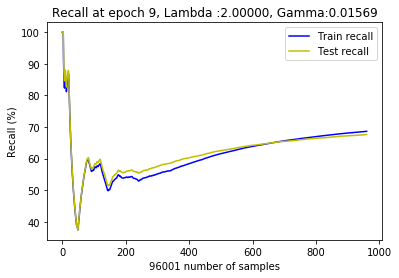

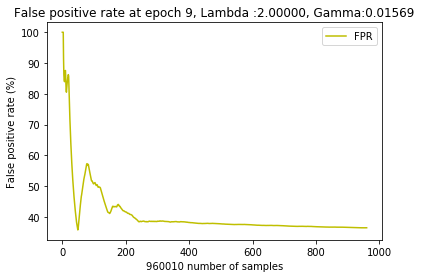

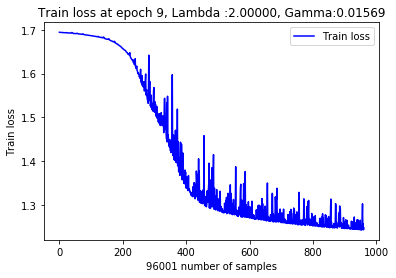

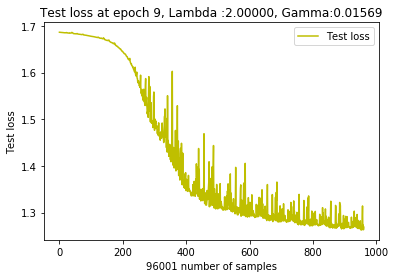

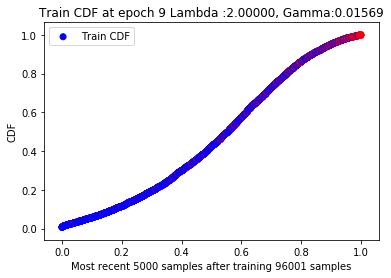

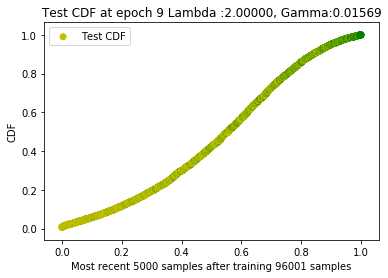

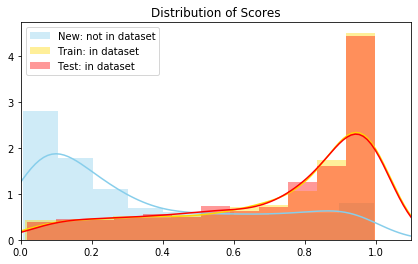

 60%|██████    | 6005/10000 [45:44<2:44:45,  2.47s/it]

New score:  0.34669718
Train score:  0.71727556
Test score:  0.7297074


 80%|███████▉  | 7999/10000 [1:00:10<00:59, 33.84it/s] 

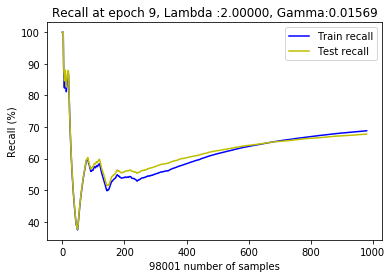

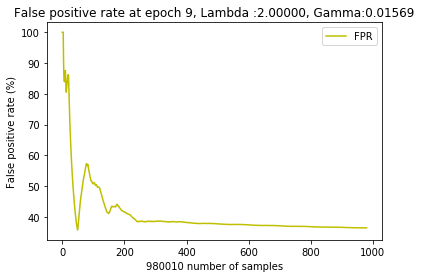

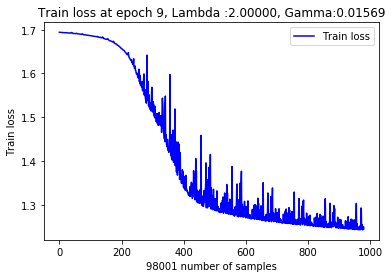

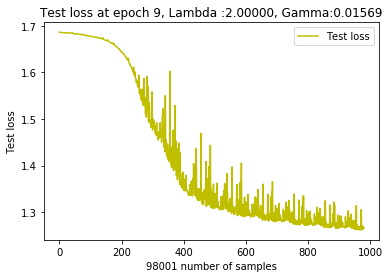

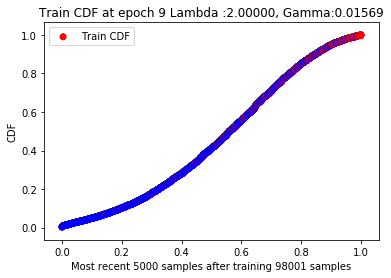

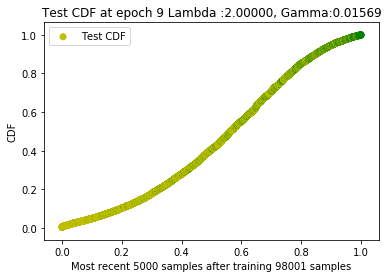

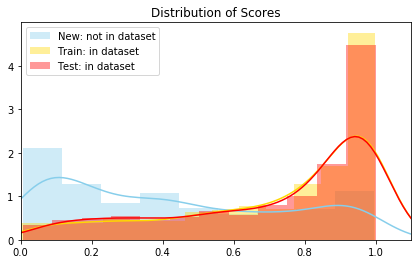

 80%|████████  | 8005/10000 [1:00:41<2:29:13,  4.49s/it]

New score:  0.4395868
Train score:  0.7180914
Test score:  0.7143252


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  10  with learning rate:  0.014121476824050006


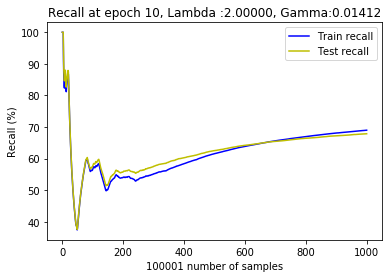

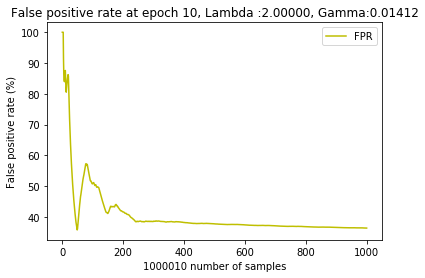

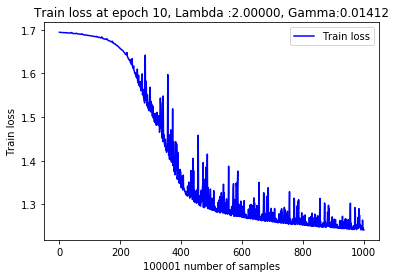

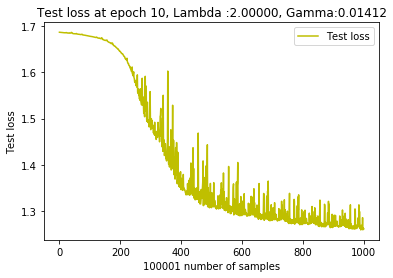

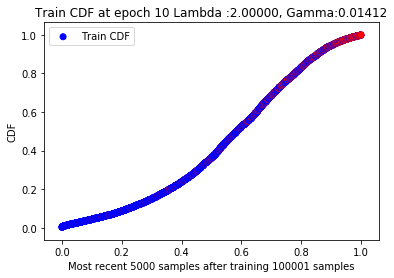

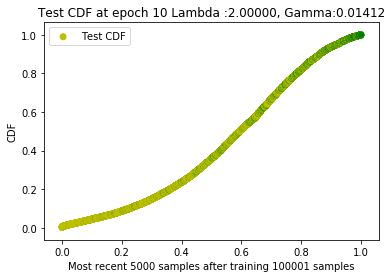

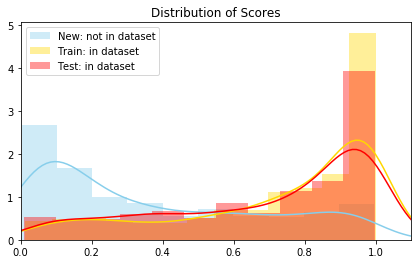

  0%|          | 4/10000 [00:44<86:55:58, 31.31s/it] 

New score:  0.3519163
Train score:  0.7237549
Test score:  0.69267005


 20%|██        | 2000/10000 [15:20<05:12, 25.63it/s]   

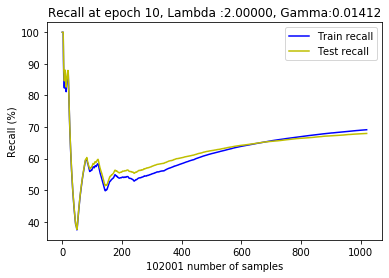

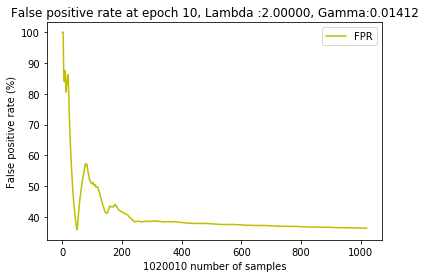

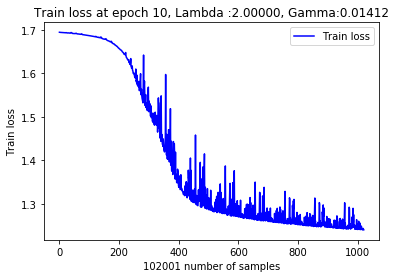

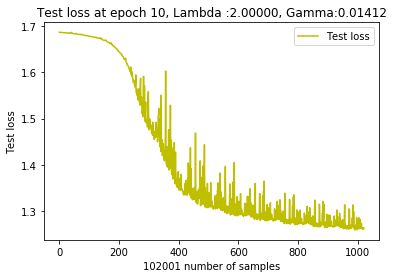

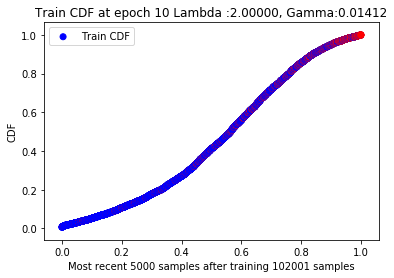

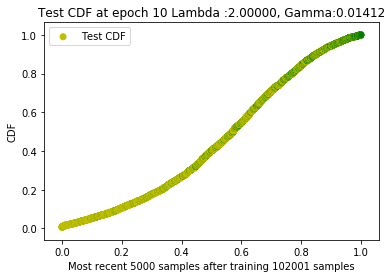

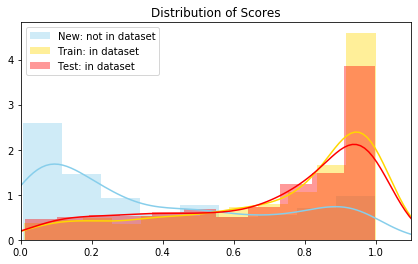

 20%|██        | 2005/10000 [15:44<20:45:09,  9.34s/it]

New score:  0.37659097
Train score:  0.72900593
Test score:  0.71942663


 40%|████      | 4000/10000 [30:10<03:14, 30.79it/s]   

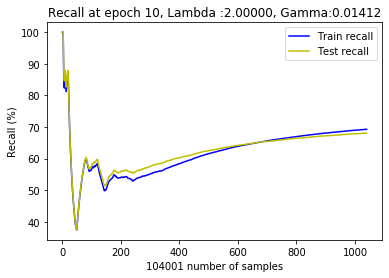

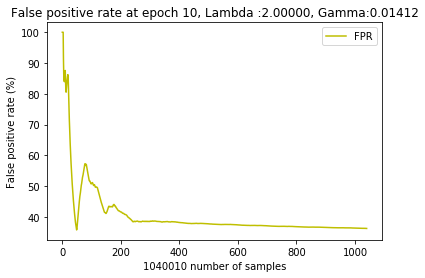

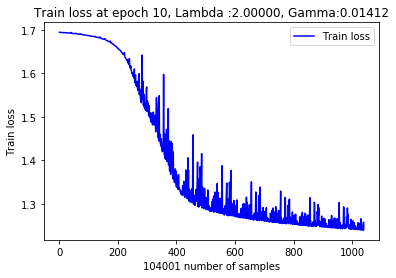

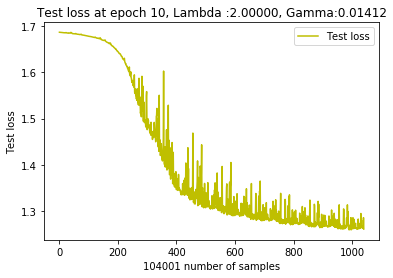

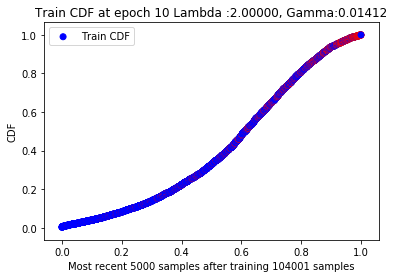

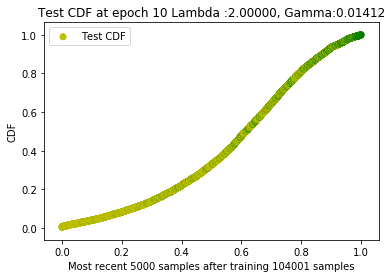

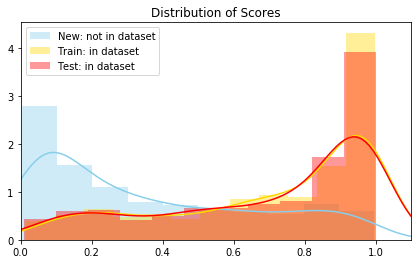

 40%|████      | 4005/10000 [30:43<15:33:08,  9.34s/it]

New score:  0.35531196
Train score:  0.69701076
Test score:  0.6859309


 60%|██████    | 6000/10000 [45:10<02:08, 31.07it/s]   

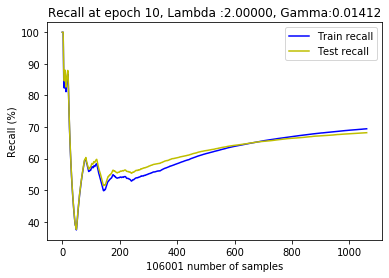

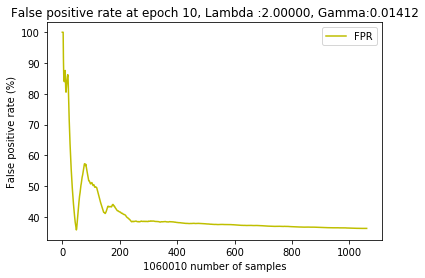

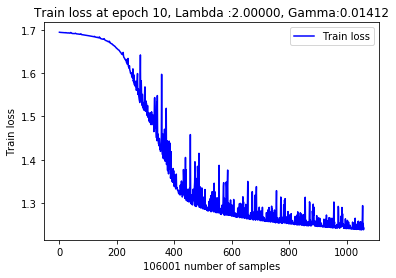

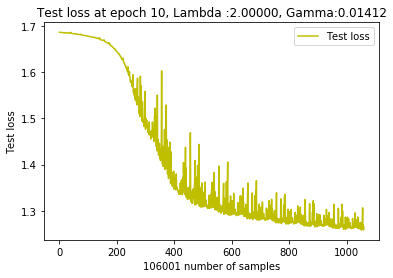

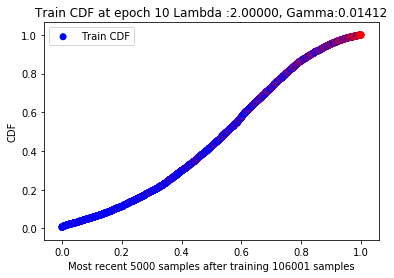

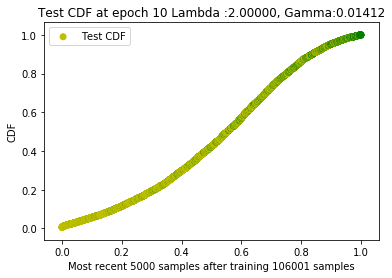

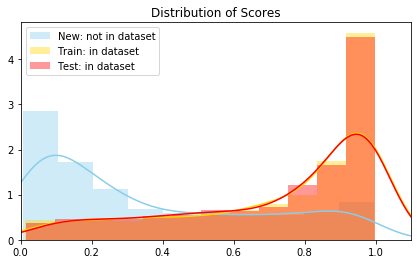

 60%|██████    | 6005/10000 [45:42<9:52:21,  8.90s/it] 

New score:  0.3474704
Train score:  0.72053677
Test score:  0.73357236


 80%|███████▉  | 7997/10000 [1:00:20<01:08, 29.24it/s] 

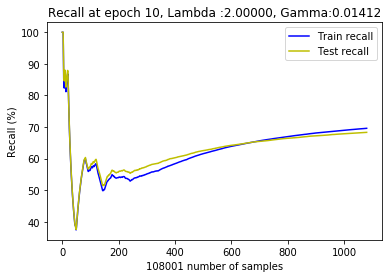

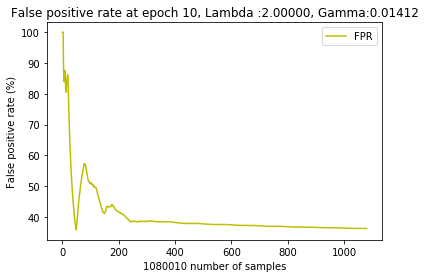

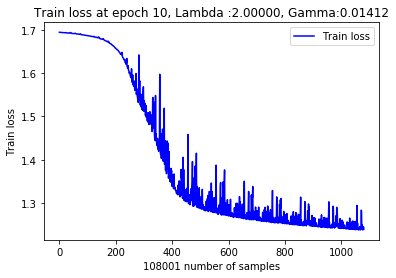

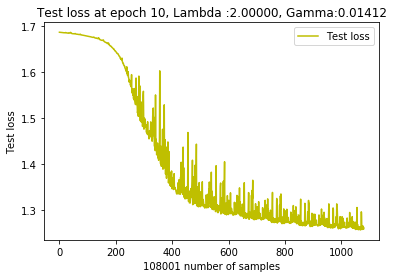

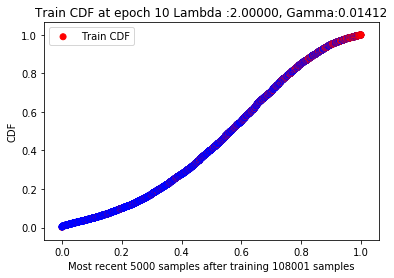

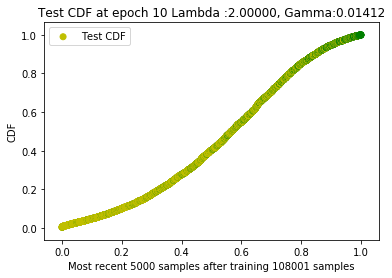

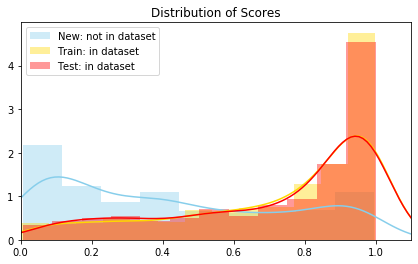

 80%|████████  | 8004/10000 [1:00:47<1:20:19,  2.41s/it]

New score:  0.43678007
Train score:  0.71873146
Test score:  0.71426946


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  11  with learning rate:  0.012709329141645007


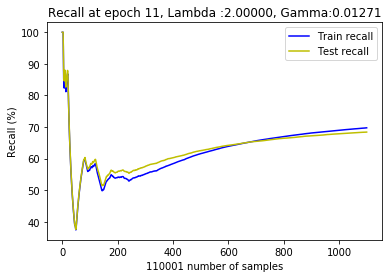

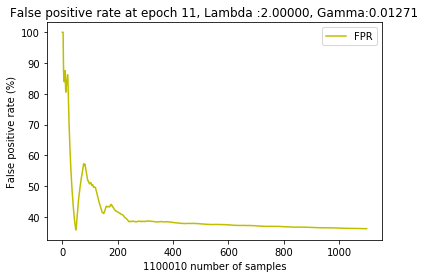

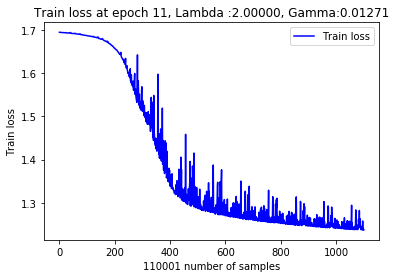

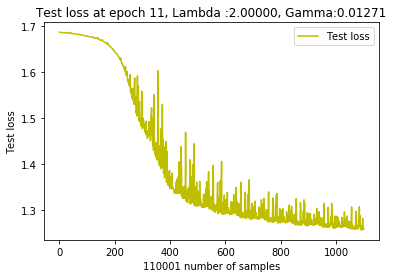

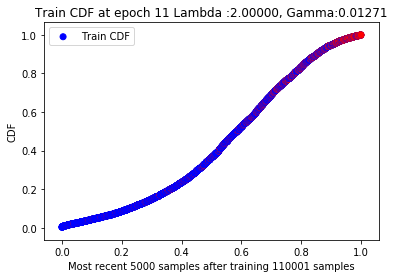

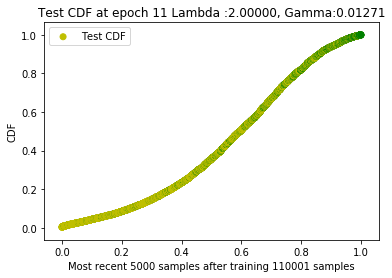

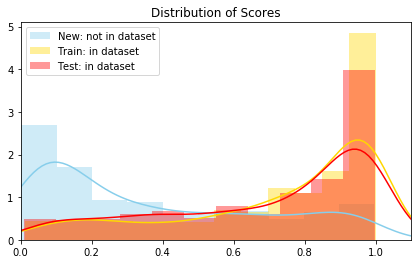

  0%|          | 5/10000 [00:44<86:51:52, 31.29s/it] 

New score:  0.35240412
Train score:  0.72616893
Test score:  0.6950008


 20%|█▉        | 1998/10000 [15:10<05:07, 26.06it/s]   

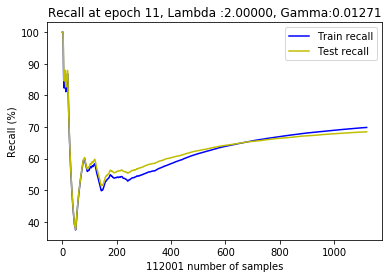

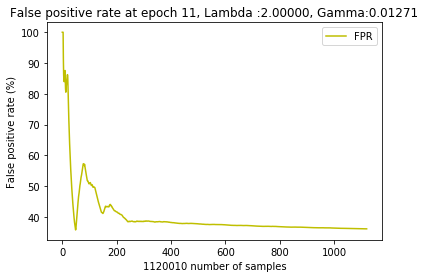

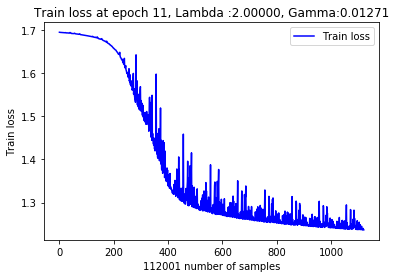

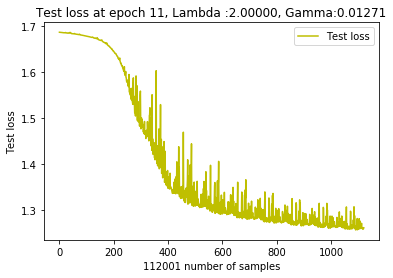

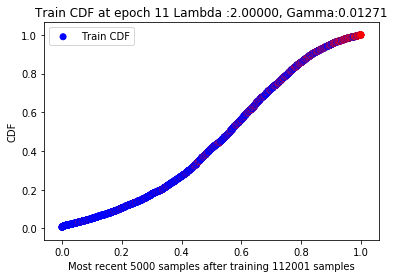

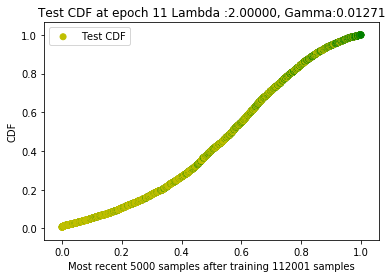

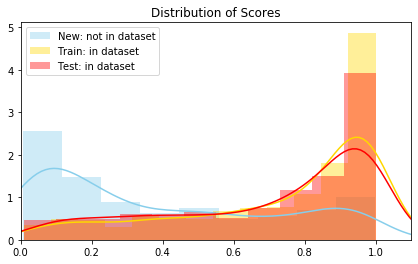

 20%|██        | 2004/10000 [15:41<6:49:33,  3.07s/it]

New score:  0.37647545
Train score:  0.731901
Test score:  0.7220043


 40%|███▉      | 3999/10000 [30:10<03:17, 30.46it/s]   

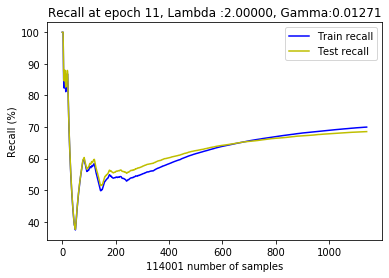

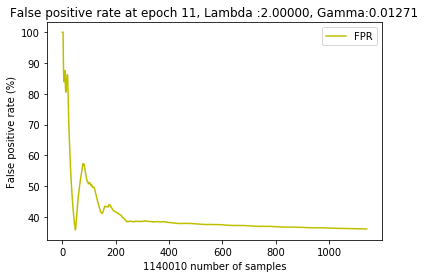

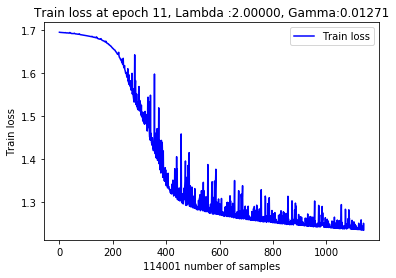

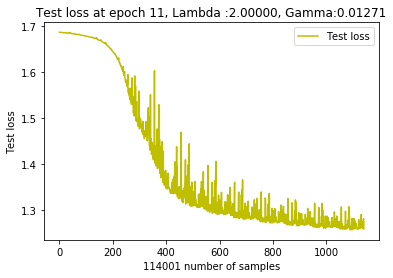

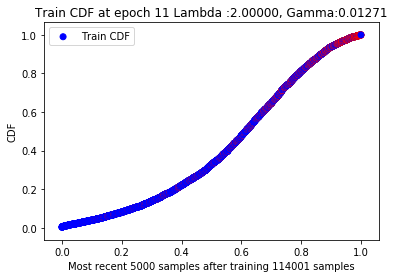

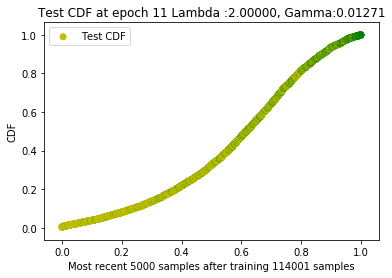

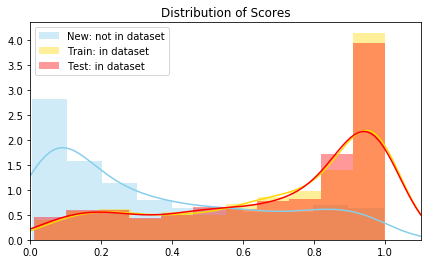

 40%|████      | 4004/10000 [30:40<8:03:22,  4.84s/it] 

New score:  0.35247126
Train score:  0.69932926
Test score:  0.6881816


 60%|█████▉    | 5999/10000 [44:50<02:07, 31.46it/s]   

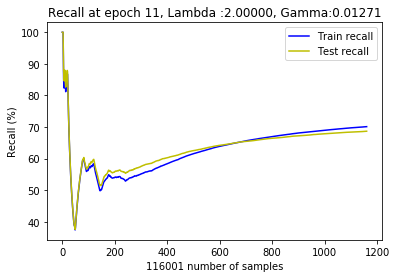

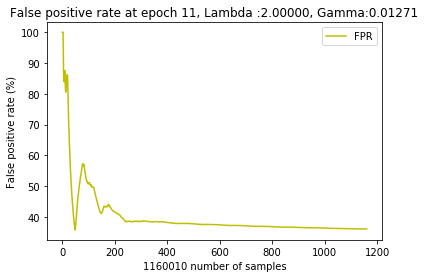

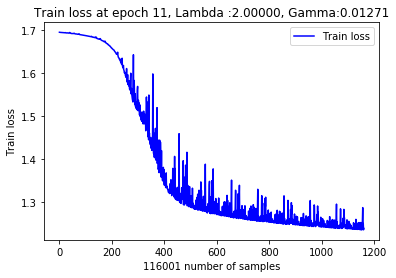

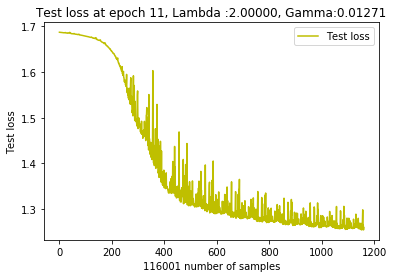

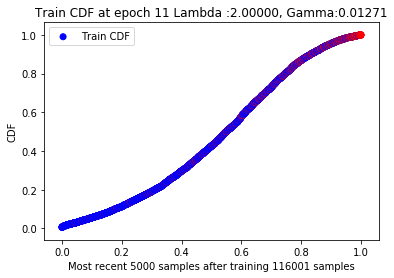

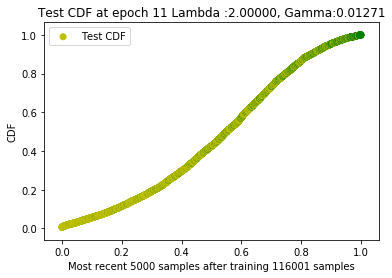

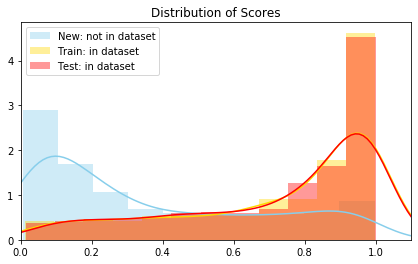

 60%|██████    | 6005/10000 [45:17<4:56:05,  4.45s/it]

New score:  0.34855604
Train score:  0.72351915
Test score:  0.73679847


 80%|███████▉  | 7997/10000 [59:30<01:05, 30.58it/s]   

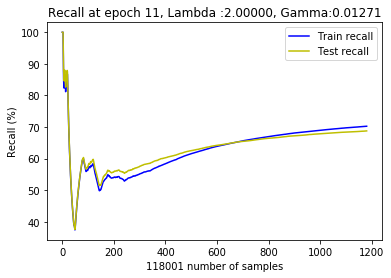

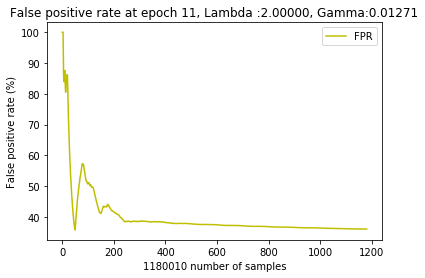

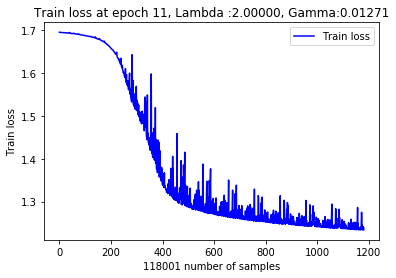

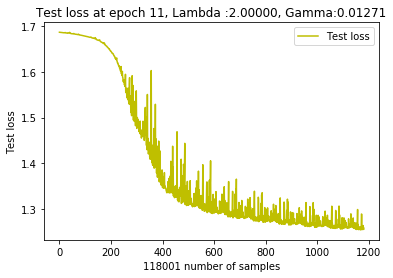

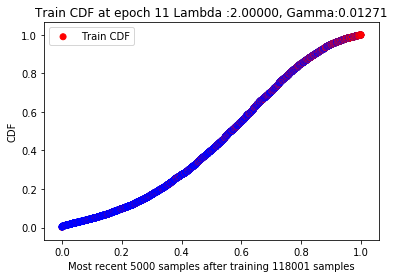

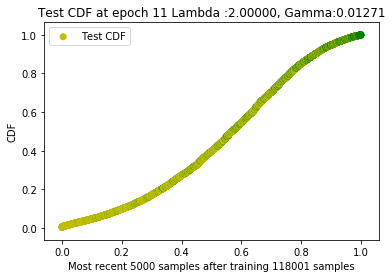

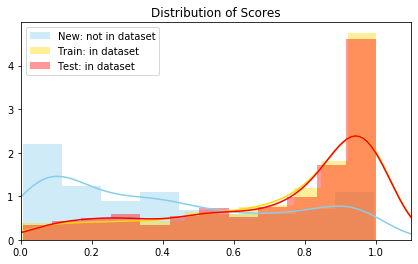

 80%|████████  | 8005/10000 [59:58<1:17:23,  2.33s/it]

New score:  0.43362474
Train score:  0.7190264
Test score:  0.71379143


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  12  with learning rate:  0.011438396227480507


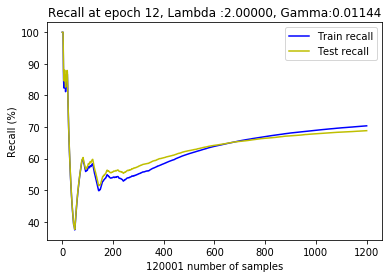

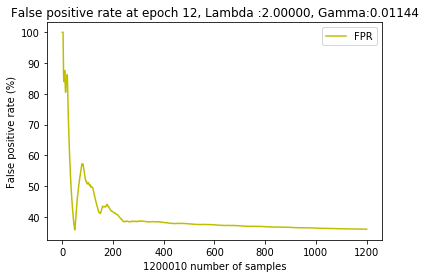

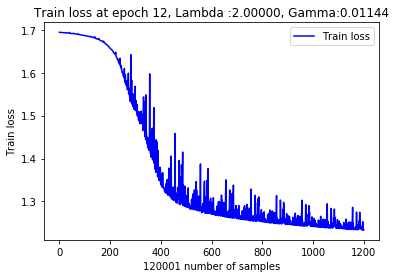

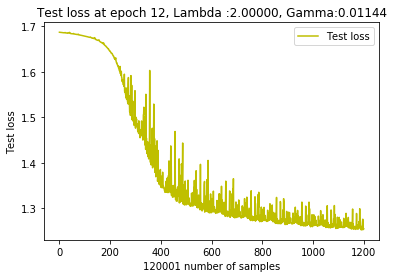

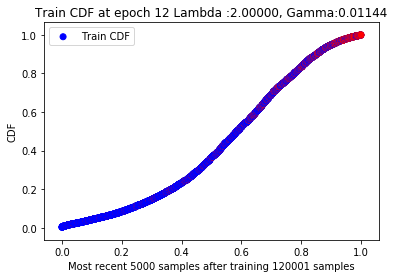

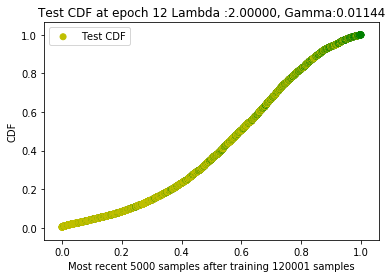

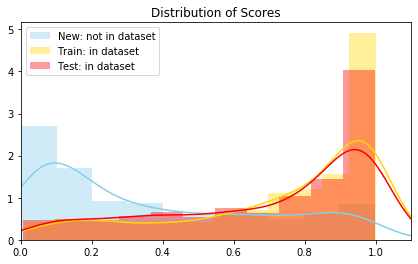

  0%|          | 5/10000 [00:43<83:22:39, 30.03s/it] 

New score:  0.3526471
Train score:  0.7277967
Test score:  0.69645756


 20%|█▉        | 1997/10000 [14:50<05:02, 26.45it/s]   

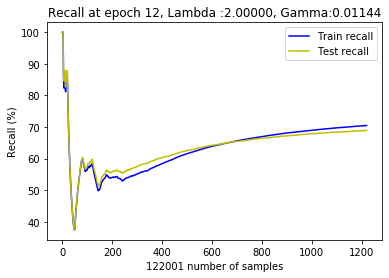

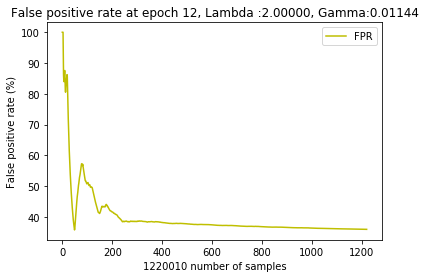

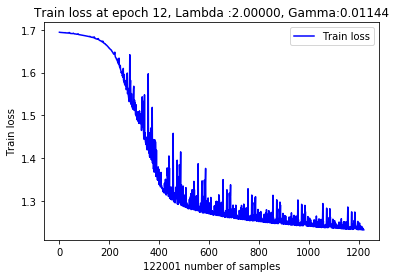

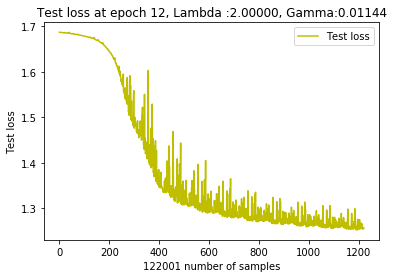

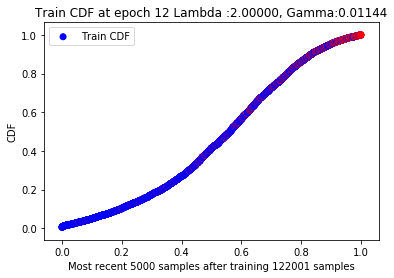

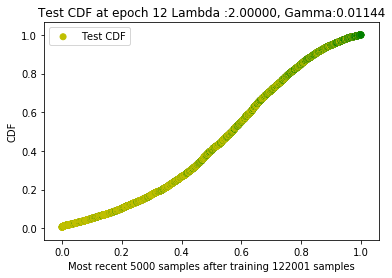

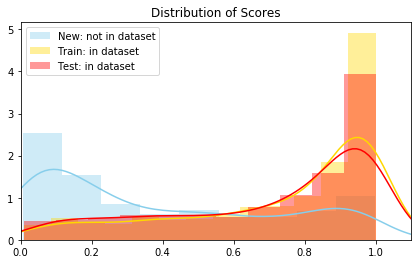

 20%|██        | 2005/10000 [15:22<5:04:51,  2.29s/it]

New score:  0.37701714
Train score:  0.73473644
Test score:  0.7245953


 40%|████      | 4000/10000 [29:40<03:20, 29.95it/s]   

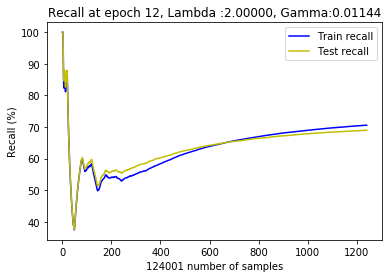

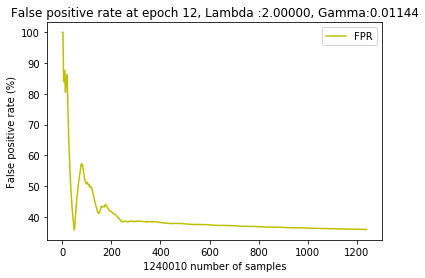

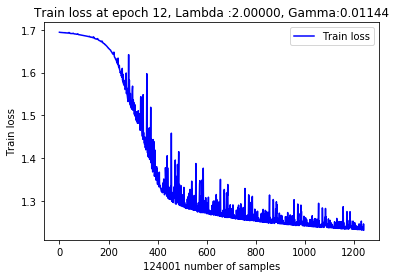

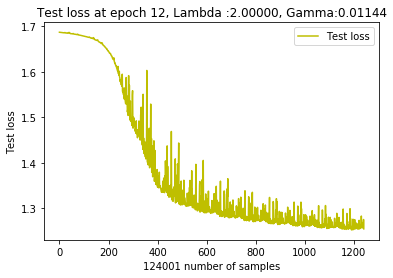

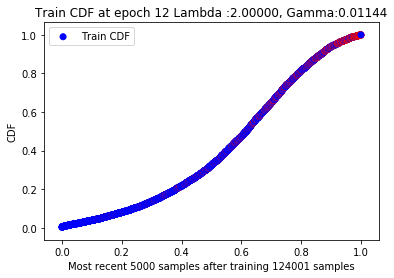

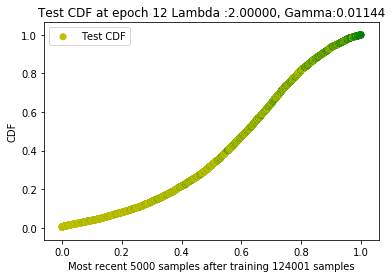

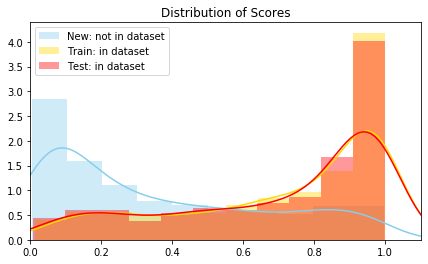

 40%|████      | 4005/10000 [30:04<14:58:24,  8.99s/it]

New score:  0.34953853
Train score:  0.7014607
Test score:  0.6902534


 60%|██████    | 6000/10000 [44:10<02:02, 32.68it/s]   

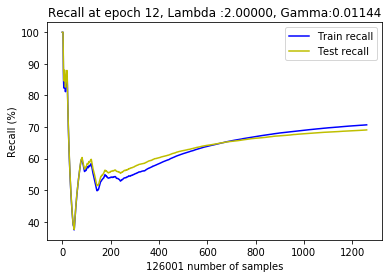

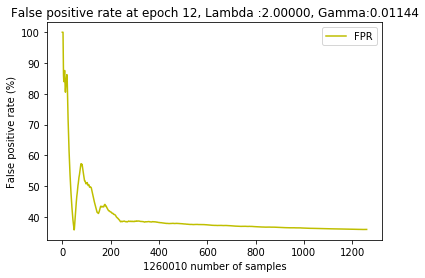

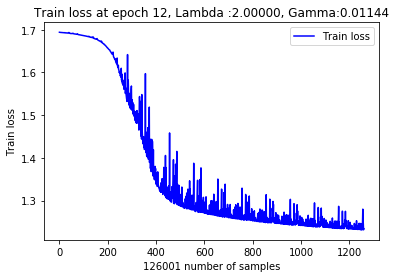

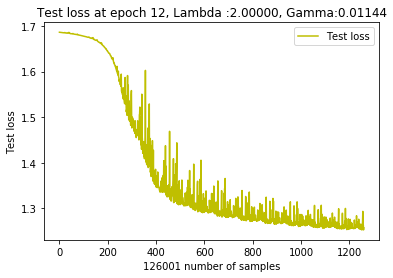

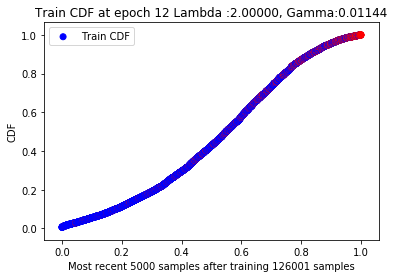

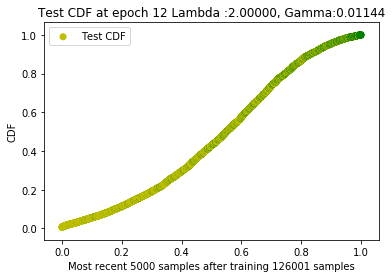

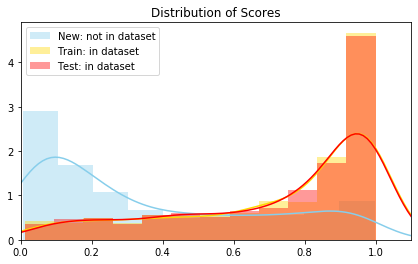

 60%|██████    | 6005/10000 [44:39<9:55:31,  8.94s/it] 

New score:  0.35004795
Train score:  0.7258896
Test score:  0.73934835


 80%|████████  | 8000/10000 [58:50<01:01, 32.36it/s]   

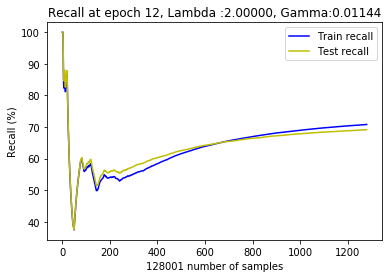

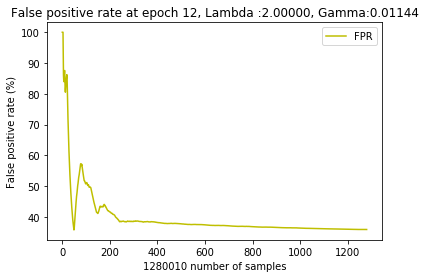

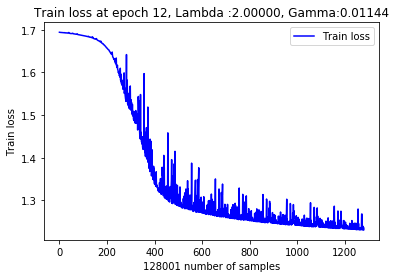

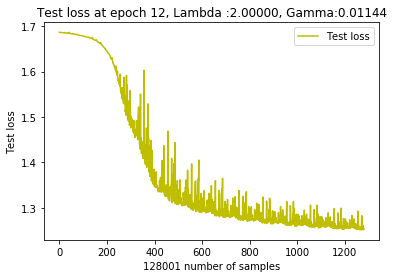

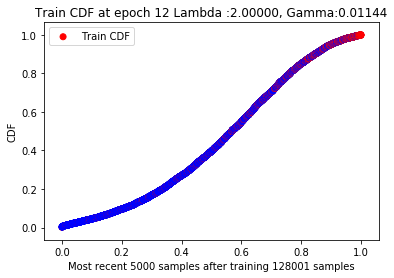

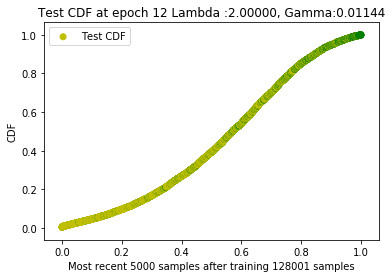

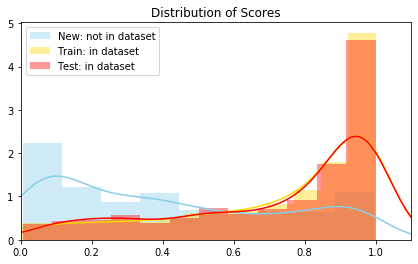

 80%|████████  | 8005/10000 [59:15<5:03:14,  9.12s/it]

New score:  0.43058914
Train score:  0.7194104
Test score:  0.7135559


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  13  with learning rate:  0.010294556604732457


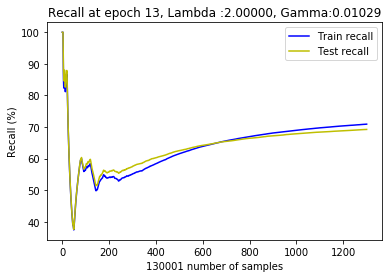

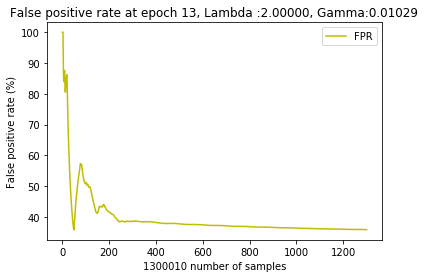

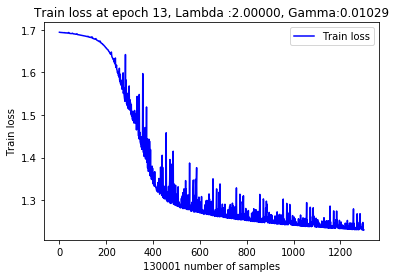

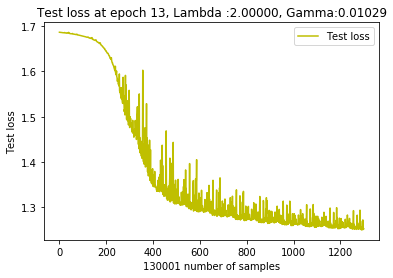

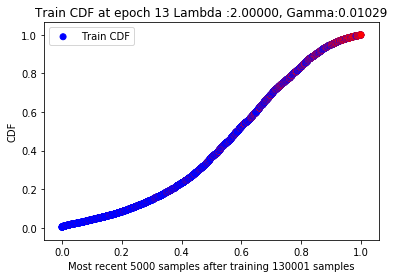

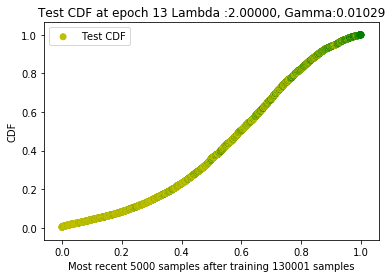

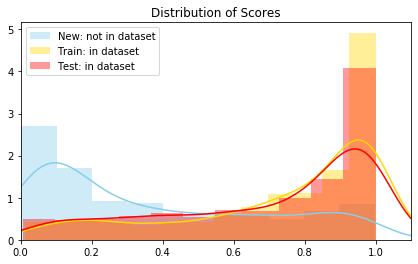

  0%|          | 5/10000 [00:43<83:30:47, 30.08s/it] 

New score:  0.35265782
Train score:  0.72924024
Test score:  0.6977489


 20%|█▉        | 1997/10000 [14:50<05:01, 26.56it/s]   

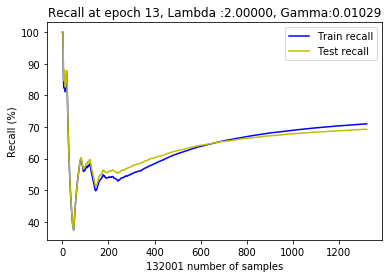

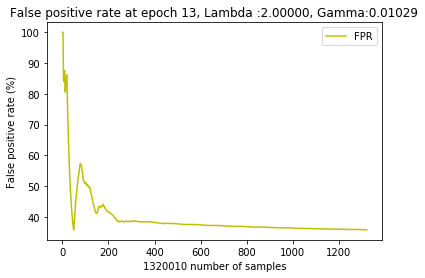

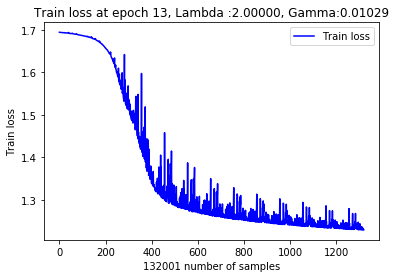

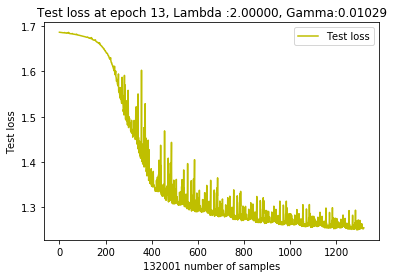

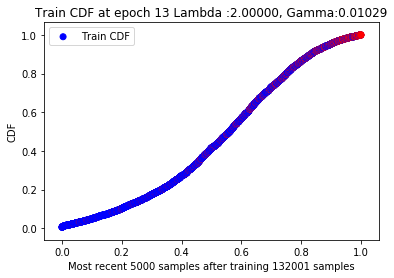

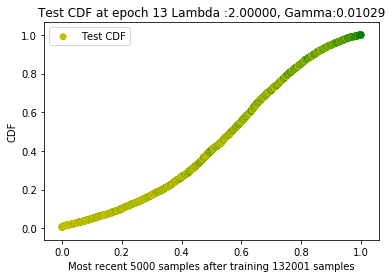

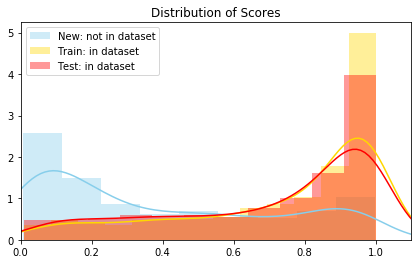

 20%|██        | 2005/10000 [15:21<5:10:19,  2.33s/it]

New score:  0.3779257
Train score:  0.7371069
Test score:  0.72663844


 40%|████      | 4000/10000 [29:40<03:19, 30.12it/s]   

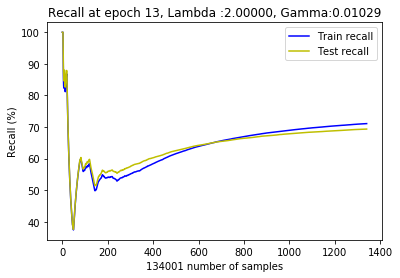

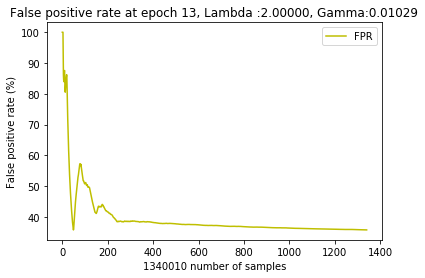

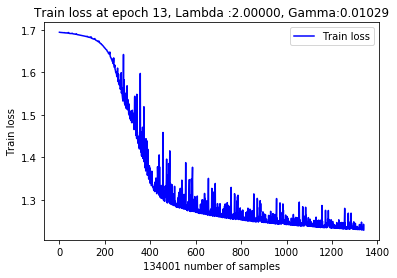

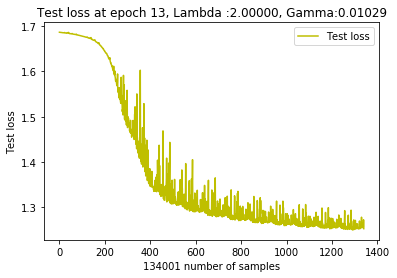

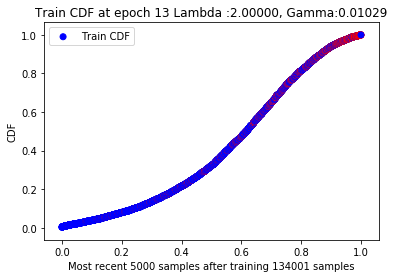

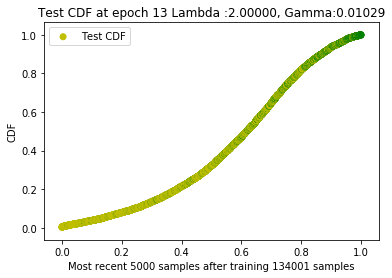

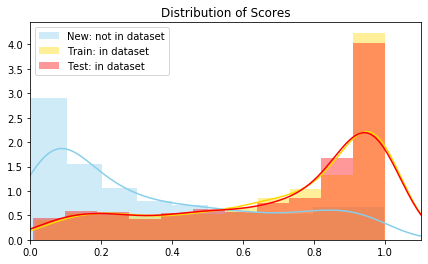

 40%|████      | 4005/10000 [30:09<15:28:50,  9.30s/it]

New score:  0.34755218
Train score:  0.7033065
Test score:  0.69205475


 60%|█████▉    | 5997/10000 [44:20<02:05, 31.99it/s]   

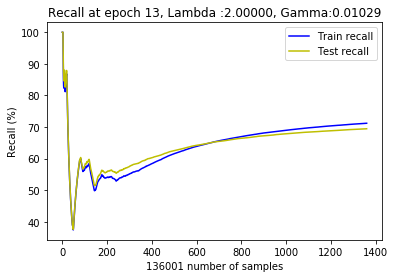

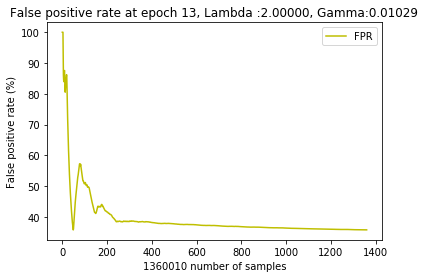

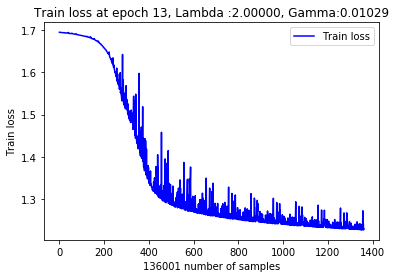

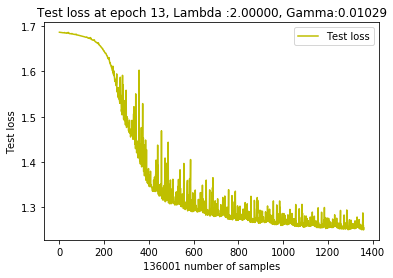

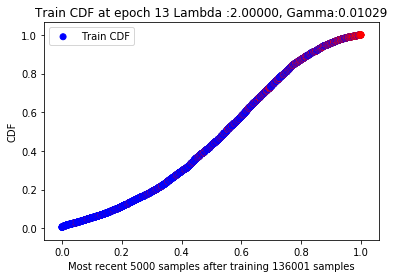

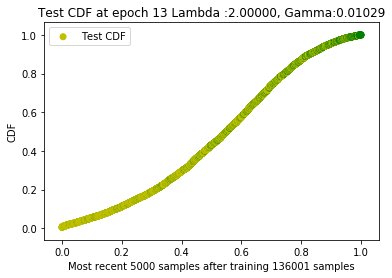

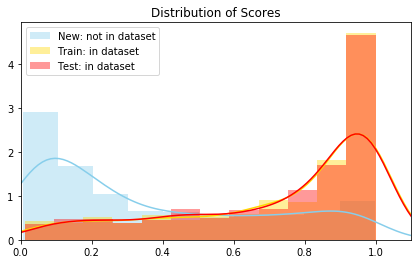

 60%|██████    | 6005/10000 [44:46<2:36:20,  2.35s/it]

New score:  0.35130912
Train score:  0.7279409
Test score:  0.7414887


 80%|███████▉  | 7997/10000 [58:50<01:05, 30.51it/s]   

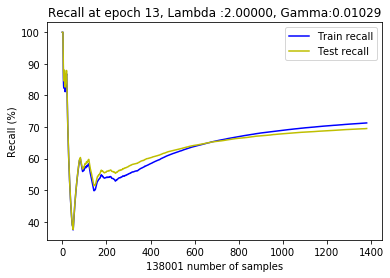

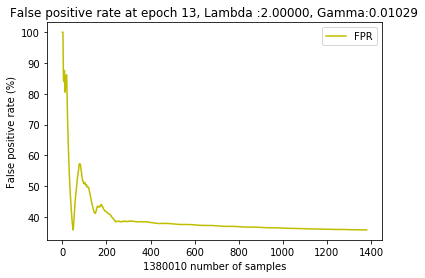

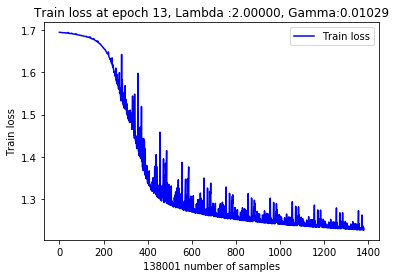

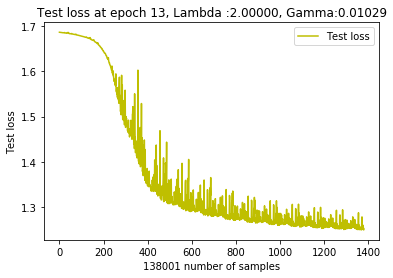

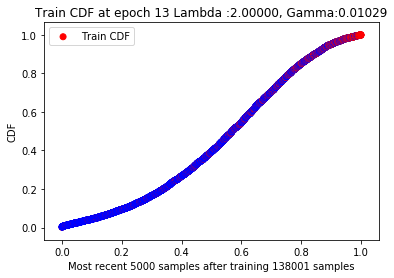

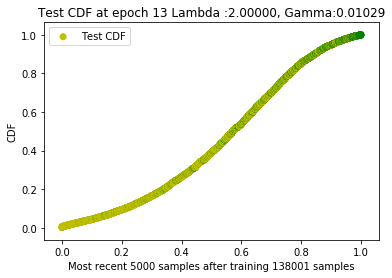

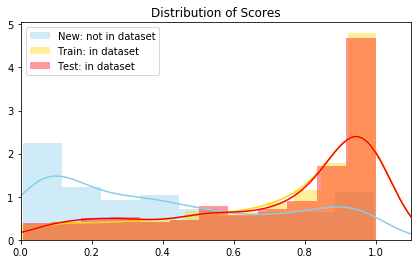

 80%|████████  | 8005/10000 [59:20<1:20:04,  2.41s/it]

New score:  0.42824396
Train score:  0.71998316
Test score:  0.7134705


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  14  with learning rate:  0.00926510094425921


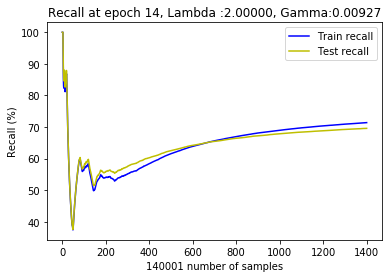

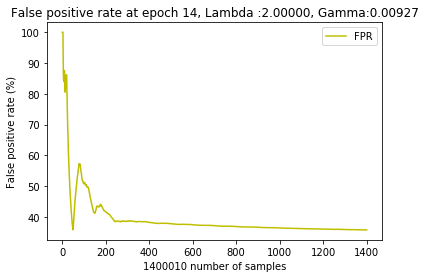

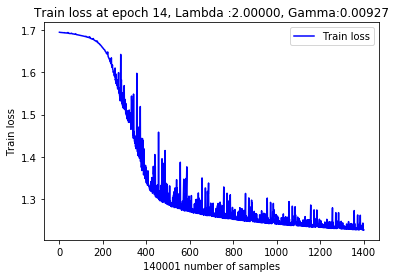

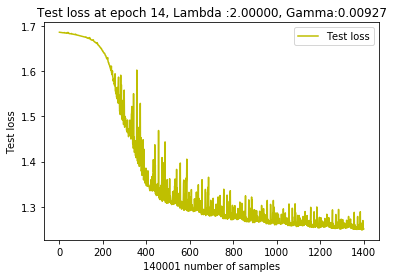

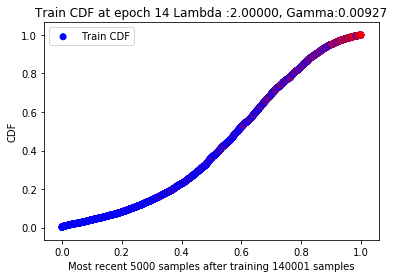

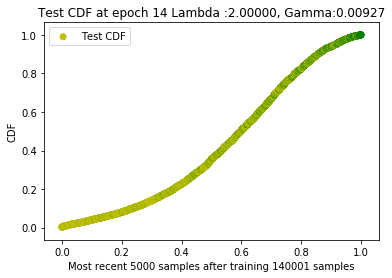

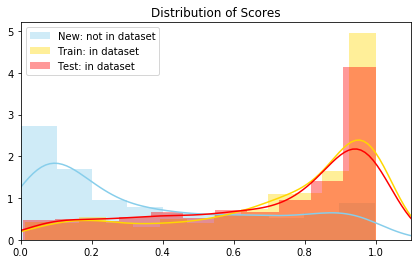

  0%|          | 5/10000 [00:43<84:54:57, 30.59s/it] 

New score:  0.35247037
Train score:  0.73054856
Test score:  0.6989279


 20%|██        | 2000/10000 [14:50<04:57, 26.85it/s]   

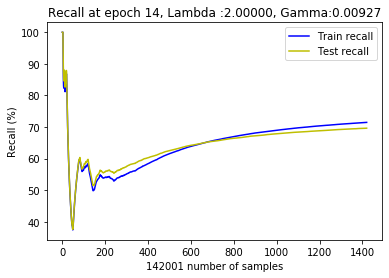

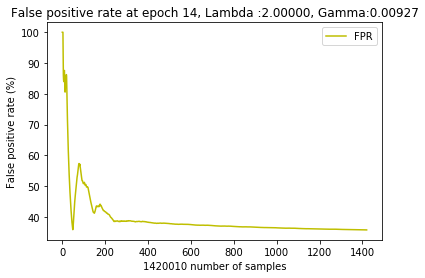

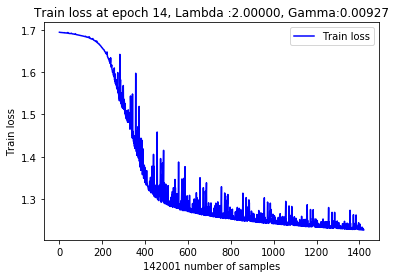

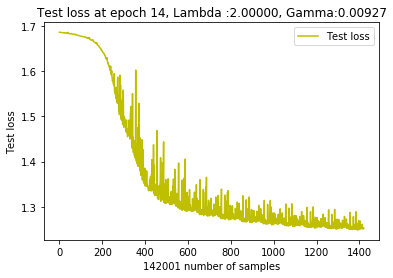

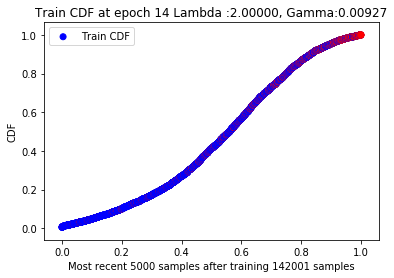

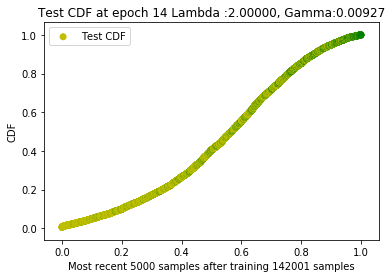

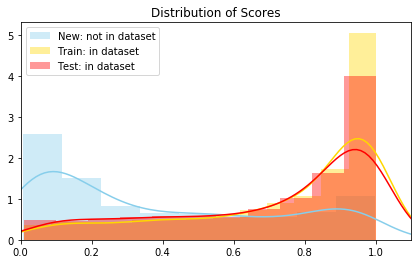

 20%|██        | 2005/10000 [15:22<20:09:42,  9.08s/it]

New score:  0.3783003
Train score:  0.73861295
Test score:  0.72780395


 40%|████      | 4000/10000 [29:30<03:17, 30.44it/s]   

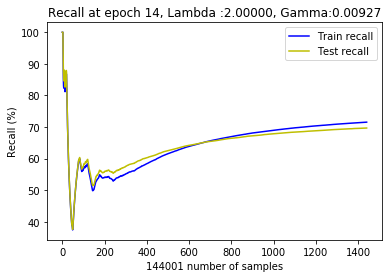

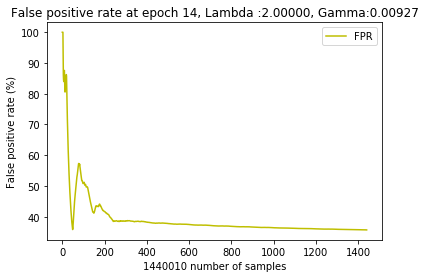

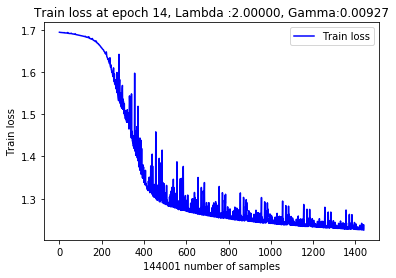

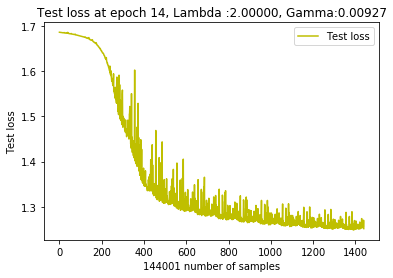

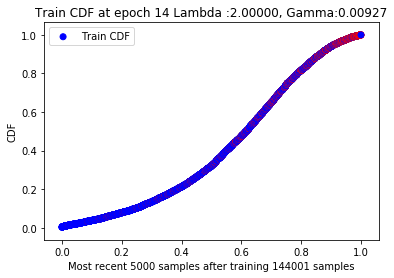

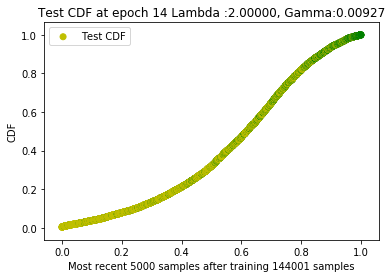

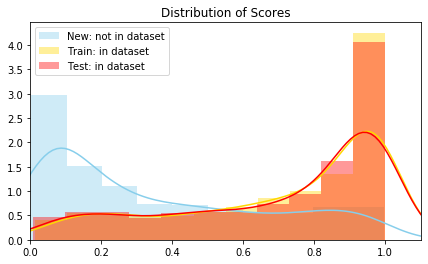

 40%|████      | 4005/10000 [30:00<14:59:25,  9.00s/it]

New score:  0.34576252
Train score:  0.7052132
Test score:  0.69389904


 60%|█████▉    | 5999/10000 [44:10<02:08, 31.14it/s]   

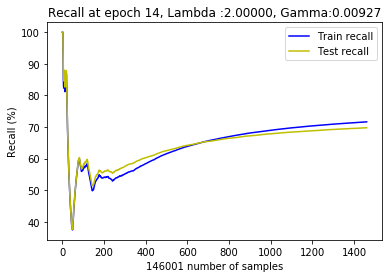

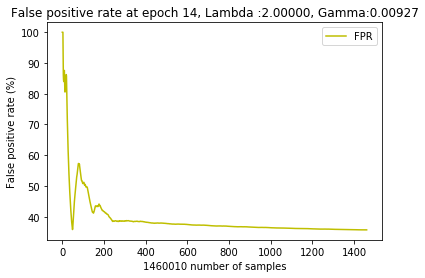

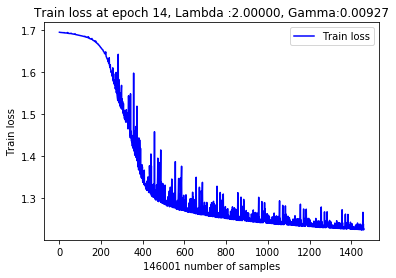

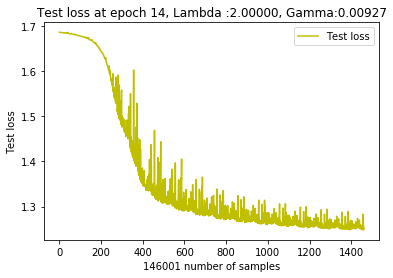

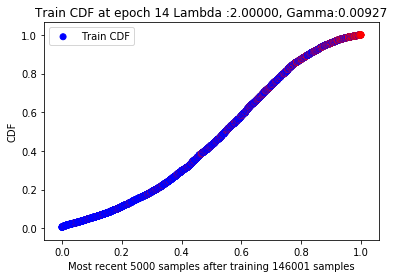

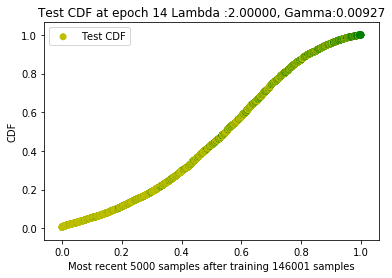

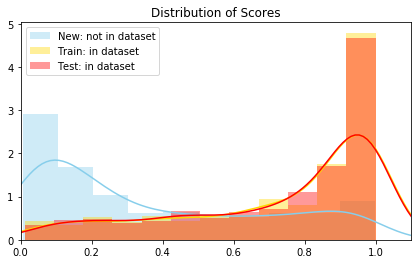

 60%|██████    | 6005/10000 [44:37<5:01:24,  4.53s/it]

New score:  0.35324997
Train score:  0.72982264
Test score:  0.7434348


 80%|███████▉  | 7997/10000 [58:50<01:02, 32.02it/s]   

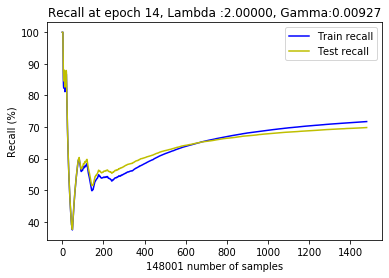

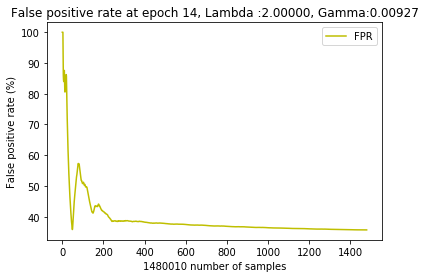

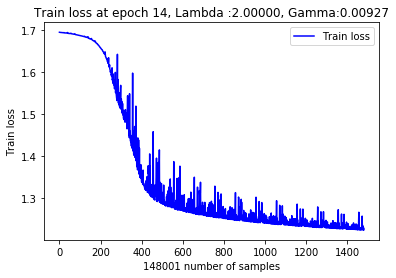

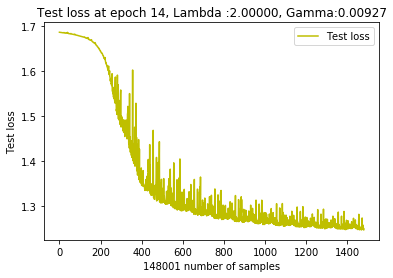

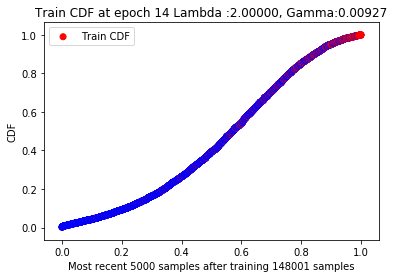

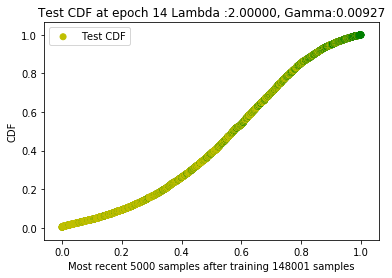

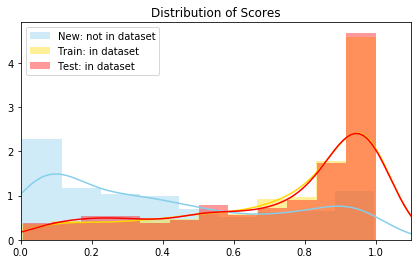

 80%|████████  | 8005/10000 [59:14<1:16:36,  2.30s/it]

New score:  0.4263367
Train score:  0.72052807
Test score:  0.7134646


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  15  with learning rate:  0.00833859084983329


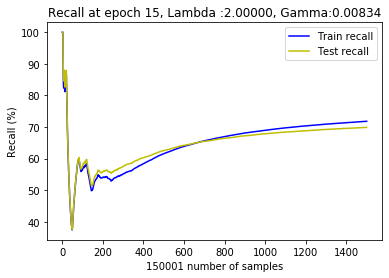

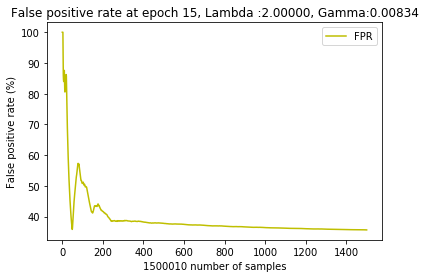

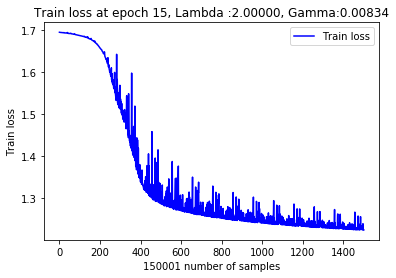

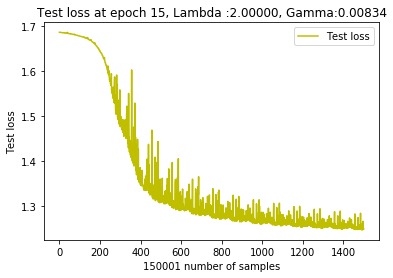

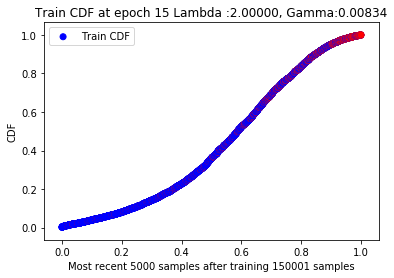

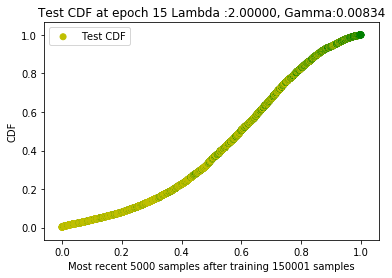

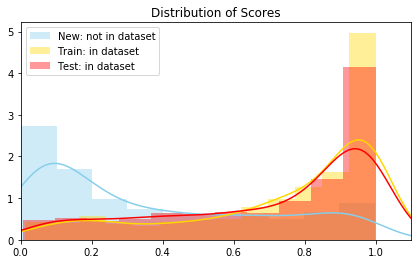

  0%|          | 5/10000 [00:43<84:50:17, 30.56s/it] 

New score:  0.35252532
Train score:  0.7317515
Test score:  0.7000065


 20%|█▉        | 1997/10000 [14:50<05:07, 26.02it/s]   

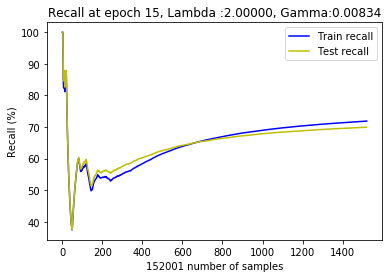

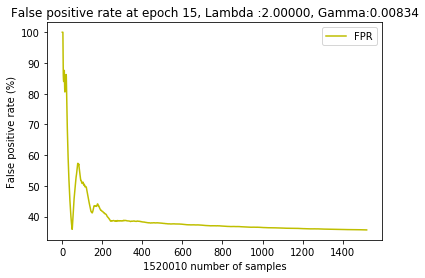

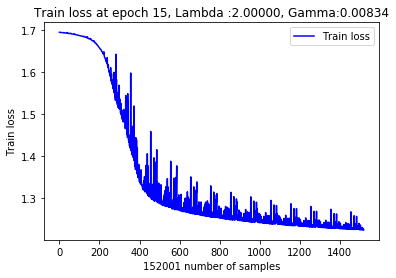

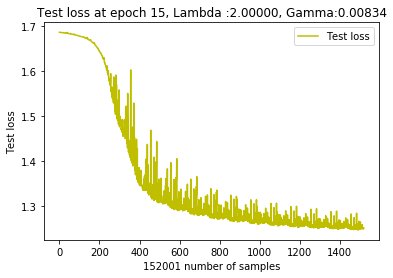

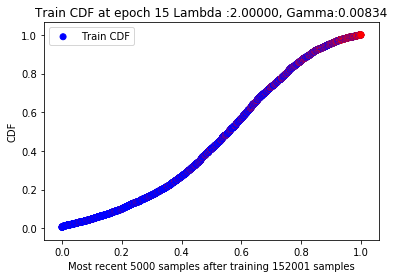

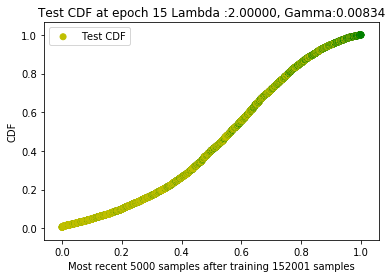

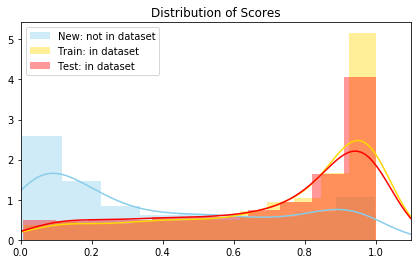

 20%|██        | 2004/10000 [15:21<5:05:34,  2.29s/it]

New score:  0.37870166
Train score:  0.7399552
Test score:  0.7287871


 40%|████      | 4000/10000 [29:30<03:18, 30.23it/s]   

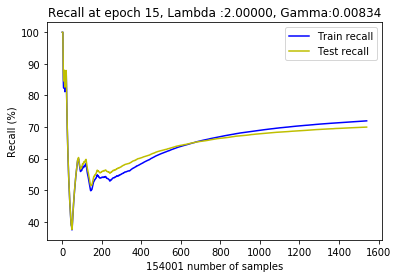

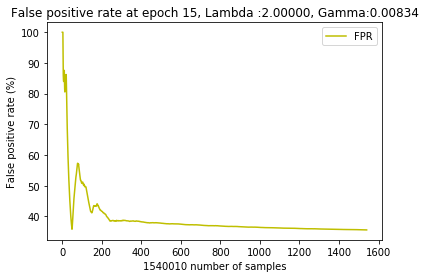

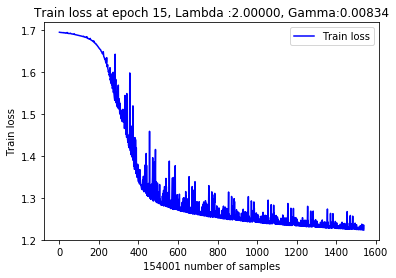

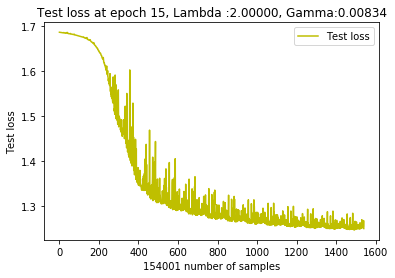

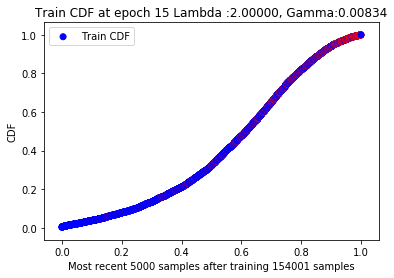

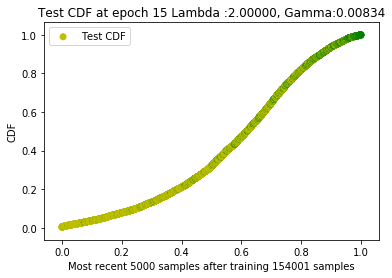

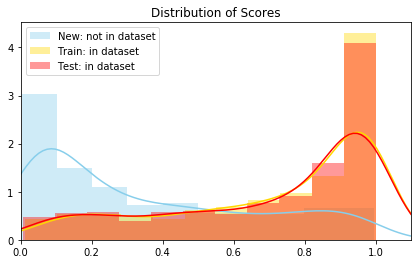

 40%|████      | 4005/10000 [30:01<15:01:42,  9.02s/it]

New score:  0.34385324
Train score:  0.70673674
Test score:  0.69536364


 60%|██████    | 6000/10000 [44:10<02:04, 32.00it/s]   

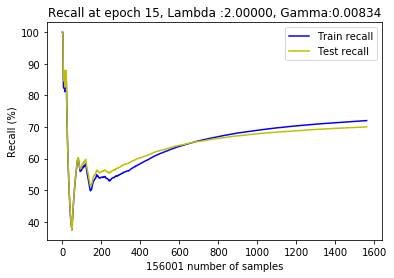

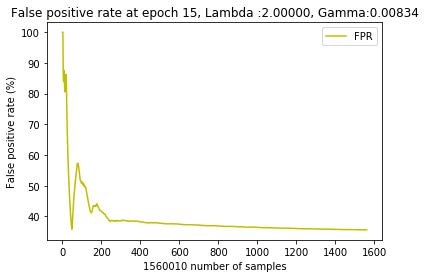

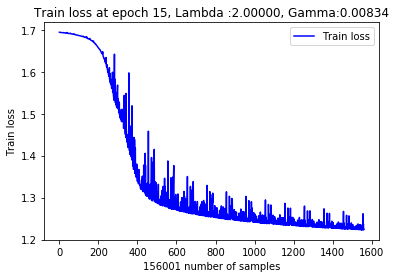

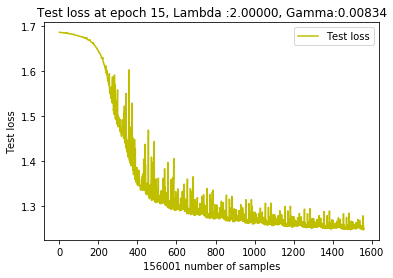

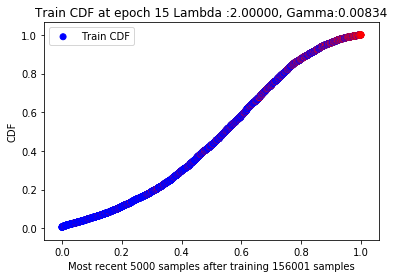

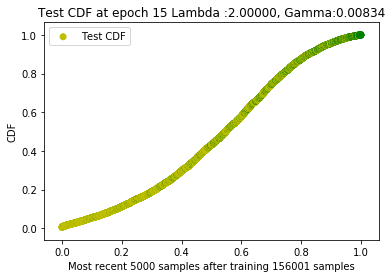

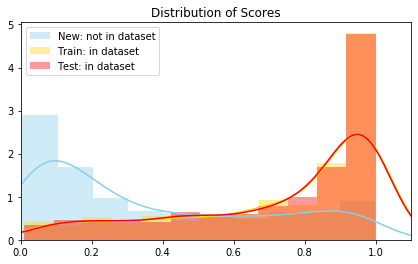

 60%|██████    | 6005/10000 [44:42<10:00:16,  9.02s/it]

New score:  0.35510334
Train score:  0.73156655
Test score:  0.7450639


 80%|████████  | 8000/10000 [58:50<01:01, 32.61it/s]   

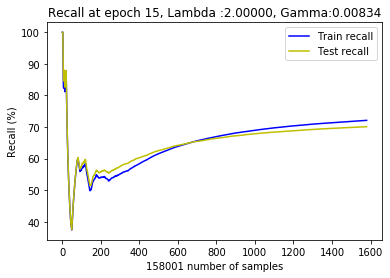

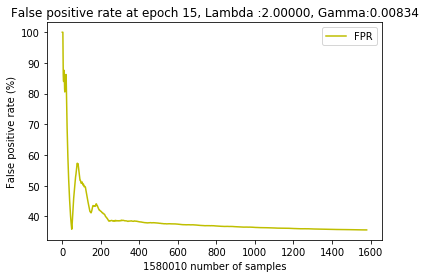

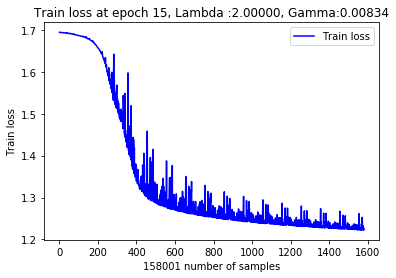

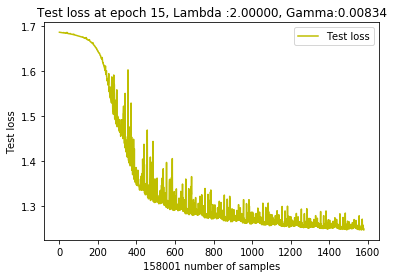

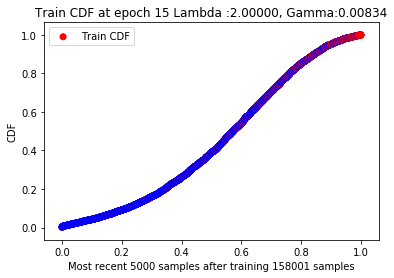

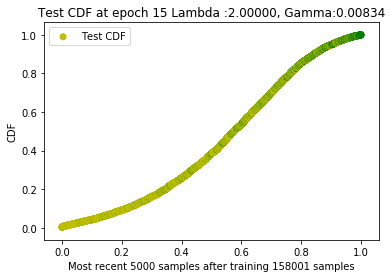

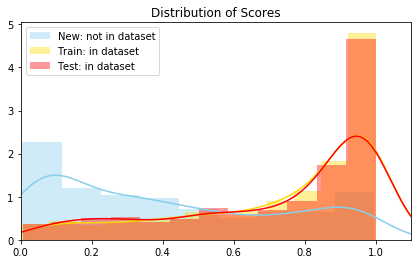

 80%|████████  | 8004/10000 [59:18<5:03:27,  9.12s/it]

New score:  0.42369953
Train score:  0.72077626
Test score:  0.7131642


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  16  with learning rate:  0.007504731764849962


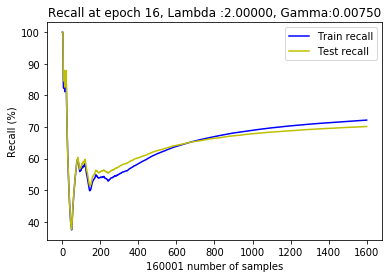

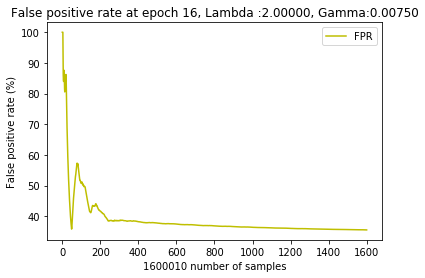

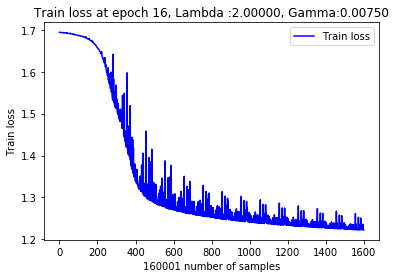

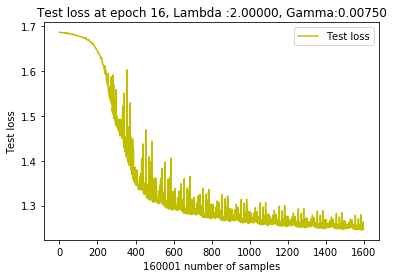

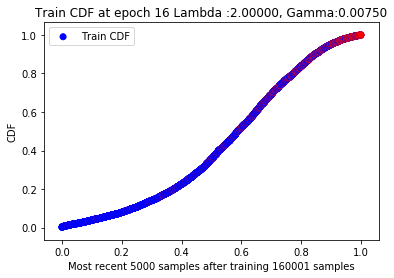

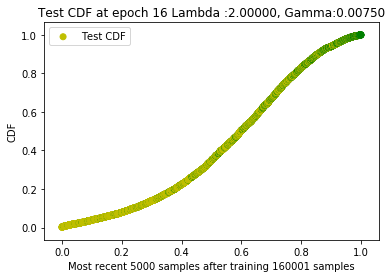

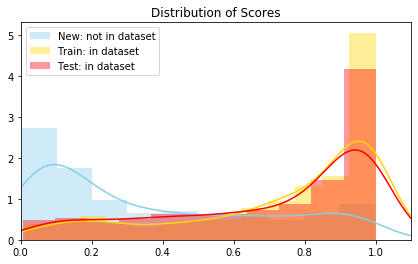

  0%|          | 4/10000 [00:43<83:53:28, 30.21s/it] 

New score:  0.35198054
Train score:  0.7328422
Test score:  0.7009097


 20%|█▉        | 1999/10000 [14:50<05:04, 26.29it/s]   

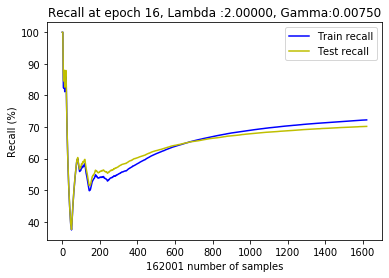

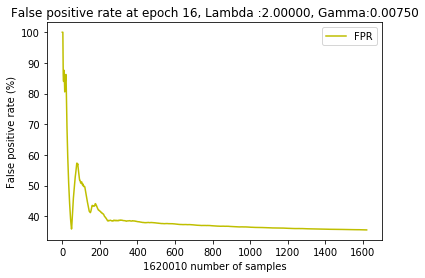

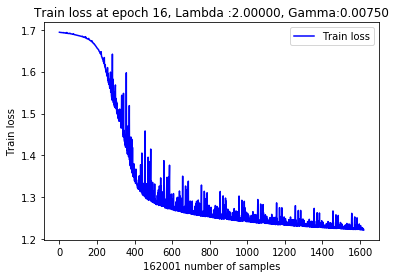

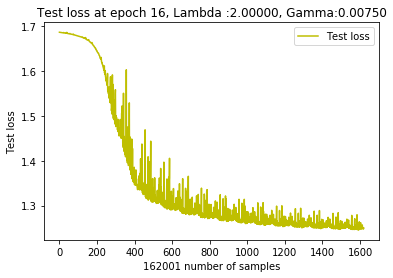

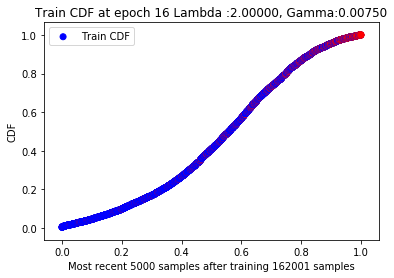

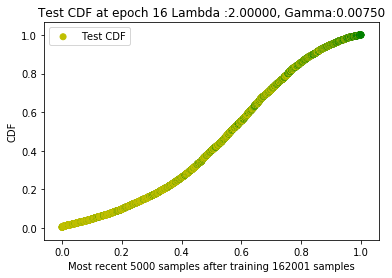

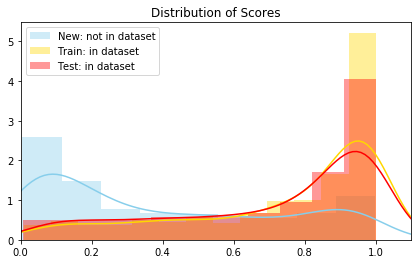

 20%|██        | 2004/10000 [15:21<10:05:24,  4.54s/it]

New score:  0.3795301
Train score:  0.74134624
Test score:  0.72973984


 40%|████      | 4000/10000 [29:30<03:24, 29.38it/s]   

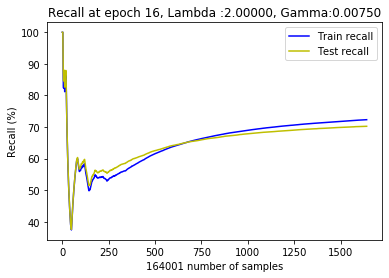

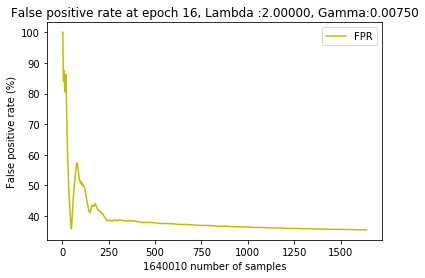

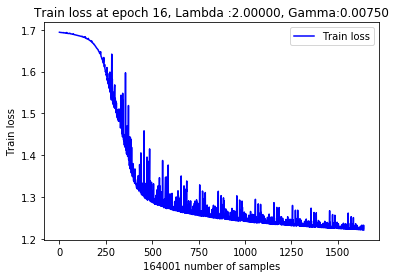

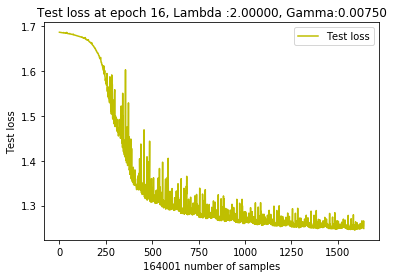

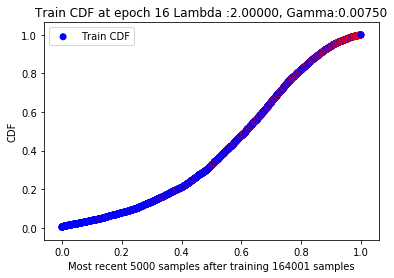

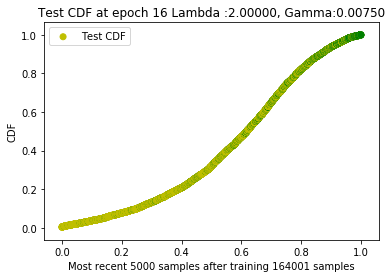

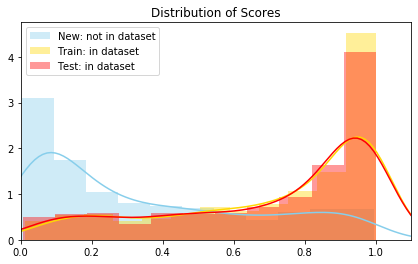

 40%|████      | 4005/10000 [30:00<15:07:04,  9.08s/it]

New score:  0.34160185
Train score:  0.70830005
Test score:  0.69679993


 60%|█████▉    | 5999/10000 [44:10<02:08, 31.24it/s]   

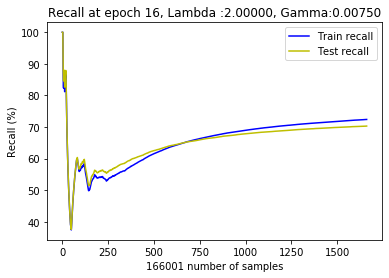

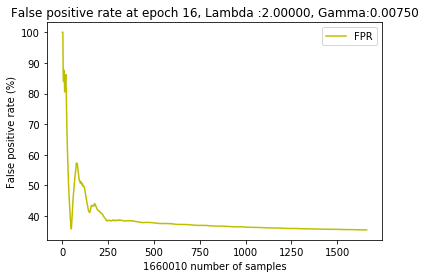

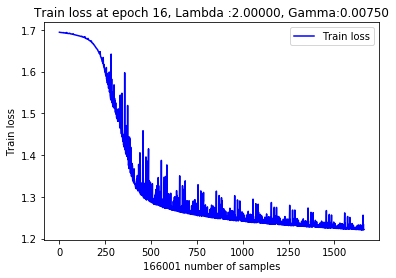

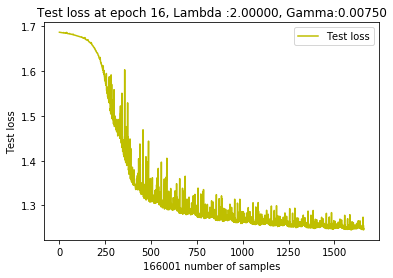

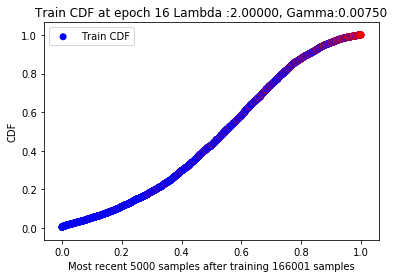

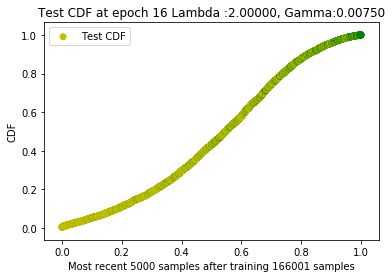

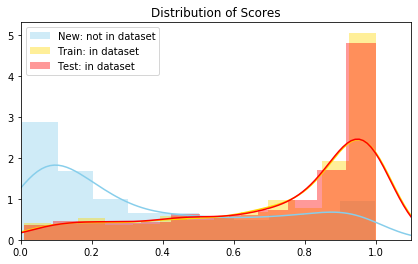

 60%|██████    | 6005/10000 [44:42<5:02:58,  4.55s/it]

New score:  0.35689843
Train score:  0.73287684
Test score:  0.746219


 80%|███████▉  | 7999/10000 [59:00<01:02, 31.96it/s]   

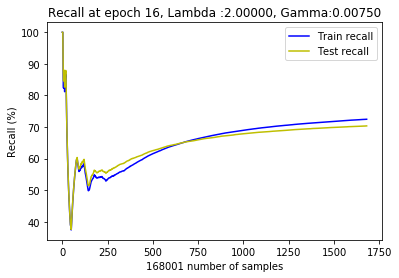

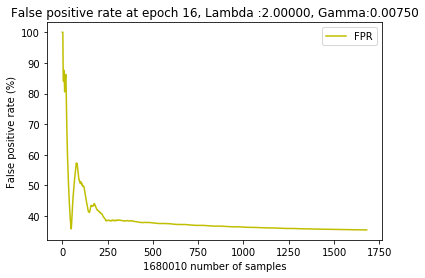

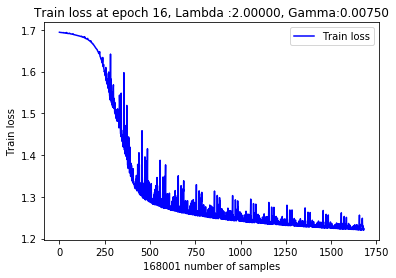

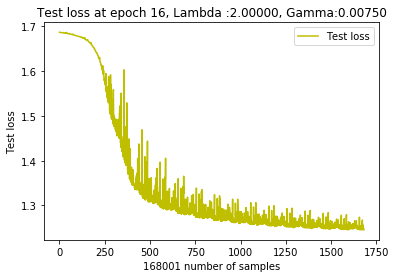

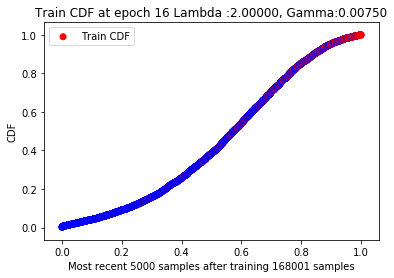

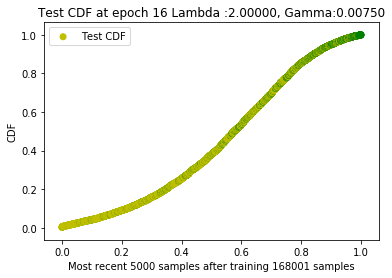

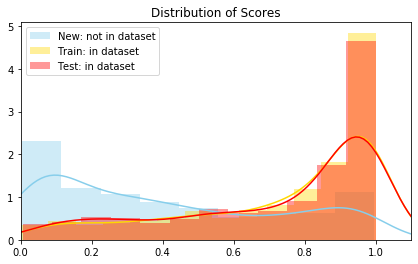

 80%|████████  | 8005/10000 [59:27<2:38:26,  4.77s/it]

New score:  0.42096373
Train score:  0.7208933
Test score:  0.7126896


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  17  with learning rate:  0.006754258588364966


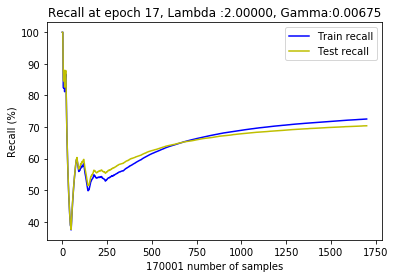

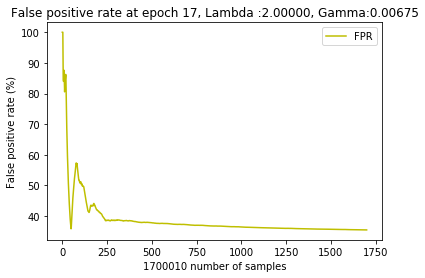

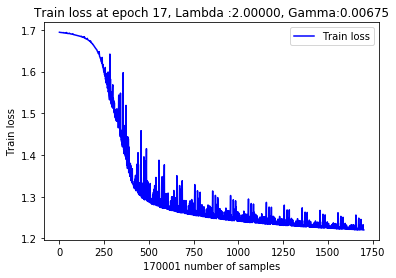

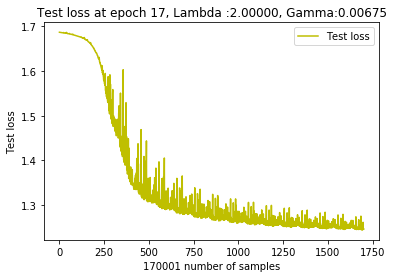

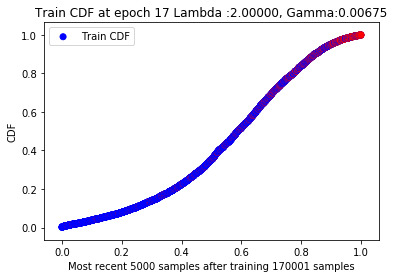

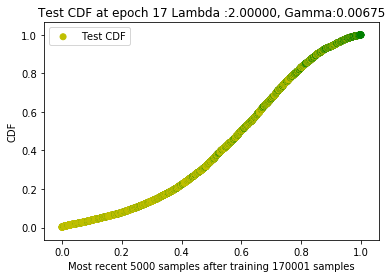

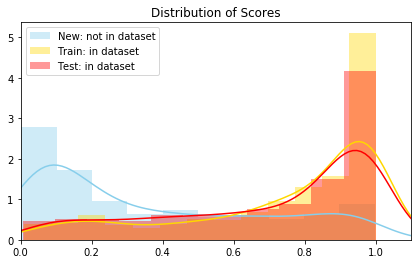

  0%|          | 5/10000 [00:43<83:35:14, 30.11s/it] 

New score:  0.35136017
Train score:  0.7339304
Test score:  0.70180345


 20%|█▉        | 1998/10000 [14:50<05:08, 25.90it/s]   

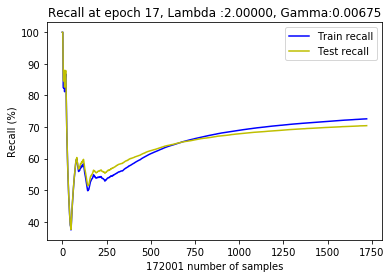

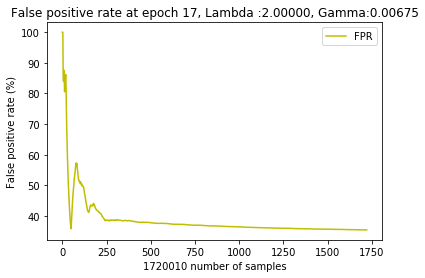

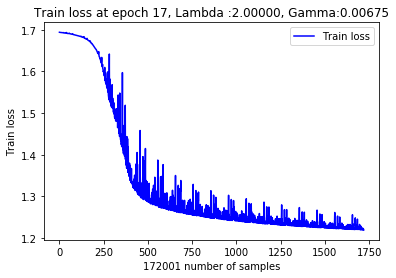

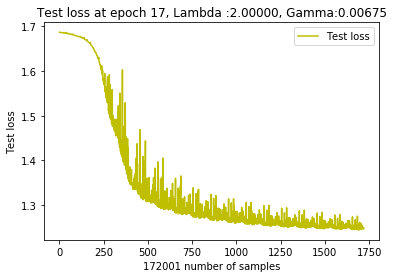

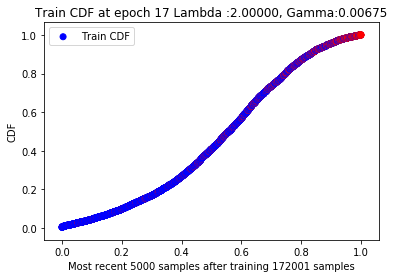

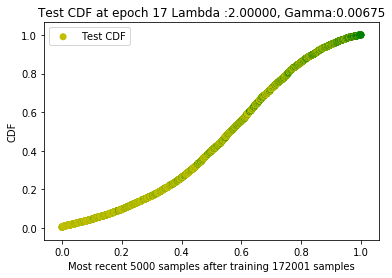

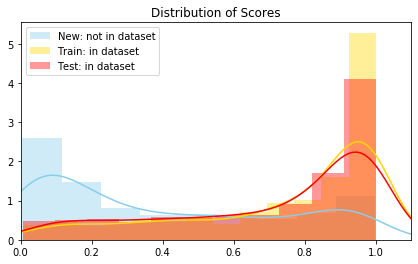

 20%|██        | 2005/10000 [15:21<6:45:44,  3.04s/it]

New score:  0.38035253
Train score:  0.74267644
Test score:  0.7305763


 40%|███▉      | 3999/10000 [29:30<03:24, 29.33it/s]   

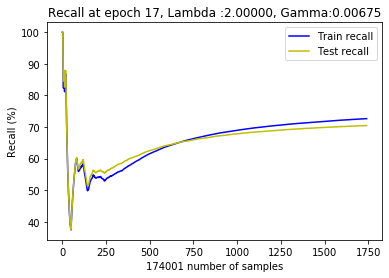

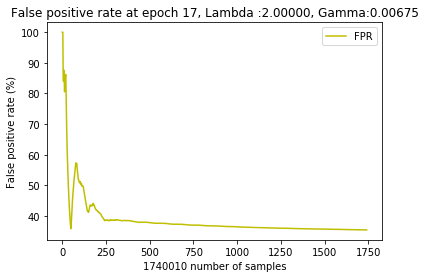

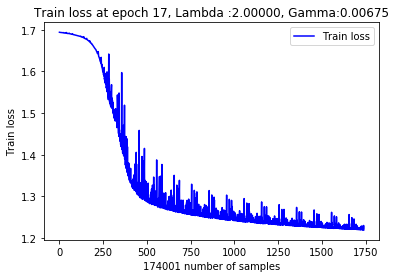

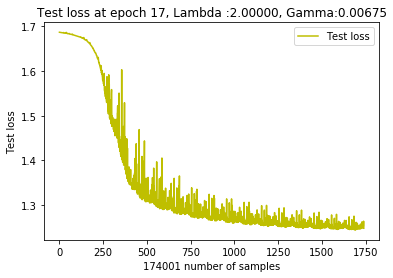

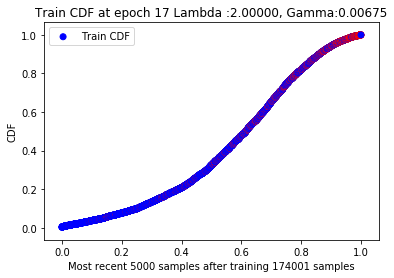

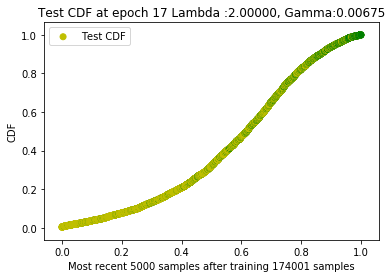

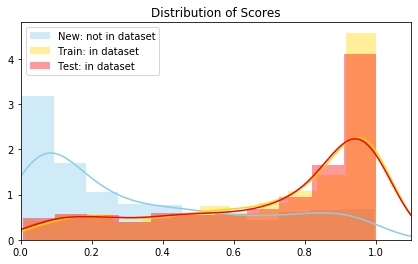

 40%|████      | 4005/10000 [30:01<7:30:09,  4.51s/it] 

New score:  0.3393496
Train score:  0.71004385
Test score:  0.69835484


 60%|██████    | 6000/10000 [44:10<02:10, 30.65it/s]   

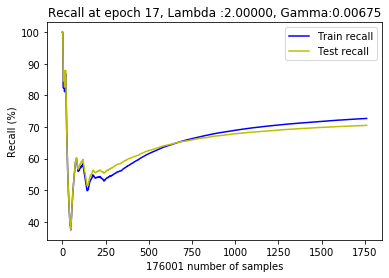

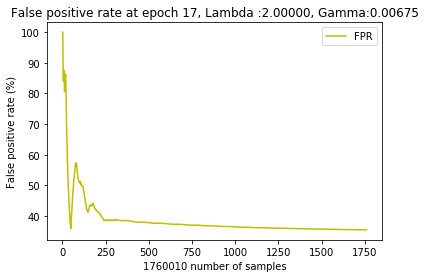

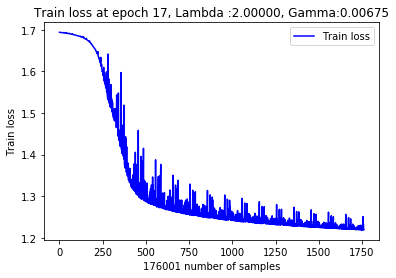

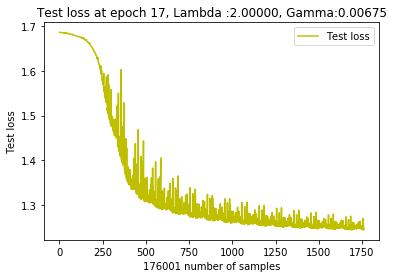

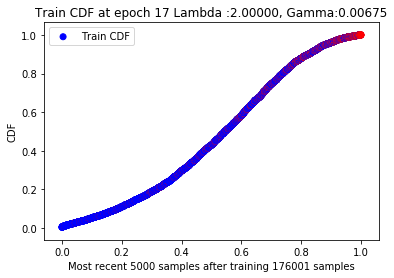

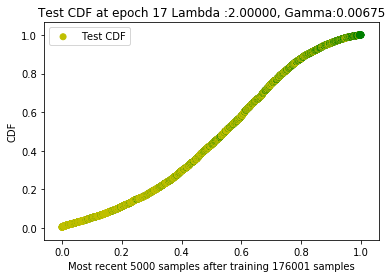

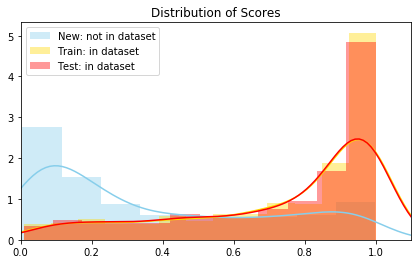

 60%|██████    | 6005/10000 [44:43<10:04:12,  9.07s/it]

New score:  0.35919496
Train score:  0.7338469
Test score:  0.74695164


 80%|███████▉  | 7997/10000 [59:00<01:01, 32.49it/s]   

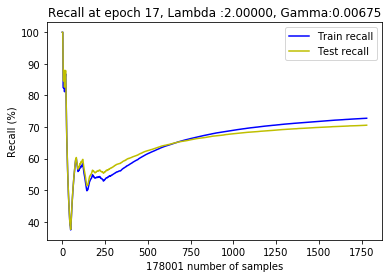

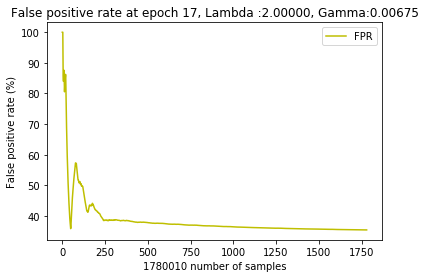

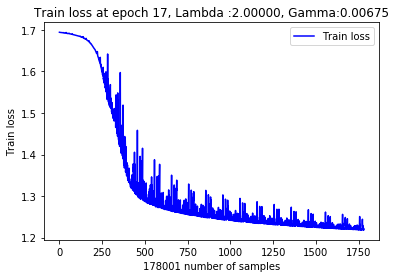

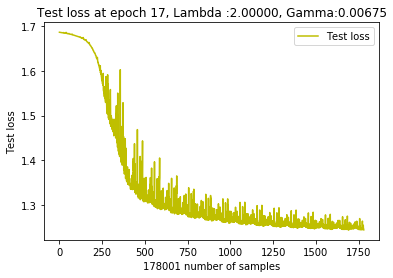

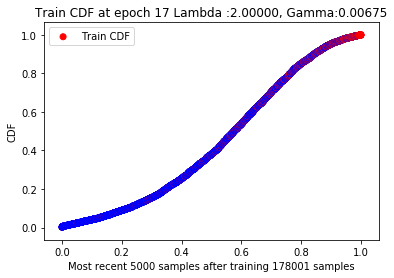

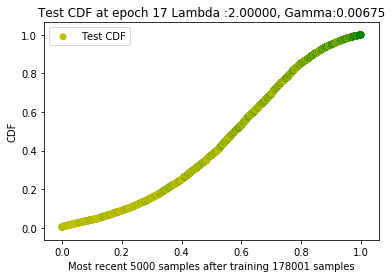

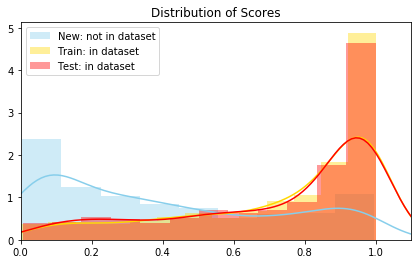

 80%|████████  | 8005/10000 [59:31<1:17:26,  2.33s/it]

New score:  0.41772205
Train score:  0.72097194
Test score:  0.7122465


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  18  with learning rate:  0.00607883272952847


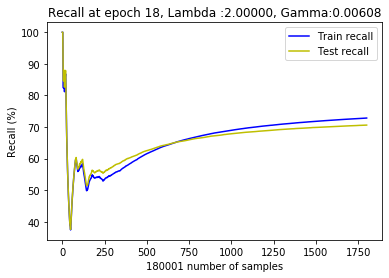

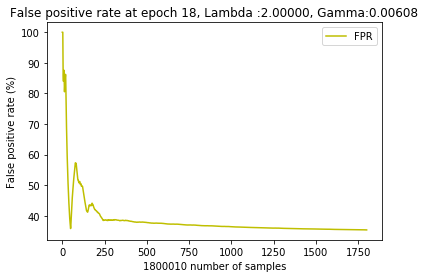

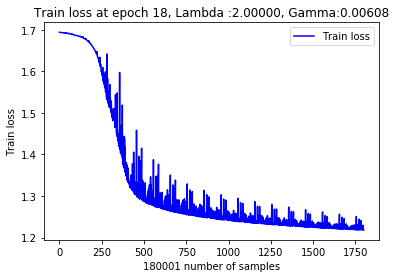

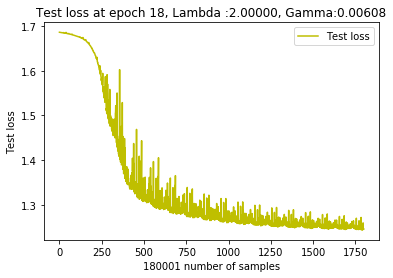

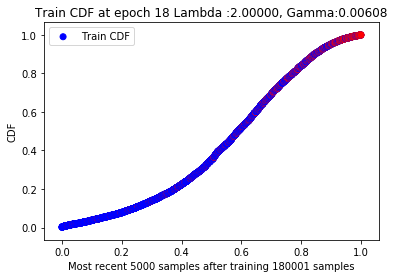

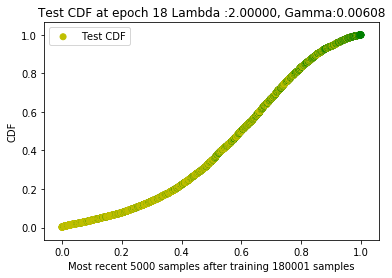

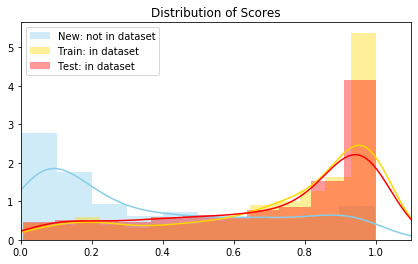

  0%|          | 5/10000 [00:43<83:53:44, 30.22s/it] 

New score:  0.3508009
Train score:  0.7348352
Test score:  0.7025072


 20%|█▉        | 1999/10000 [14:50<04:59, 26.72it/s]   

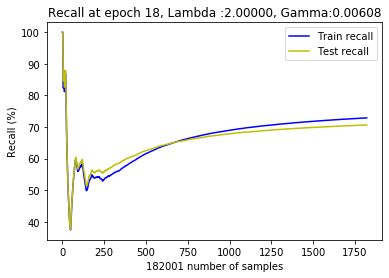

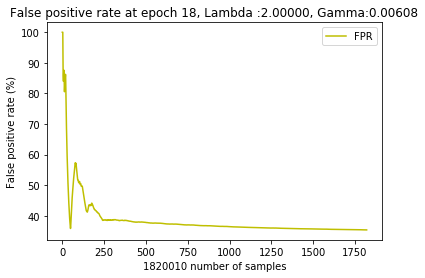

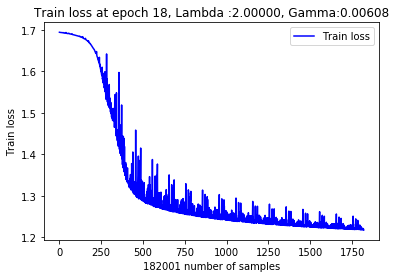

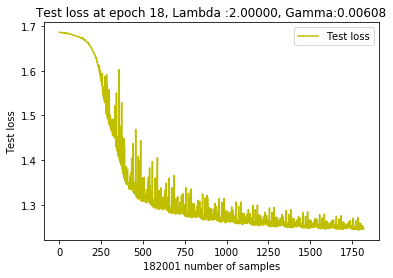

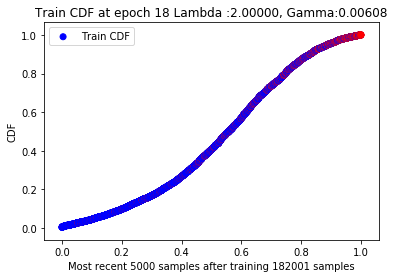

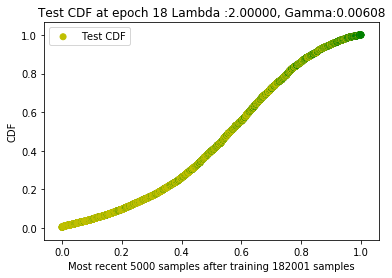

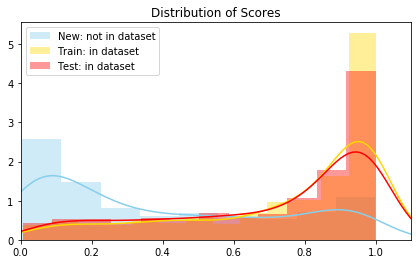

 20%|██        | 2005/10000 [15:19<9:58:19,  4.49s/it] 

New score:  0.38146734
Train score:  0.74373424
Test score:  0.7311181


 40%|███▉      | 3998/10000 [29:30<03:22, 29.70it/s]   

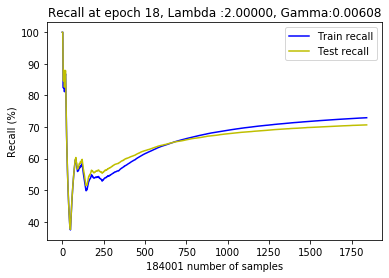

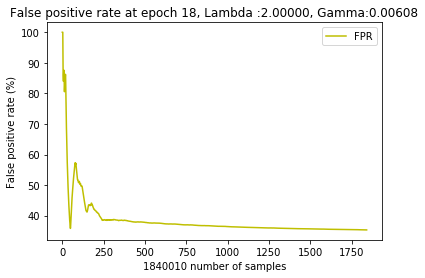

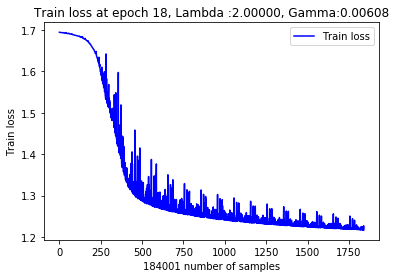

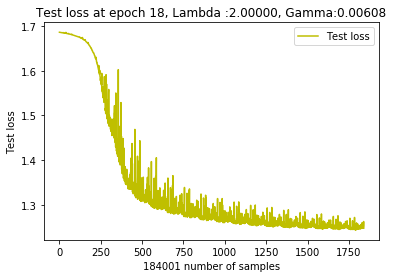

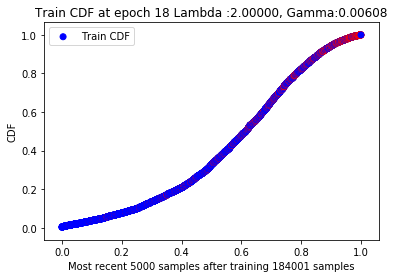

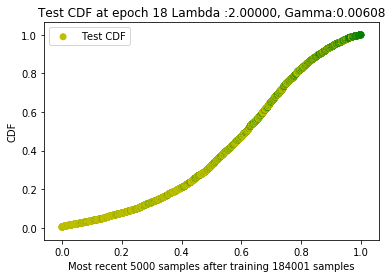

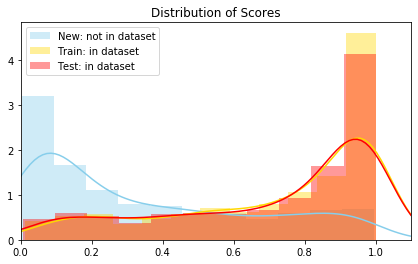

 40%|████      | 4005/10000 [29:57<5:03:26,  3.04s/it]

New score:  0.33752492
Train score:  0.711797
Test score:  0.69991755


 60%|█████▉    | 5998/10000 [44:10<02:05, 31.88it/s]   

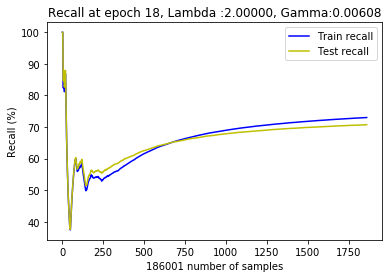

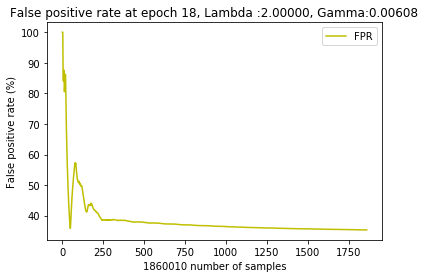

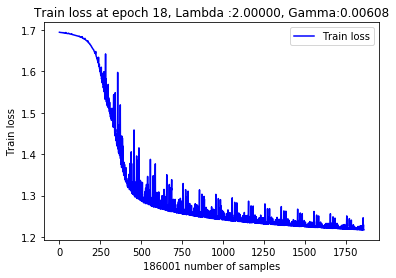

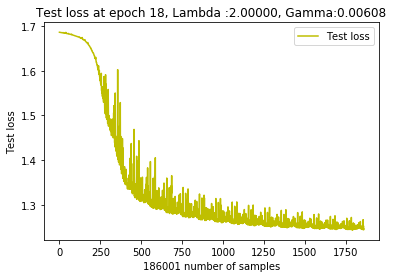

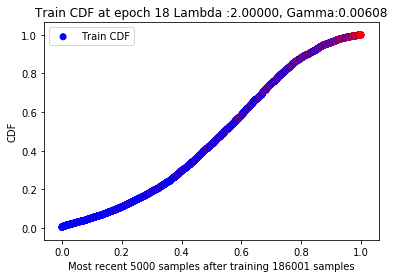

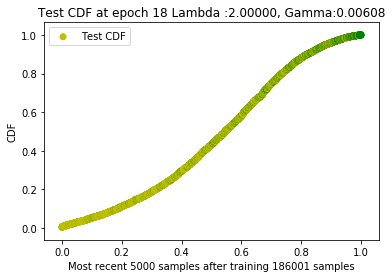

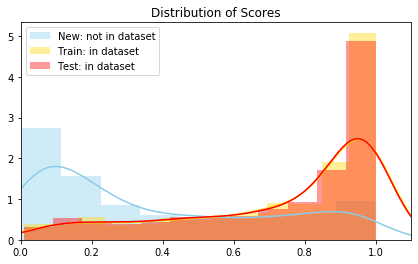

 60%|██████    | 6005/10000 [44:39<3:29:21,  3.14s/it]

New score:  0.36178195
Train score:  0.73499966
Test score:  0.7479142


 80%|███████▉  | 7998/10000 [58:50<01:03, 31.46it/s]   

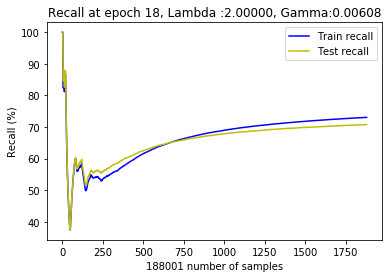

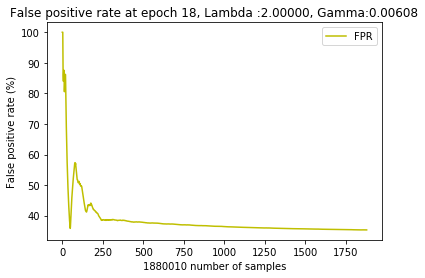

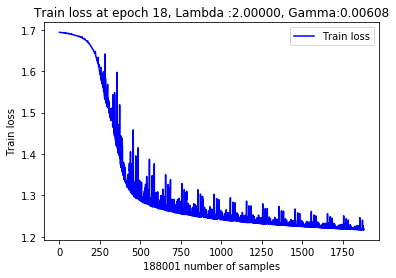

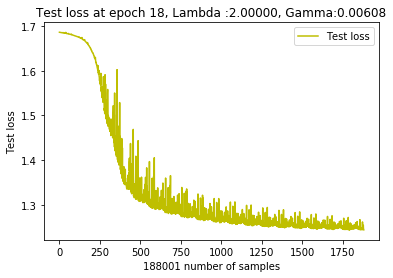

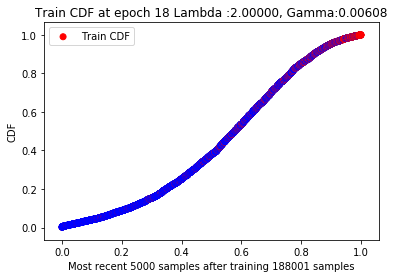

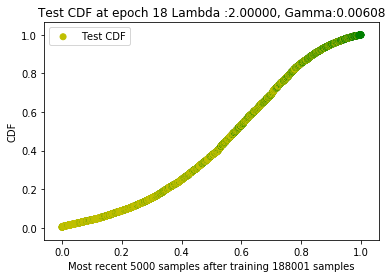

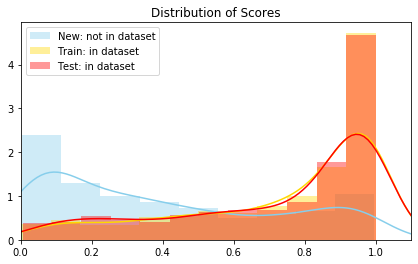

 80%|████████  | 8005/10000 [59:19<1:42:33,  3.08s/it]

New score:  0.41470295
Train score:  0.7214361
Test score:  0.7122443


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  19  with learning rate:  0.005470949456575623


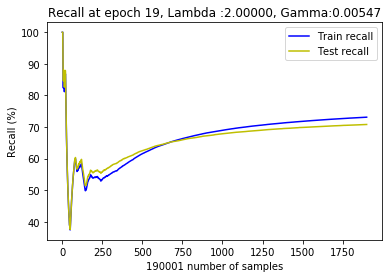

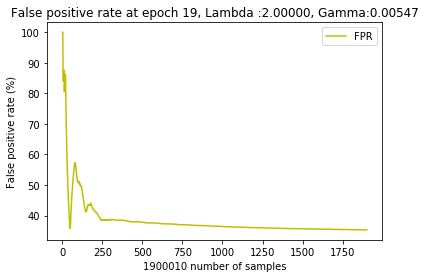

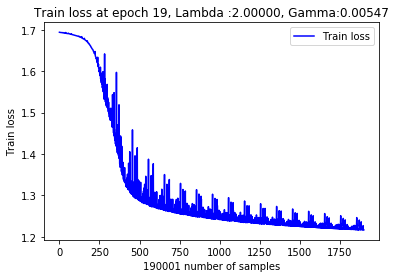

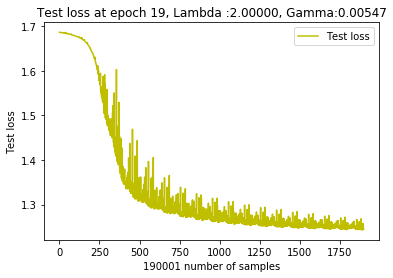

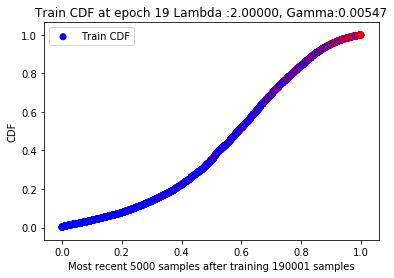

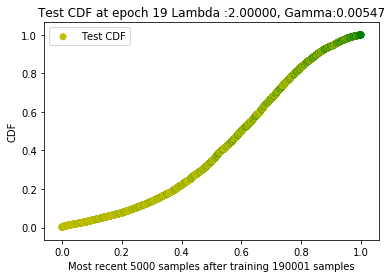

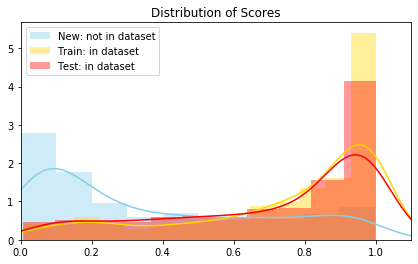

  0%|          | 4/10000 [00:43<83:58:21, 30.24s/it] 

New score:  0.35001555
Train score:  0.73576915
Test score:  0.7032467


 20%|█▉        | 1997/10000 [14:50<04:52, 27.33it/s]   

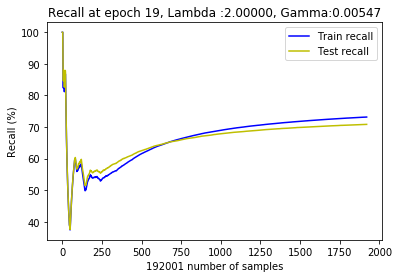

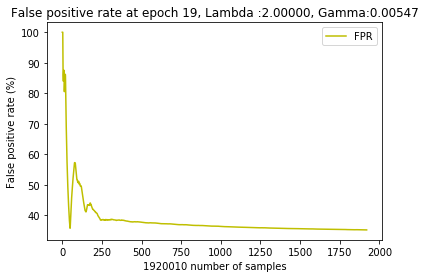

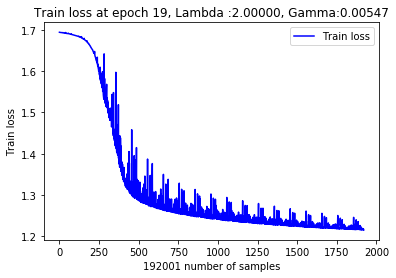

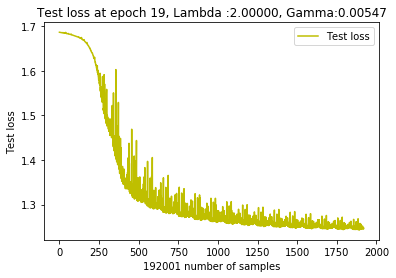

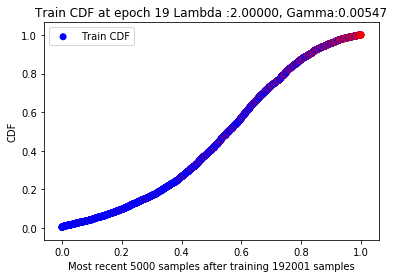

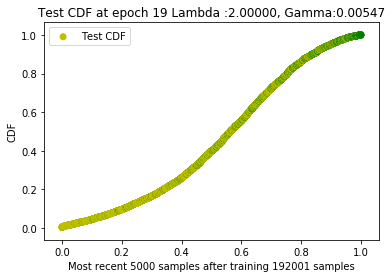

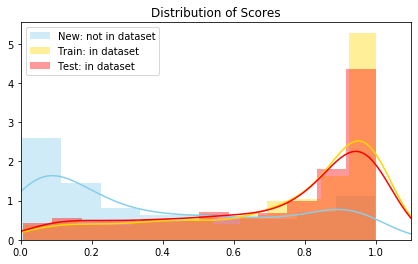

 20%|██        | 2005/10000 [15:20<5:03:42,  2.28s/it]

New score:  0.38211006
Train score:  0.74454784
Test score:  0.7314911


 40%|███▉      | 3997/10000 [29:30<03:26, 29.07it/s]   

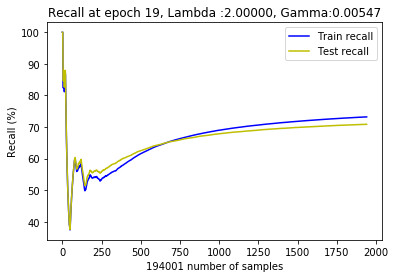

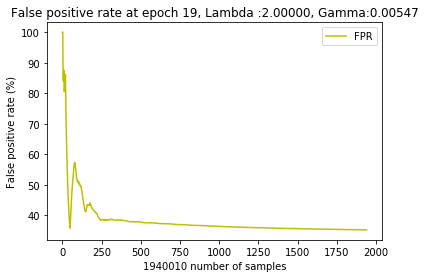

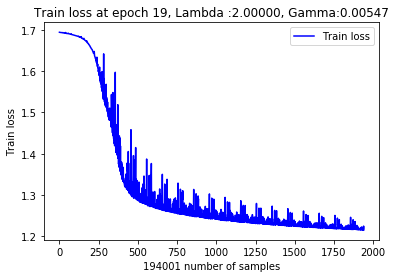

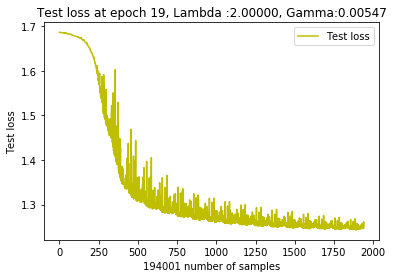

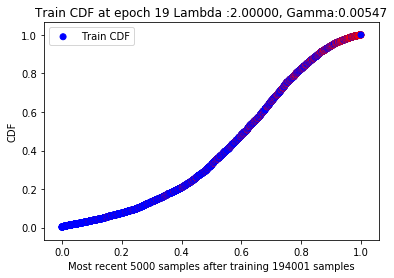

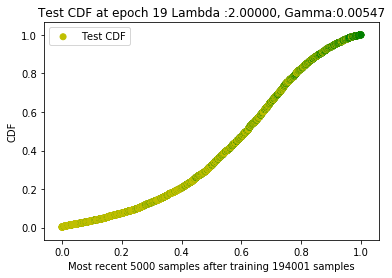

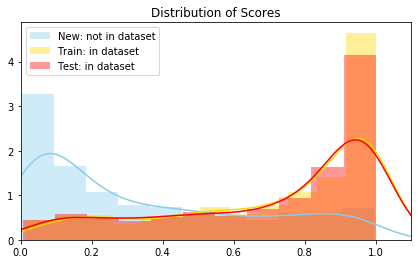

 40%|████      | 4004/10000 [29:59<3:47:29,  2.28s/it]

New score:  0.33580106
Train score:  0.71319884
Test score:  0.7011959


 60%|██████    | 6000/10000 [44:00<02:09, 30.83it/s]   

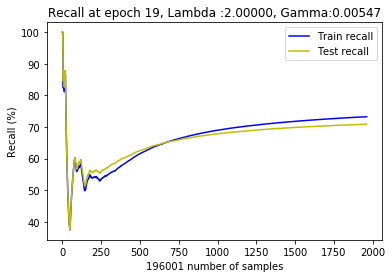

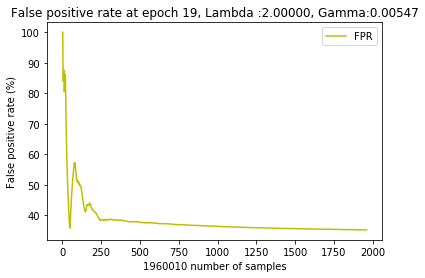

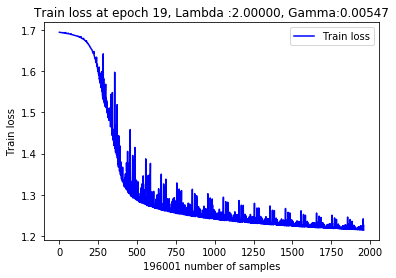

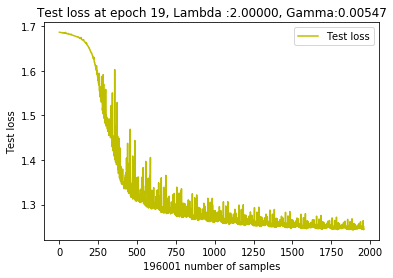

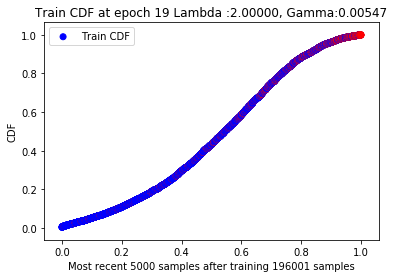

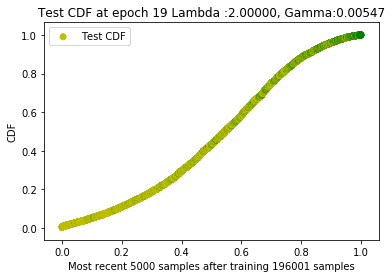

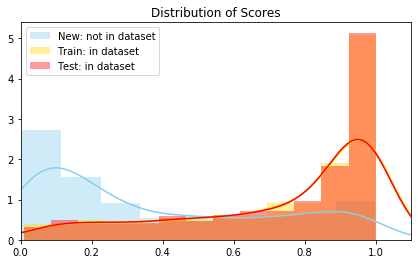

 60%|██████    | 6005/10000 [44:32<9:57:14,  8.97s/it] 

New score:  0.3647114
Train score:  0.7361167
Test score:  0.74887305


 80%|███████▉  | 7999/10000 [58:40<01:04, 31.05it/s]   

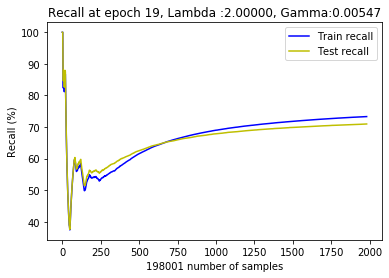

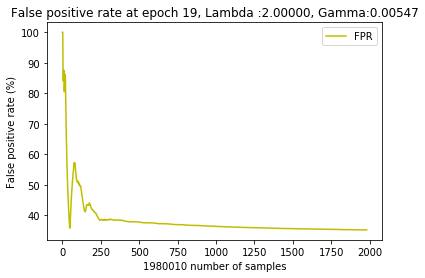

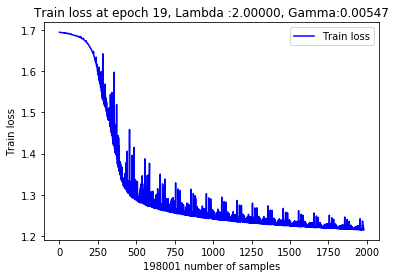

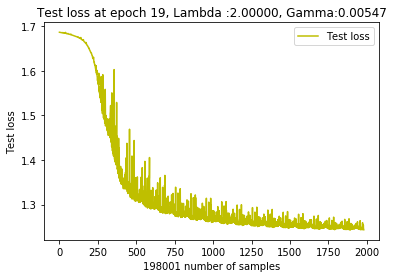

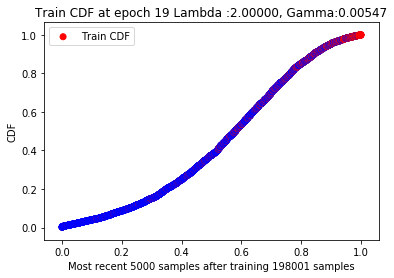

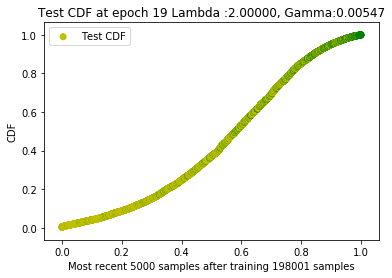

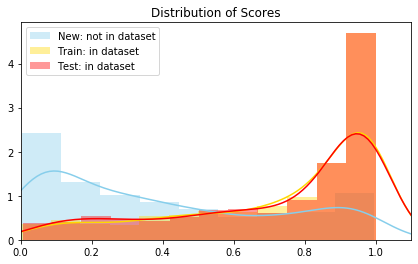

 80%|████████  | 8005/10000 [59:07<2:31:21,  4.55s/it]

New score:  0.41177014
Train score:  0.72179323
Test score:  0.71219826


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  20  with learning rate:  0.0049238545109180605


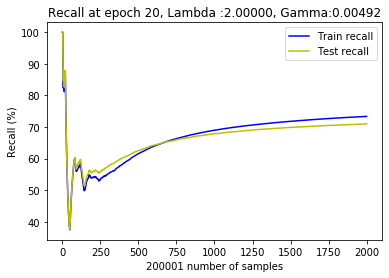

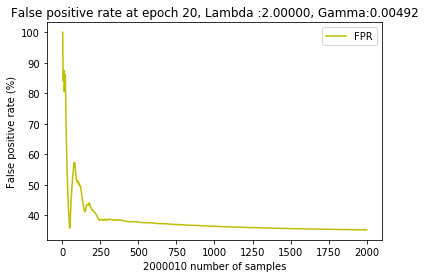

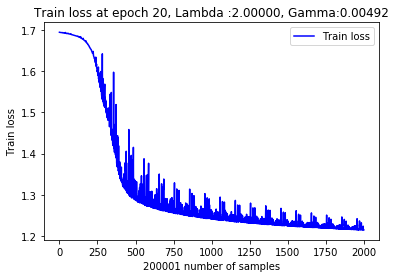

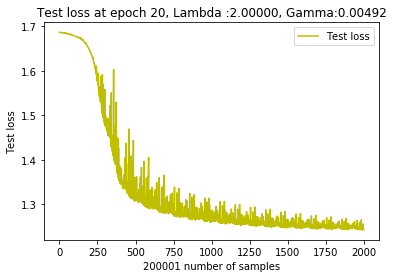

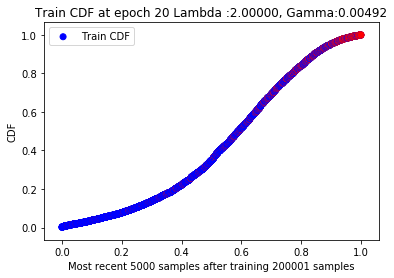

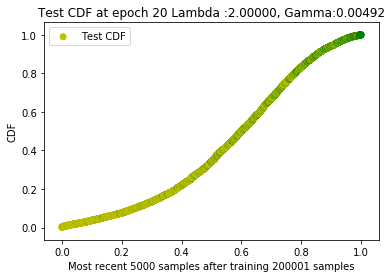

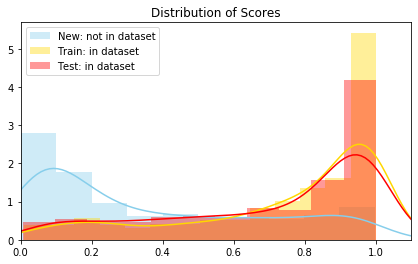

  0%|          | 5/10000 [00:43<83:38:48, 30.13s/it] 

New score:  0.34910667
Train score:  0.73664343
Test score:  0.70396703


 20%|█▉        | 1999/10000 [14:50<05:14, 25.44it/s]   

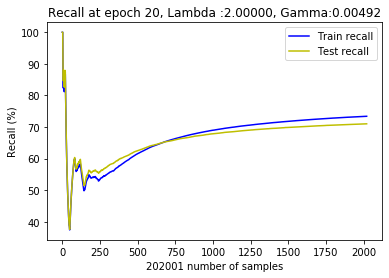

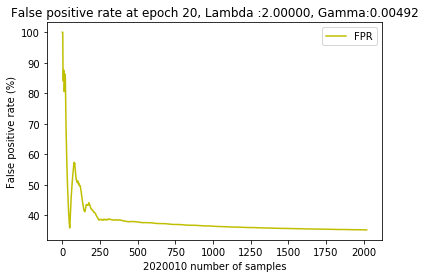

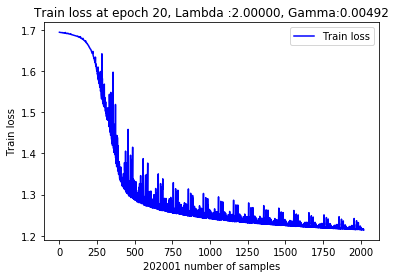

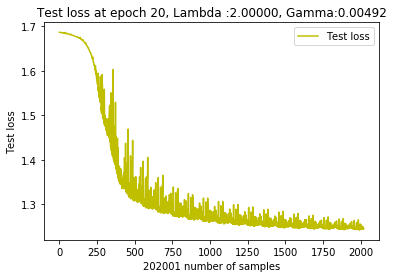

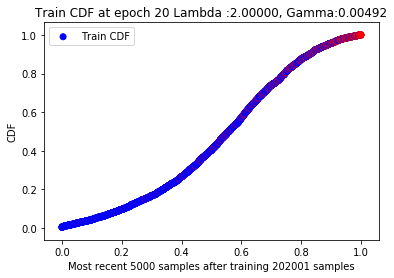

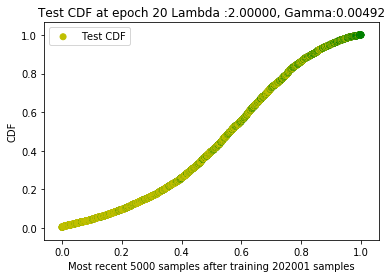

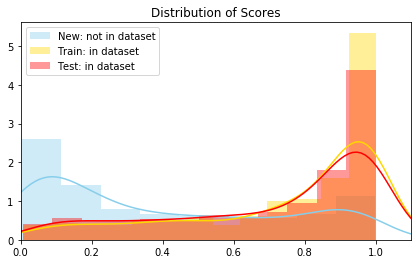

 20%|██        | 2005/10000 [15:16<10:02:34,  4.52s/it]

New score:  0.38337305
Train score:  0.7453102
Test score:  0.73186123


 40%|███▉      | 3997/10000 [29:30<03:16, 30.51it/s]   

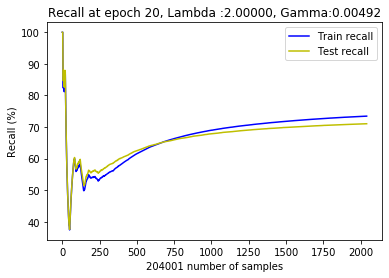

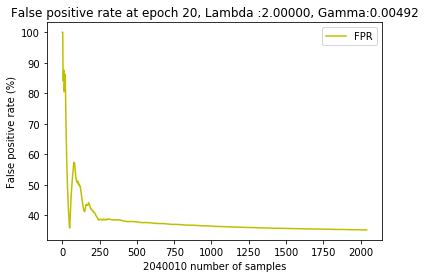

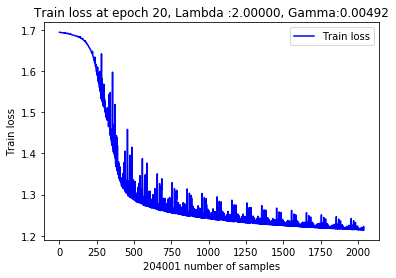

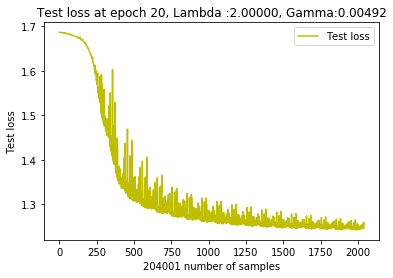

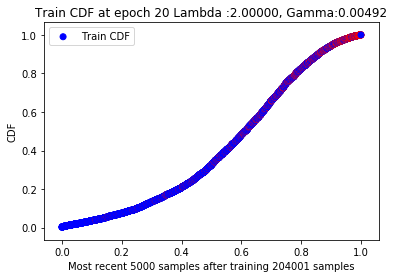

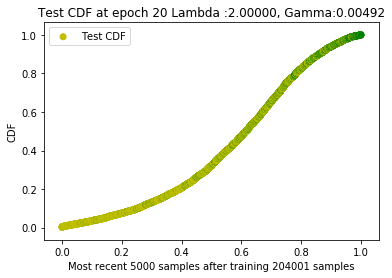

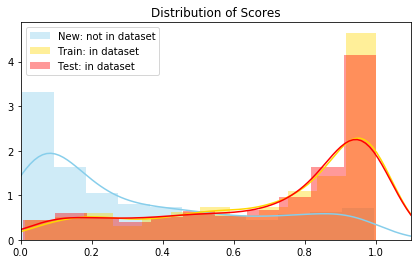

 40%|████      | 4005/10000 [29:54<3:55:53,  2.36s/it]

New score:  0.3346534
Train score:  0.7146504
Test score:  0.70257646


 60%|██████    | 6000/10000 [44:00<02:02, 32.66it/s]   

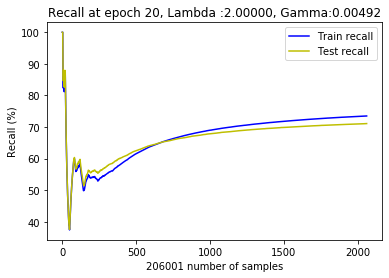

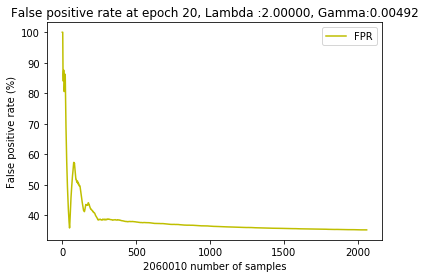

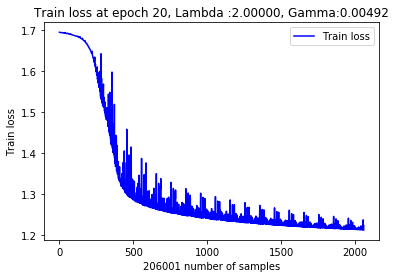

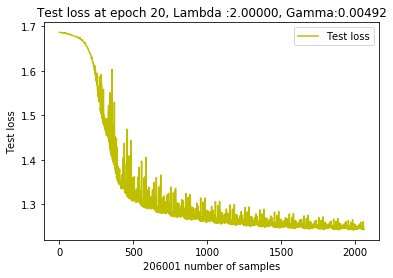

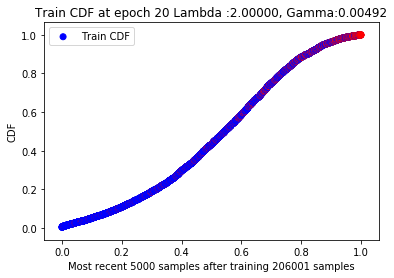

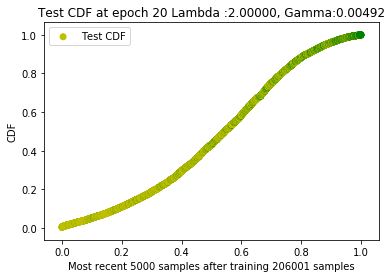

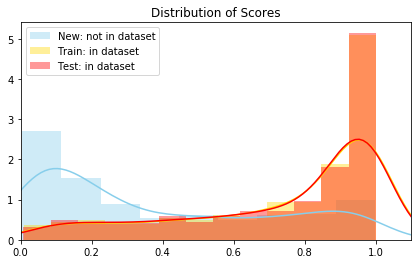

 60%|██████    | 6005/10000 [44:31<9:55:52,  8.95s/it] 

New score:  0.36758825
Train score:  0.73688304
Test score:  0.7494762


 80%|███████▉  | 7997/10000 [58:40<01:01, 32.70it/s]   

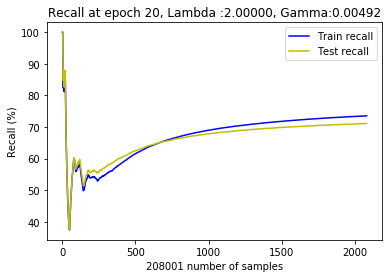

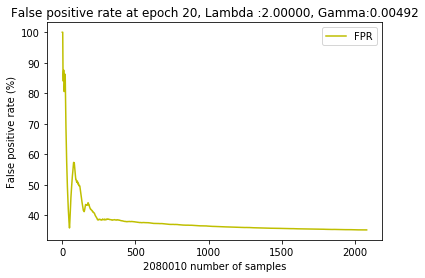

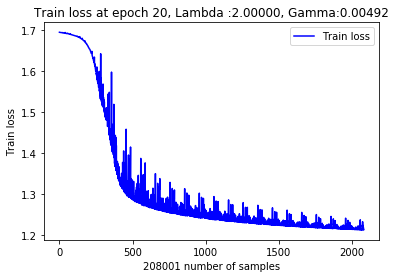

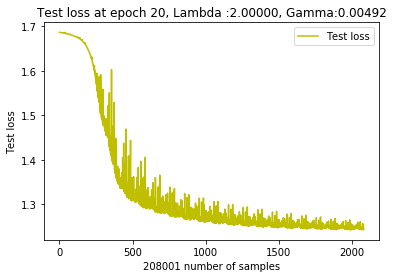

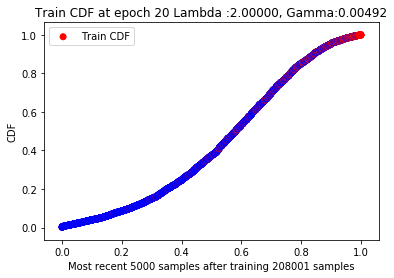

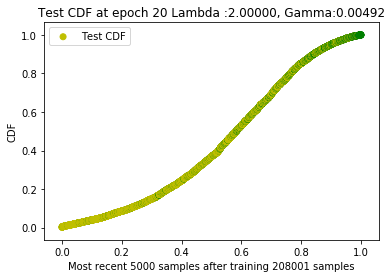

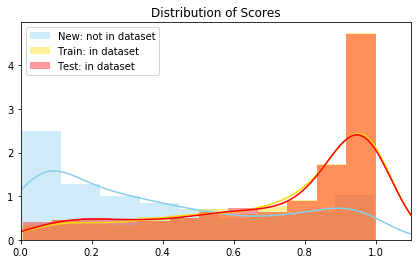

 80%|████████  | 8005/10000 [59:05<1:17:28,  2.33s/it]

New score:  0.40839776
Train score:  0.72227764
Test score:  0.7123165


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  21  with learning rate:  0.004431469059826255


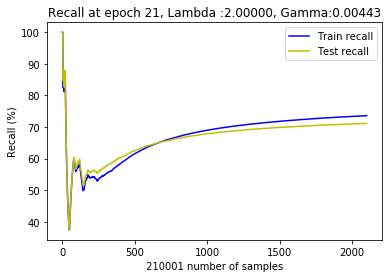

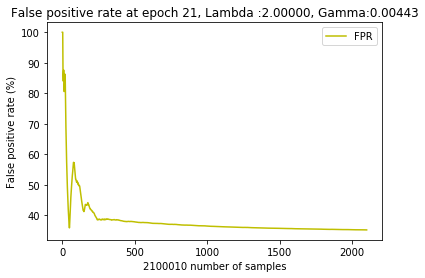

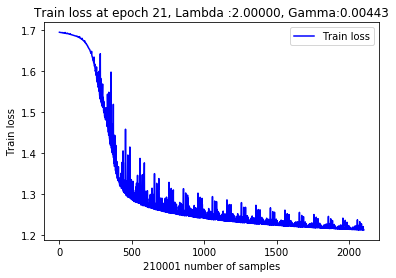

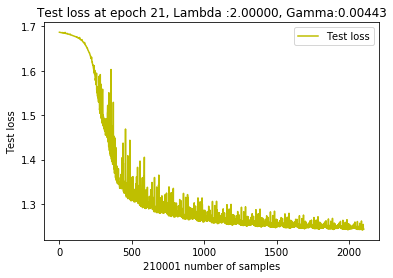

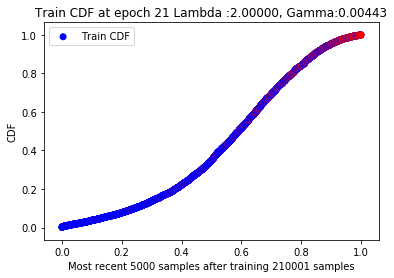

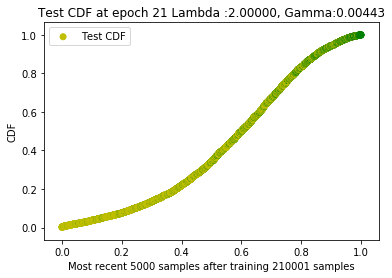

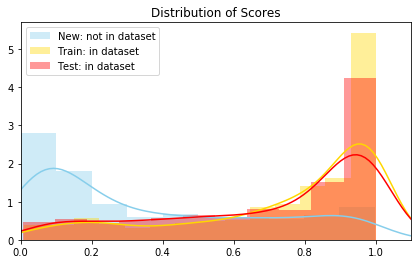

  0%|          | 5/10000 [00:43<84:25:35, 30.41s/it] 

New score:  0.34838572
Train score:  0.73759854
Test score:  0.70476234


 20%|█▉        | 1997/10000 [15:00<05:00, 26.67it/s]   

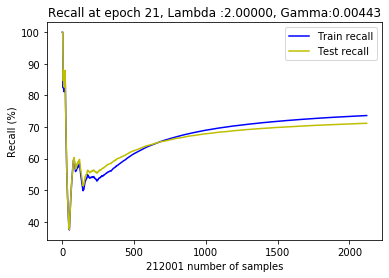

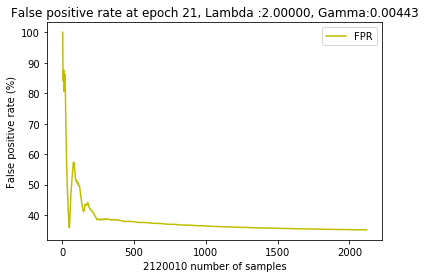

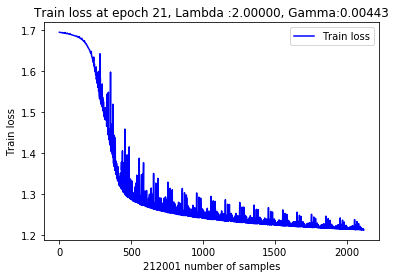

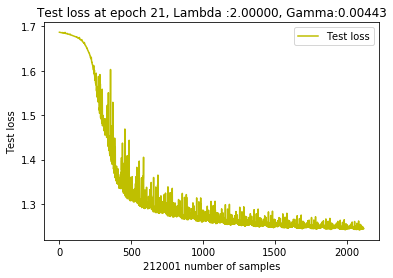

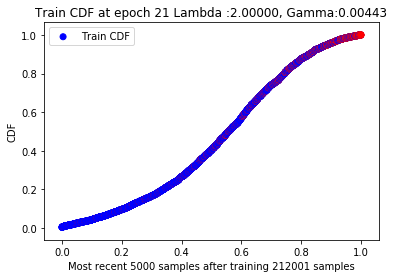

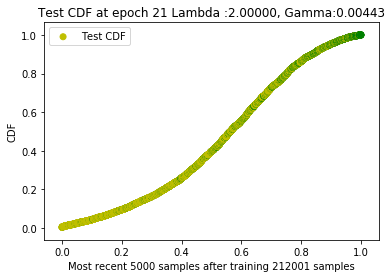

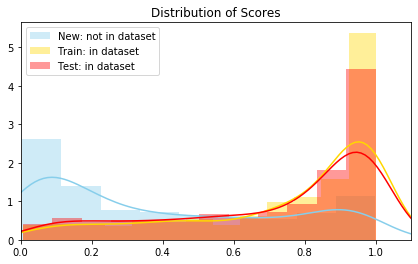

 20%|██        | 2004/10000 [15:23<5:00:22,  2.25s/it]

New score:  0.38452044
Train score:  0.74601626
Test score:  0.73219854


 40%|████      | 4000/10000 [29:20<03:13, 31.03it/s]   

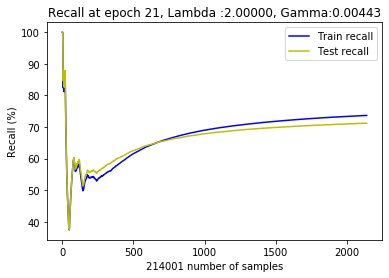

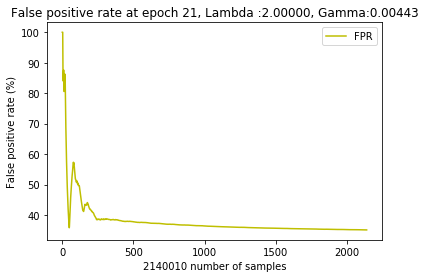

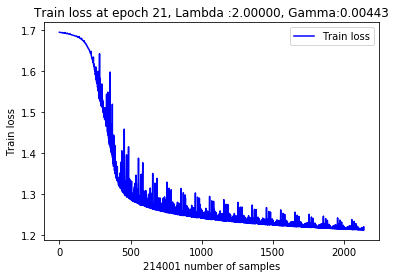

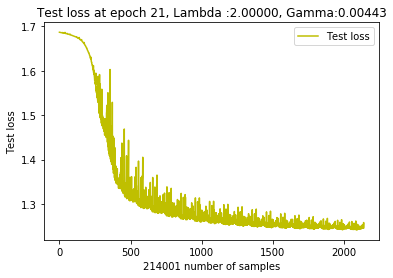

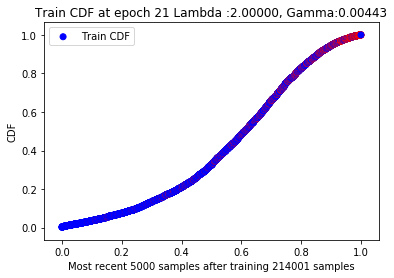

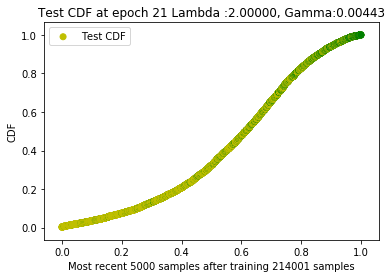

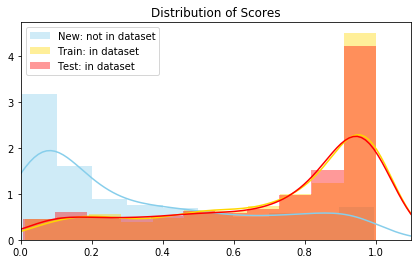

 40%|████      | 4004/10000 [29:51<15:44:50,  9.45s/it]

New score:  0.33371523
Train score:  0.71622336
Test score:  0.7040657


 60%|█████▉    | 5999/10000 [44:00<02:07, 31.37it/s]   

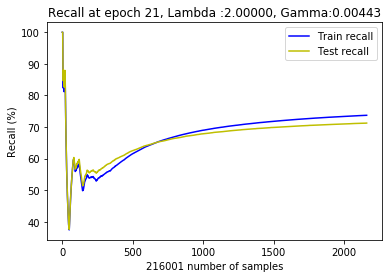

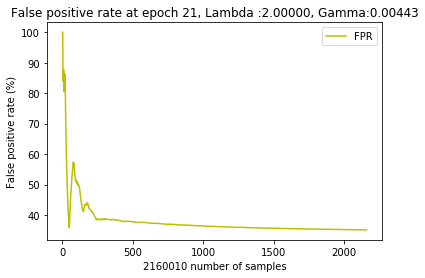

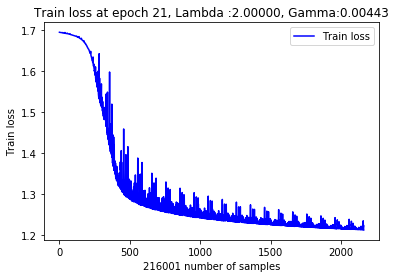

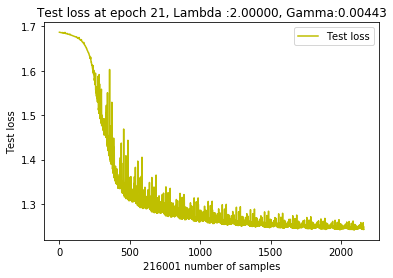

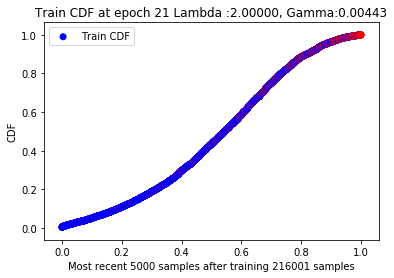

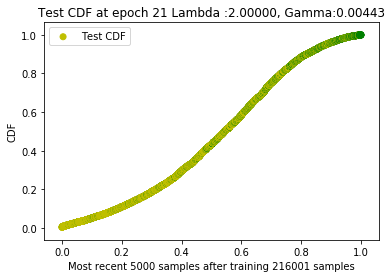

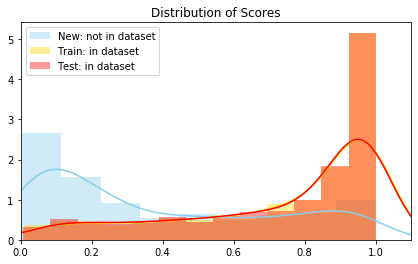

 60%|██████    | 6005/10000 [44:32<5:01:53,  4.53s/it]

New score:  0.37045375
Train score:  0.73759043
Test score:  0.75001997


 80%|███████▉  | 7999/10000 [1:00:50<02:18, 14.49it/s]  

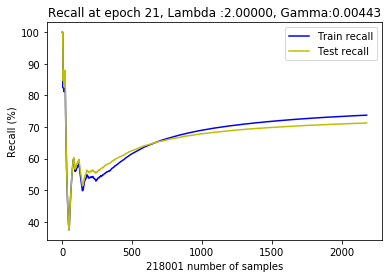

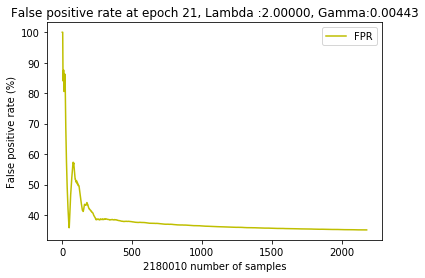

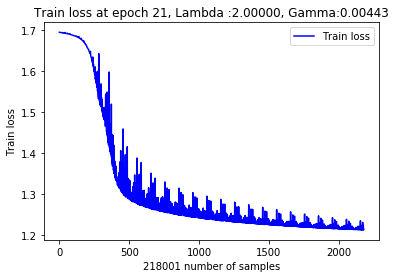

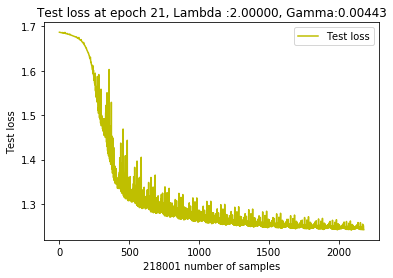

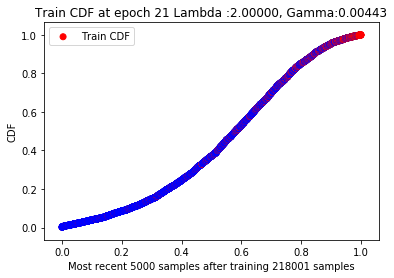

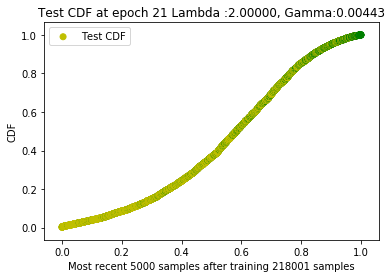

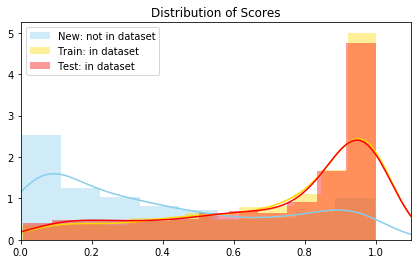

 80%|████████  | 8003/10000 [1:01:46<4:02:58,  7.30s/it]

New score:  0.4053291
Train score:  0.7230213
Test score:  0.7127293


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  22  with learning rate:  0.0039883221538436296


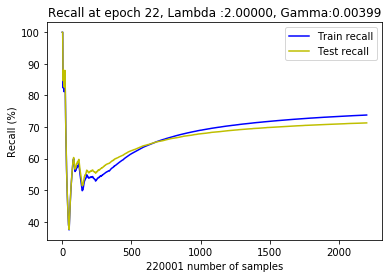

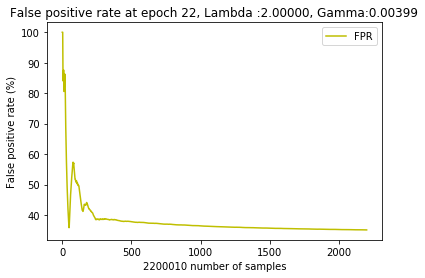

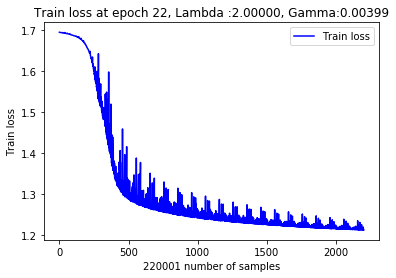

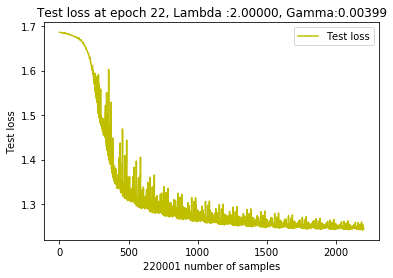

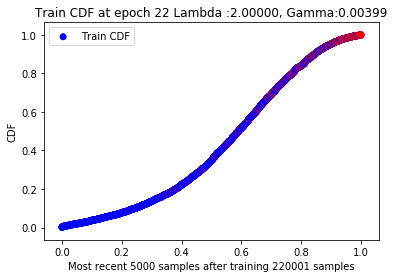

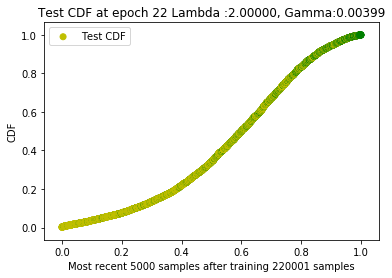

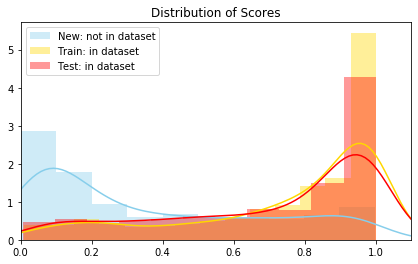

  0%|          | 3/10000 [01:08<131:59:13, 47.53s/it]

New score:  0.3474596
Train score:  0.7386814
Test score:  0.7056813


 20%|█▉        | 1999/10000 [23:10<07:01, 19.00it/s]   

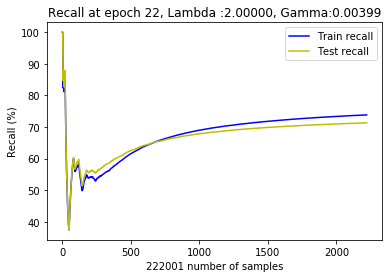

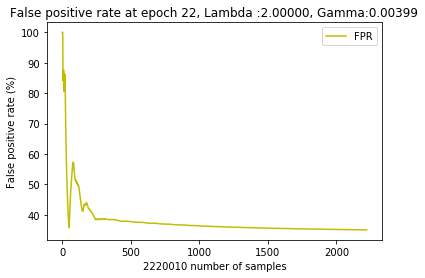

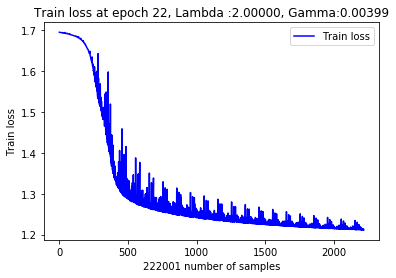

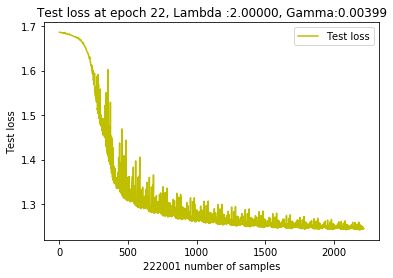

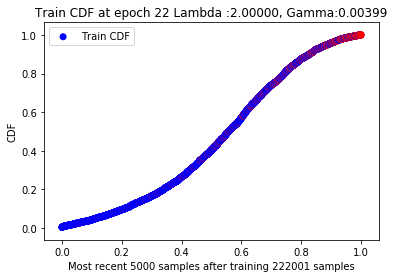

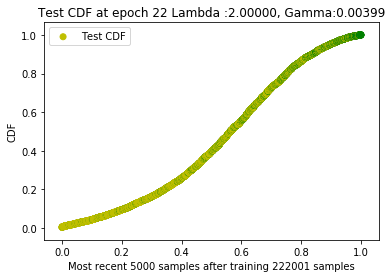

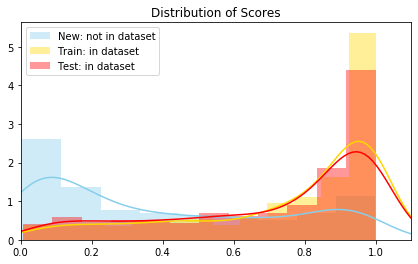

 20%|██        | 2004/10000 [24:01<15:00:47,  6.76s/it]

New score:  0.3854355
Train score:  0.74626124
Test score:  0.73208845


 40%|███▉      | 3998/10000 [45:40<04:34, 21.86it/s]   

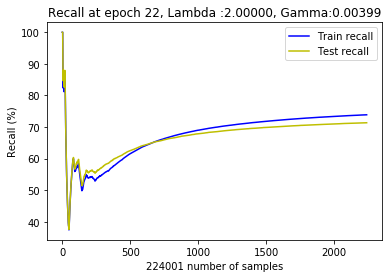

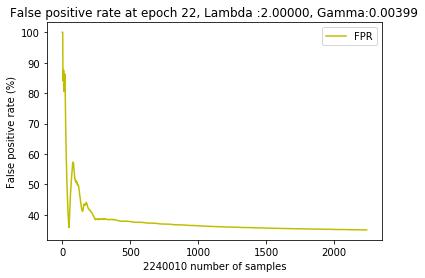

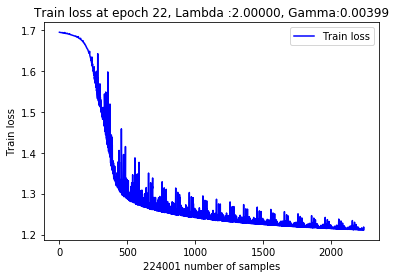

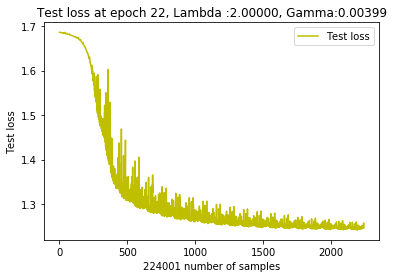

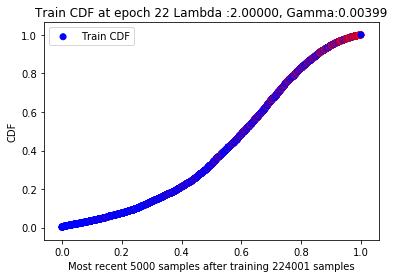

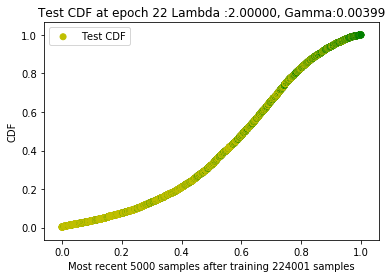

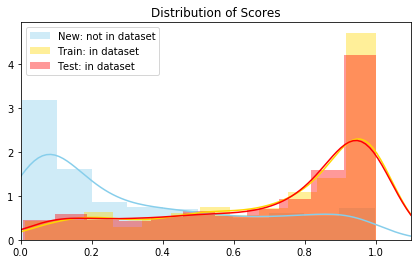

 40%|████      | 4004/10000 [46:34<7:32:50,  4.53s/it] 

New score:  0.3331147
Train score:  0.7179529
Test score:  0.70571494


 60%|█████▉    | 5998/10000 [1:08:40<03:05, 21.57it/s]   

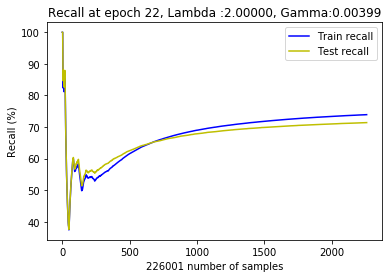

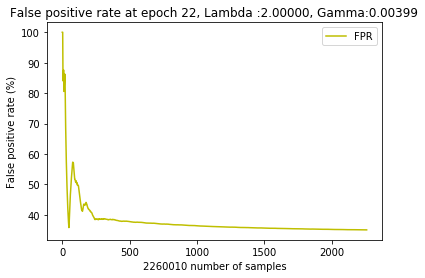

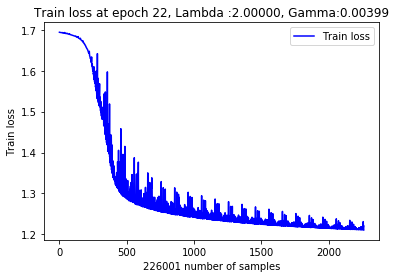

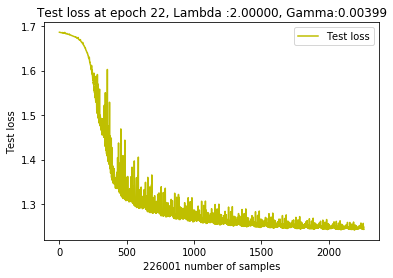

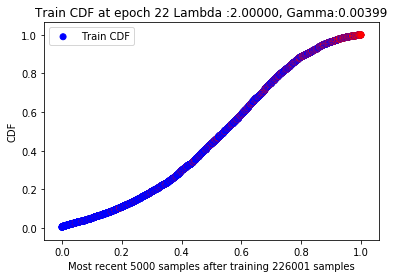

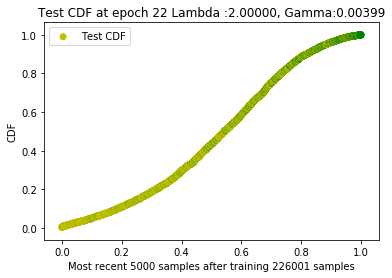

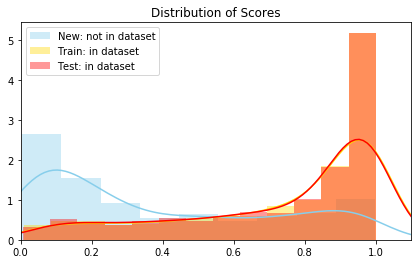

 60%|██████    | 6004/10000 [1:09:33<5:02:39,  4.54s/it]

New score:  0.37319937
Train score:  0.7382236
Test score:  0.7505145


 80%|████████  | 8000/10000 [1:31:10<02:09, 15.39it/s]   

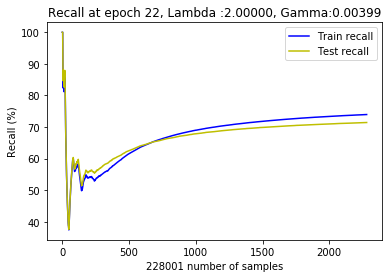

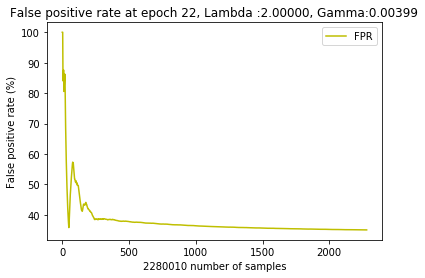

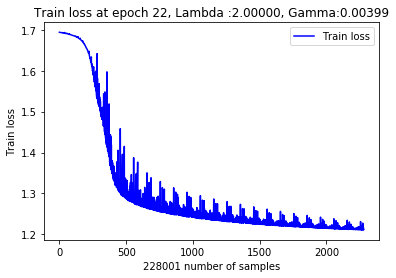

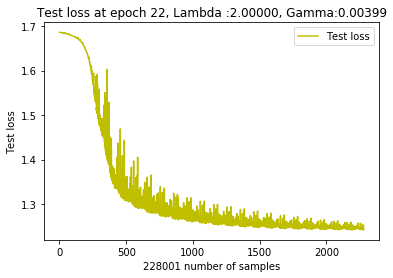

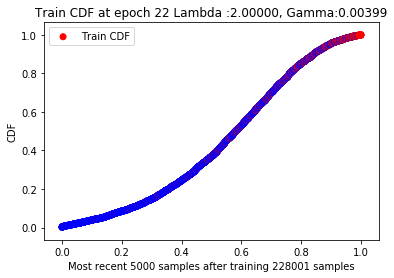

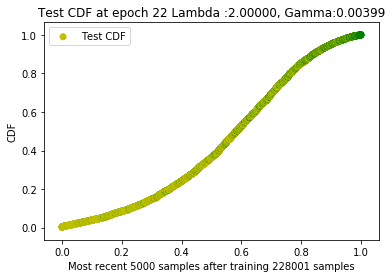

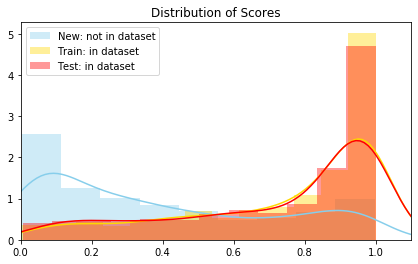

 80%|████████  | 8003/10000 [1:32:03<7:31:40, 13.57s/it] 

New score:  0.40209052
Train score:  0.7236199
Test score:  0.7130219


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  23  with learning rate:  0.003589489938459267


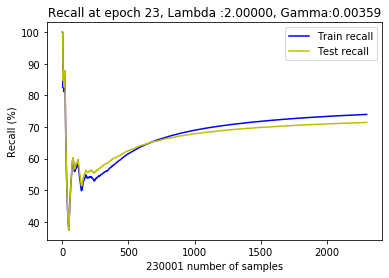

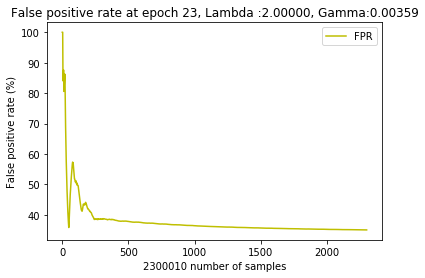

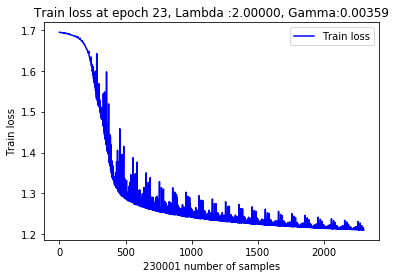

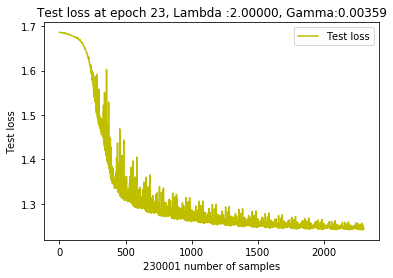

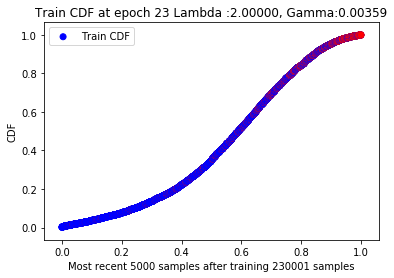

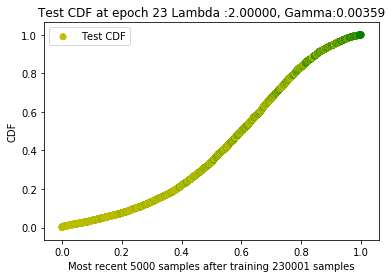

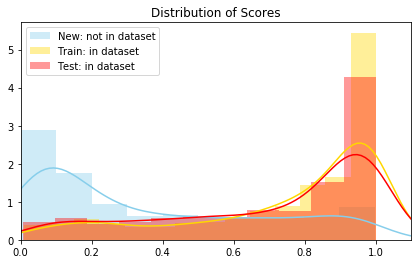

  0%|          | 3/10000 [01:04<124:38:39, 44.89s/it]

New score:  0.34621197
Train score:  0.73961204
Test score:  0.70641565


 20%|██        | 2000/10000 [20:40<05:05, 26.15it/s]   

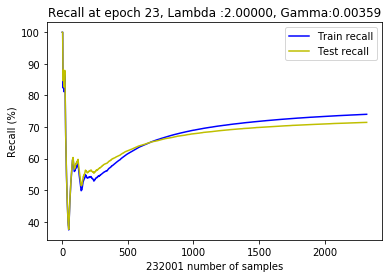

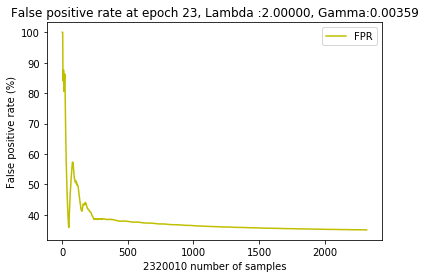

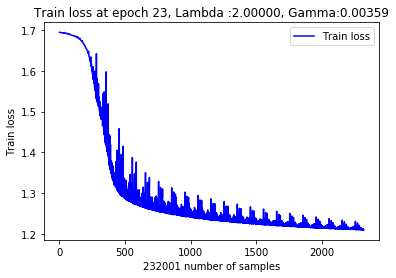

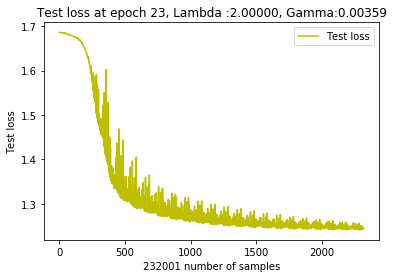

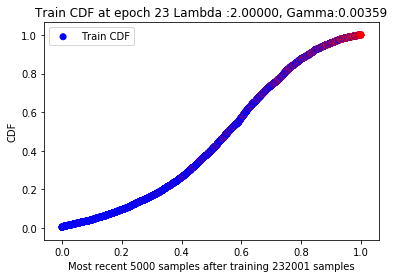

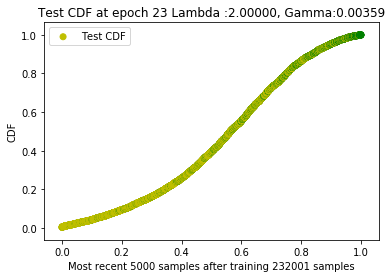

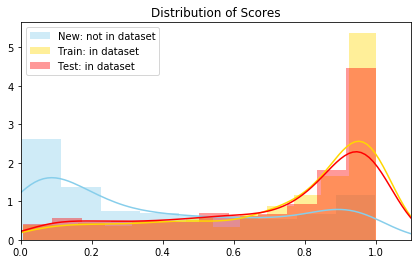

 20%|██        | 2004/10000 [21:06<20:30:55,  9.24s/it]

New score:  0.38647127
Train score:  0.746511
Test score:  0.7320067


 40%|███▉      | 3999/10000 [35:30<03:21, 29.74it/s]   

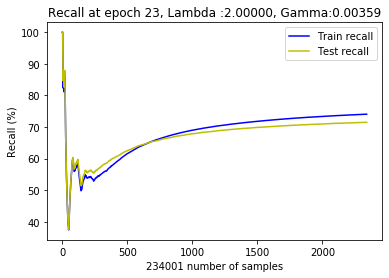

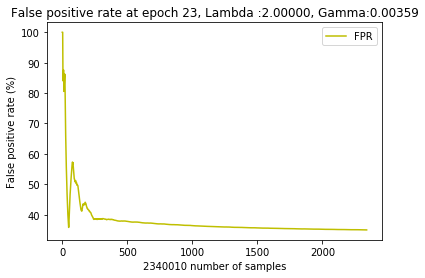

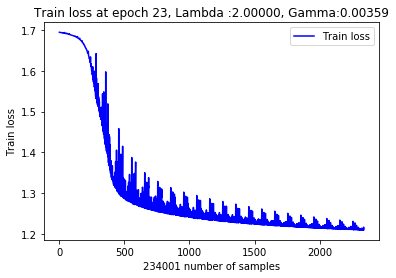

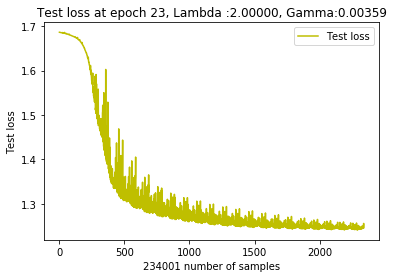

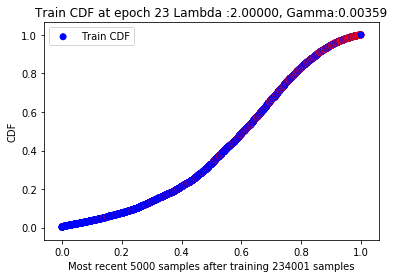

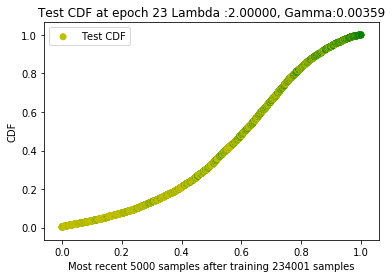

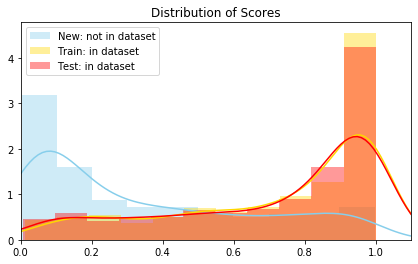

 40%|████      | 4005/10000 [35:57<7:38:33,  4.59s/it] 

New score:  0.3324076
Train score:  0.7191948
Test score:  0.7069221


 60%|█████▉    | 5999/10000 [50:20<02:05, 31.96it/s]   

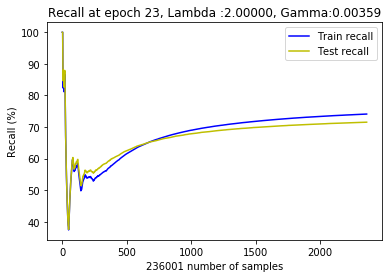

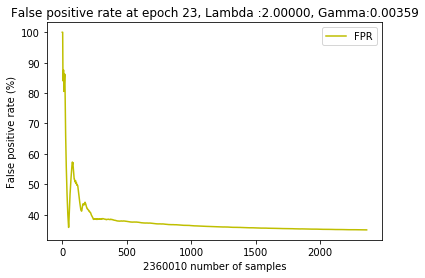

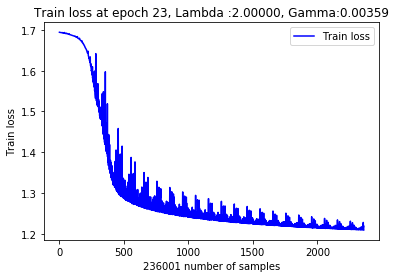

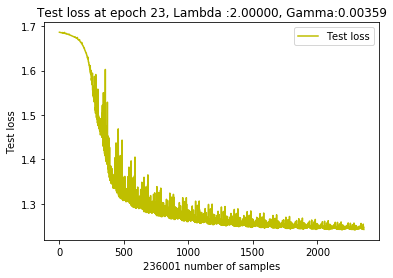

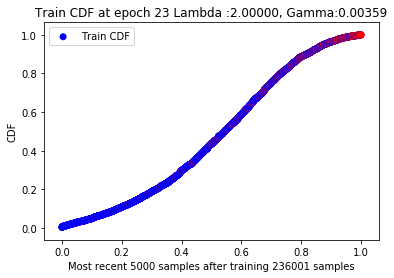

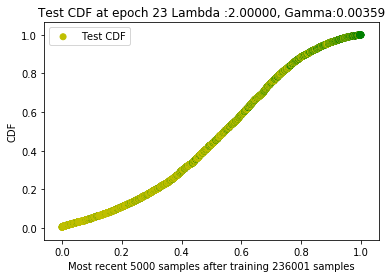

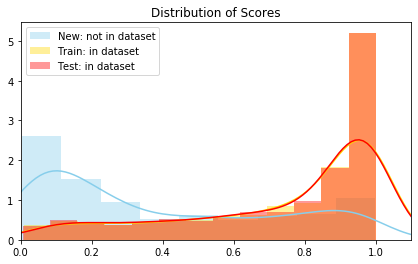

 60%|██████    | 6005/10000 [50:54<5:09:23,  4.65s/it]

New score:  0.37574956
Train score:  0.73850083
Test score:  0.7506595


 80%|███████▉  | 7999/10000 [1:05:20<01:02, 31.81it/s]  

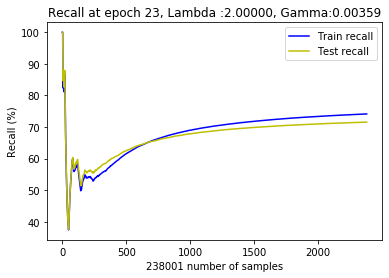

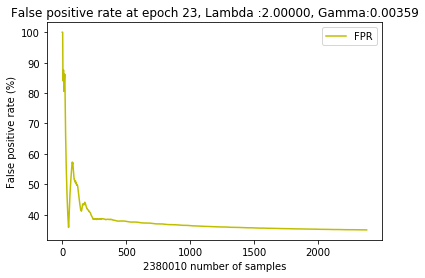

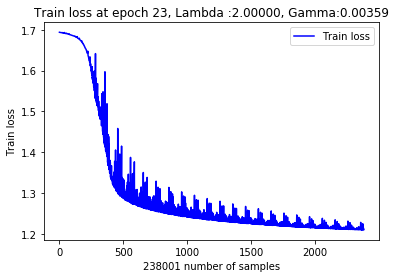

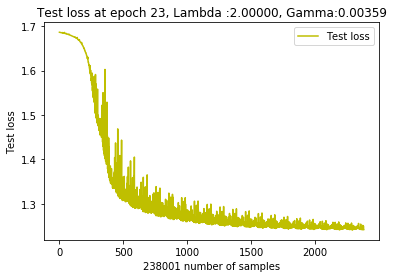

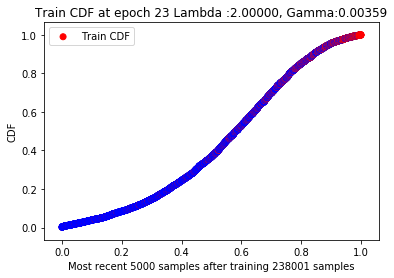

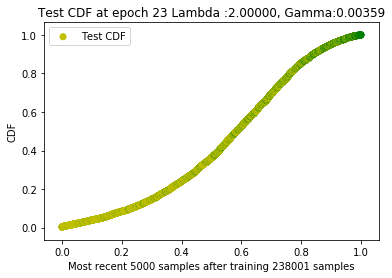

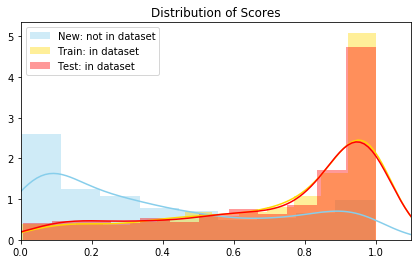

 80%|████████  | 8004/10000 [1:05:53<2:35:49,  4.68s/it]

New score:  0.3988207
Train score:  0.7243496
Test score:  0.71345586


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  24  with learning rate:  0.0032305409446133403


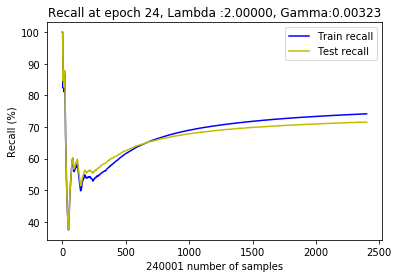

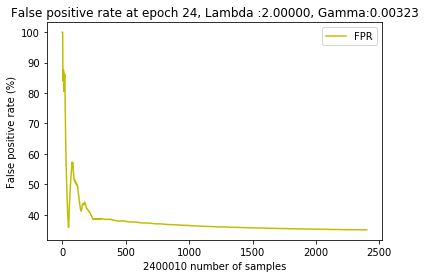

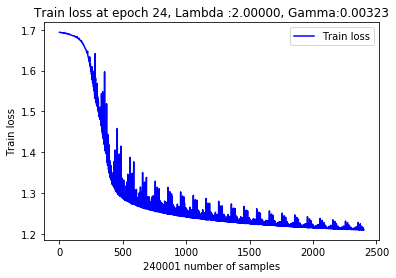

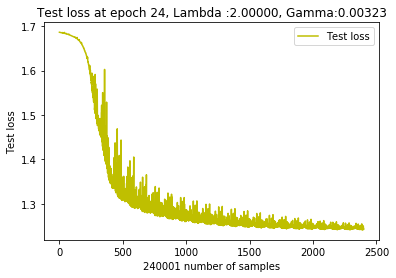

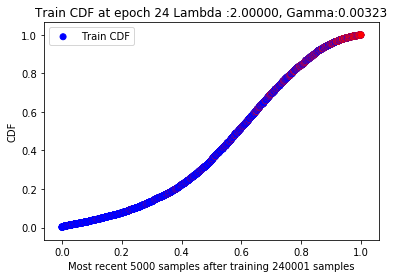

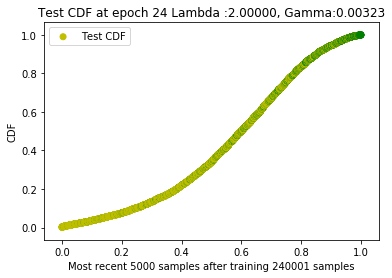

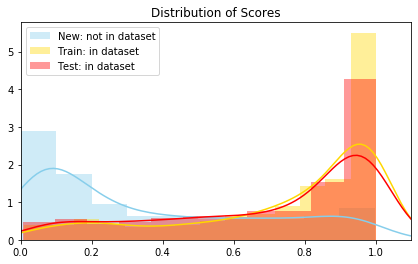

  0%|          | 5/10000 [00:43<85:01:34, 30.62s/it] 

New score:  0.34507442
Train score:  0.7406229
Test score:  0.7072621


 20%|█▉        | 1999/10000 [15:10<04:52, 27.38it/s]   

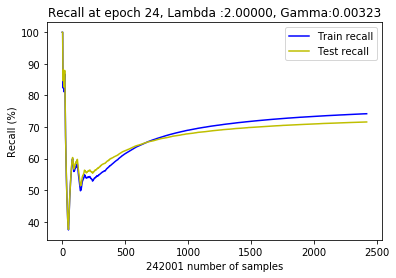

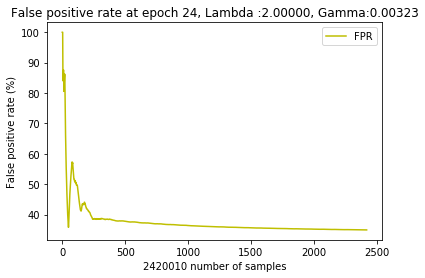

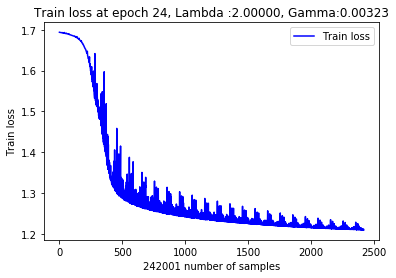

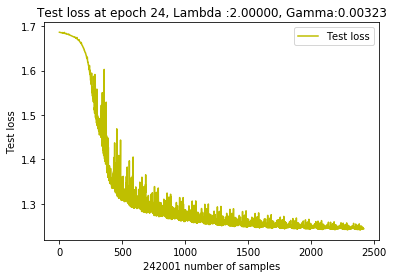

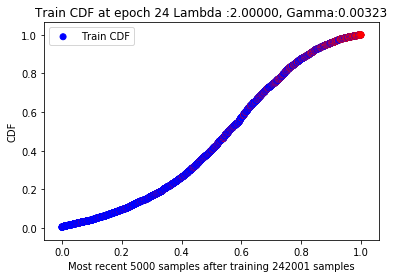

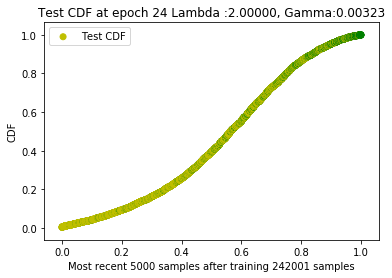

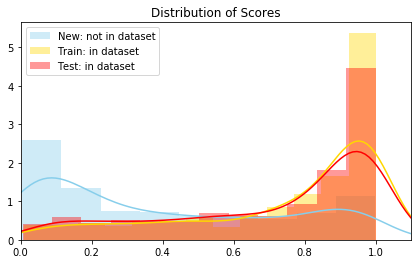

 20%|██        | 2004/10000 [15:34<10:14:29,  4.61s/it]

New score:  0.38737446
Train score:  0.7466147
Test score:  0.73180175


 40%|████      | 4000/10000 [30:00<03:15, 30.72it/s]   

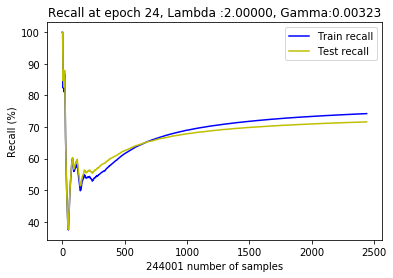

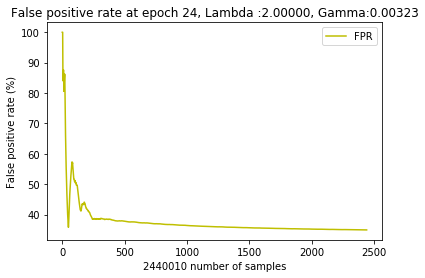

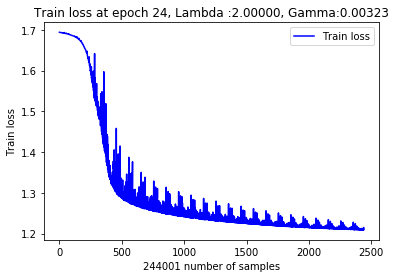

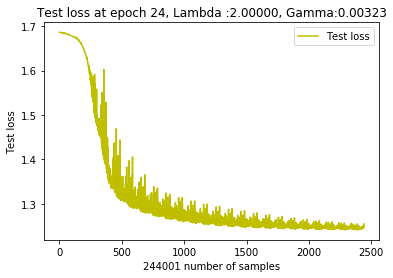

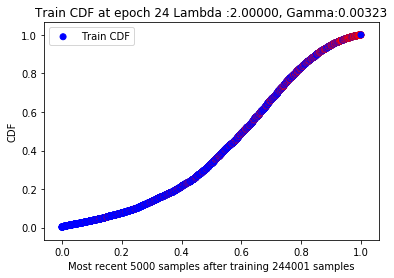

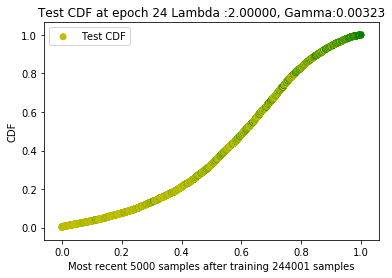

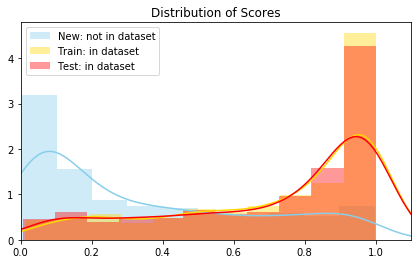

 40%|████      | 4005/10000 [30:29<15:24:48,  9.26s/it]

New score:  0.3318863
Train score:  0.7206072
Test score:  0.7082664


 60%|█████▉    | 5998/10000 [45:00<02:09, 30.97it/s]   

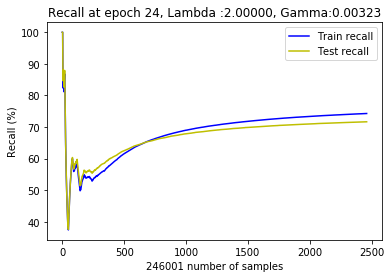

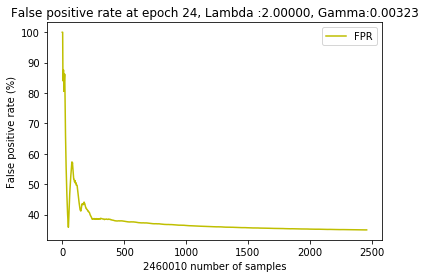

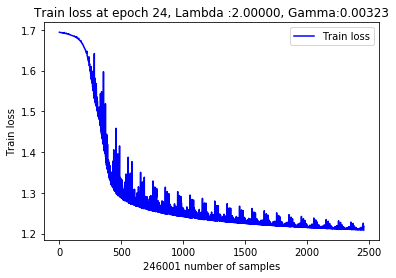

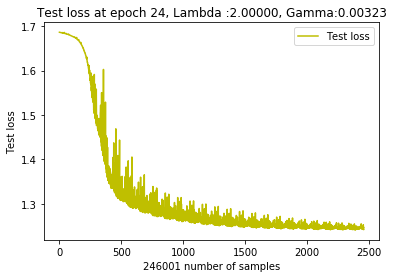

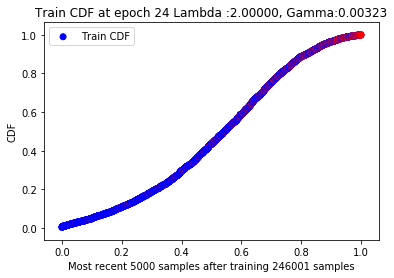

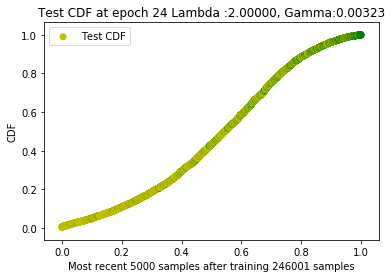

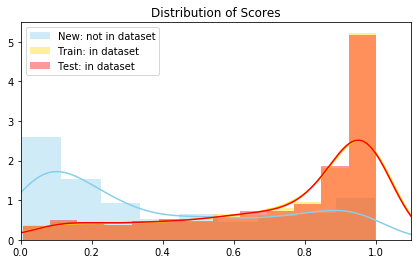

 60%|██████    | 6005/10000 [45:25<3:24:01,  3.06s/it]

New score:  0.37807366
Train score:  0.7388351
Test score:  0.75084424


 80%|███████▉  | 7997/10000 [59:30<01:01, 32.34it/s]   

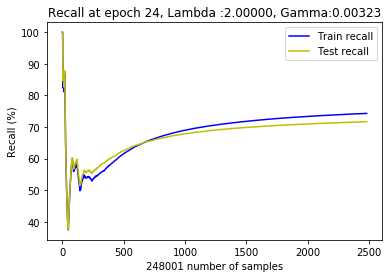

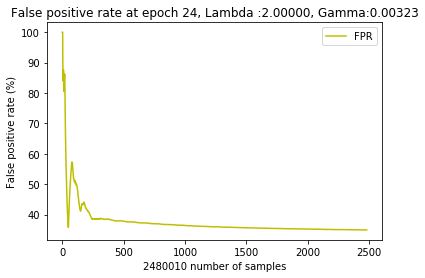

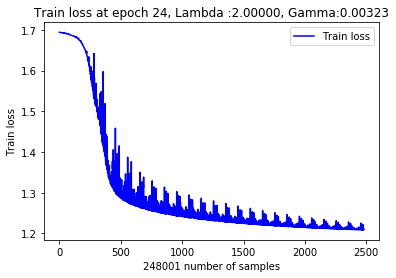

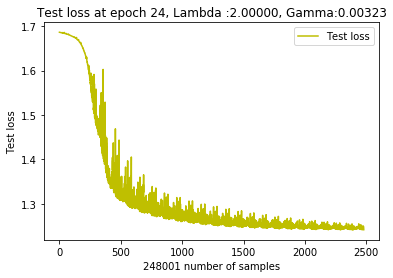

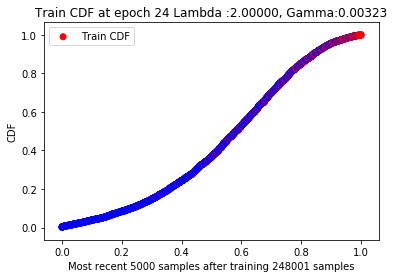

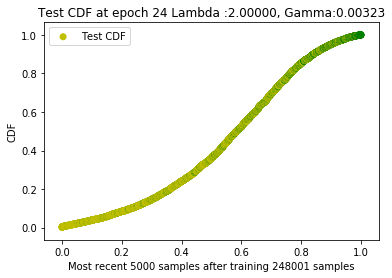

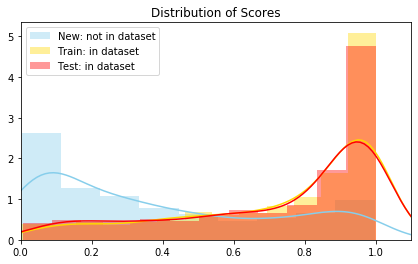

 80%|████████  | 8004/10000 [1:00:03<1:18:30,  2.36s/it]

New score:  0.3956652
Train score:  0.7253112
Test score:  0.7141337


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  25  with learning rate:  0.0029074868501520064


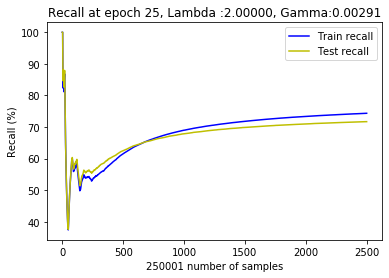

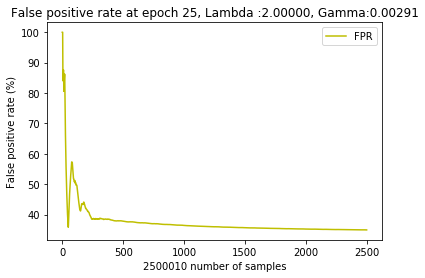

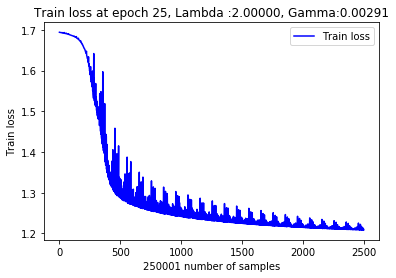

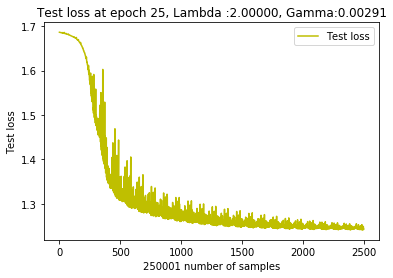

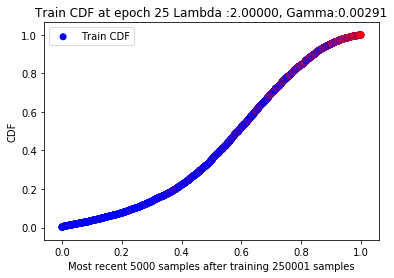

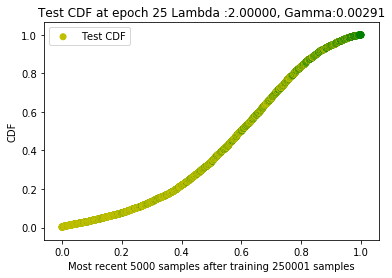

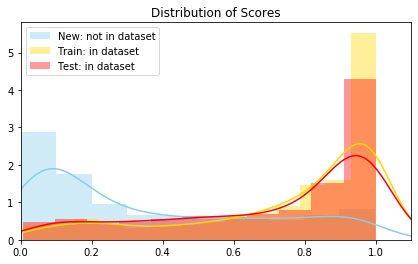

  0%|          | 5/10000 [00:43<84:39:30, 30.49s/it] 

New score:  0.3446526
Train score:  0.7417616
Test score:  0.70824784


 20%|█▉        | 1999/10000 [15:10<05:01, 26.57it/s]   

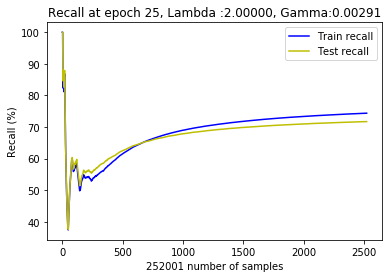

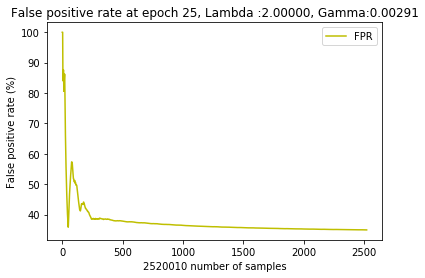

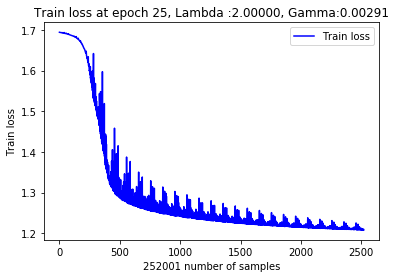

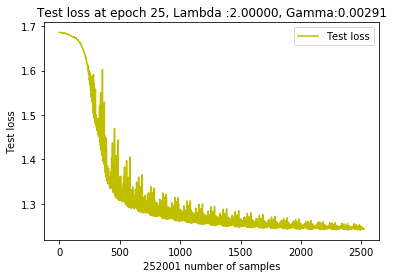

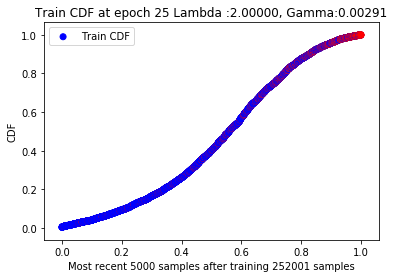

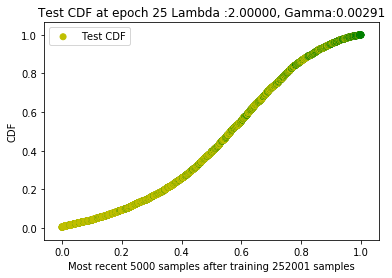

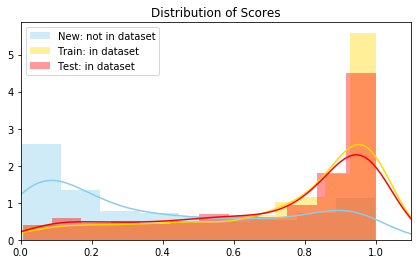

 20%|██        | 2005/10000 [15:36<10:08:56,  4.57s/it]

New score:  0.3880655
Train score:  0.7466504
Test score:  0.73154217


 40%|███▉      | 3997/10000 [30:10<03:14, 30.90it/s]   

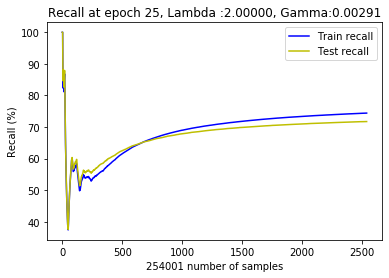

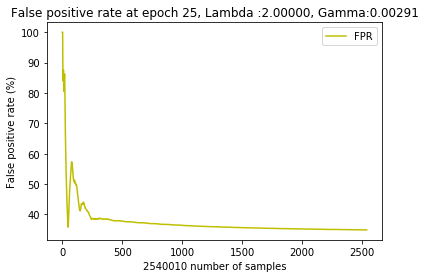

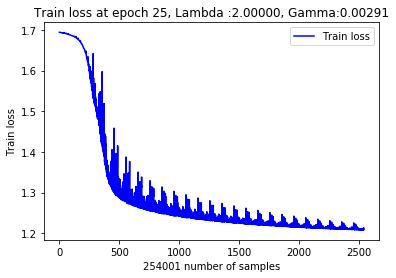

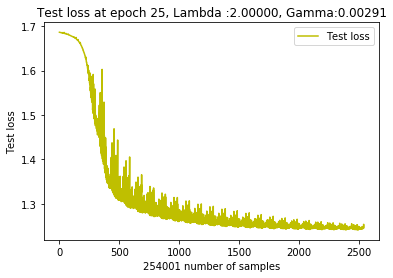

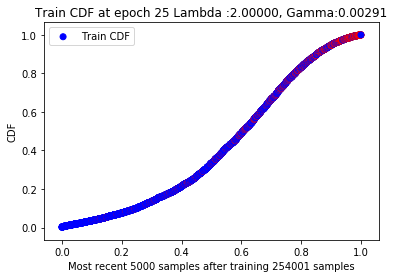

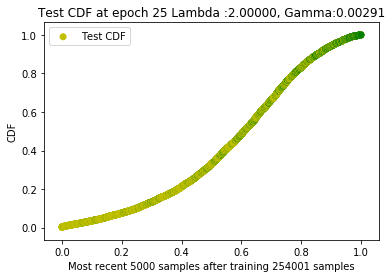

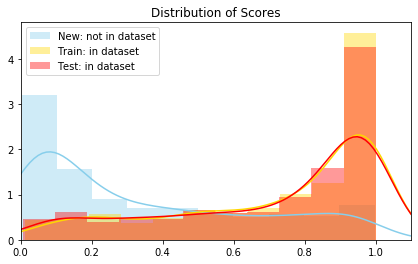

 40%|████      | 4005/10000 [30:35<3:53:21,  2.34s/it]

New score:  0.3317958
Train score:  0.7221519
Test score:  0.7097498


 60%|██████    | 6000/10000 [45:00<02:03, 32.30it/s]   

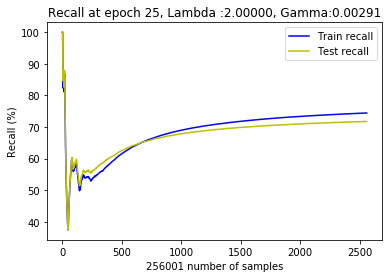

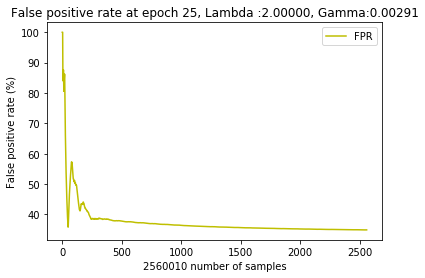

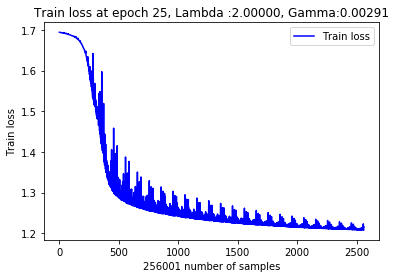

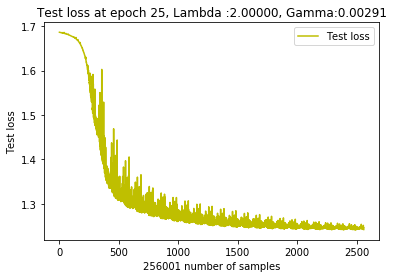

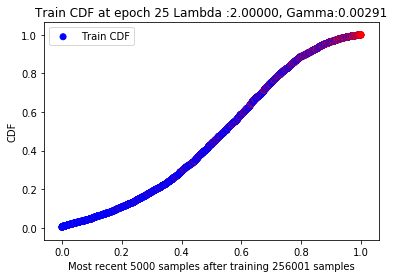

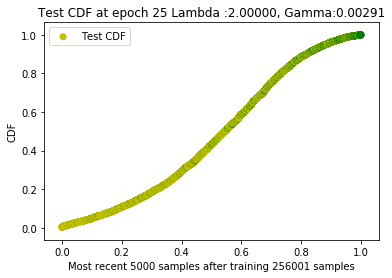

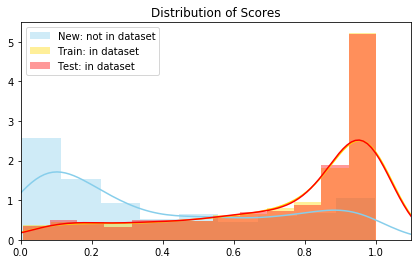

 60%|██████    | 6005/10000 [45:25<10:12:32,  9.20s/it]

New score:  0.38040566
Train score:  0.7390845
Test score:  0.75095874


 80%|████████  | 8000/10000 [59:50<01:02, 32.13it/s]   

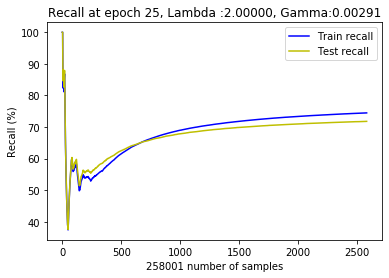

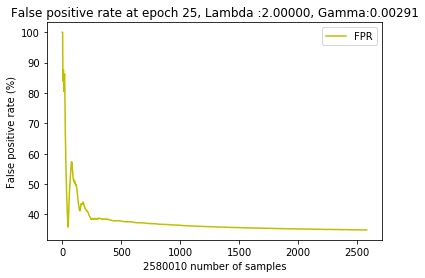

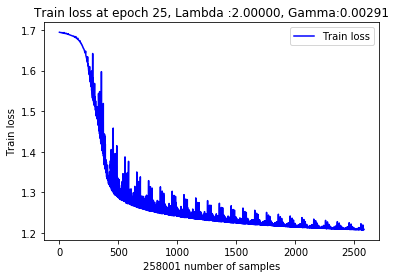

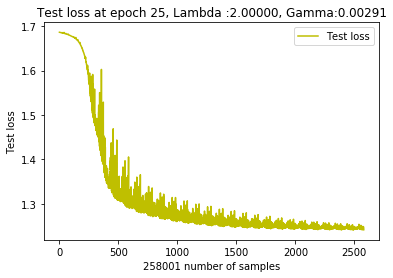

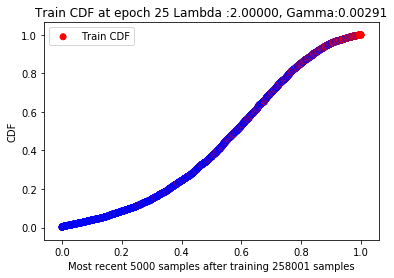

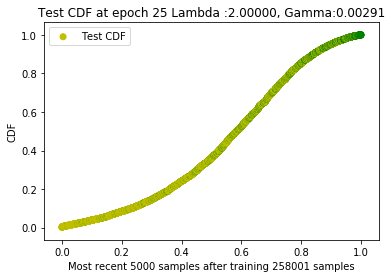

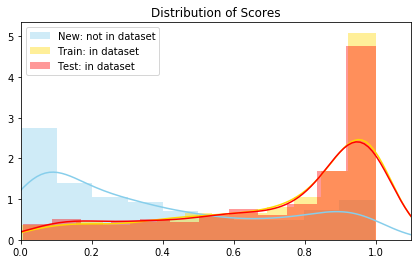

 80%|████████  | 8005/10000 [1:00:19<5:11:59,  9.38s/it]

New score:  0.3929172
Train score:  0.7265245
Test score:  0.7150799


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  26  with learning rate:  0.0026167381651368057


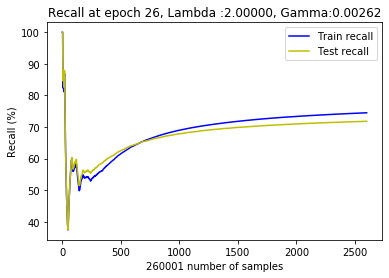

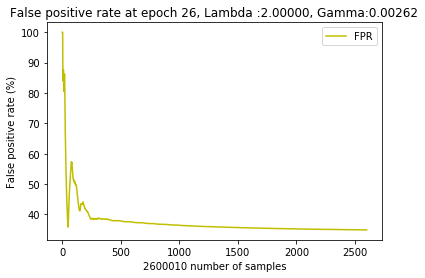

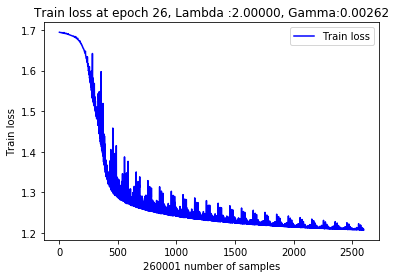

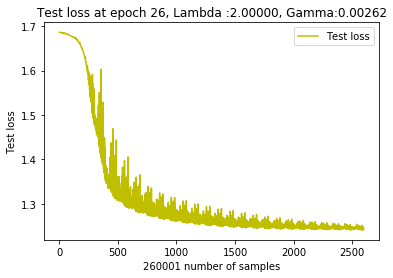

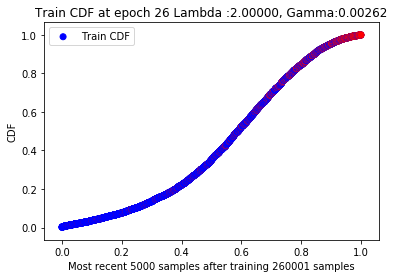

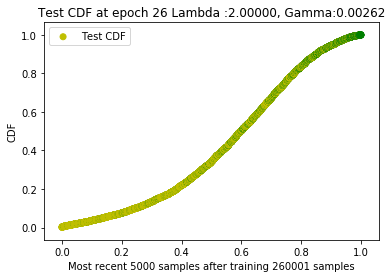

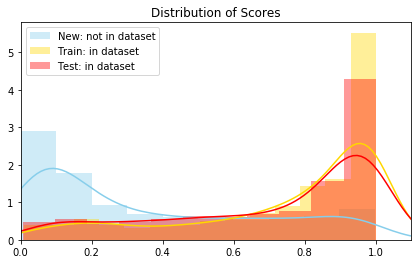

  0%|          | 5/10000 [00:45<87:21:09, 31.46s/it] 

New score:  0.34373364
Train score:  0.7426958
Test score:  0.70904905


 20%|█▉        | 1997/10000 [15:00<04:58, 26.78it/s]   

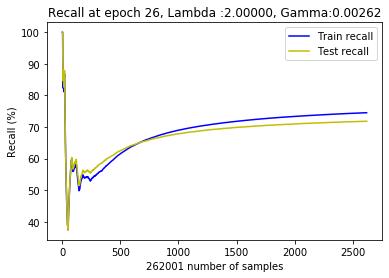

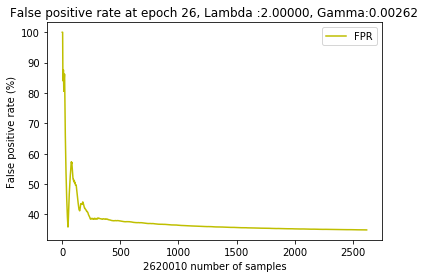

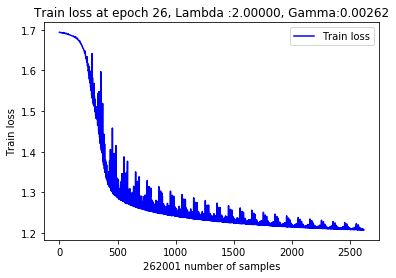

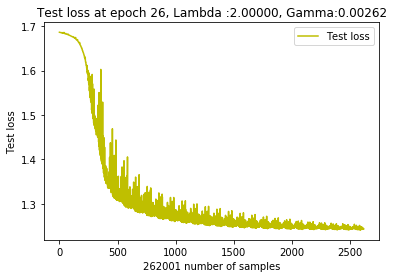

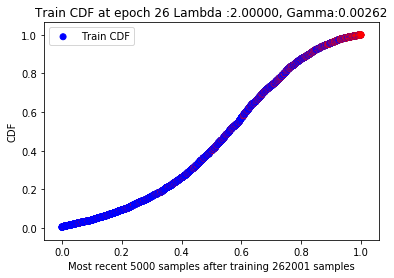

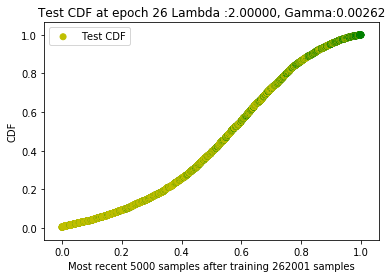

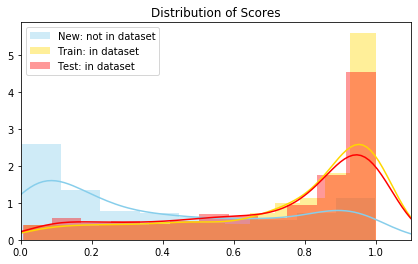

 20%|██        | 2005/10000 [15:32<5:14:45,  2.36s/it]

New score:  0.38842204
Train score:  0.7464752
Test score:  0.73108894


 40%|███▉      | 3997/10000 [29:50<03:24, 29.42it/s]   

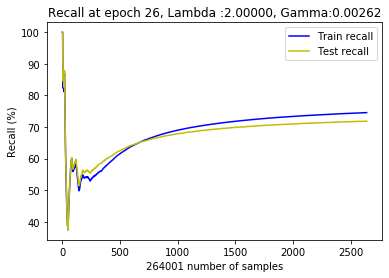

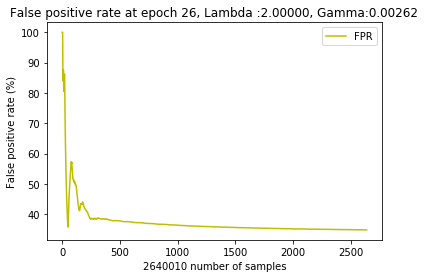

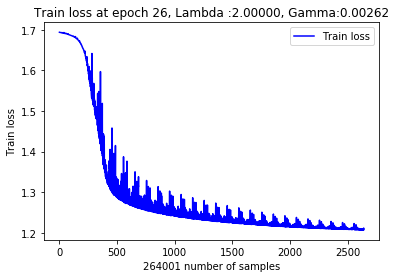

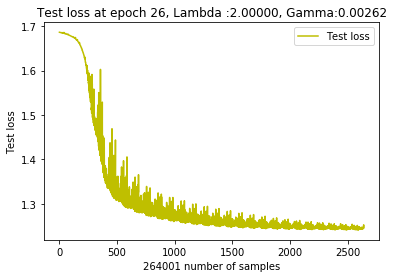

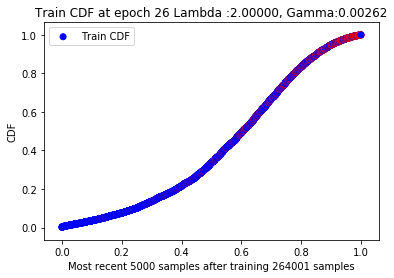

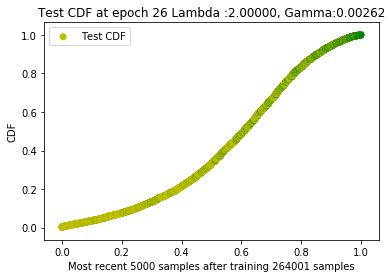

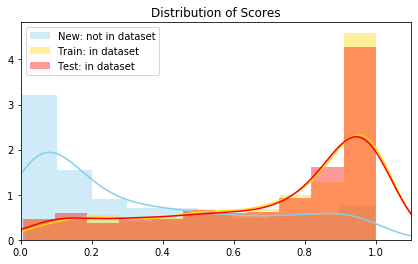

 40%|████      | 4004/10000 [30:16<4:02:56,  2.43s/it]

New score:  0.33200505
Train score:  0.723596
Test score:  0.7111495


 60%|█████▉    | 5999/10000 [44:30<02:13, 30.00it/s]   

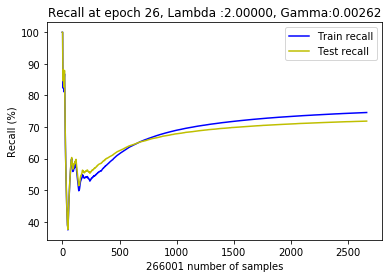

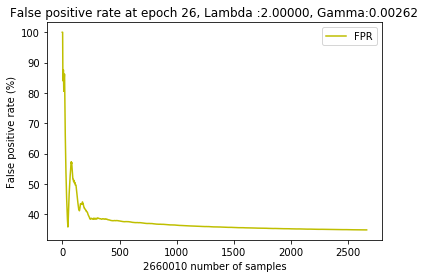

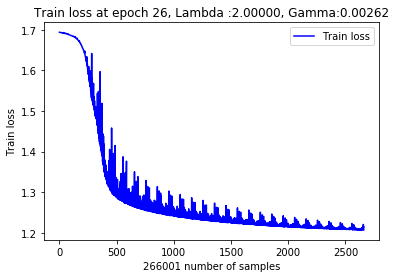

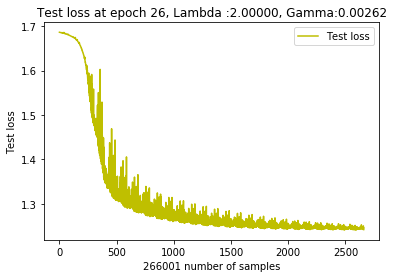

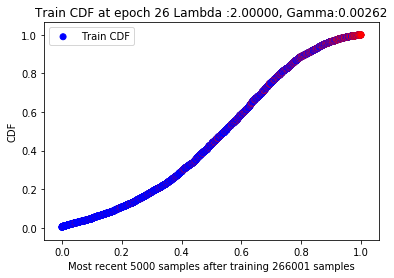

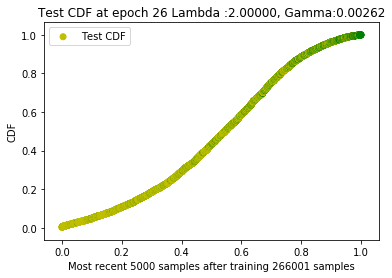

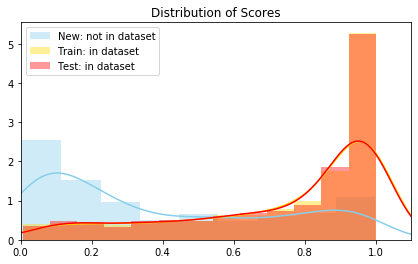

 60%|██████    | 6005/10000 [45:10<5:56:41,  5.36s/it]

New score:  0.38261342
Train score:  0.73923403
Test score:  0.7509857


 80%|███████▉  | 7997/10000 [59:20<01:03, 31.77it/s]   

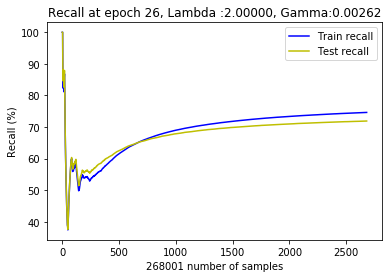

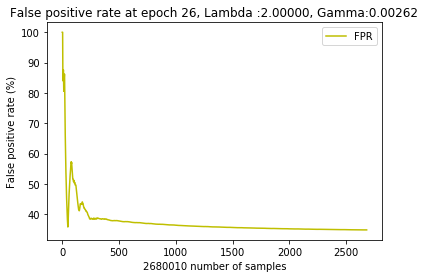

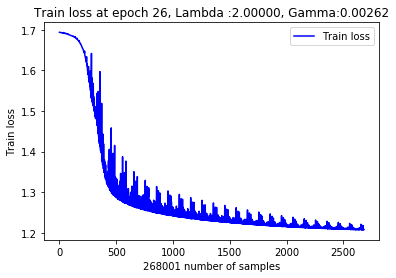

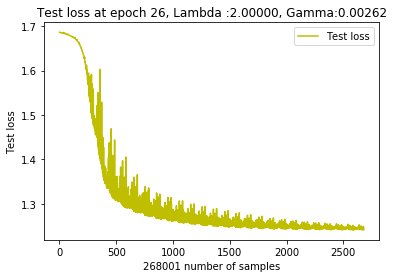

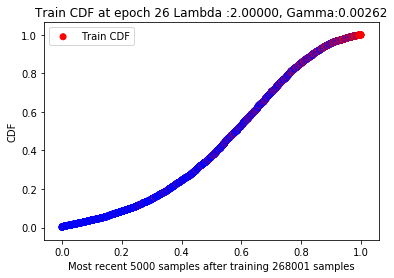

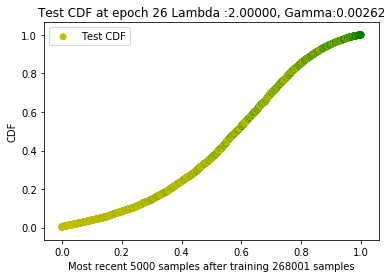

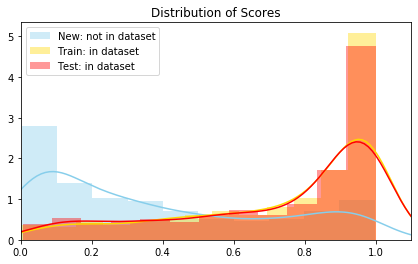

 80%|████████  | 8005/10000 [59:49<1:23:16,  2.50s/it]

New score:  0.39049658
Train score:  0.7277989
Test score:  0.7161123


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  27  with learning rate:  0.002355064348623125


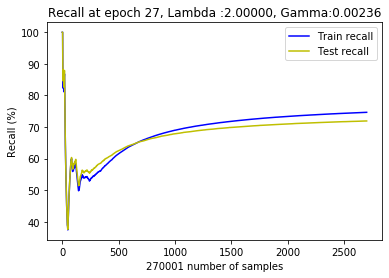

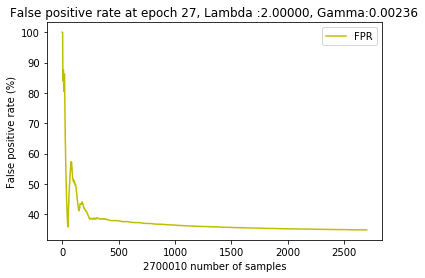

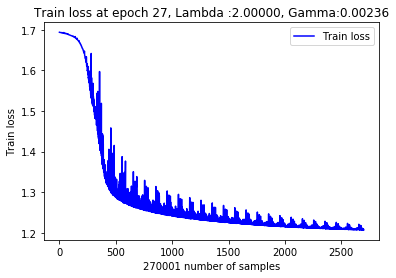

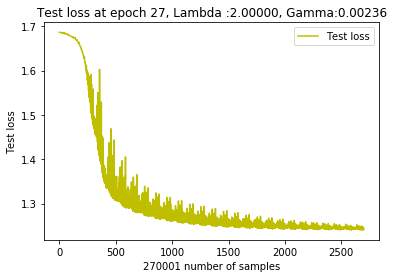

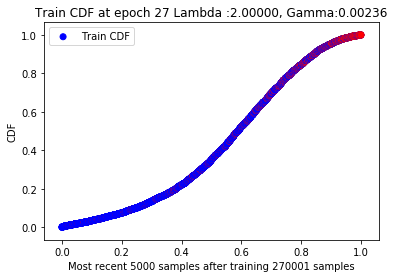

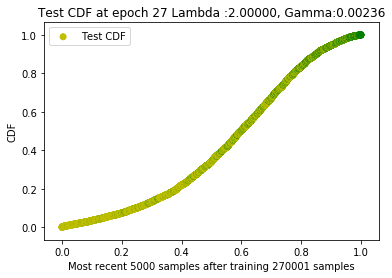

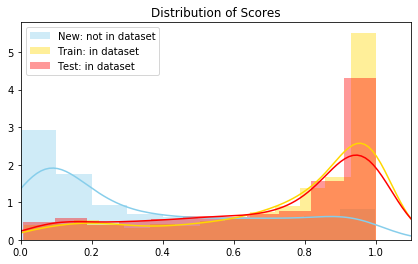

  0%|          | 5/10000 [00:43<84:23:30, 30.40s/it] 

New score:  0.3430548
Train score:  0.74368215
Test score:  0.7099064


 20%|█▉        | 1997/10000 [15:00<04:58, 26.84it/s]   

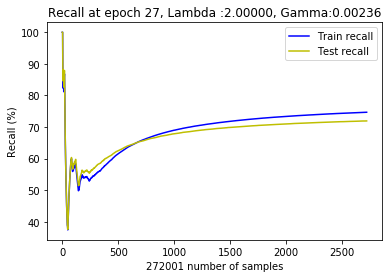

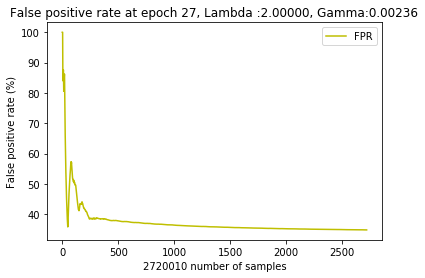

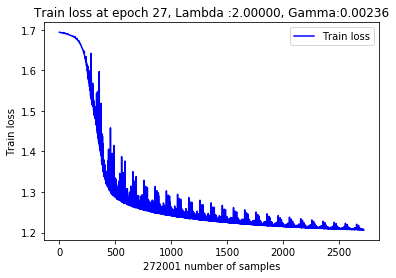

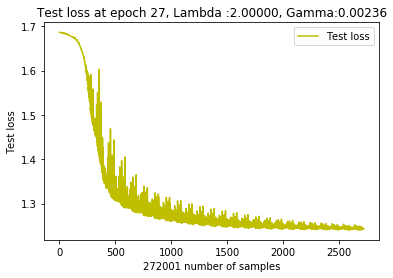

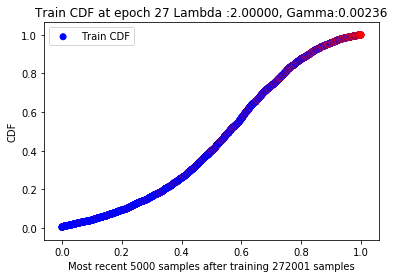

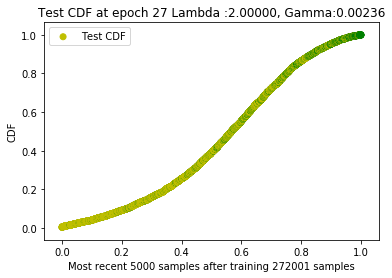

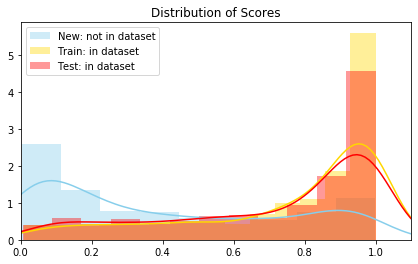

 20%|██        | 2005/10000 [15:25<5:10:49,  2.33s/it]

New score:  0.3888646
Train score:  0.7463251
Test score:  0.73068154


 40%|███▉      | 3997/10000 [30:00<03:15, 30.73it/s]   

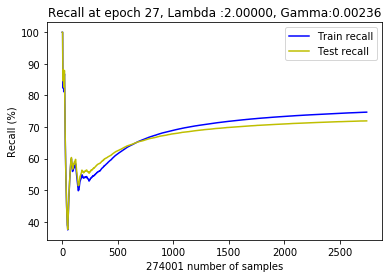

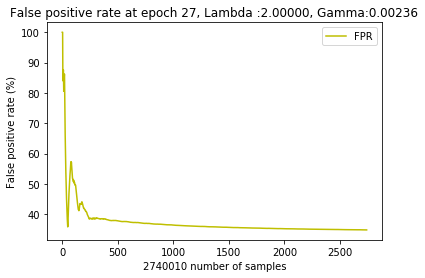

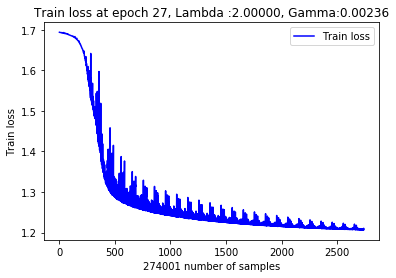

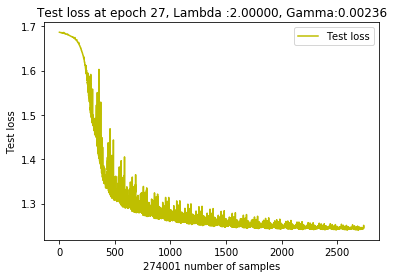

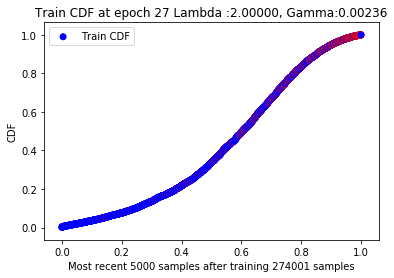

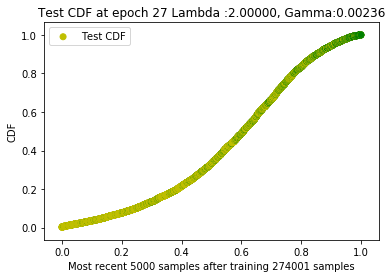

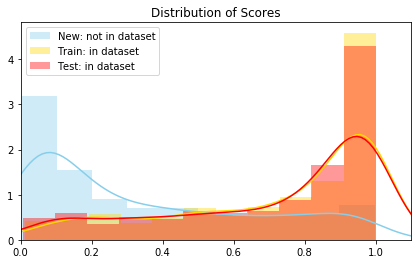

 40%|████      | 4004/10000 [30:26<3:53:42,  2.34s/it]

New score:  0.33238342
Train score:  0.72495824
Test score:  0.7124729


 60%|█████▉    | 5997/10000 [44:50<02:04, 32.02it/s]   

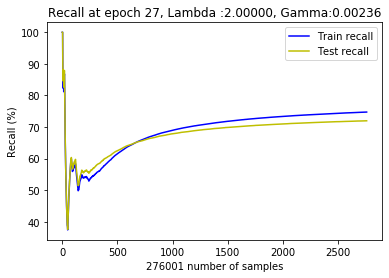

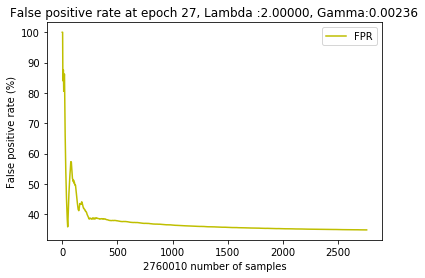

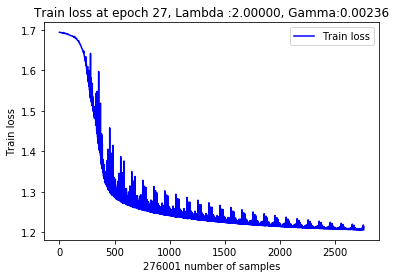

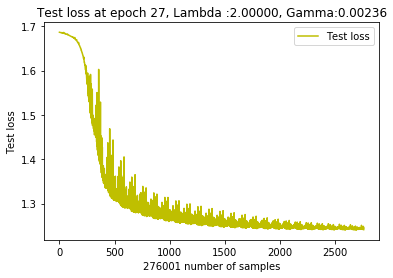

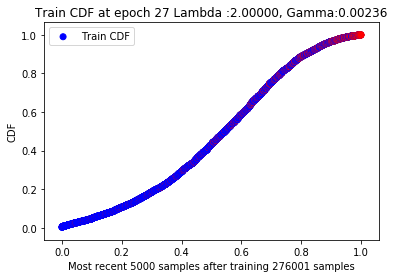

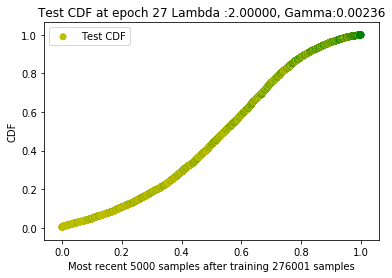

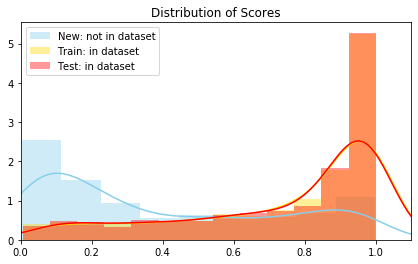

 60%|██████    | 6005/10000 [45:23<2:34:42,  2.32s/it]

New score:  0.3847511
Train score:  0.7393482
Test score:  0.7510026


 80%|████████  | 8000/10000 [59:50<01:02, 32.04it/s]   

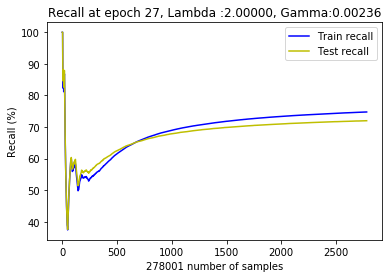

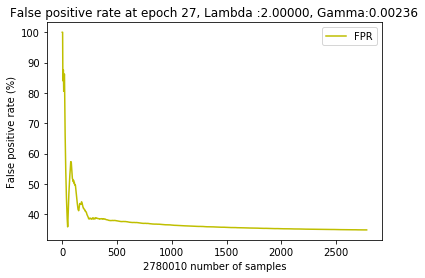

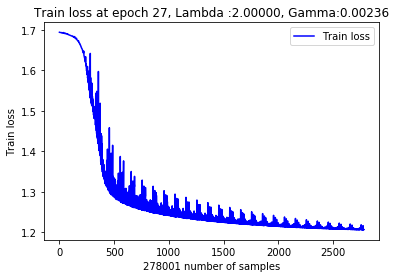

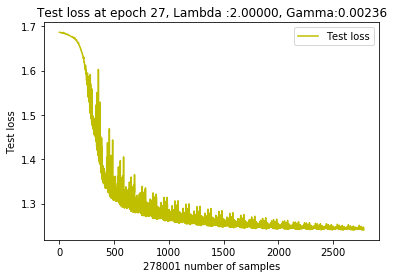

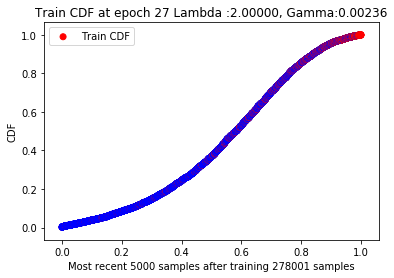

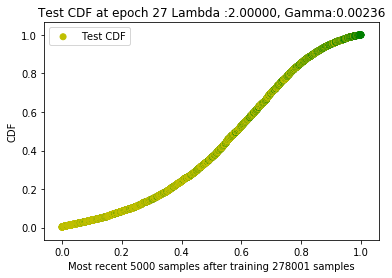

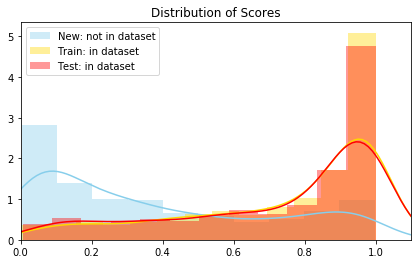

 80%|████████  | 8005/10000 [1:00:19<5:10:03,  9.32s/it]

New score:  0.38852468
Train score:  0.72905576
Test score:  0.7171261


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  28  with learning rate:  0.002119557913760813


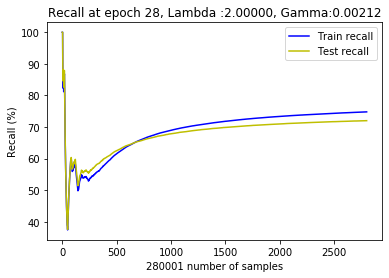

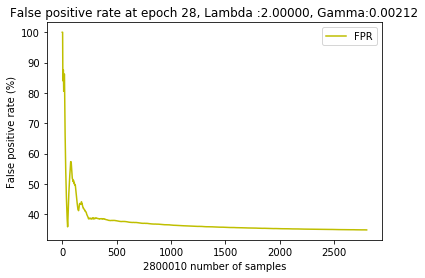

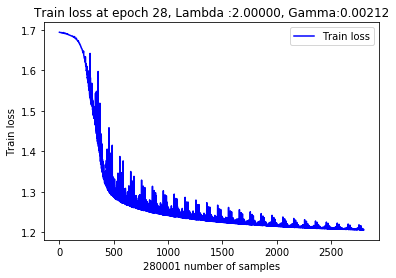

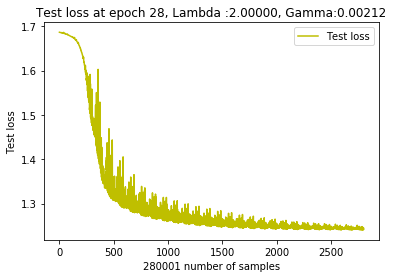

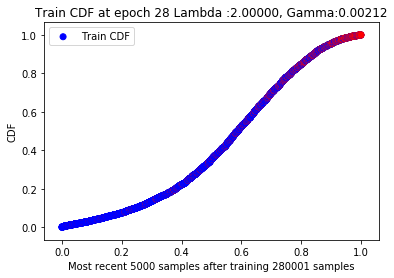

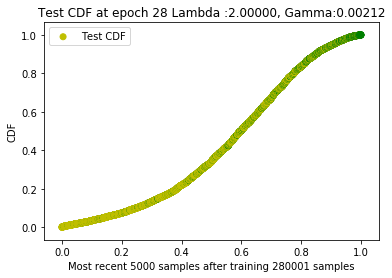

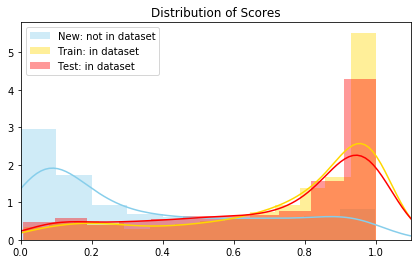

  0%|          | 4/10000 [00:45<88:20:00, 31.81s/it] 

New score:  0.34259394
Train score:  0.7447296
Test score:  0.7108346


 20%|█▉        | 1998/10000 [15:10<05:11, 25.67it/s]   

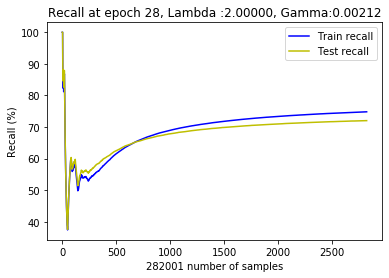

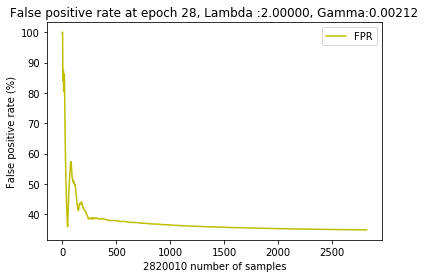

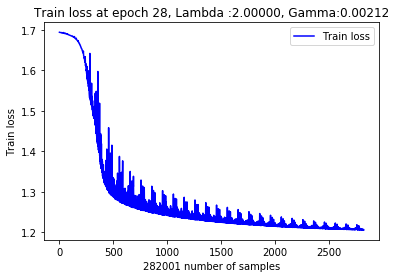

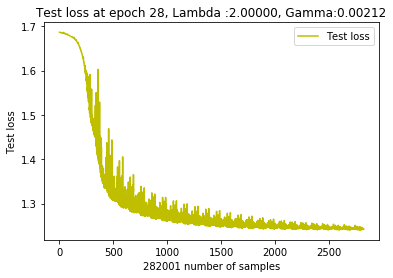

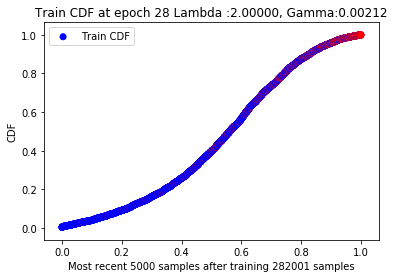

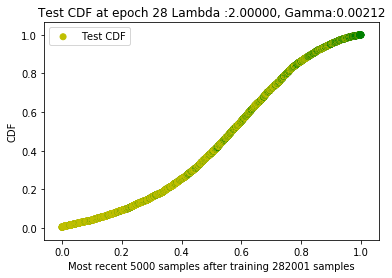

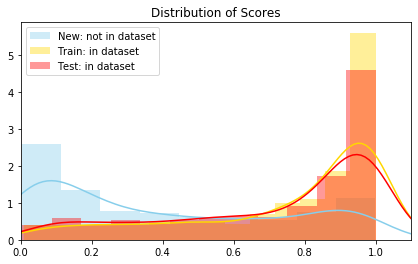

 20%|██        | 2005/10000 [15:44<6:55:22,  3.12s/it]

New score:  0.38919422
Train score:  0.746182
Test score:  0.730291


 40%|███▉      | 3997/10000 [30:10<03:14, 30.86it/s]   

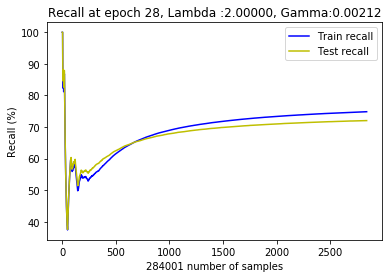

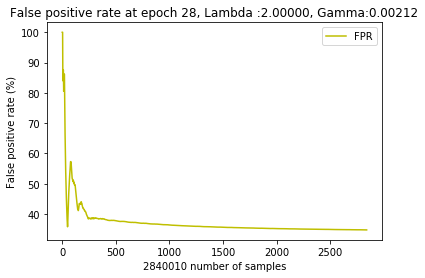

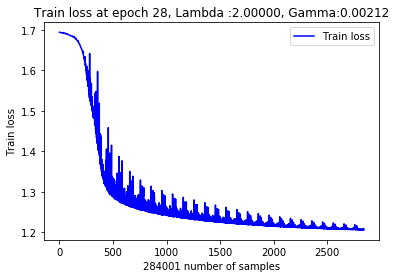

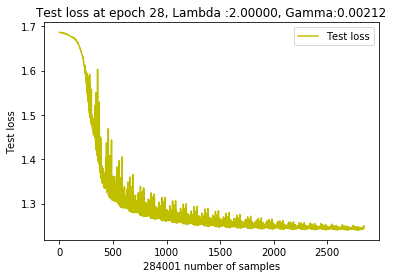

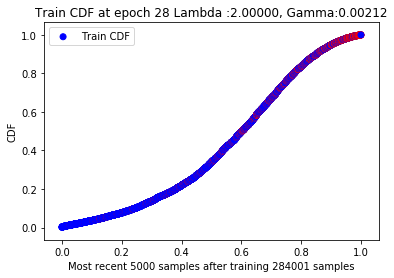

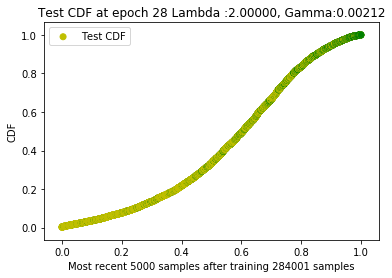

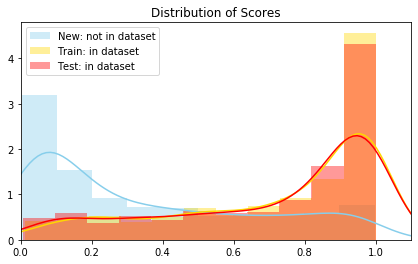

 40%|████      | 4005/10000 [30:42<3:52:33,  2.33s/it]

New score:  0.33298957
Train score:  0.726335
Test score:  0.7138172


 60%|█████▉    | 5999/10000 [45:10<02:09, 30.91it/s]   

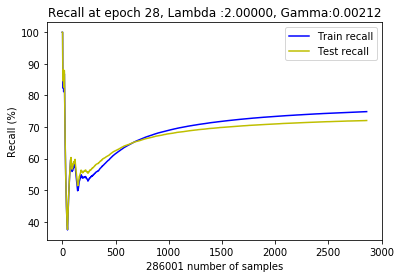

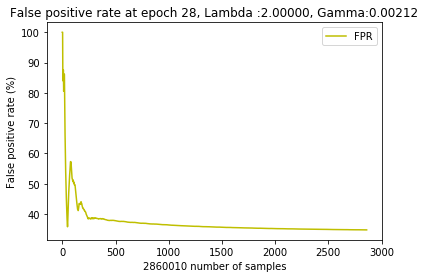

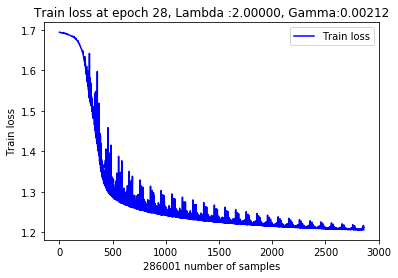

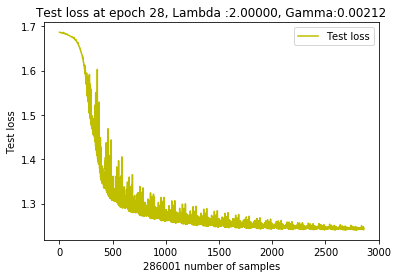

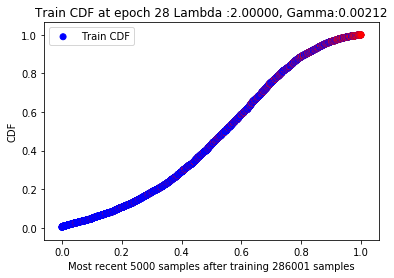

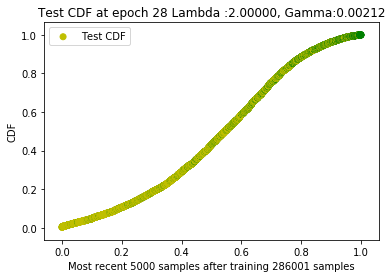

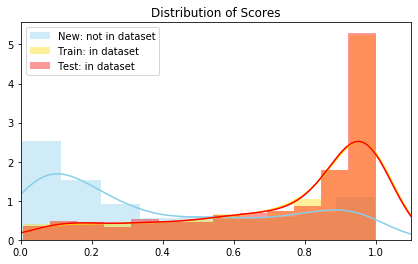

 60%|██████    | 6005/10000 [45:36<5:05:07,  4.58s/it]

New score:  0.38659436
Train score:  0.73934656
Test score:  0.7509061


 80%|███████▉  | 7998/10000 [1:00:00<01:04, 31.12it/s] 

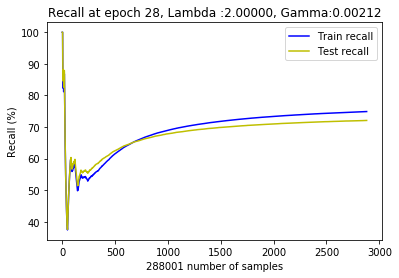

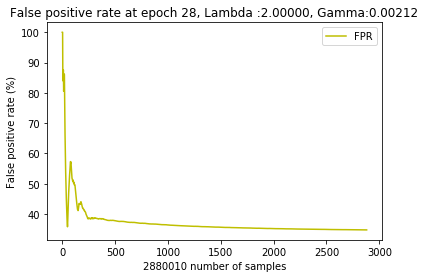

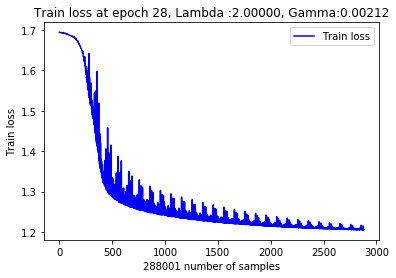

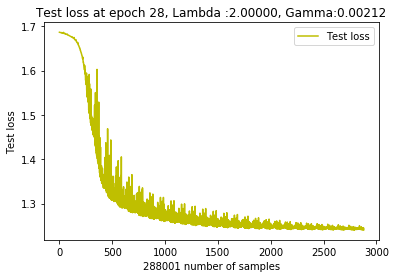

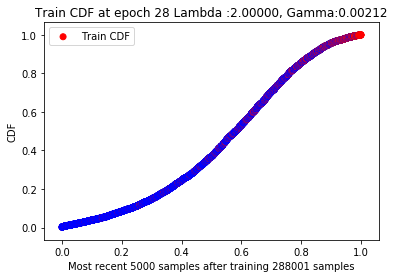

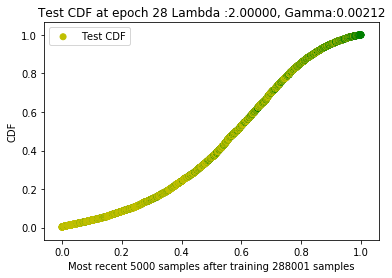

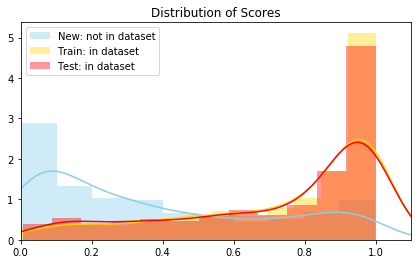

 80%|████████  | 8005/10000 [1:00:30<1:44:07,  3.13s/it]

New score:  0.3866604
Train score:  0.73048055
Test score:  0.718328


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  29  with learning rate:  0.0019076021223847317


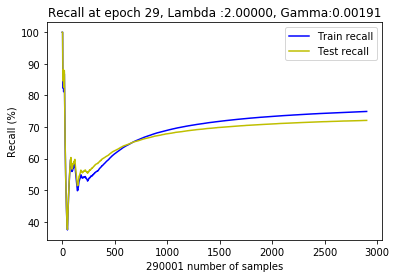

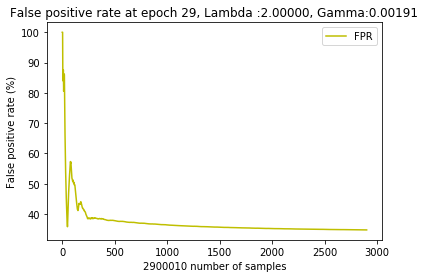

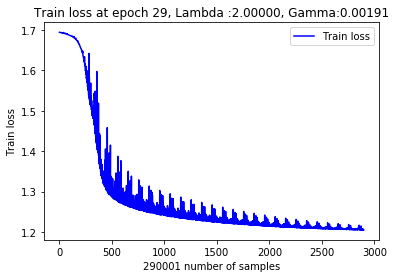

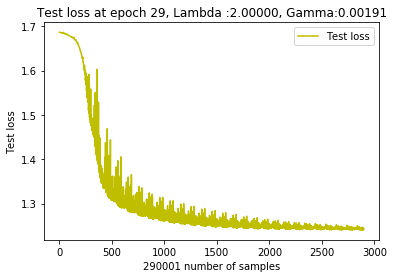

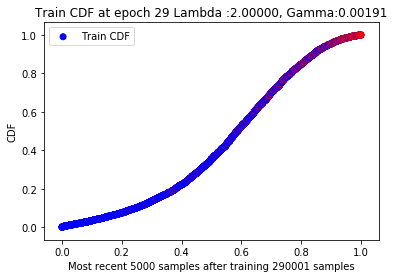

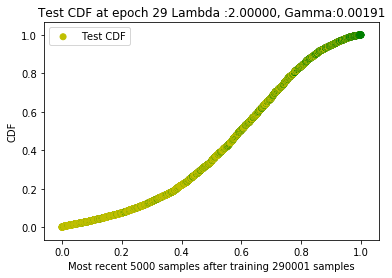

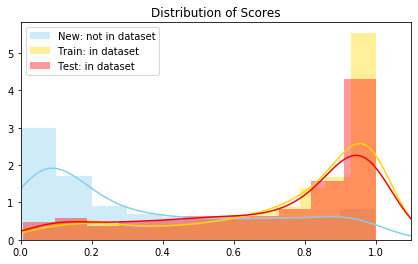

  0%|          | 5/10000 [00:54<105:20:57, 37.94s/it]

New score:  0.34205988
Train score:  0.7456146
Test score:  0.7116104


 20%|█▉        | 1997/10000 [15:20<05:03, 26.38it/s]   

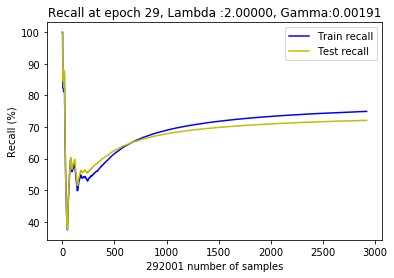

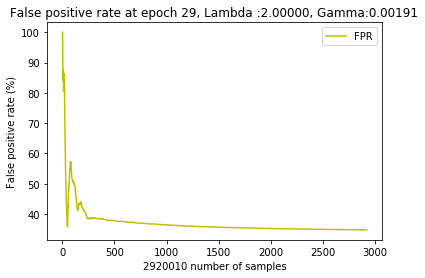

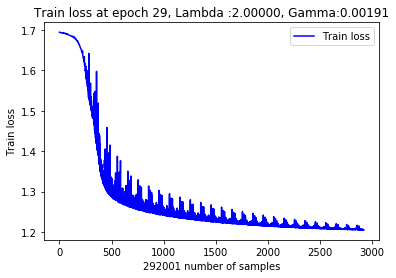

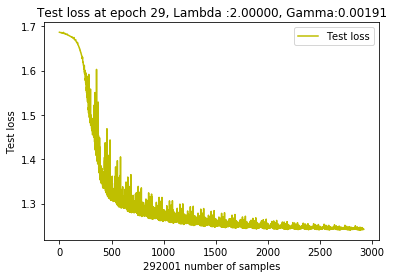

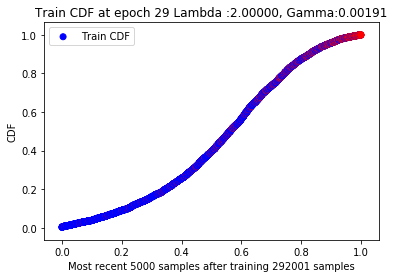

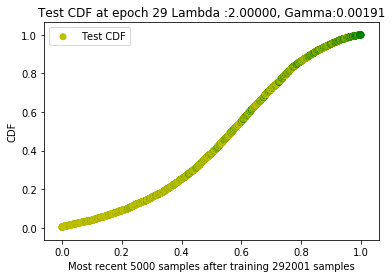

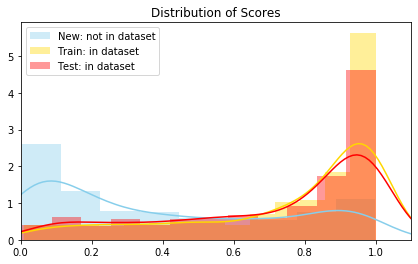

 20%|██        | 2005/10000 [15:56<5:58:06,  2.69s/it]

New score:  0.38933358
Train score:  0.7459873
Test score:  0.72987914


 40%|███▉      | 3997/10000 [30:10<03:18, 30.27it/s]   

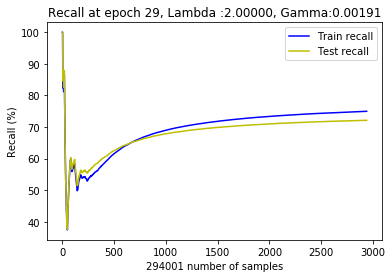

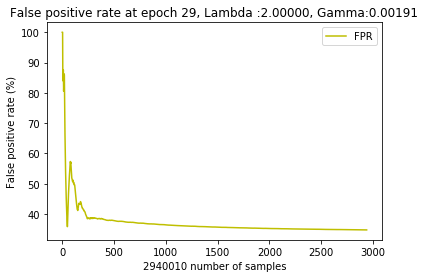

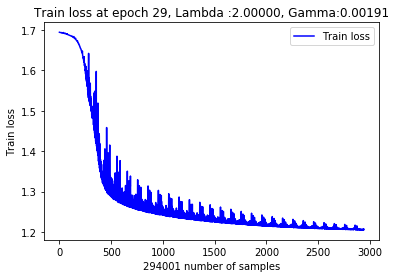

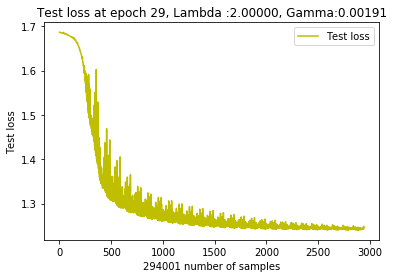

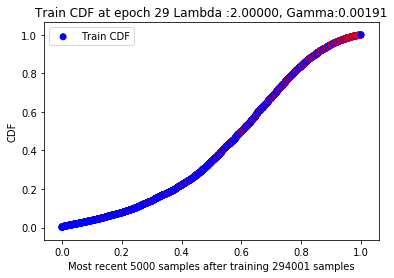

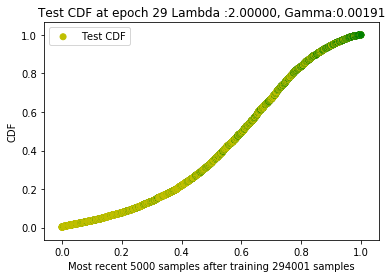

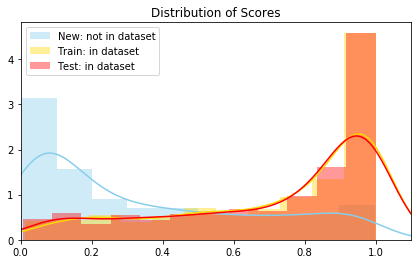

 40%|████      | 4005/10000 [30:45<4:01:51,  2.42s/it]

New score:  0.333768
Train score:  0.7276227
Test score:  0.7150686


 60%|██████    | 6000/10000 [45:00<02:16, 29.27it/s]   

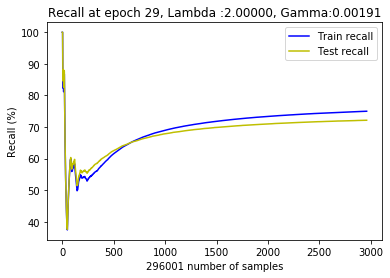

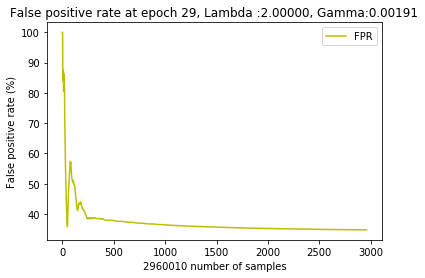

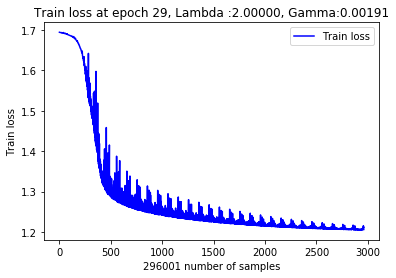

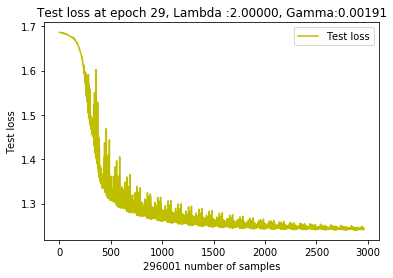

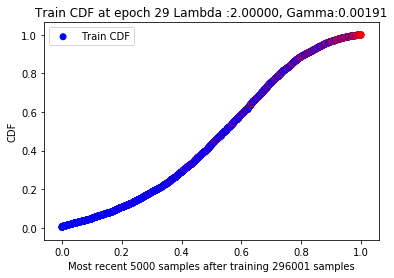

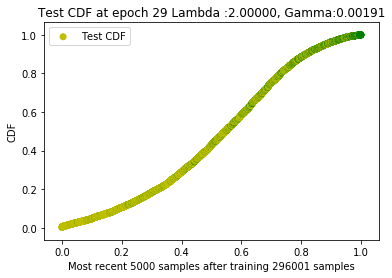

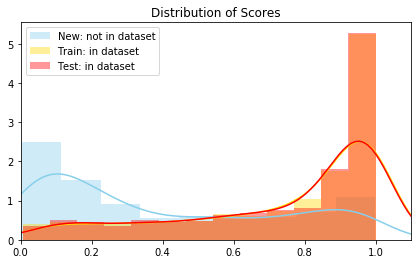

 60%|██████    | 6005/10000 [45:34<10:26:41,  9.41s/it]

New score:  0.38825664
Train score:  0.7393003
Test score:  0.7507775


 80%|████████  | 8000/10000 [1:00:00<01:02, 31.91it/s] 

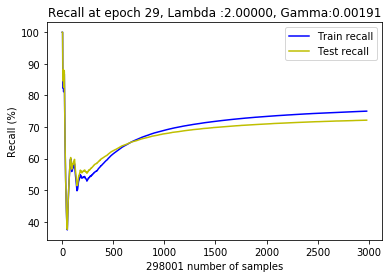

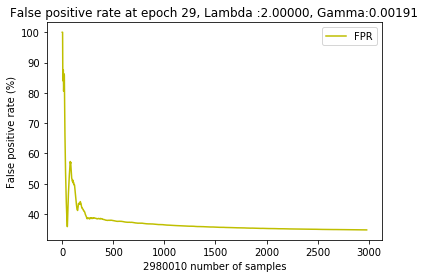

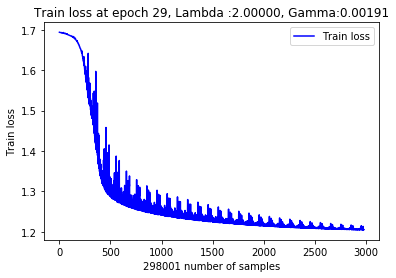

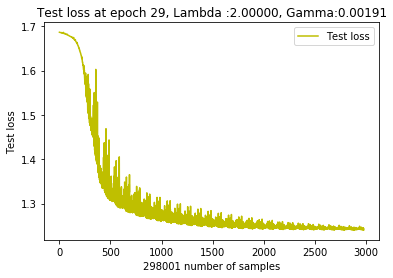

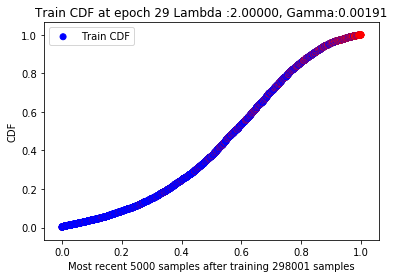

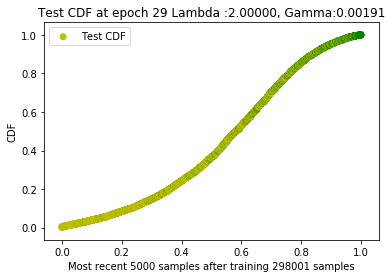

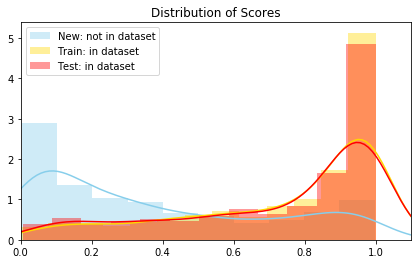

 80%|████████  | 8005/10000 [1:00:30<5:12:00,  9.38s/it]

New score:  0.3851084
Train score:  0.73193264
Test score:  0.7195506


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  30  with learning rate:  0.0017168419101462585


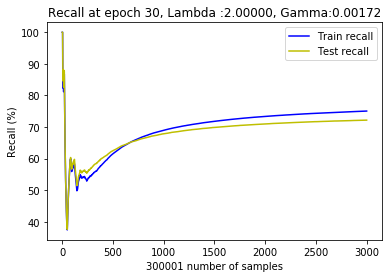

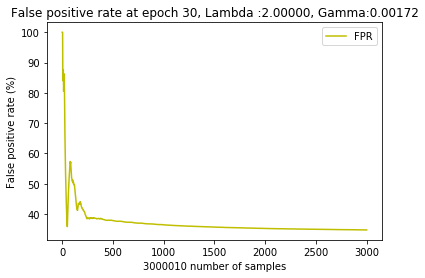

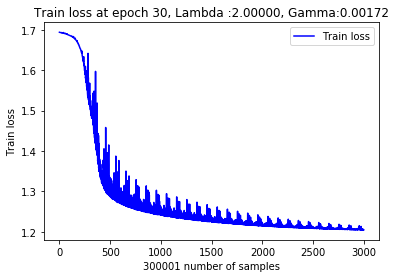

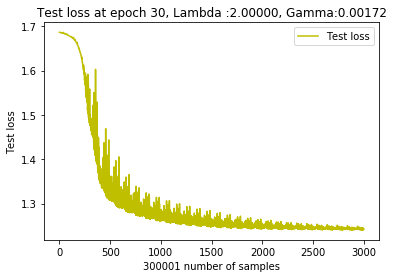

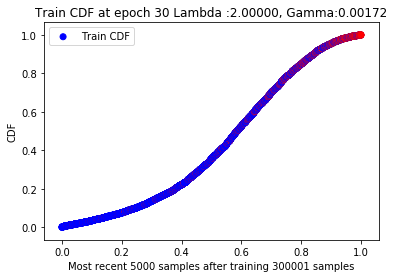

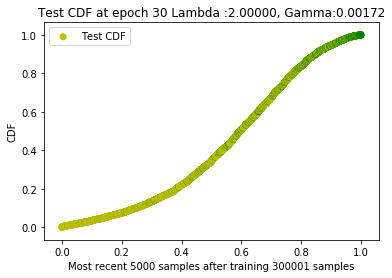

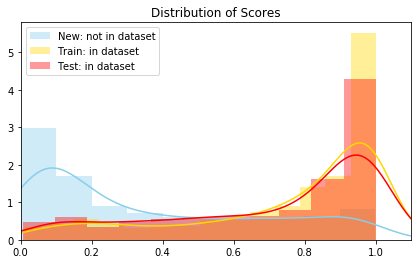

  0%|          | 5/10000 [00:43<85:07:27, 30.66s/it] 

New score:  0.3417525
Train score:  0.74653536
Test score:  0.712427


 20%|█▉        | 1999/10000 [15:00<04:57, 26.91it/s]   

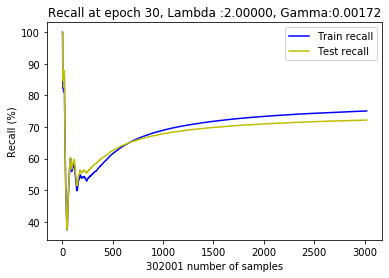

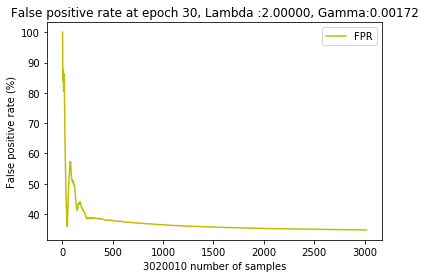

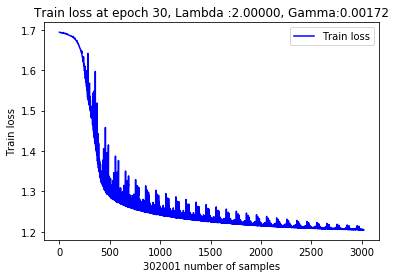

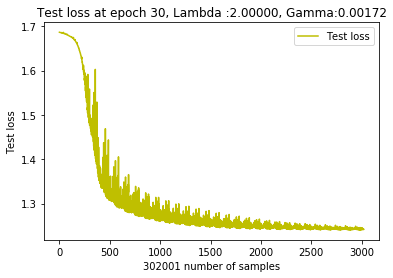

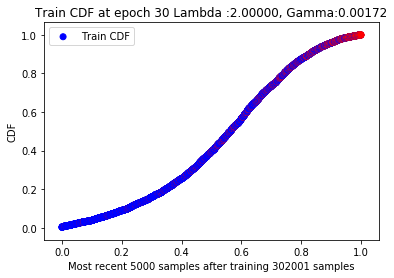

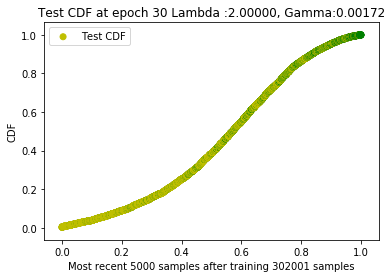

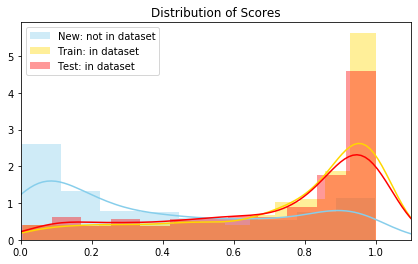

 20%|██        | 2004/10000 [15:32<10:17:05,  4.63s/it]

New score:  0.38943306
Train score:  0.7457879
Test score:  0.72947526


 40%|███▉      | 3998/10000 [30:00<03:20, 30.00it/s]   

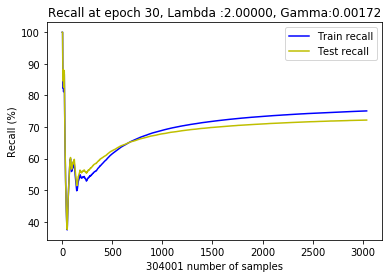

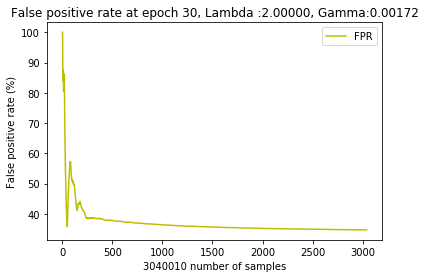

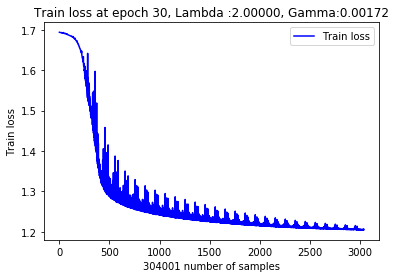

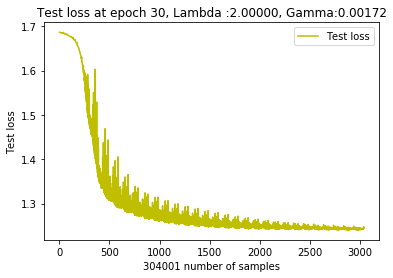

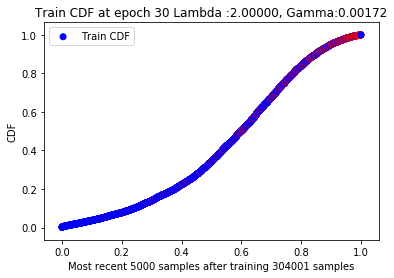

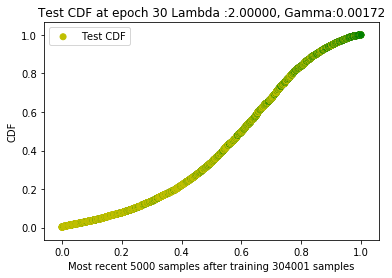

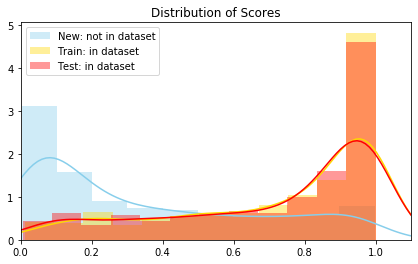

 40%|████      | 4005/10000 [30:24<5:07:32,  3.08s/it]

New score:  0.33480552
Train score:  0.72904307
Test score:  0.71646255


 60%|█████▉    | 5999/10000 [44:50<02:08, 31.10it/s]   

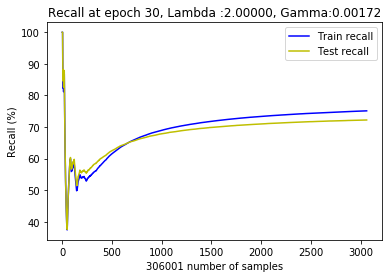

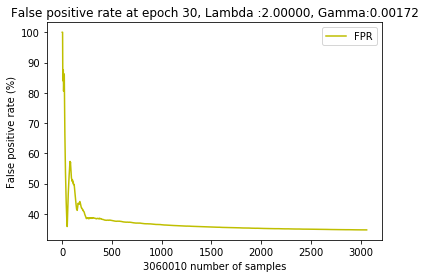

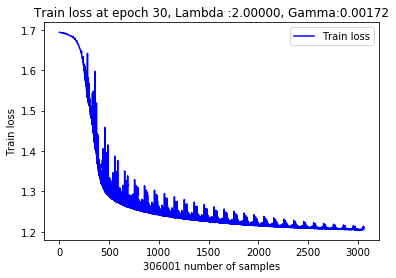

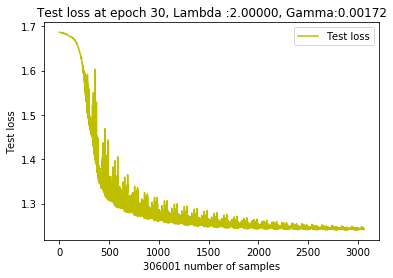

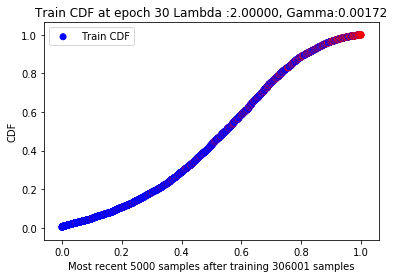

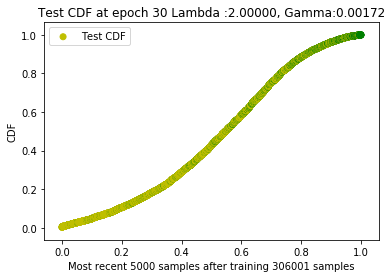

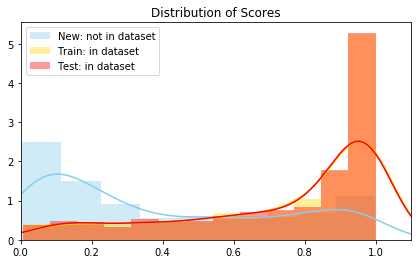

 60%|██████    | 6004/10000 [45:19<5:04:57,  4.58s/it]

New score:  0.38961104
Train score:  0.7391122
Test score:  0.7505122


 80%|███████▉  | 7998/10000 [59:40<01:01, 32.42it/s]   

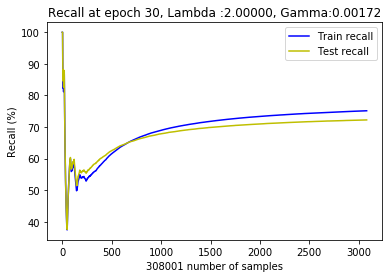

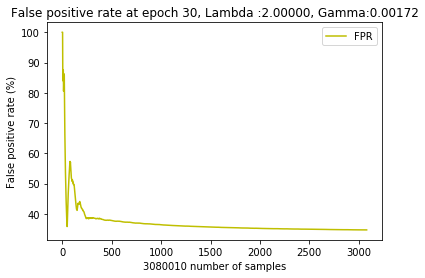

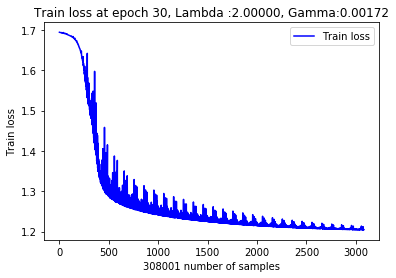

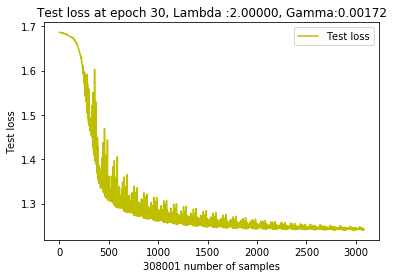

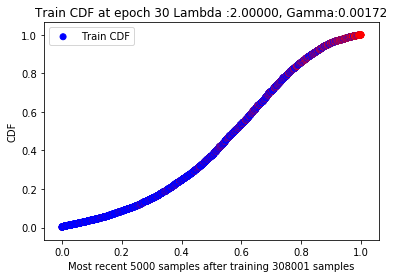

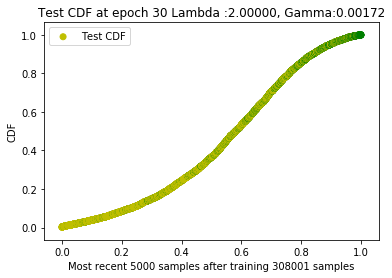

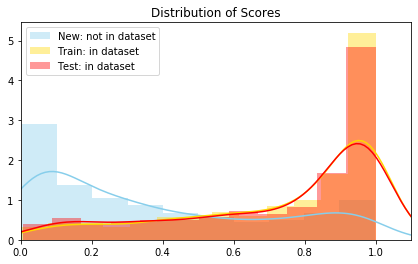

 80%|████████  | 8005/10000 [1:00:13<1:44:07,  3.13s/it]

New score:  0.383703
Train score:  0.7333735
Test score:  0.7207792


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  31  with learning rate:  0.0015451577191316326


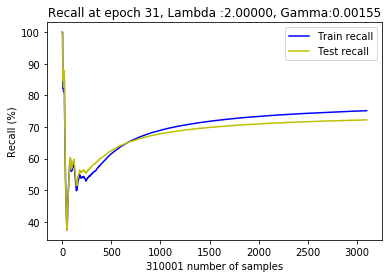

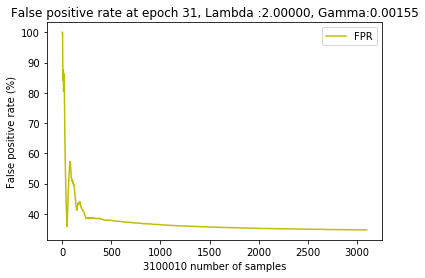

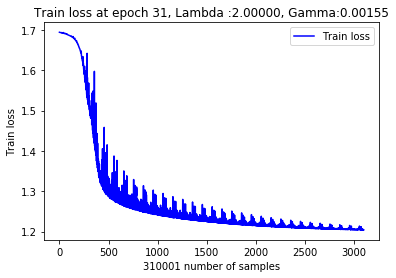

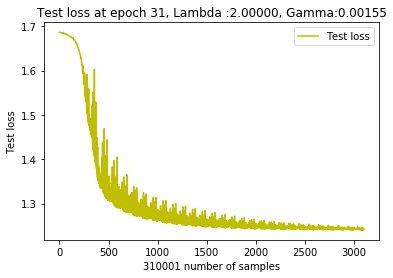

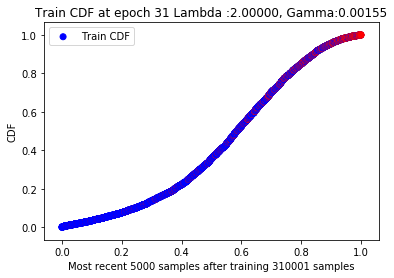

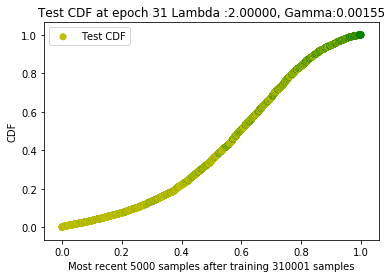

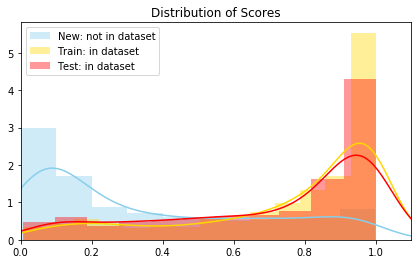

  0%|          | 4/10000 [00:43<84:18:28, 30.36s/it] 

New score:  0.34159872
Train score:  0.7474049
Test score:  0.7132115


 20%|█▉        | 1998/10000 [15:00<05:05, 26.21it/s]   

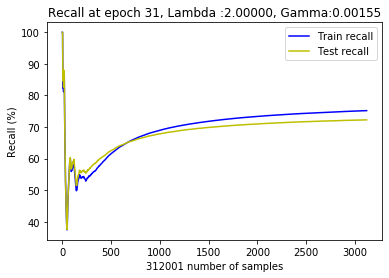

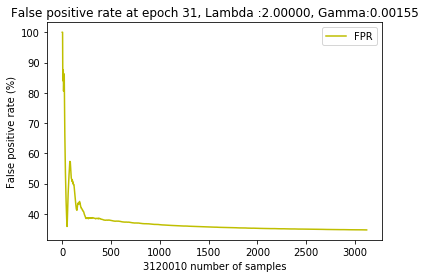

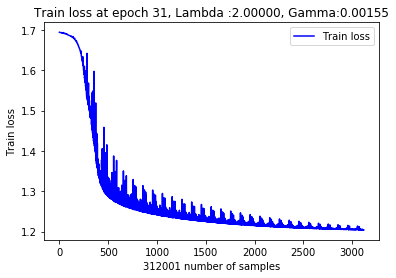

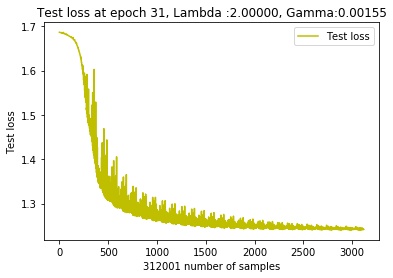

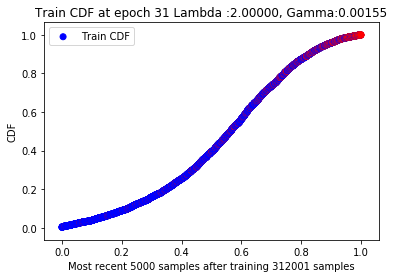

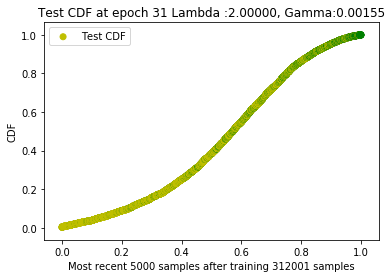

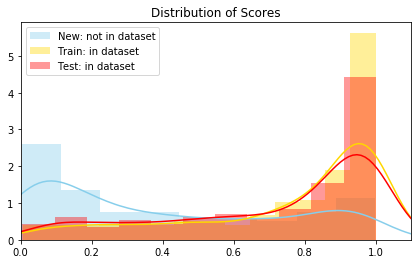

 20%|██        | 2004/10000 [15:30<6:51:35,  3.09s/it]

New score:  0.38942125
Train score:  0.74558127
Test score:  0.72908556


 40%|████      | 4000/10000 [29:40<03:16, 30.58it/s]   

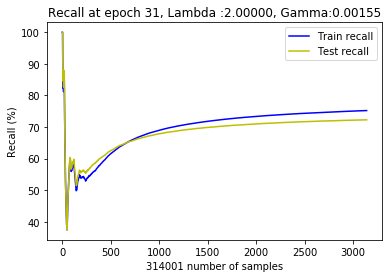

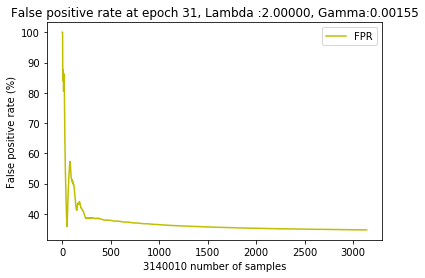

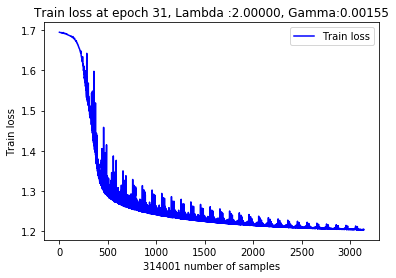

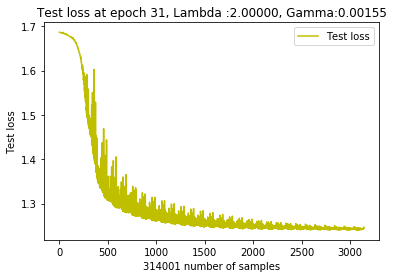

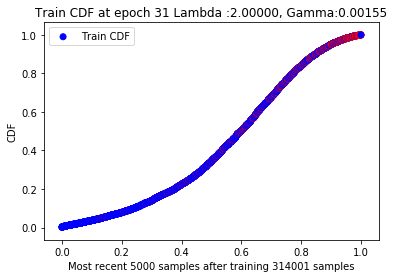

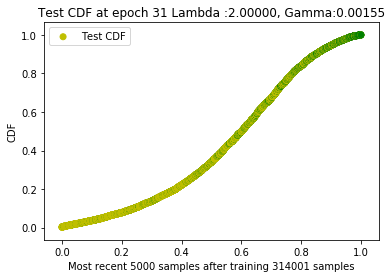

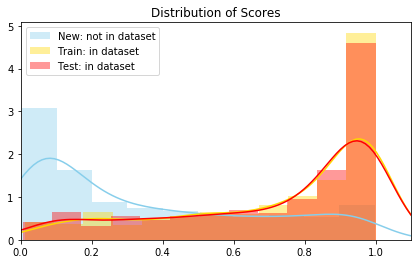

 40%|████      | 4005/10000 [30:11<15:02:52,  9.04s/it]

New score:  0.33585843
Train score:  0.7302329
Test score:  0.71762127


 60%|█████▉    | 5997/10000 [44:20<02:04, 32.28it/s]   

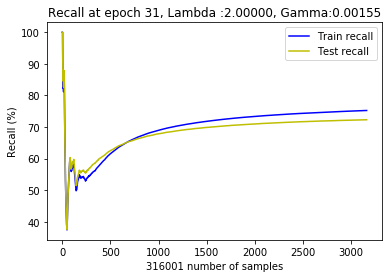

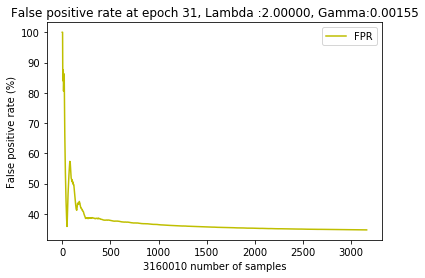

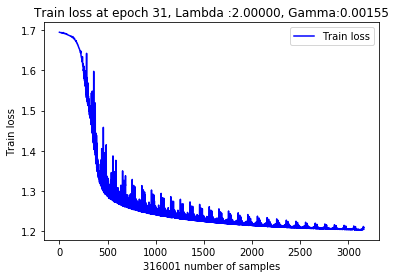

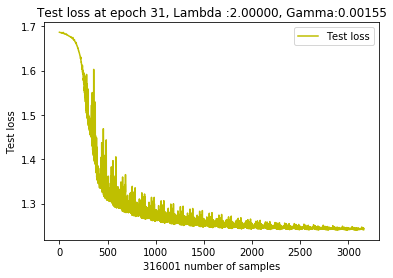

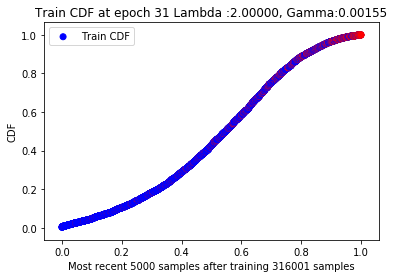

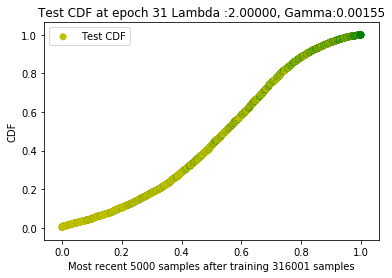

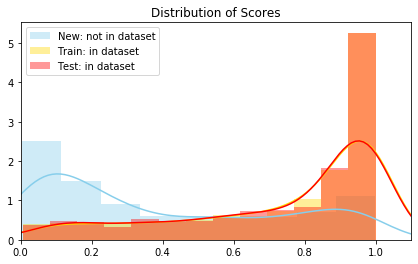

 60%|██████    | 6005/10000 [44:52<2:32:35,  2.29s/it]

New score:  0.39078242
Train score:  0.7389012
Test score:  0.75022686


 80%|███████▉  | 7997/10000 [59:10<01:03, 31.78it/s]   

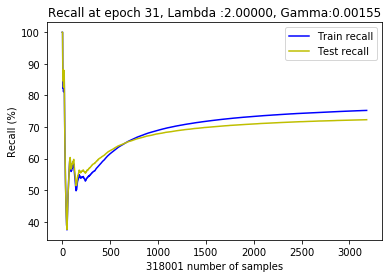

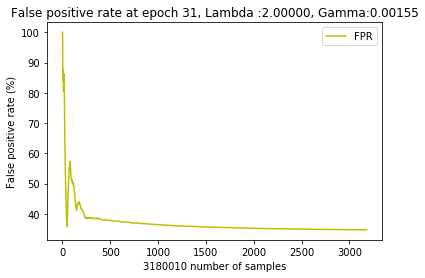

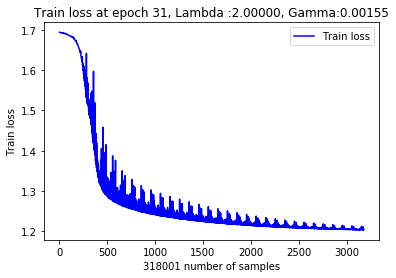

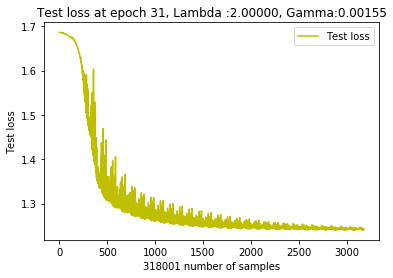

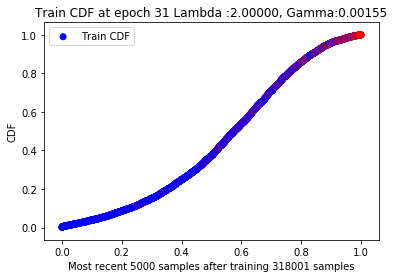

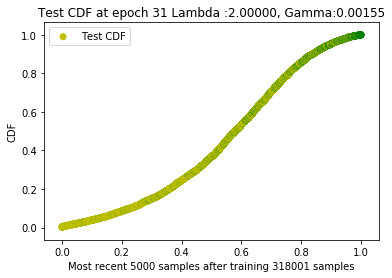

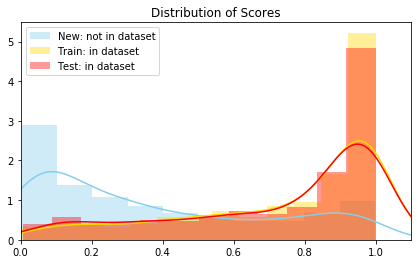

 80%|████████  | 8005/10000 [59:41<1:17:33,  2.33s/it]

New score:  0.38275188
Train score:  0.734826
Test score:  0.72201717


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  32  with learning rate:  0.0013906419472184694


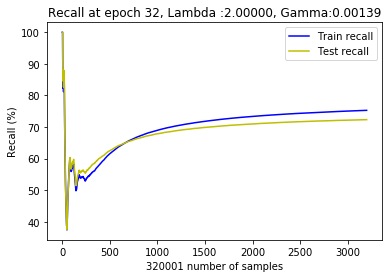

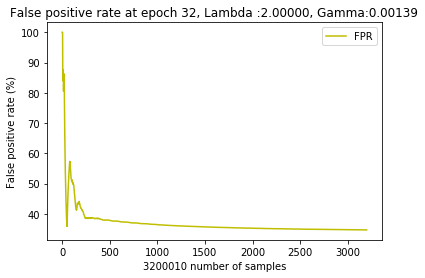

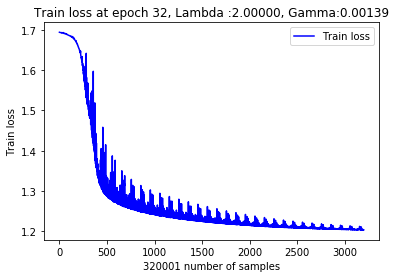

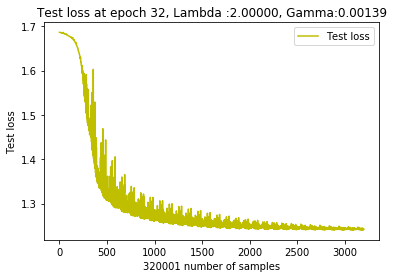

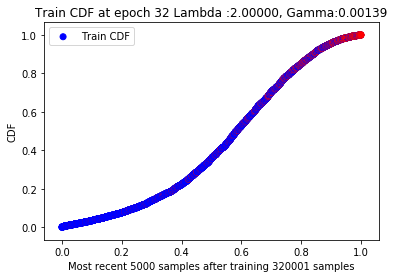

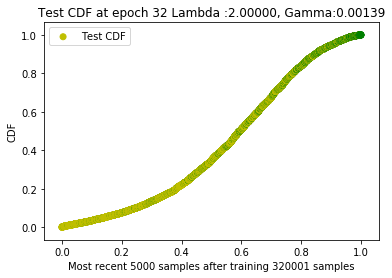

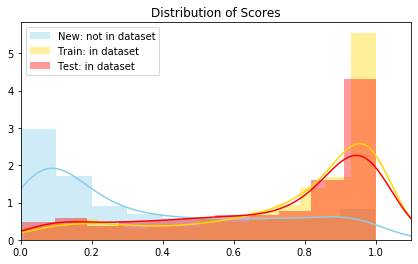

  0%|          | 4/10000 [00:44<85:26:47, 30.77s/it] 

New score:  0.34151685
Train score:  0.7482859
Test score:  0.71400255


 20%|█▉        | 1997/10000 [15:10<05:16, 25.29it/s]   

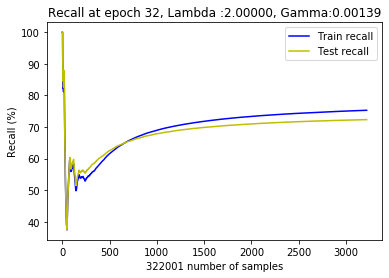

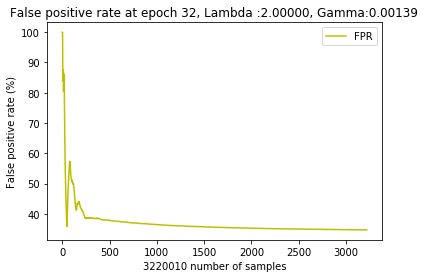

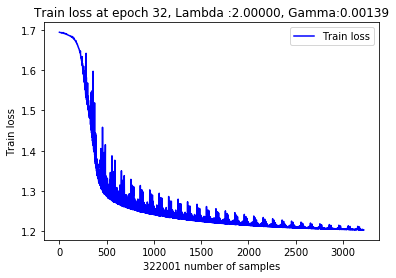

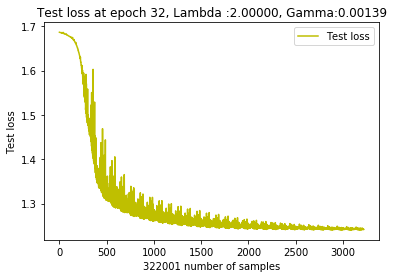

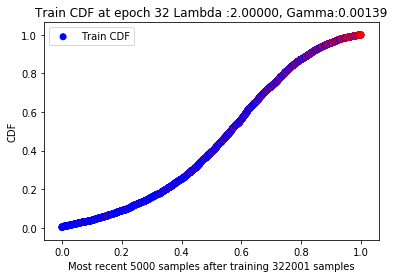

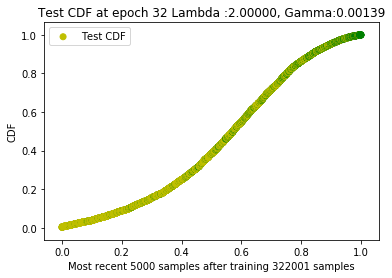

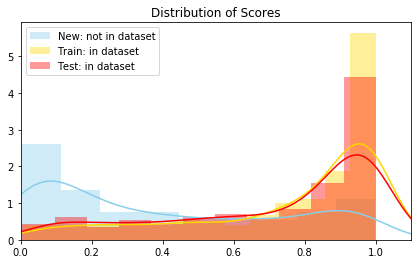

 20%|██        | 2004/10000 [15:39<5:12:51,  2.35s/it]

New score:  0.38933924
Train score:  0.7453758
Test score:  0.7287057


 40%|███▉      | 3997/10000 [30:00<03:15, 30.67it/s]   

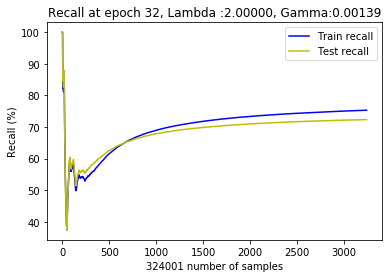

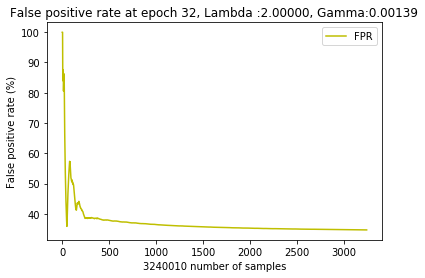

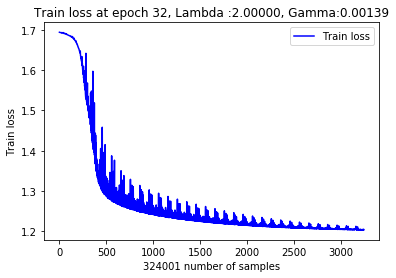

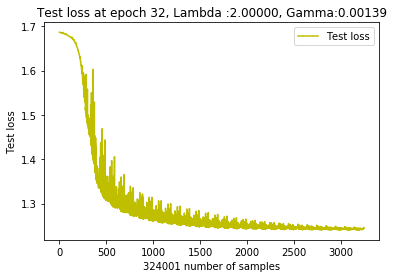

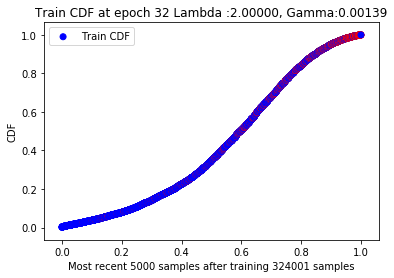

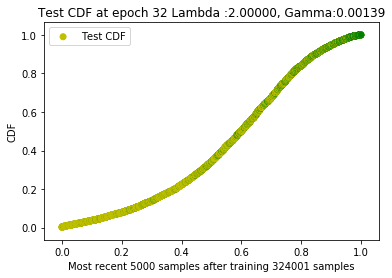

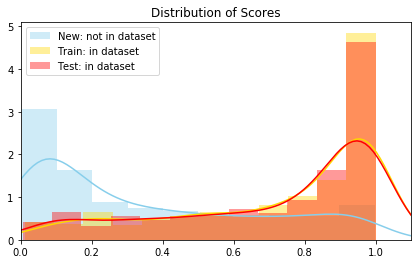

 40%|████      | 4005/10000 [30:31<3:52:45,  2.33s/it]

New score:  0.33697468
Train score:  0.73133105
Test score:  0.71868795


 60%|██████    | 6000/10000 [44:50<02:04, 32.07it/s]   

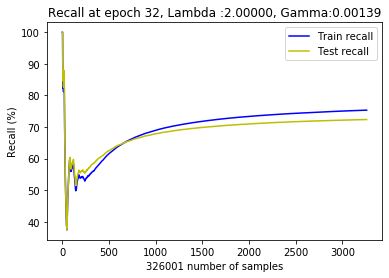

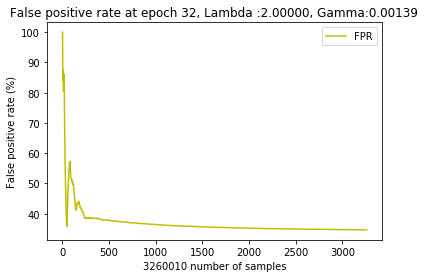

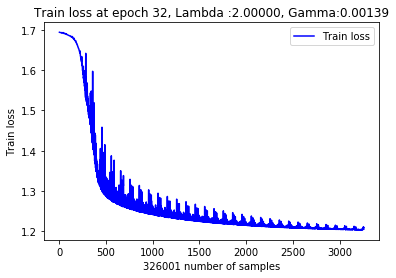

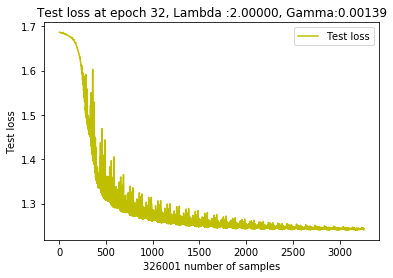

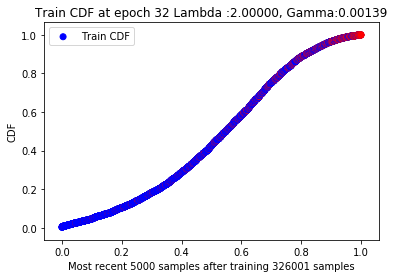

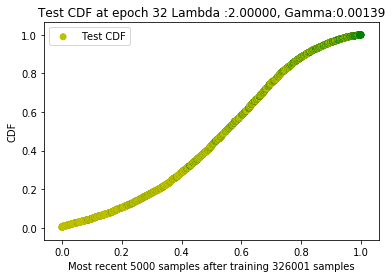

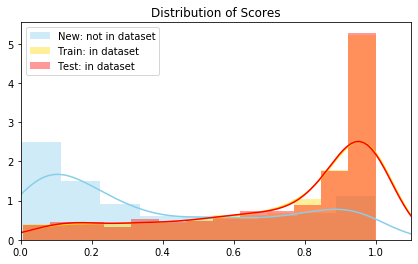

 60%|██████    | 6005/10000 [45:14<10:12:16,  9.20s/it]

New score:  0.39181522
Train score:  0.7387
Test score:  0.74995714


 80%|████████  | 8000/10000 [59:40<01:07, 29.53it/s]   

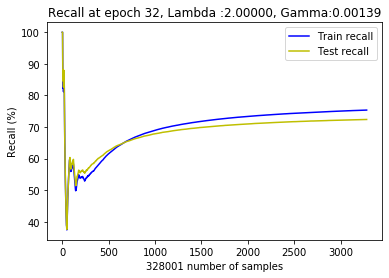

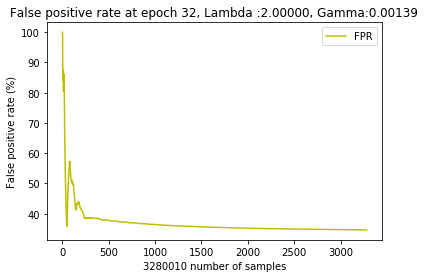

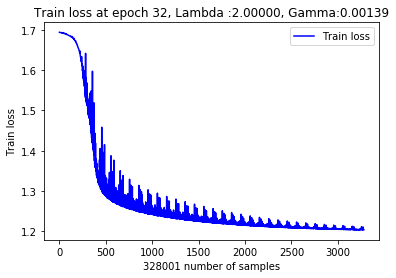

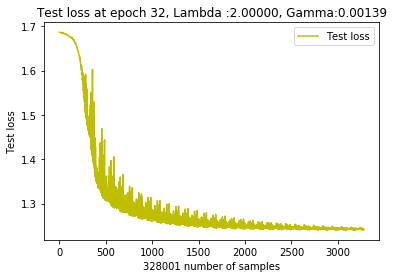

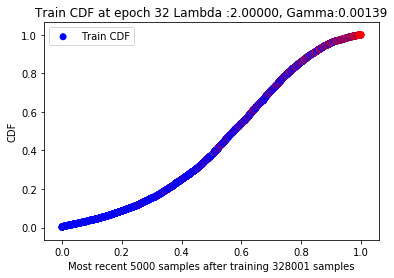

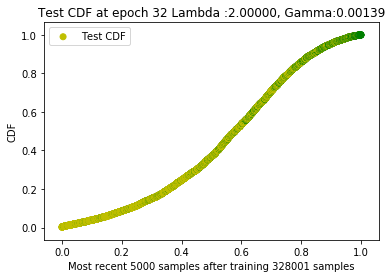

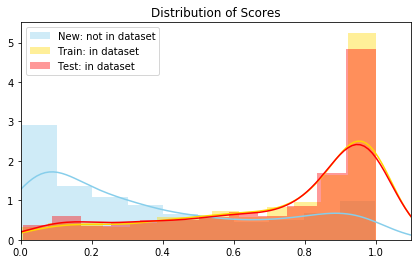

 80%|████████  | 8005/10000 [1:00:07<5:08:14,  9.27s/it]

New score:  0.38206145
Train score:  0.73633057
Test score:  0.72331256


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  33  with learning rate:  0.0012515777524966226


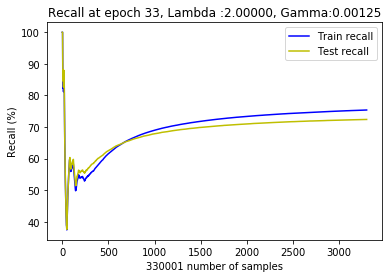

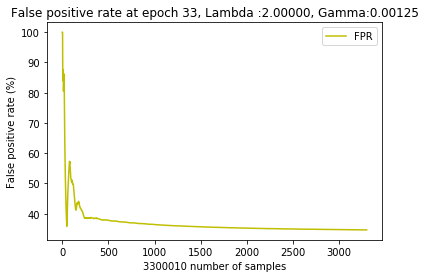

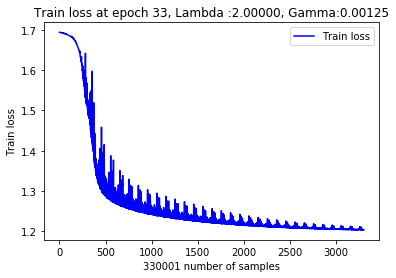

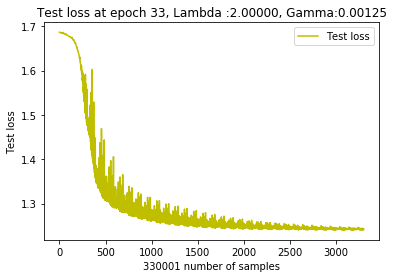

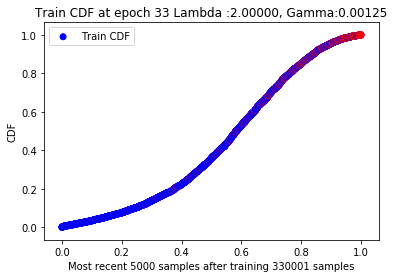

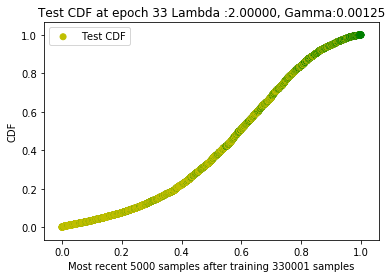

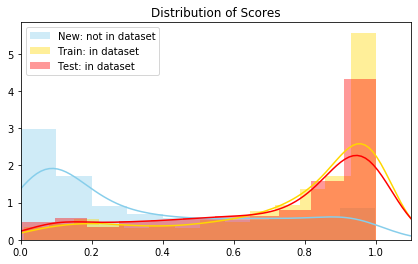

  0%|          | 5/10000 [00:44<85:42:02, 30.87s/it] 

New score:  0.34145734
Train score:  0.7491326
Test score:  0.7147579


 20%|█▉        | 1999/10000 [15:10<05:12, 25.57it/s]   

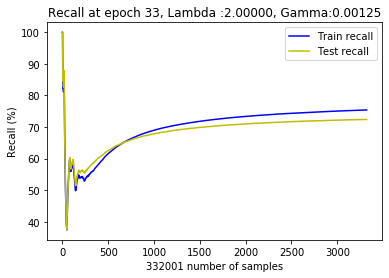

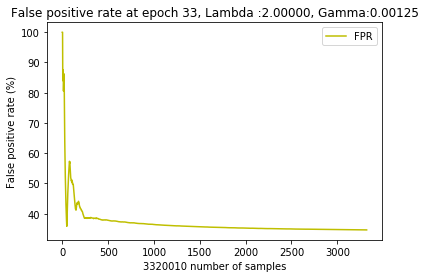

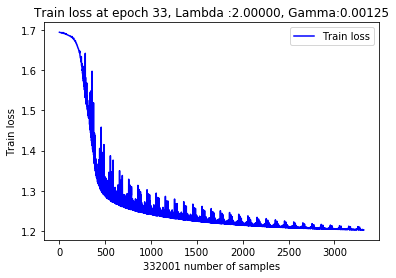

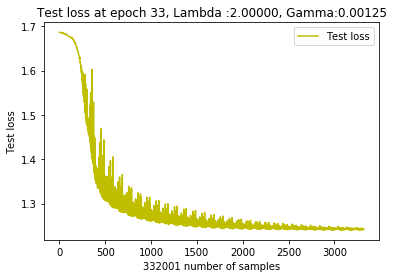

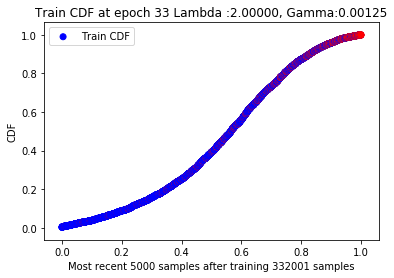

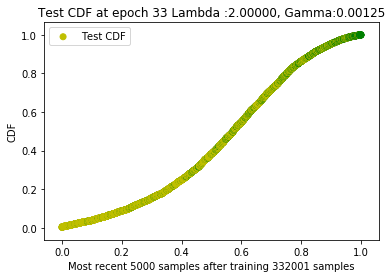

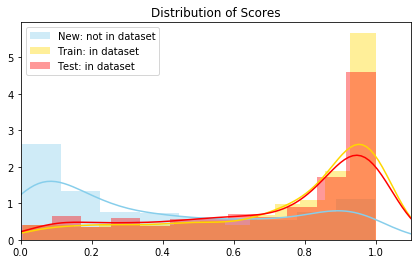

 20%|██        | 2005/10000 [15:41<10:18:14,  4.64s/it]

New score:  0.38921568
Train score:  0.74522984
Test score:  0.7283938


 40%|███▉      | 3997/10000 [30:10<03:19, 30.15it/s]   

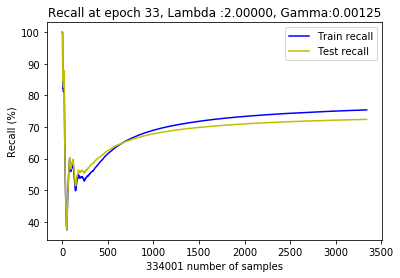

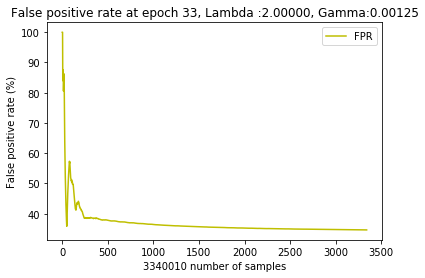

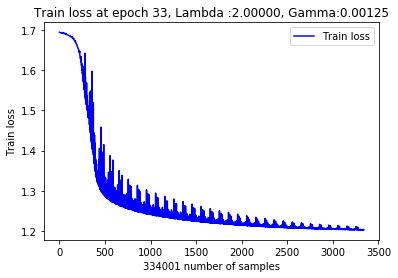

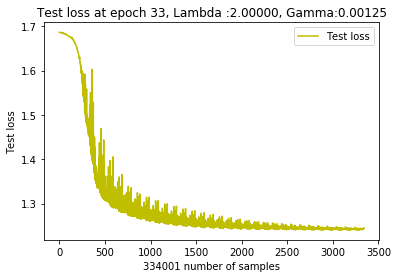

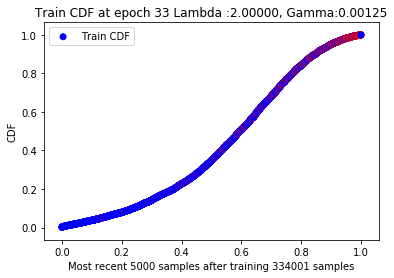

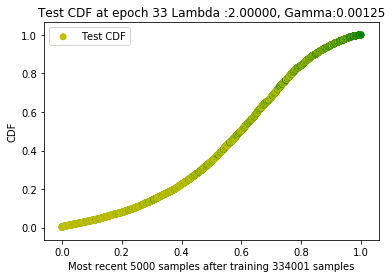

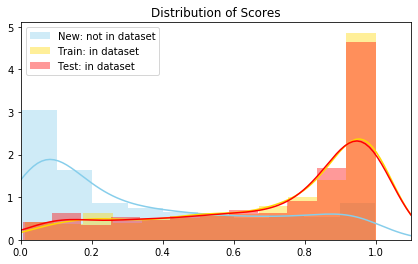

 40%|████      | 4005/10000 [30:37<3:51:53,  2.32s/it]

New score:  0.33814102
Train score:  0.73237073
Test score:  0.71969825


 60%|█████▉    | 5998/10000 [45:00<02:12, 30.29it/s]   

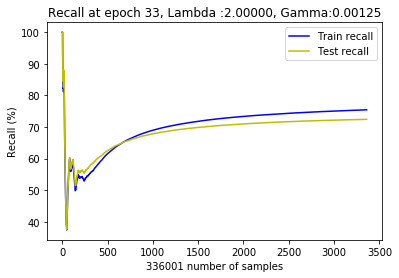

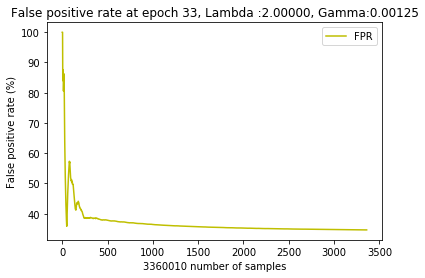

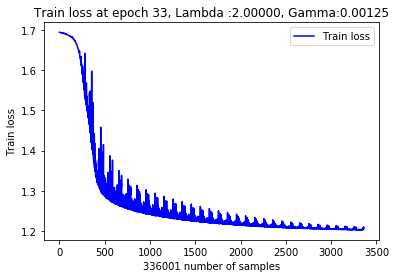

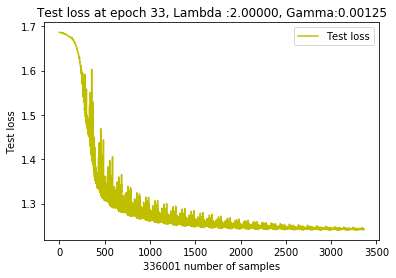

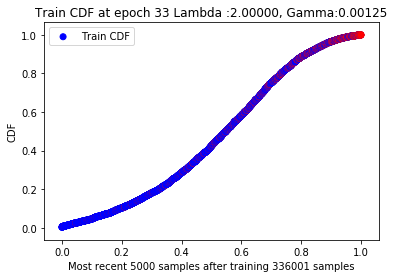

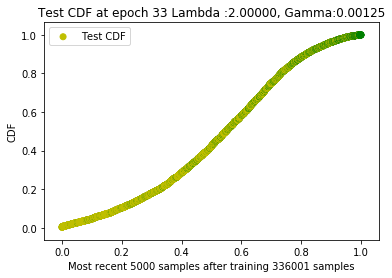

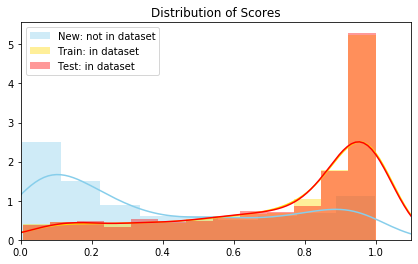

 60%|██████    | 6004/10000 [45:31<3:31:36,  3.18s/it]

New score:  0.39265412
Train score:  0.7383682
Test score:  0.7495618


 80%|███████▉  | 7999/10000 [59:50<01:08, 29.36it/s]  

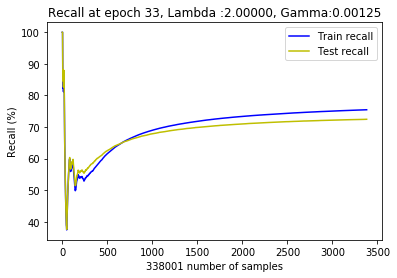

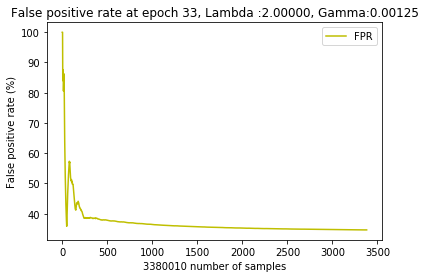

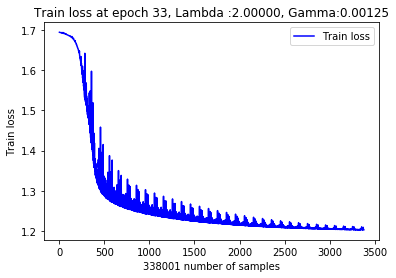

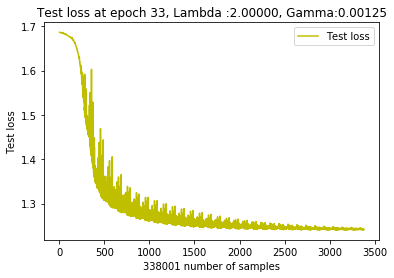

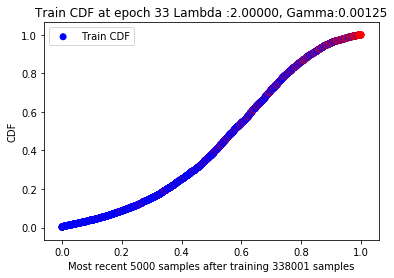

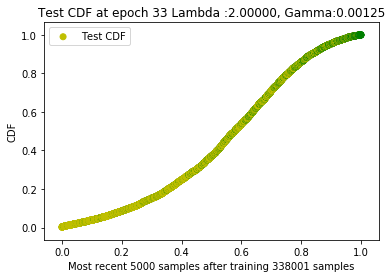

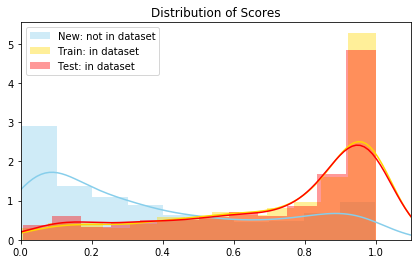

 80%|████████  | 8005/10000 [1:00:24<2:35:17,  4.67s/it]

New score:  0.38150257
Train score:  0.73768204
Test score:  0.7244747


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  34  with learning rate:  0.0011264199772469603


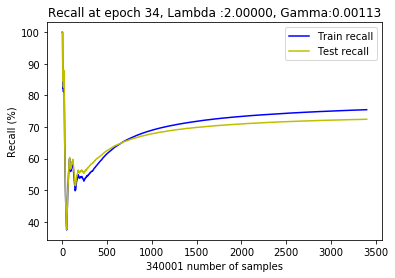

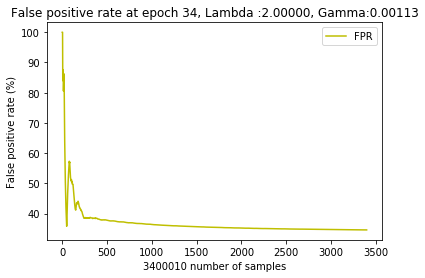

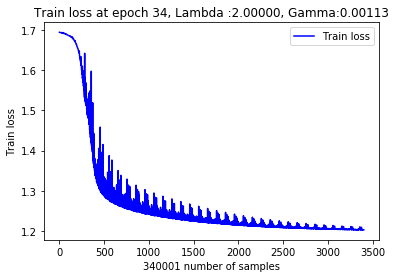

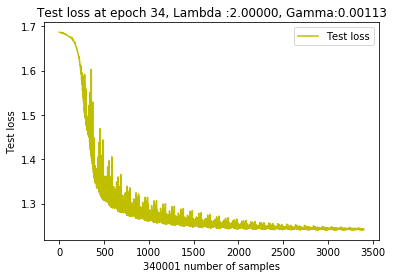

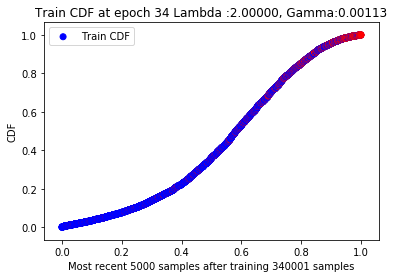

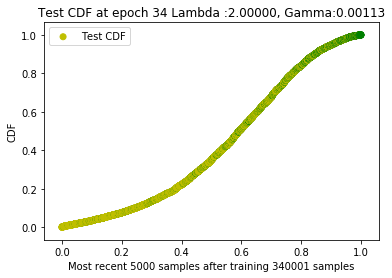

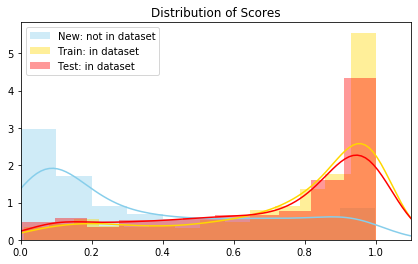

  0%|          | 5/10000 [00:42<82:31:54, 29.73s/it] 

New score:  0.34158885
Train score:  0.74993366
Test score:  0.7154806


 20%|█▉        | 1999/10000 [15:00<05:13, 25.56it/s]   

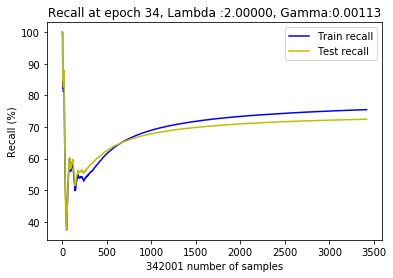

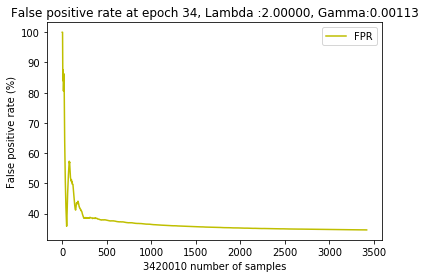

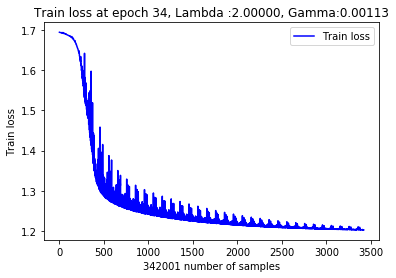

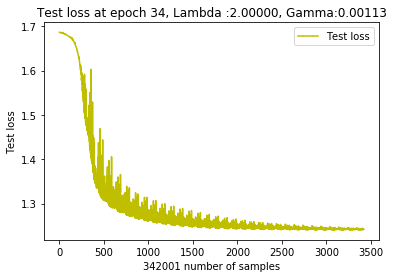

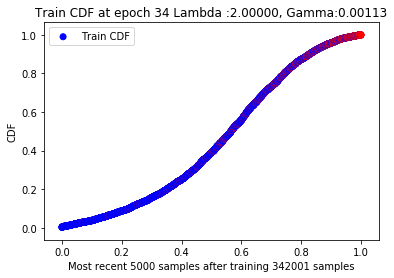

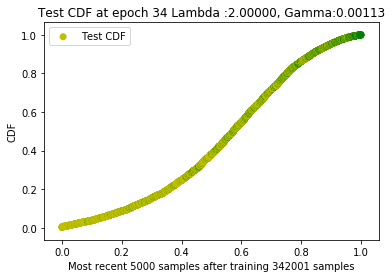

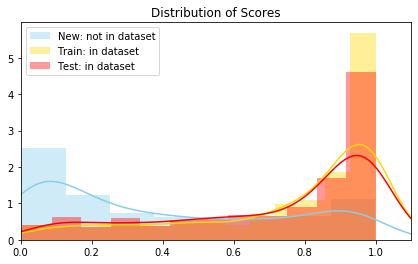

 20%|██        | 2005/10000 [15:31<10:11:49,  4.59s/it]

New score:  0.38898987
Train score:  0.7450177
Test score:  0.72803307


 40%|████      | 4000/10000 [29:40<03:21, 29.71it/s]   

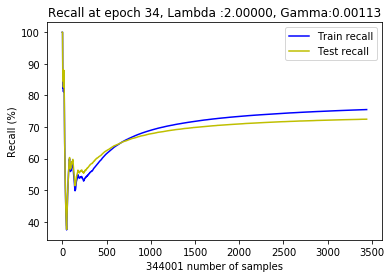

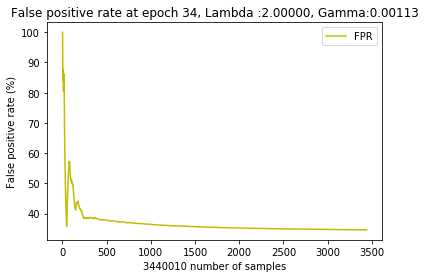

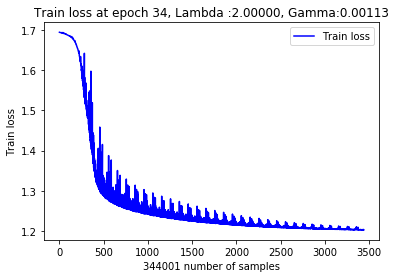

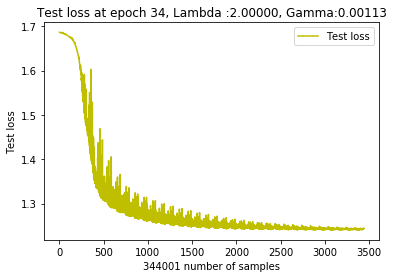

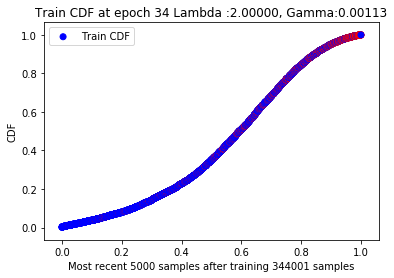

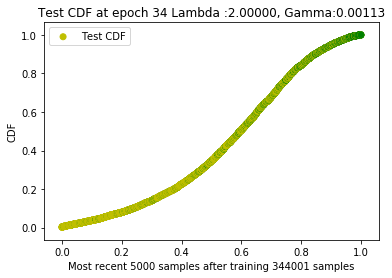

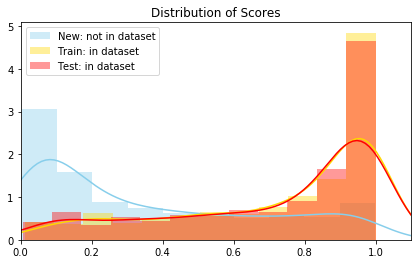

 40%|████      | 4005/10000 [30:10<15:12:35,  9.13s/it]

New score:  0.3393302
Train score:  0.7333424
Test score:  0.72064656


 60%|█████▉    | 5999/10000 [44:30<02:13, 29.95it/s]   

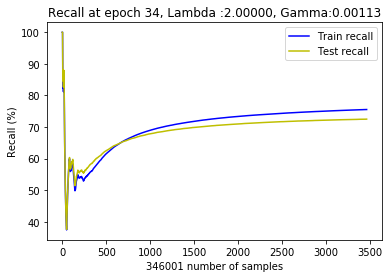

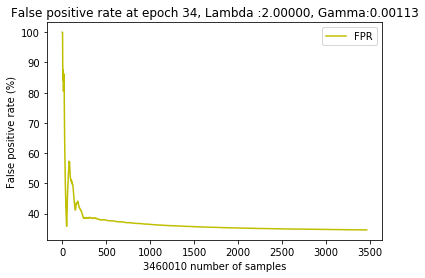

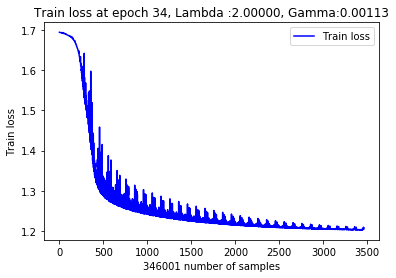

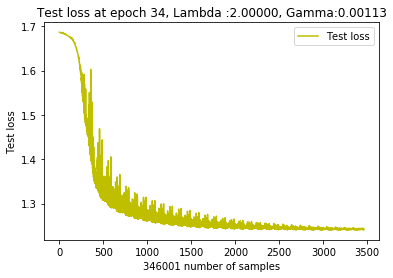

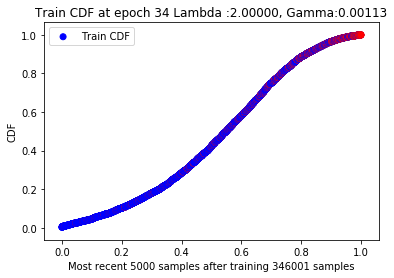

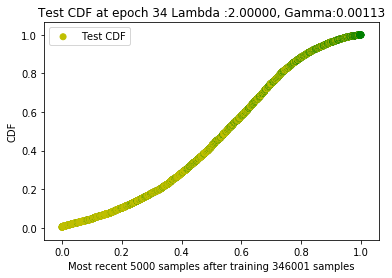

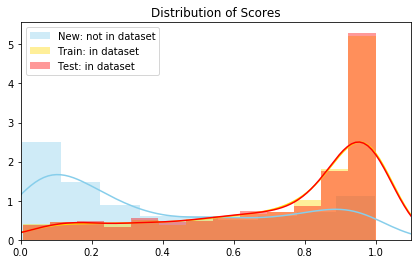

 60%|██████    | 6004/10000 [44:56<5:07:12,  4.61s/it]

New score:  0.393214
Train score:  0.73793834
Test score:  0.7490738


 80%|███████▉  | 7997/10000 [59:10<01:02, 32.26it/s]   

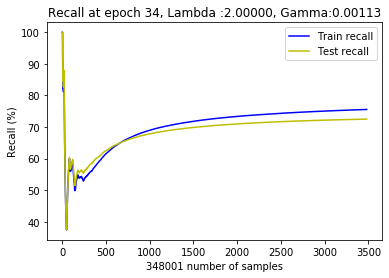

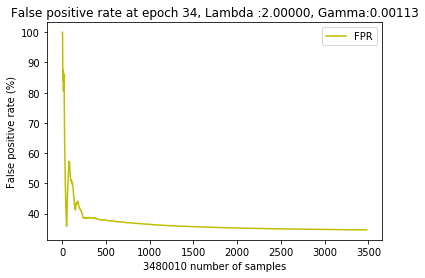

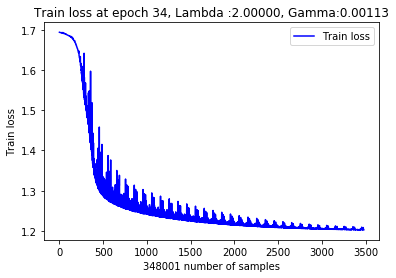

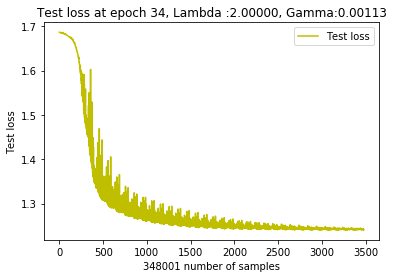

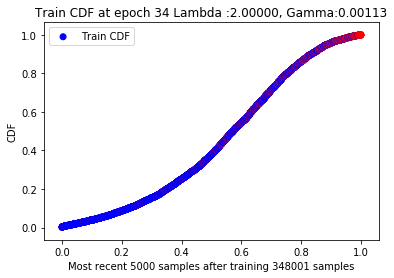

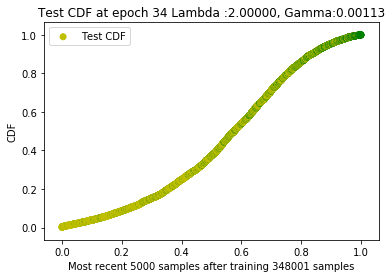

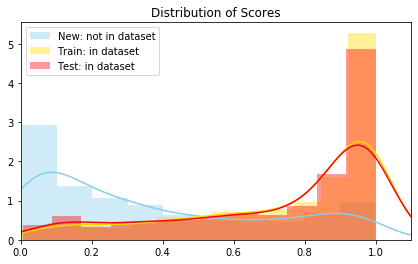

 80%|████████  | 8005/10000 [59:39<1:17:13,  2.32s/it]

New score:  0.38120008
Train score:  0.7390133
Test score:  0.7256194


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  35  with learning rate:  0.0010137779795222643


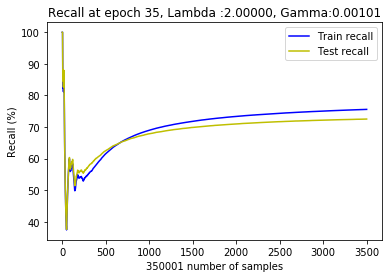

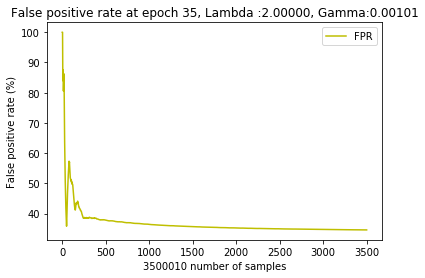

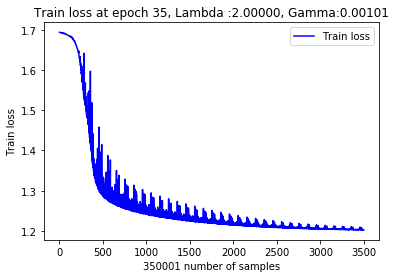

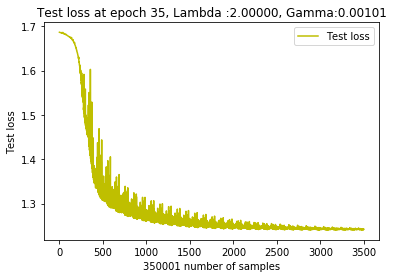

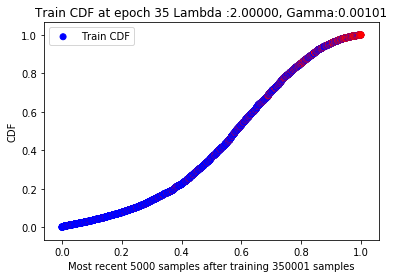

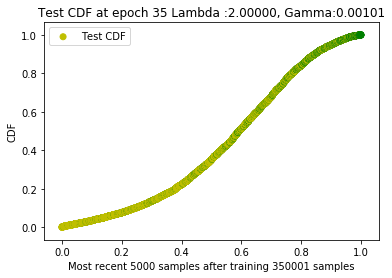

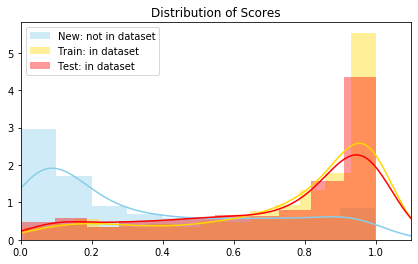

  0%|          | 5/10000 [00:44<86:37:48, 31.20s/it] 

New score:  0.34176496
Train score:  0.750688
Test score:  0.71616113


 20%|█▉        | 1997/10000 [15:00<05:05, 26.20it/s]   

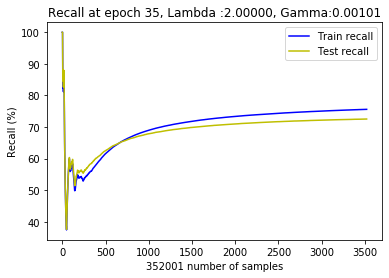

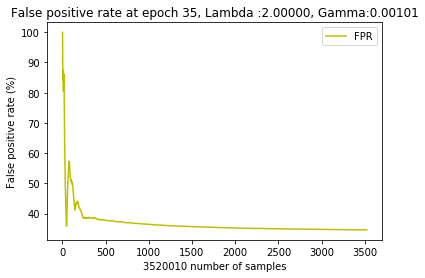

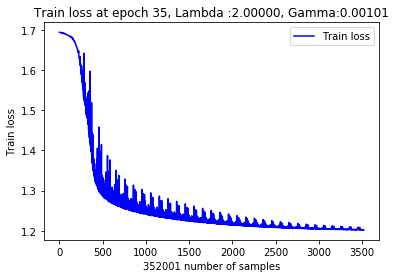

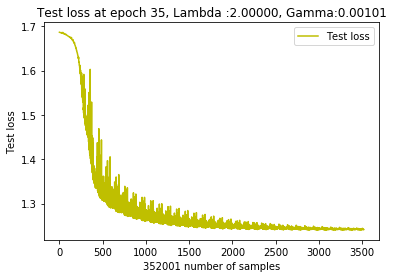

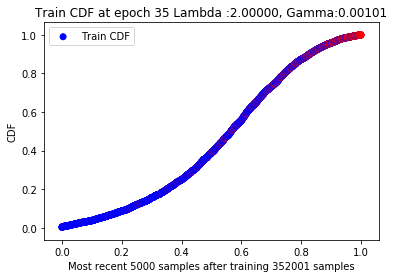

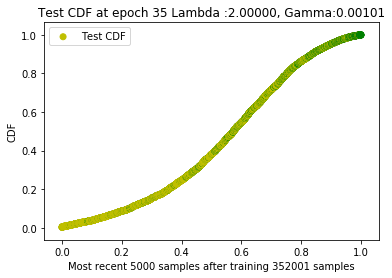

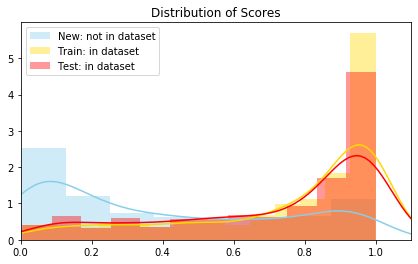

 20%|██        | 2005/10000 [15:27<5:06:59,  2.30s/it]

New score:  0.38870686
Train score:  0.74481505
Test score:  0.7276937


 40%|███▉      | 3997/10000 [29:50<03:21, 29.76it/s]   

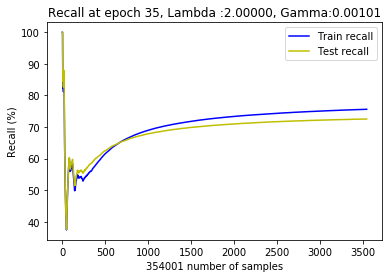

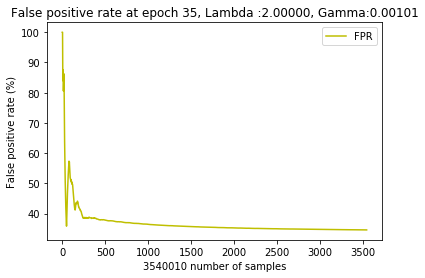

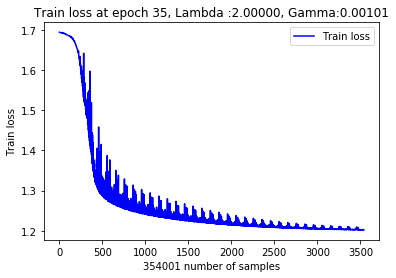

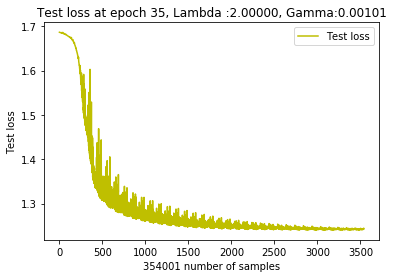

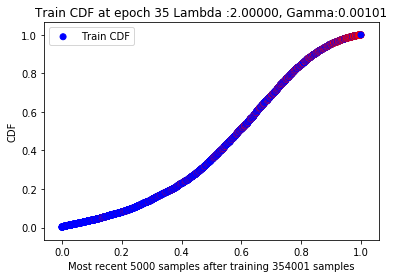

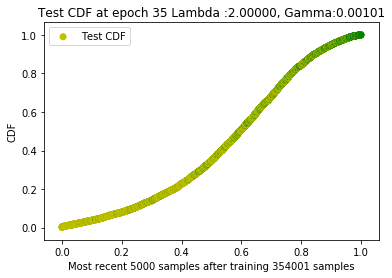

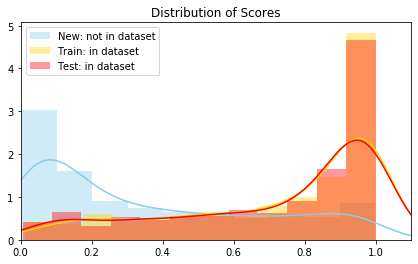

 40%|████      | 4005/10000 [30:14<3:49:48,  2.30s/it]

New score:  0.3405106
Train score:  0.7342244
Test score:  0.7215085


 60%|█████▉    | 5998/10000 [44:30<02:08, 31.22it/s]   

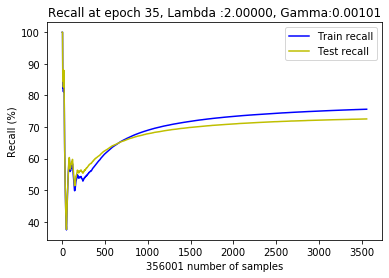

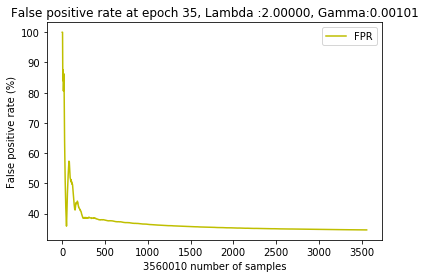

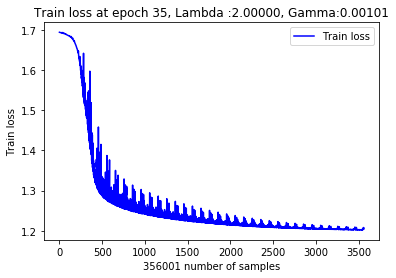

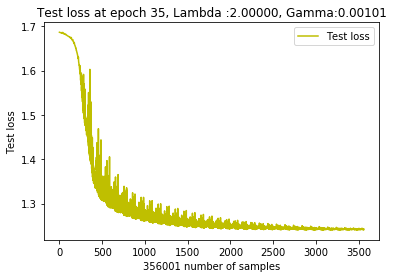

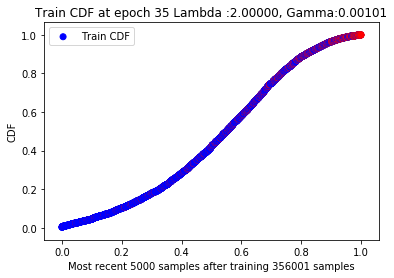

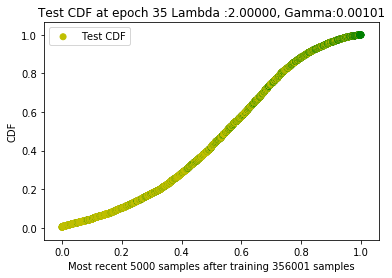

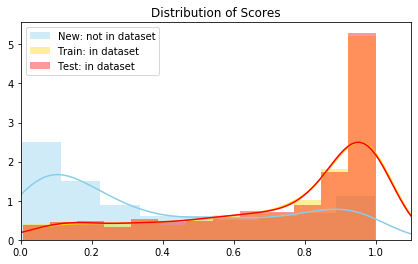

 60%|██████    | 6005/10000 [45:00<3:24:14,  3.07s/it]

New score:  0.39362642
Train score:  0.7374567
Test score:  0.7485314


 80%|███████▉  | 7997/10000 [59:20<01:01, 32.71it/s]   

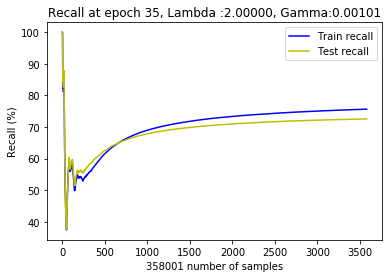

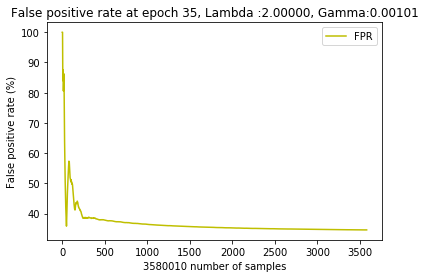

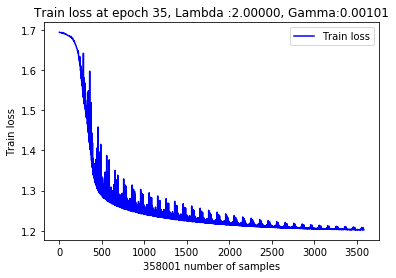

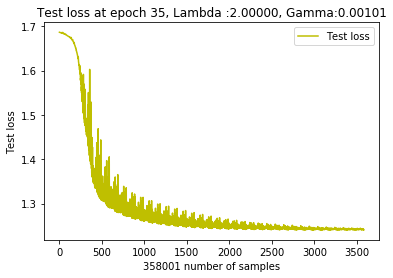

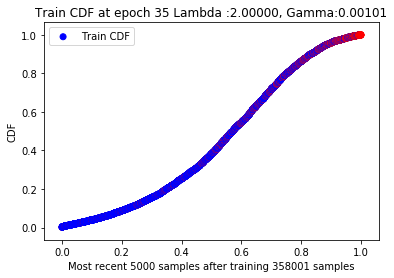

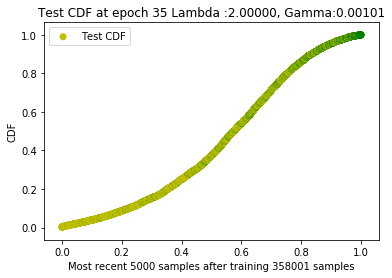

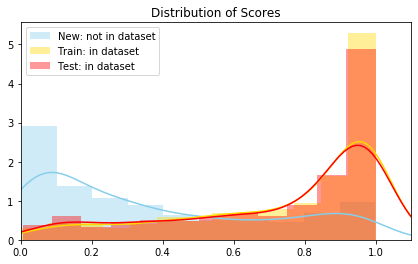

 80%|████████  | 8005/10000 [59:47<1:17:25,  2.33s/it]

New score:  0.38112786
Train score:  0.74030674
Test score:  0.7267356


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  36  with learning rate:  0.0009124001815700379


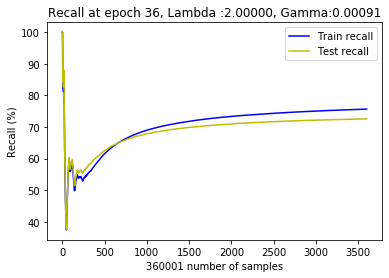

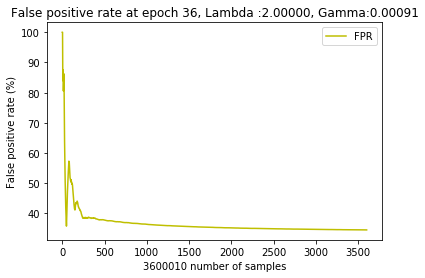

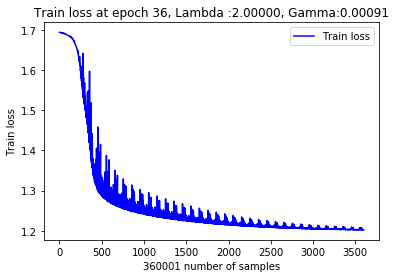

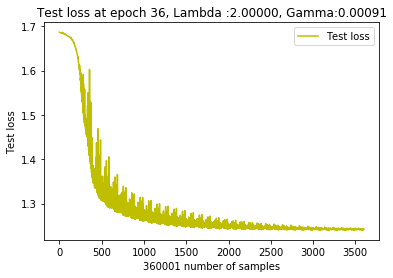

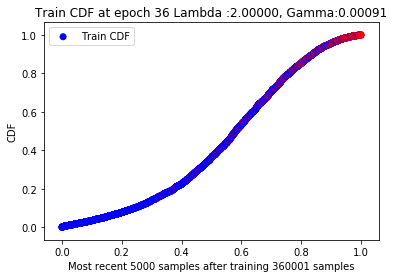

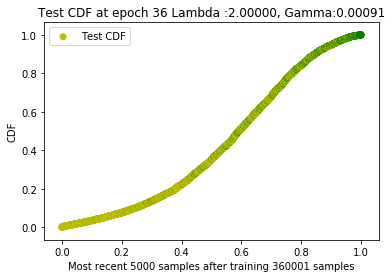

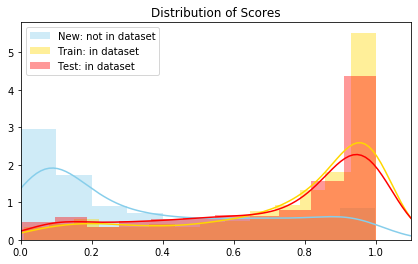

  0%|          | 5/10000 [00:44<85:20:48, 30.74s/it] 

New score:  0.3419752
Train score:  0.7513463
Test score:  0.7167538


 20%|█▉        | 1997/10000 [15:10<04:58, 26.82it/s]   

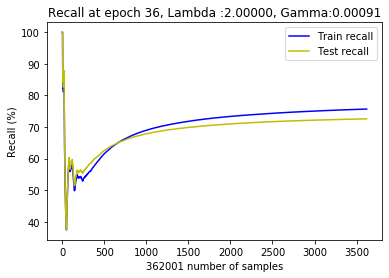

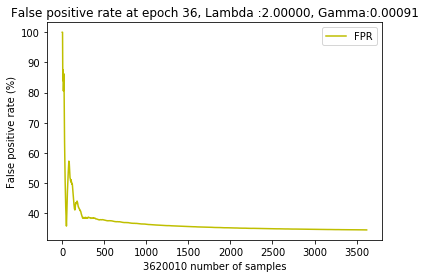

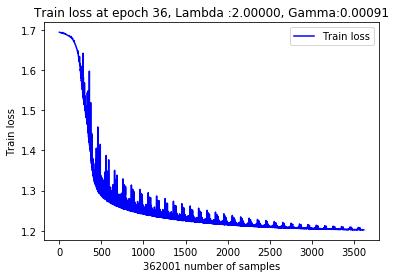

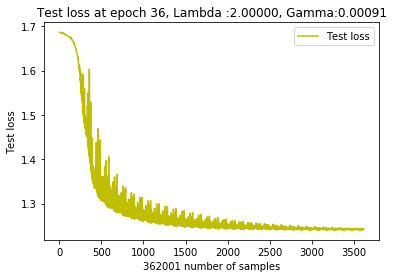

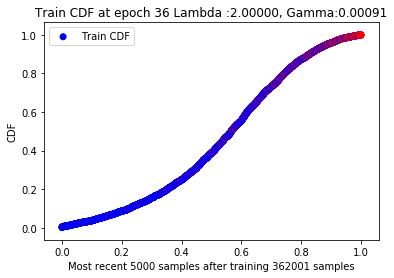

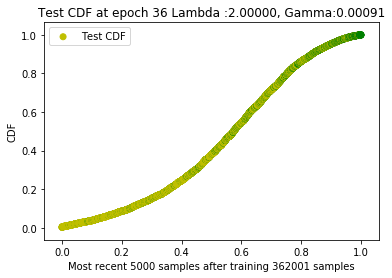

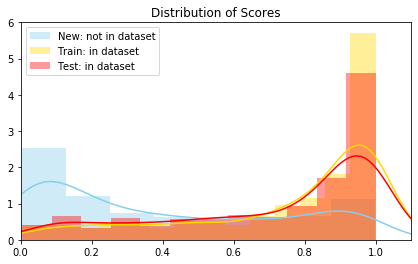

 20%|██        | 2005/10000 [15:36<5:11:18,  2.34s/it]

New score:  0.38838693
Train score:  0.74454236
Test score:  0.72729516


 40%|███▉      | 3999/10000 [30:00<03:21, 29.77it/s]   

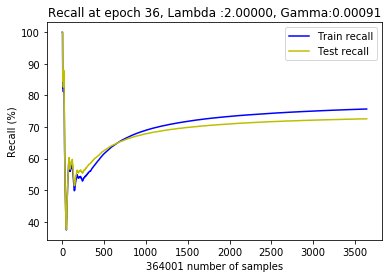

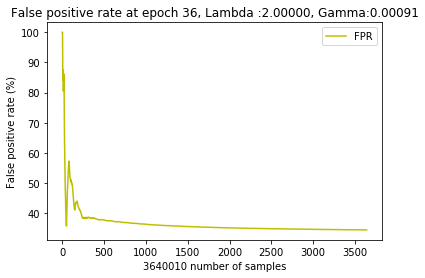

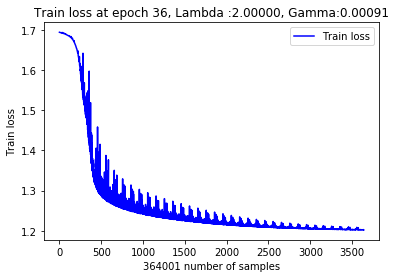

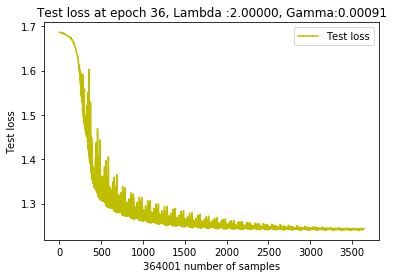

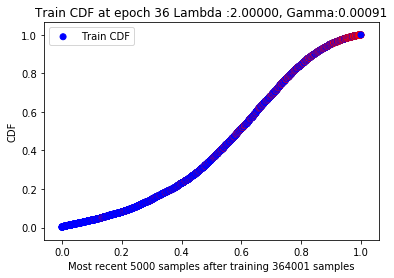

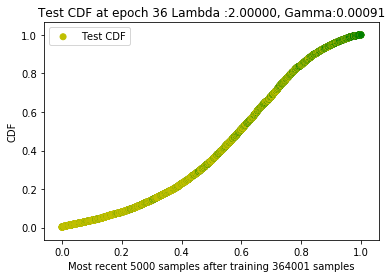

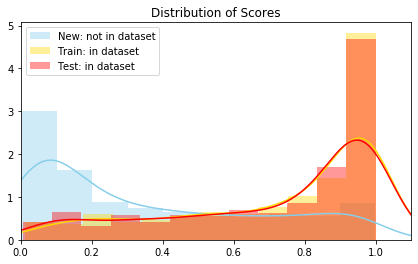

 40%|████      | 4005/10000 [30:26<7:40:57,  4.61s/it] 

New score:  0.34162402
Train score:  0.7349844
Test score:  0.72224873


 60%|█████▉    | 5997/10000 [45:00<02:10, 30.59it/s]   

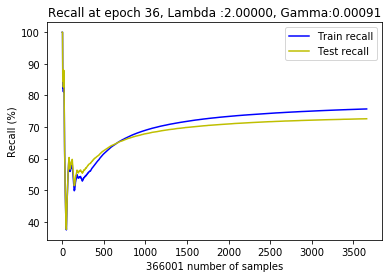

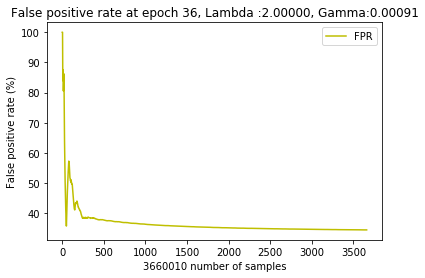

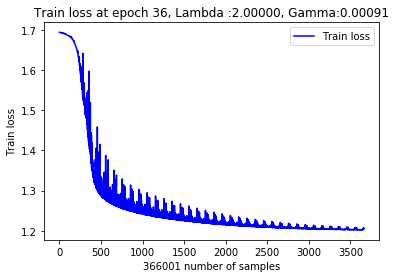

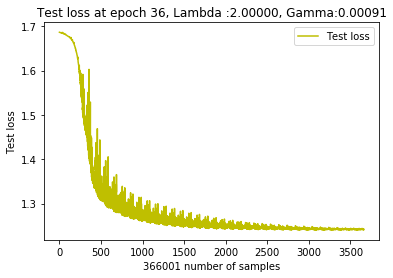

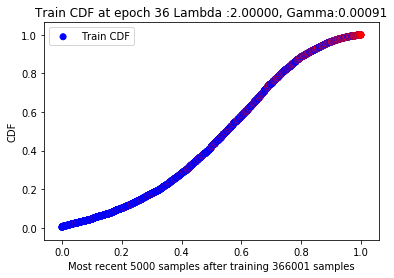

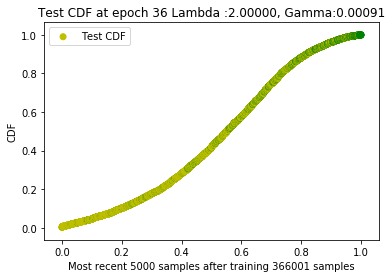

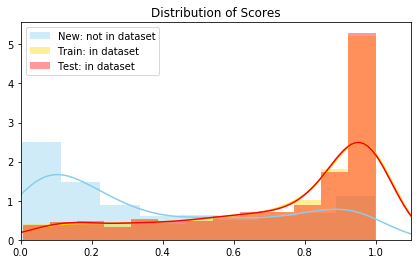

 60%|██████    | 6005/10000 [45:30<2:35:37,  2.34s/it]

New score:  0.39384735
Train score:  0.7369047
Test score:  0.7479219


 80%|███████▉  | 7997/10000 [1:00:00<01:08, 29.16it/s] 

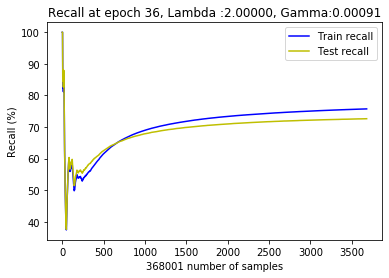

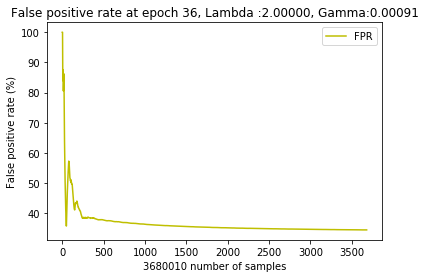

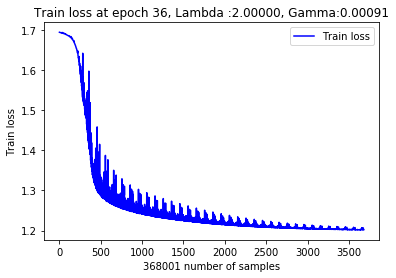

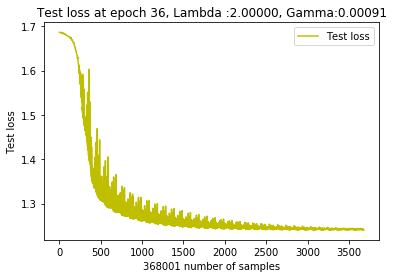

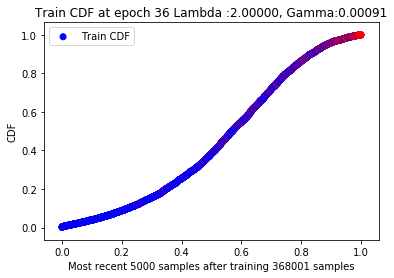

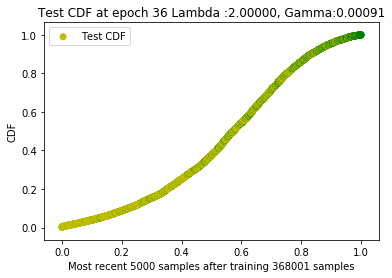

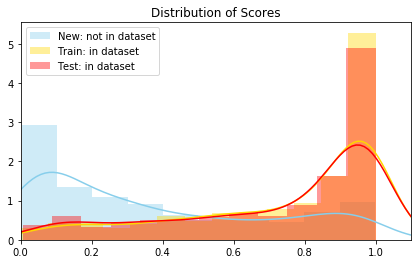

 80%|████████  | 8004/10000 [1:00:38<1:29:23,  2.69s/it]

New score:  0.38123292
Train score:  0.74159056
Test score:  0.72785795


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  37  with learning rate:  0.0008211601634130341


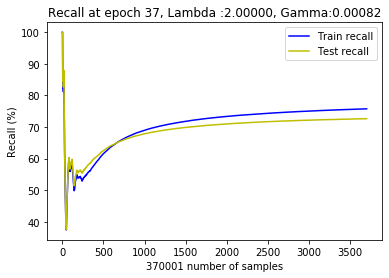

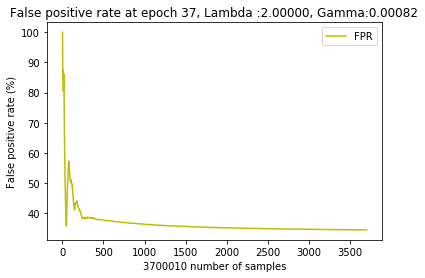

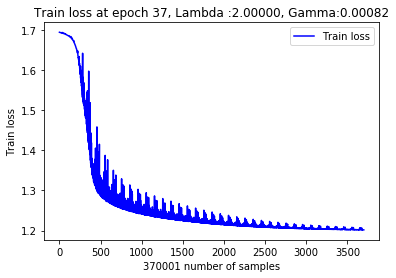

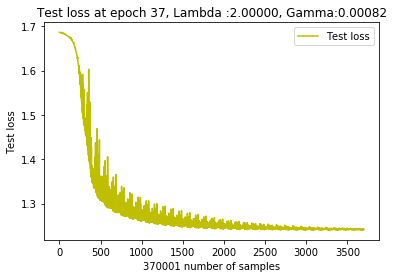

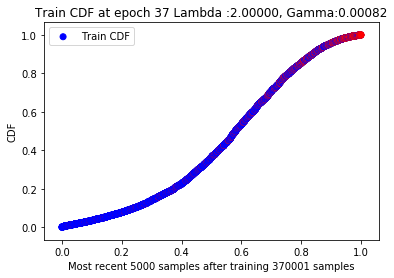

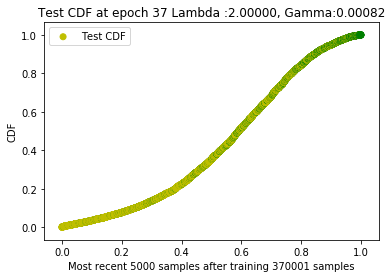

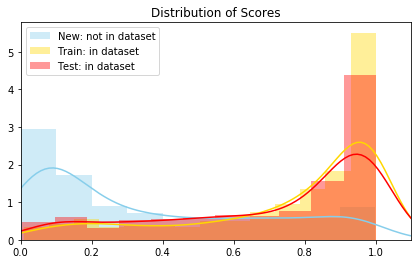

  0%|          | 4/10000 [00:44<85:38:31, 30.84s/it] 

New score:  0.3423275
Train score:  0.75205284
Test score:  0.71740234


 20%|█▉        | 1999/10000 [15:00<05:02, 26.43it/s]   

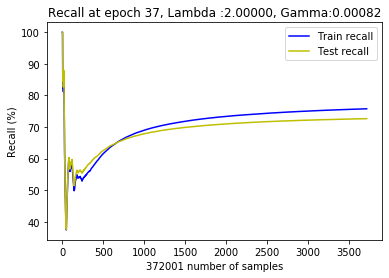

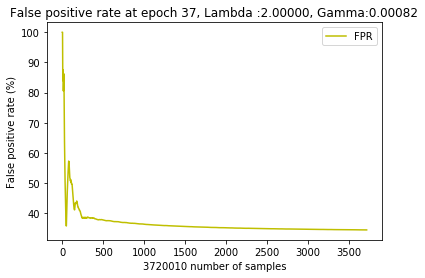

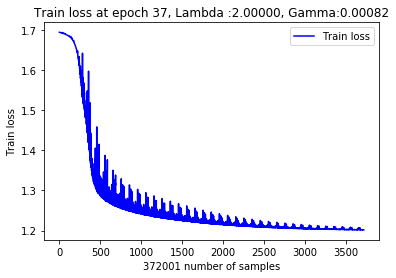

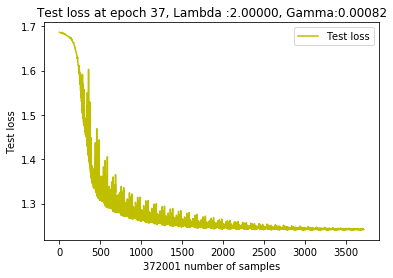

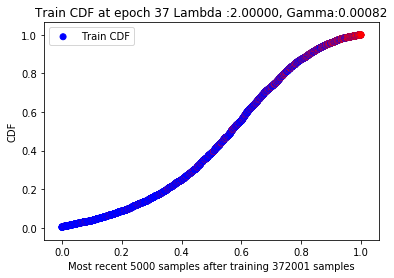

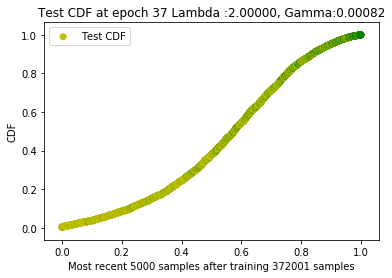

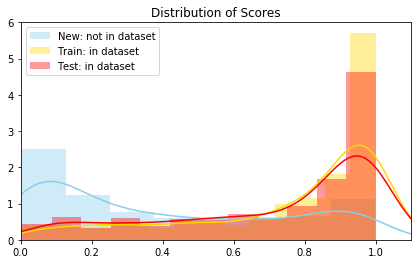

 20%|██        | 2005/10000 [15:33<10:13:04,  4.60s/it]

New score:  0.38804483
Train score:  0.7443227
Test score:  0.72695667


 40%|███▉      | 3997/10000 [28:00<03:08, 31.81it/s]   

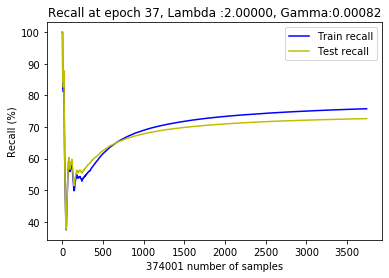

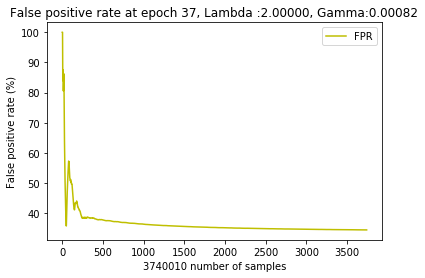

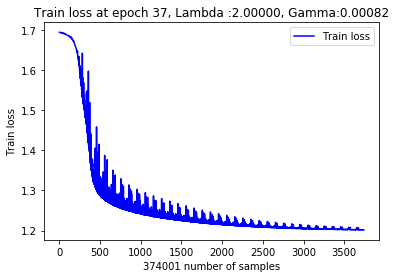

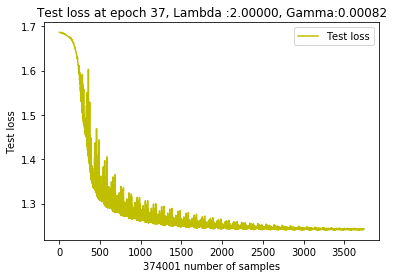

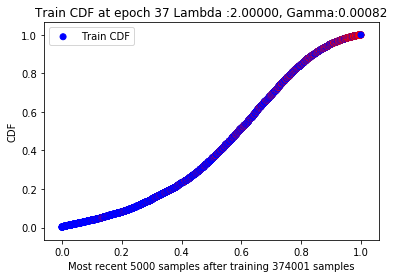

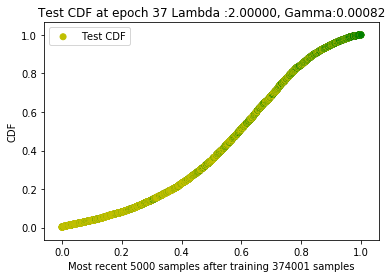

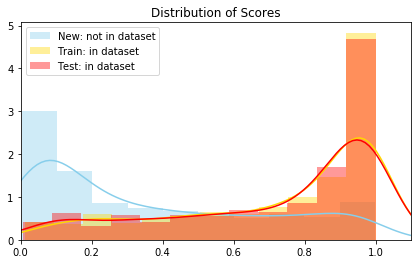

 40%|████      | 4005/10000 [28:29<3:49:00,  2.29s/it]

New score:  0.3426662
Train score:  0.7356735
Test score:  0.72291875


 60%|█████▉    | 5997/10000 [42:40<01:58, 33.76it/s]  

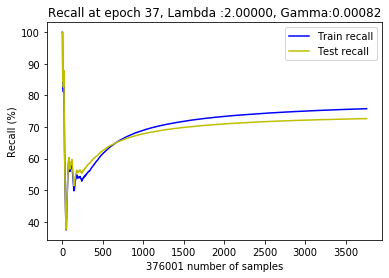

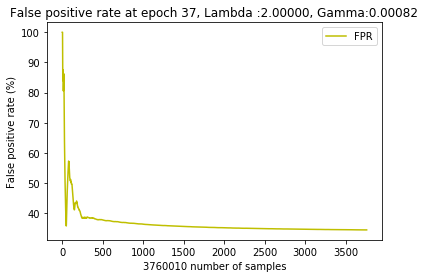

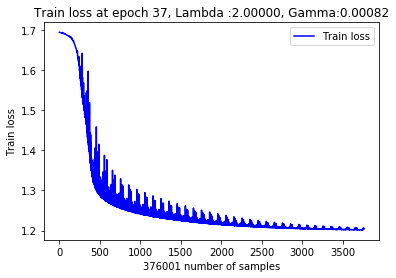

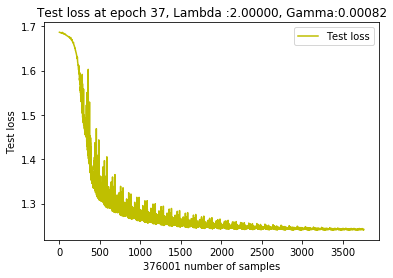

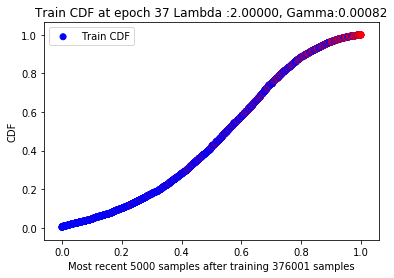

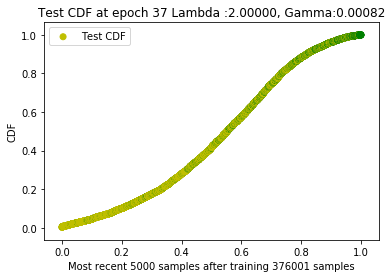

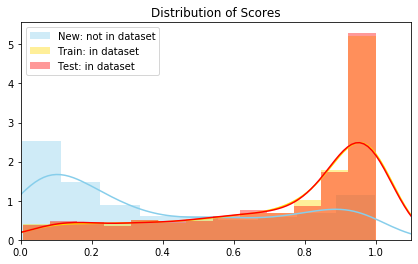

 60%|██████    | 6005/10000 [43:08<2:32:20,  2.29s/it]

New score:  0.393834
Train score:  0.7362673
Test score:  0.7472337


 80%|███████▉  | 7997/10000 [58:00<01:06, 30.13it/s]  

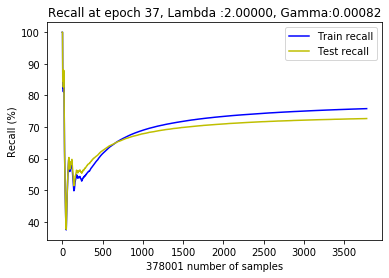

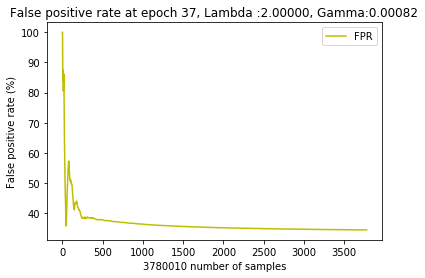

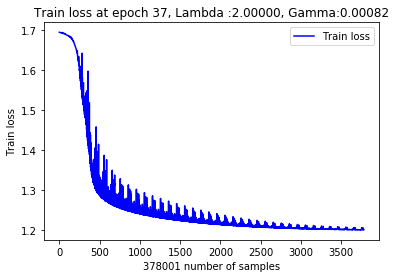

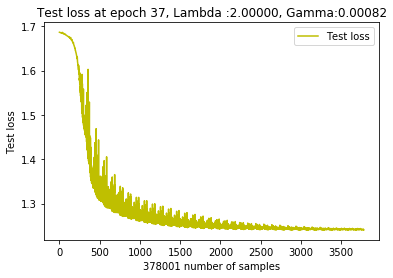

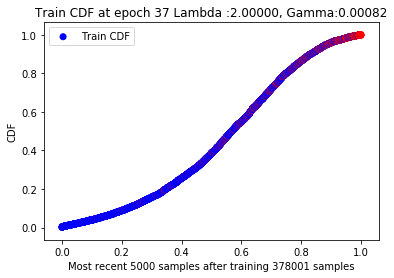

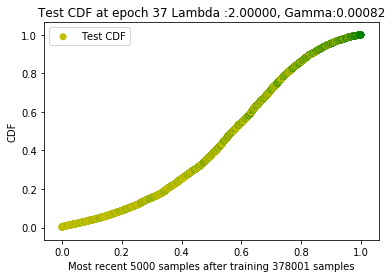

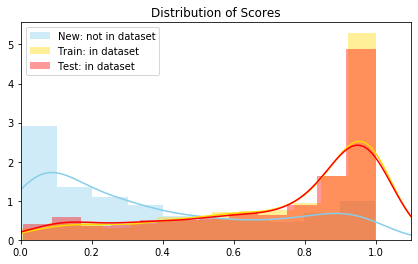

 80%|████████  | 8005/10000 [58:36<1:29:51,  2.70s/it]

New score:  0.3813717
Train score:  0.7427175
Test score:  0.72883594


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  38  with learning rate:  0.0007390441470717307


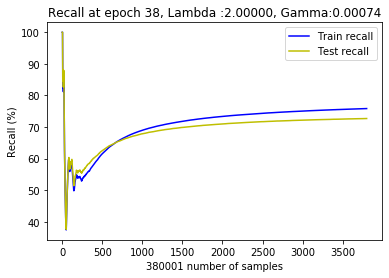

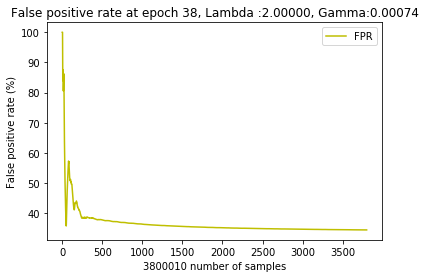

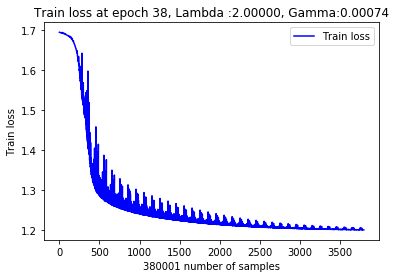

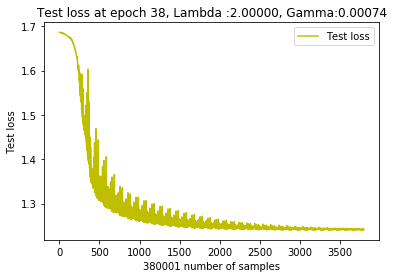

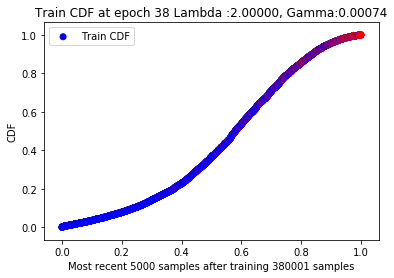

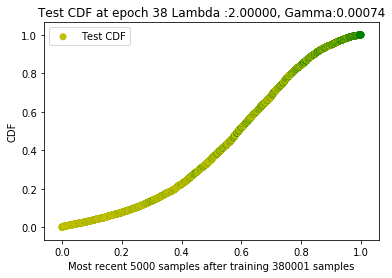

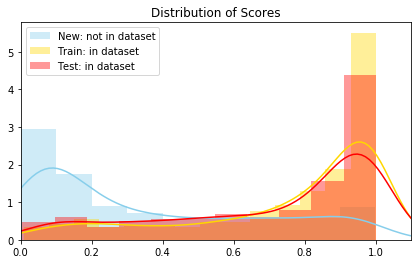

  0%|          | 5/10000 [00:43<85:14:35, 30.70s/it] 

New score:  0.3426136
Train score:  0.7526842
Test score:  0.7179826


 20%|█▉        | 1997/10000 [15:10<04:54, 27.20it/s]  

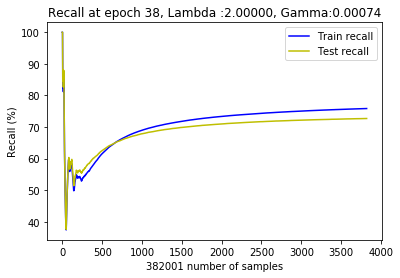

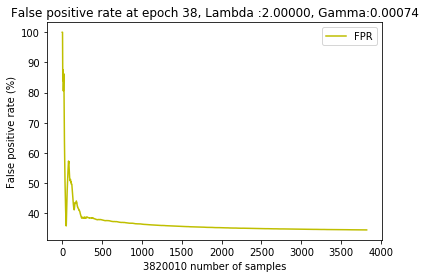

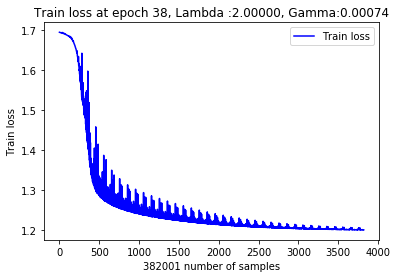

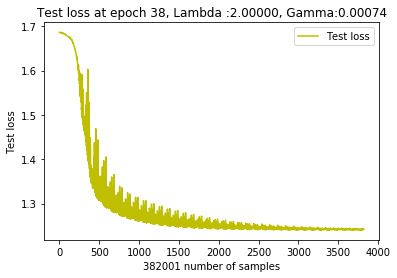

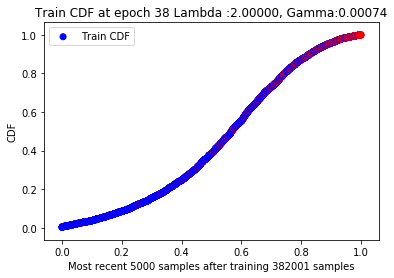

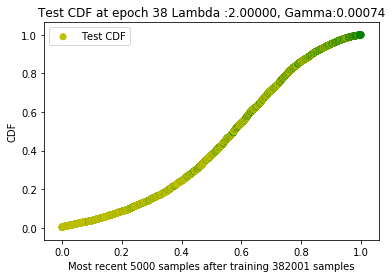

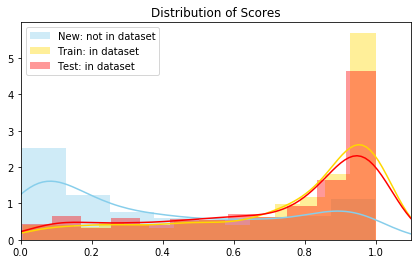

 20%|██        | 2005/10000 [15:36<5:11:17,  2.34s/it]

New score:  0.3876557
Train score:  0.7440621
Test score:  0.72658944


 40%|███▉      | 3997/10000 [30:00<03:07, 32.03it/s]  

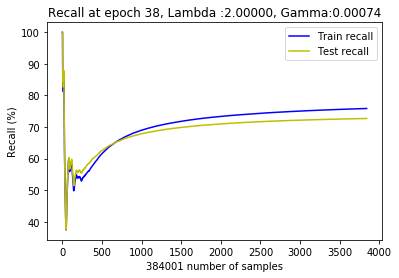

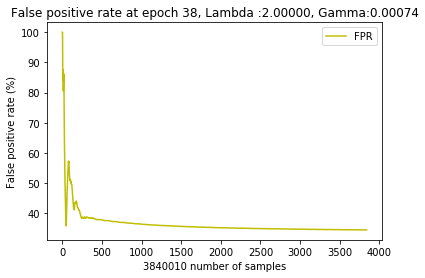

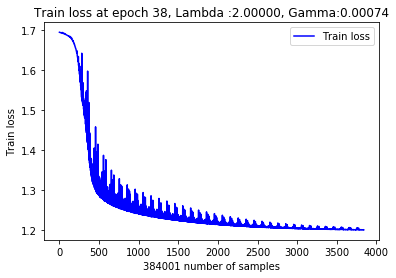

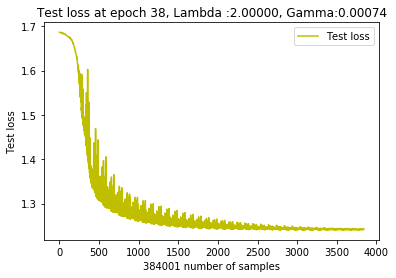

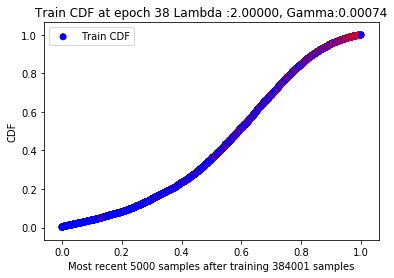

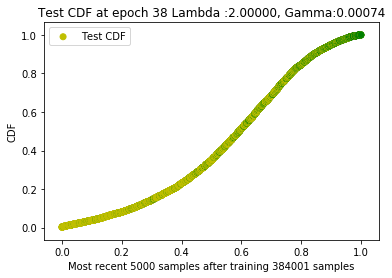

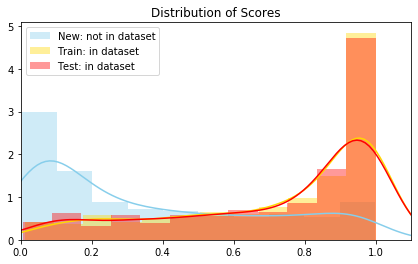

 40%|████      | 4005/10000 [30:26<3:54:09,  2.34s/it]

New score:  0.3436421
Train score:  0.736242
Test score:  0.7234751


 60%|█████▉    | 5997/10000 [44:50<02:02, 32.70it/s]  

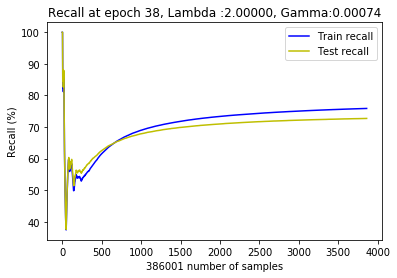

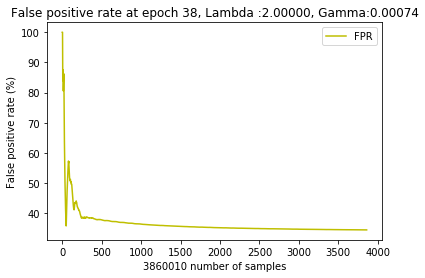

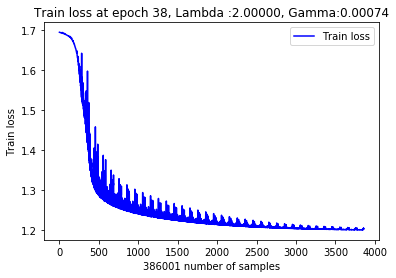

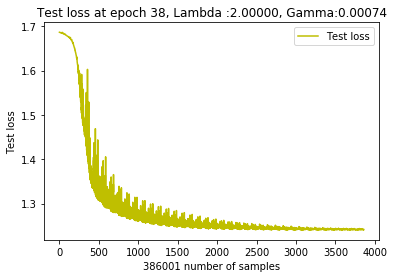

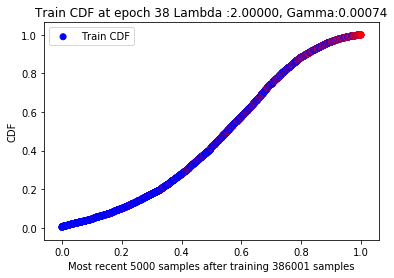

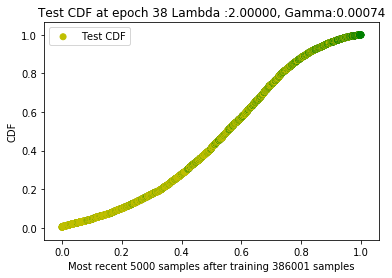

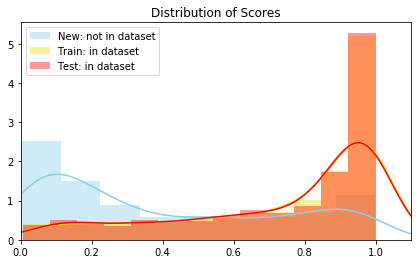

 60%|██████    | 6005/10000 [45:18<2:34:26,  2.32s/it]

New score:  0.39365238
Train score:  0.73555106
Test score:  0.7464674


 80%|███████▉  | 7997/10000 [59:40<00:59, 33.45it/s]   

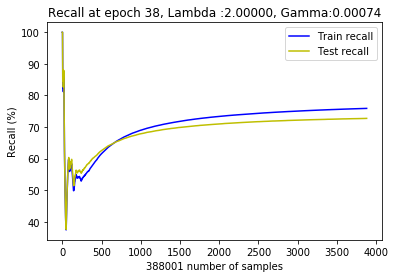

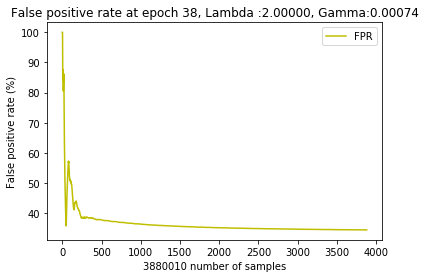

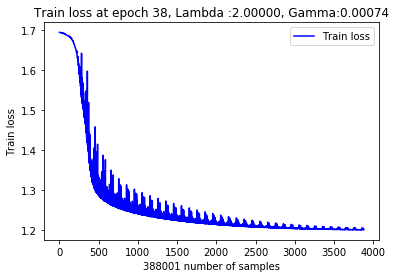

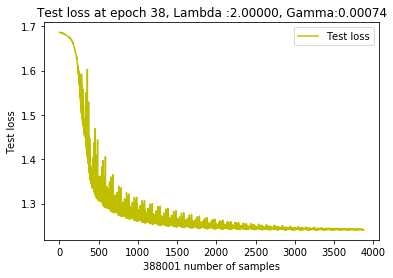

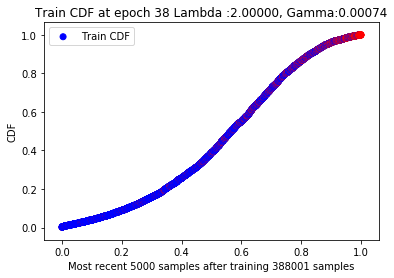

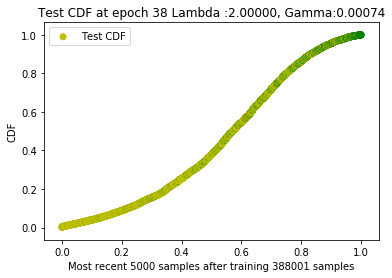

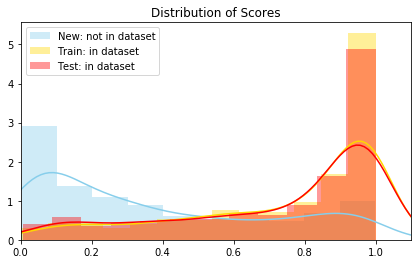

 80%|████████  | 8005/10000 [1:00:10<1:19:05,  2.38s/it]

New score:  0.38161045
Train score:  0.7437898
Test score:  0.7297729


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  39  with learning rate:  0.0006651397323645576


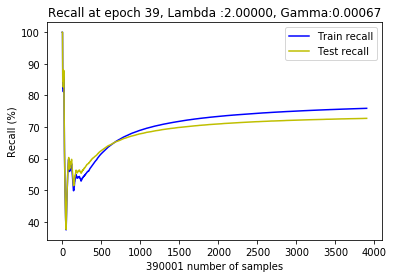

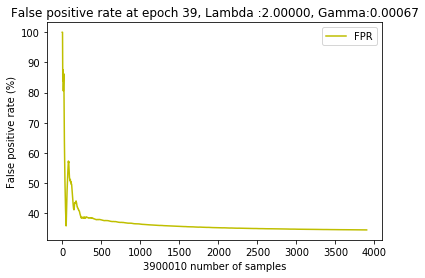

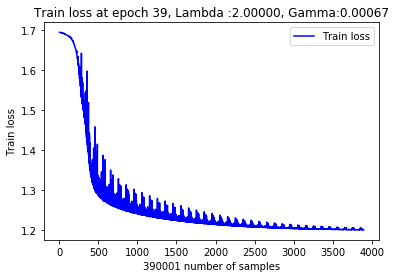

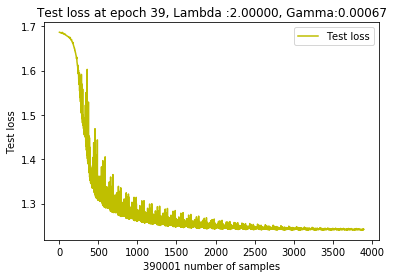

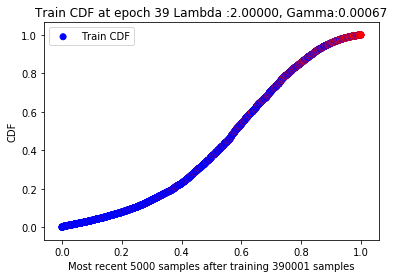

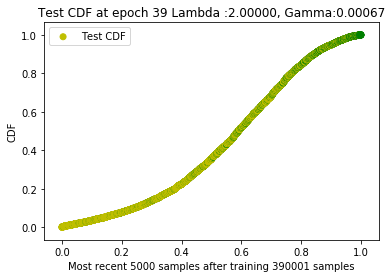

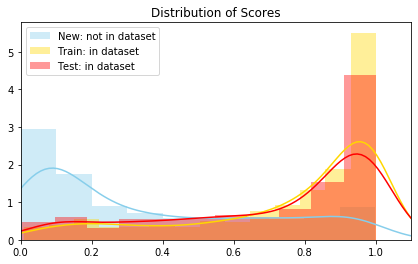

  0%|          | 5/10000 [00:44<85:47:33, 30.90s/it] 

New score:  0.34299415
Train score:  0.75330496
Test score:  0.7185644


 20%|█▉        | 1997/10000 [15:00<04:51, 27.46it/s]  

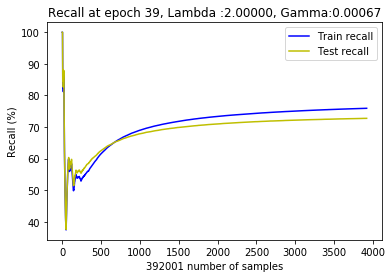

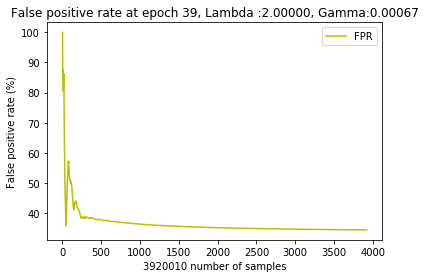

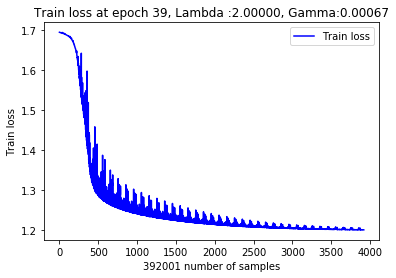

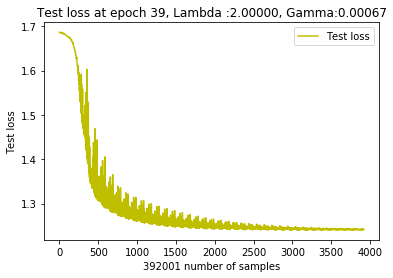

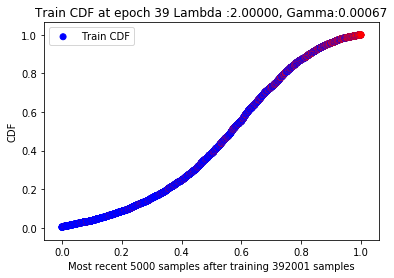

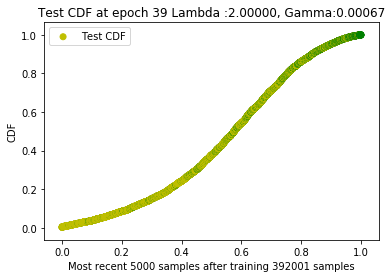

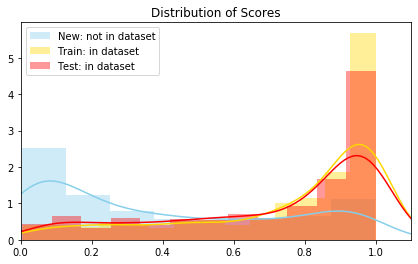

 20%|██        | 2005/10000 [15:33<5:13:06,  2.35s/it]

New score:  0.38726684
Train score:  0.7438205
Test score:  0.7262533


 40%|███▉      | 3998/10000 [35:00<04:50, 20.65it/s]   

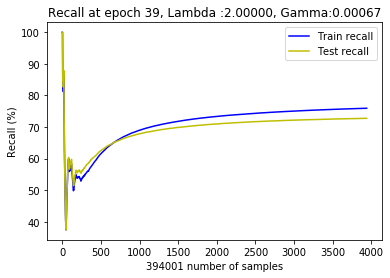

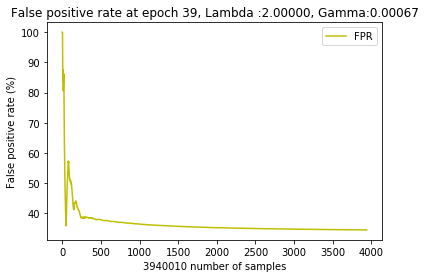

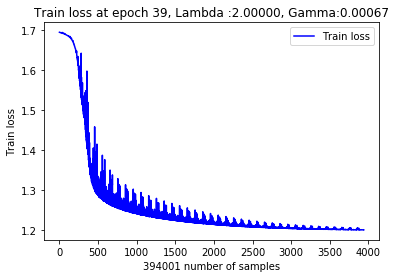

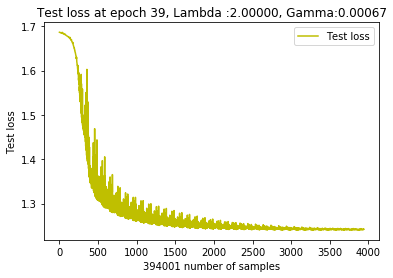

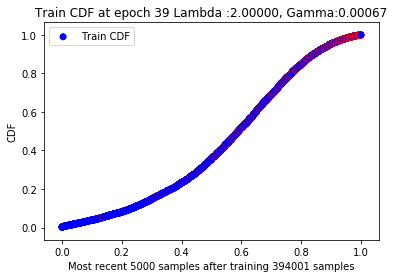

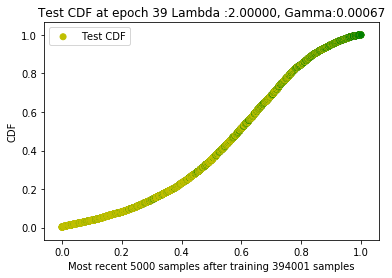

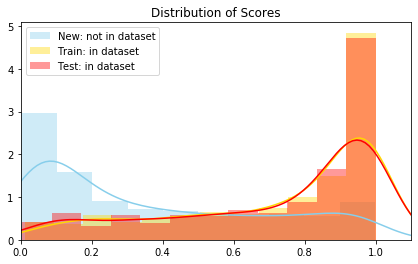

 40%|████      | 4003/10000 [35:49<7:18:08,  4.38s/it] 

New score:  0.3445636
Train score:  0.7367473
Test score:  0.7239712


 60%|█████▉    | 5999/10000 [56:40<03:03, 21.77it/s]   

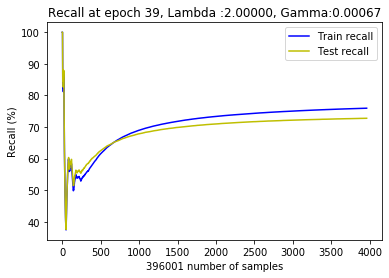

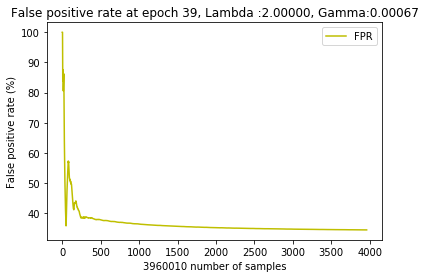

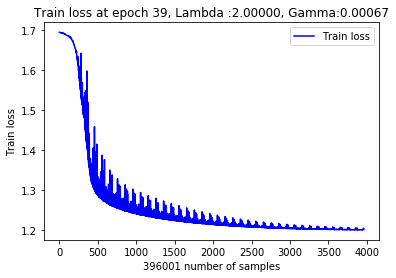

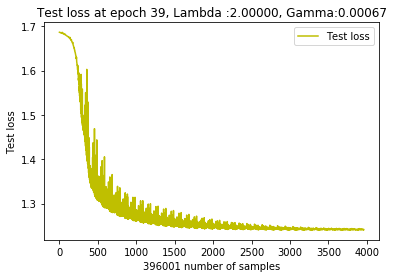

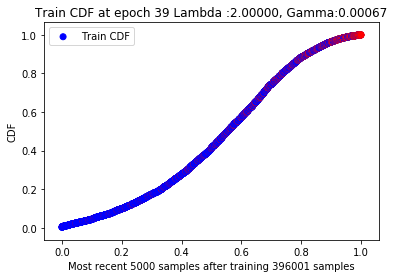

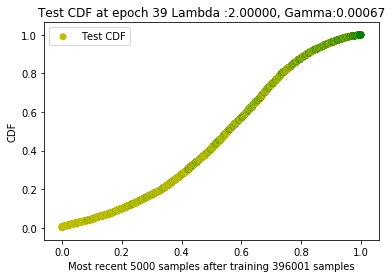

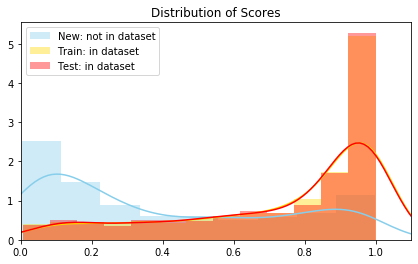

 60%|██████    | 6003/10000 [57:23<7:16:56,  6.56s/it] 

New score:  0.39337018
Train score:  0.7347741
Test score:  0.7456451


 80%|███████▉  | 7998/10000 [1:18:00<01:40, 20.00it/s]   

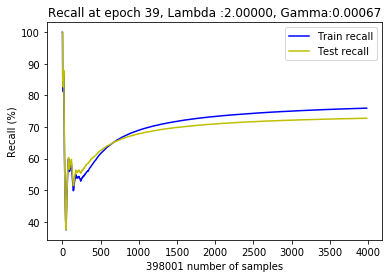

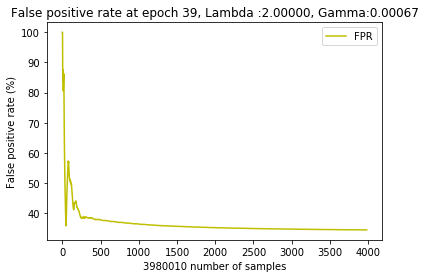

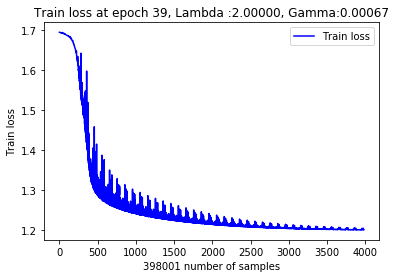

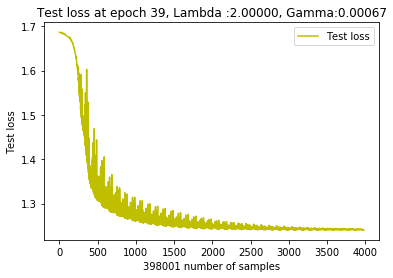

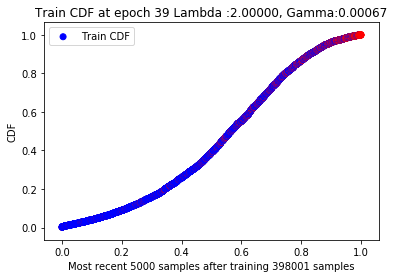

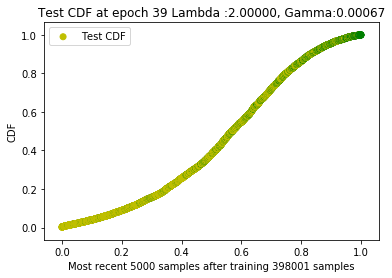

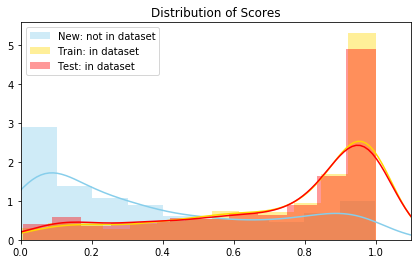

 80%|████████  | 8004/10000 [1:18:45<2:28:28,  4.46s/it]

New score:  0.38187945
Train score:  0.7447527
Test score:  0.7306138


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  40  with learning rate:  0.0005986257591281018


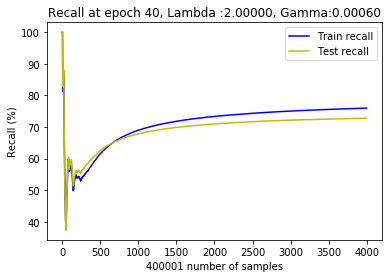

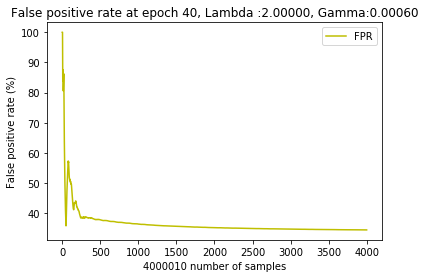

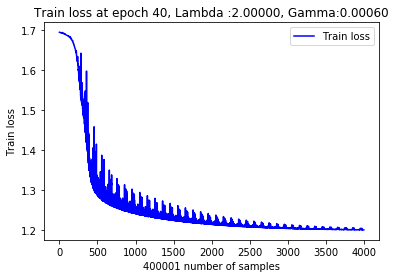

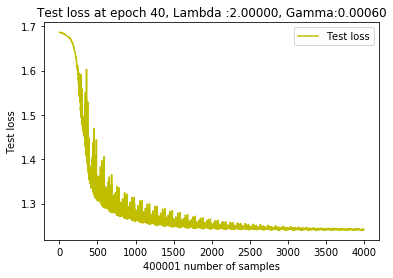

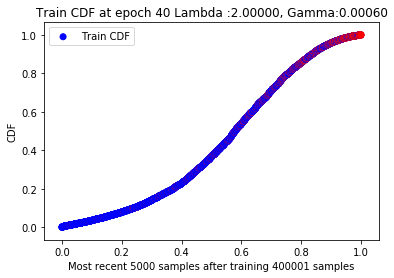

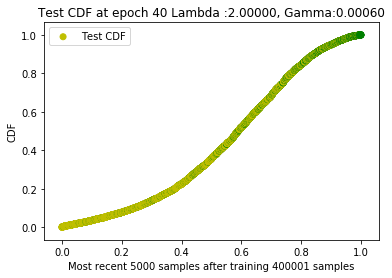

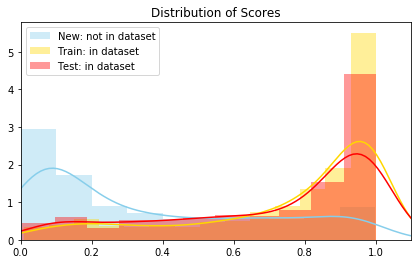

  0%|          | 4/10000 [01:02<121:57:12, 43.92s/it]

New score:  0.34339043
Train score:  0.75390613
Test score:  0.71913266


 20%|██        | 2000/10000 [22:00<06:41, 19.91it/s]   

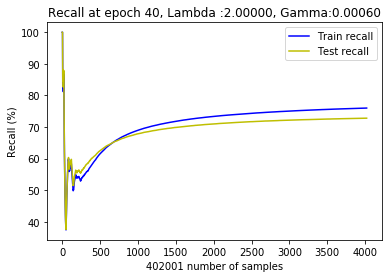

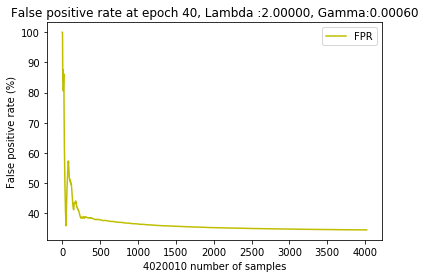

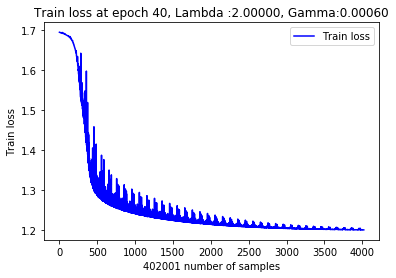

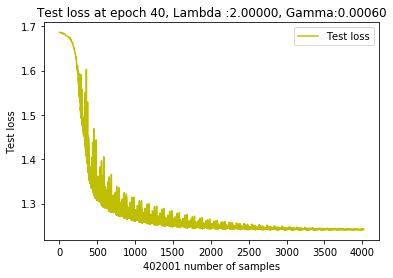

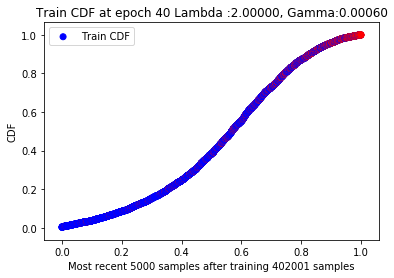

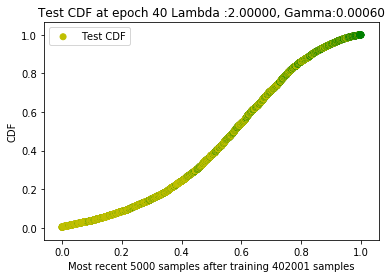

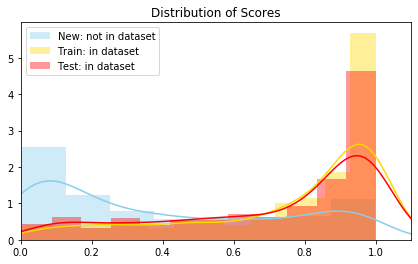

 20%|██        | 2004/10000 [22:42<28:18:01, 12.74s/it]

New score:  0.38689283
Train score:  0.7435969
Test score:  0.72594625


 40%|████      | 4000/10000 [43:20<05:04, 19.70it/s]   

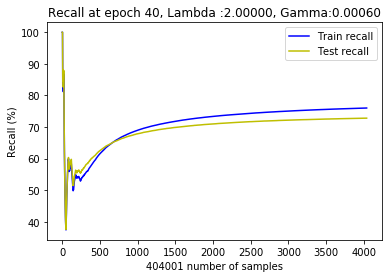

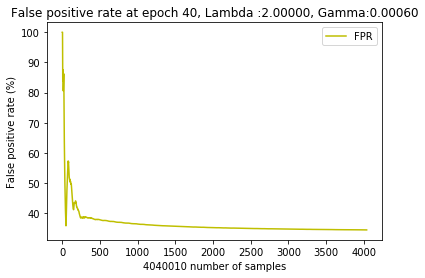

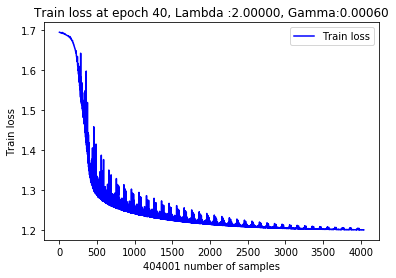

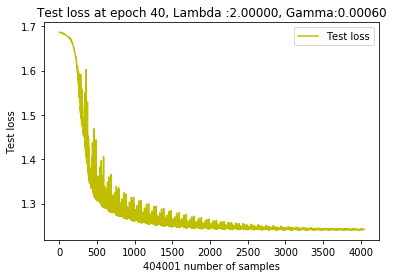

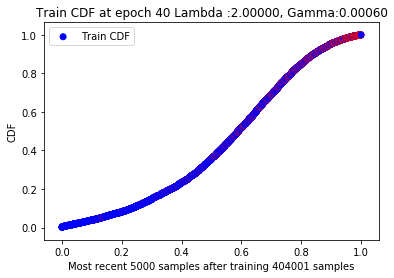

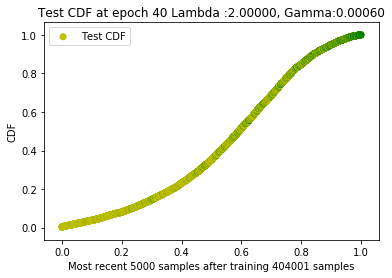

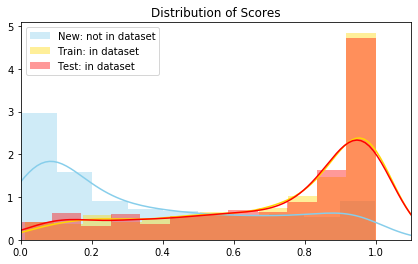

 40%|████      | 4003/10000 [44:09<21:44:57, 13.06s/it]

New score:  0.34537506
Train score:  0.7371274
Test score:  0.72434425


 60%|█████▉    | 5998/10000 [1:05:10<02:59, 22.26it/s]   

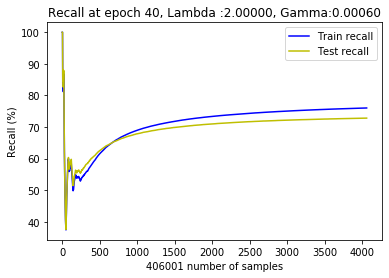

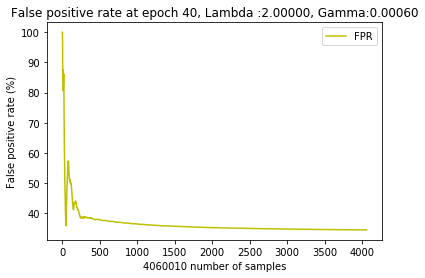

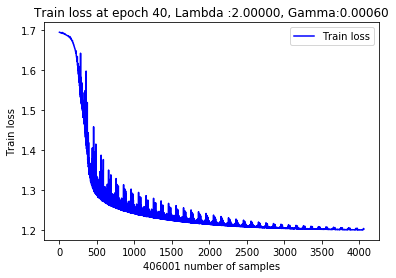

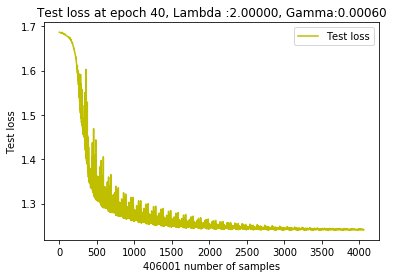

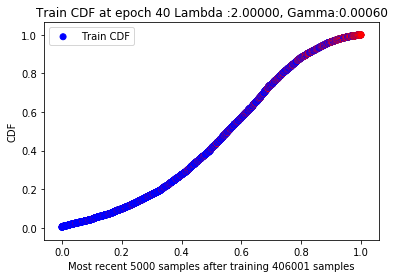

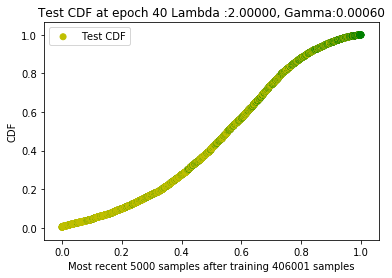

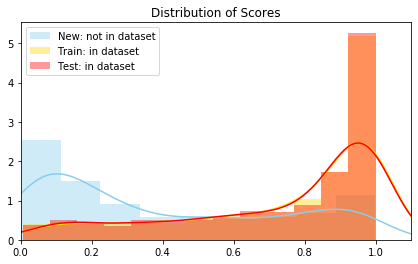

 60%|██████    | 6003/10000 [1:05:51<4:49:14,  4.34s/it]

New score:  0.3929724
Train score:  0.7339904
Test score:  0.7448198


 80%|███████▉  | 7998/10000 [1:27:00<01:32, 21.74it/s]   

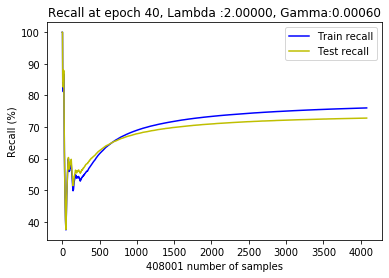

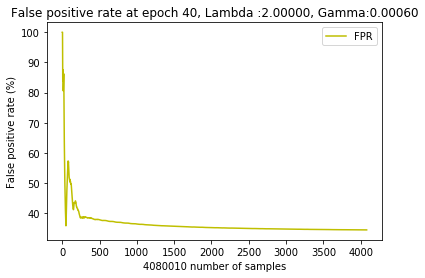

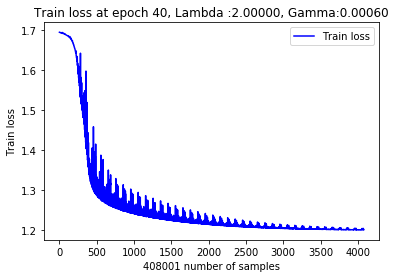

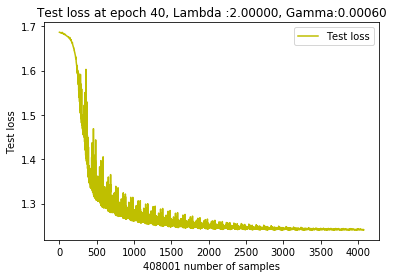

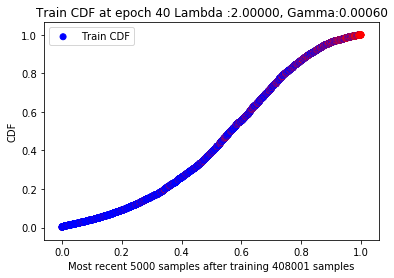

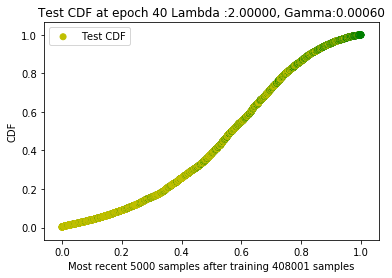

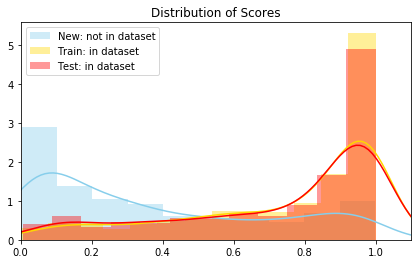

 80%|████████  | 8004/10000 [1:27:52<2:28:26,  4.46s/it]

New score:  0.38214368
Train score:  0.7455968
Test score:  0.7313461


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  41  with learning rate:  0.0005387631832152916


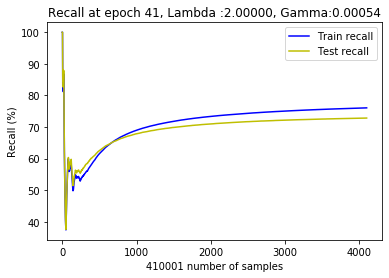

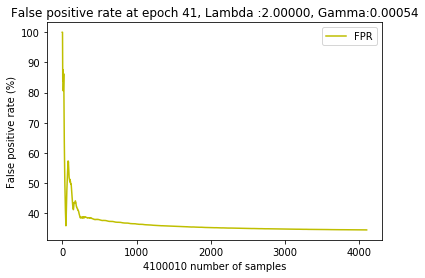

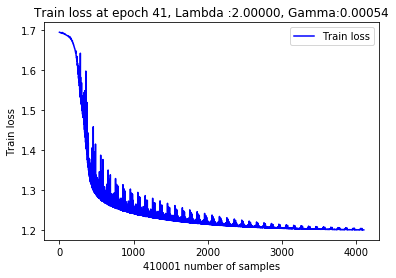

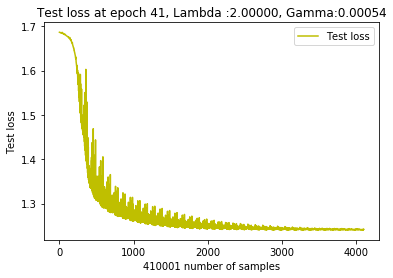

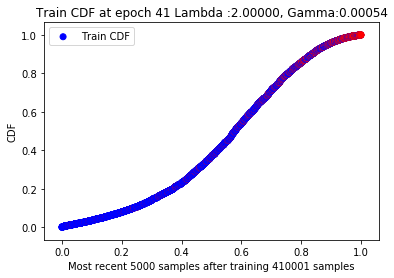

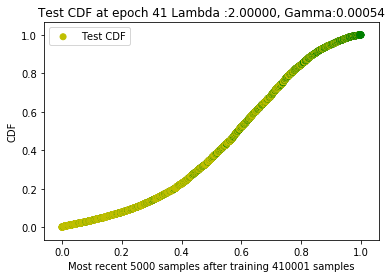

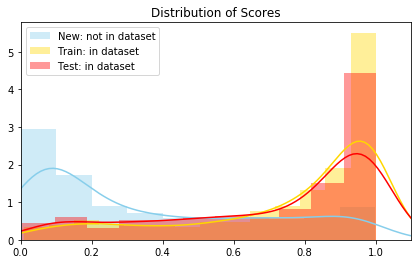

  0%|          | 4/10000 [01:03<123:57:36, 44.64s/it]

New score:  0.3438723
Train score:  0.7545382
Test score:  0.71973854


 20%|██        | 2000/10000 [22:00<06:55, 19.28it/s]   

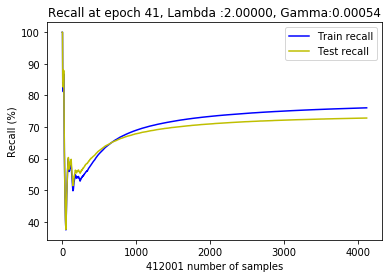

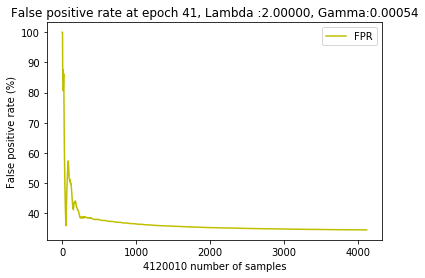

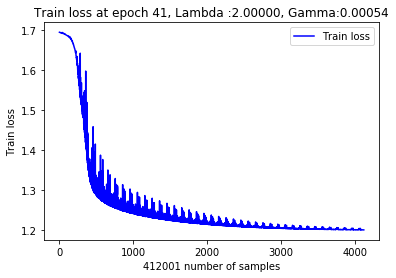

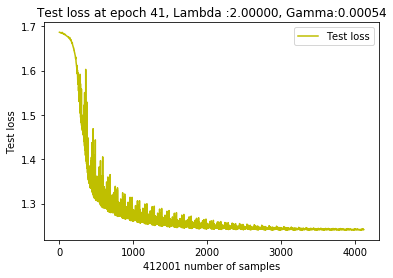

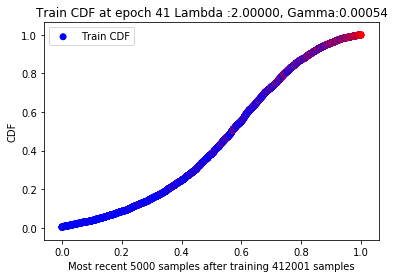

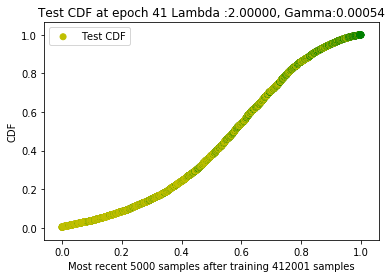

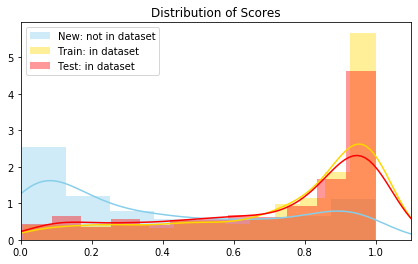

 20%|██        | 2003/10000 [22:45<29:18:50, 13.20s/it]

New score:  0.38646343
Train score:  0.74334556
Test score:  0.7256174


 40%|███▉      | 3999/10000 [43:40<05:11, 19.28it/s]   

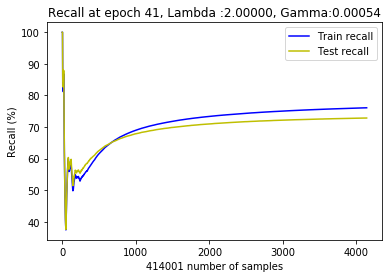

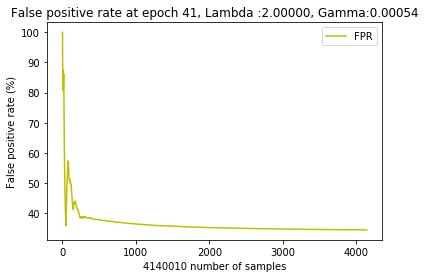

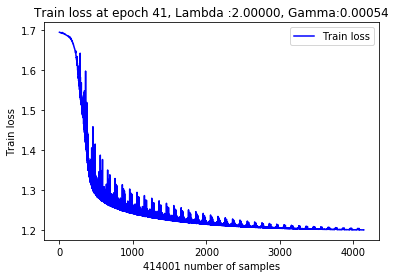

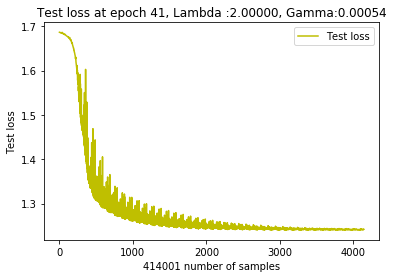

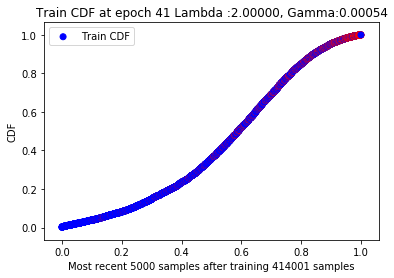

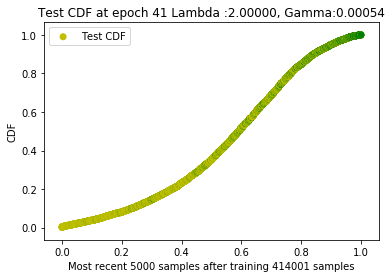

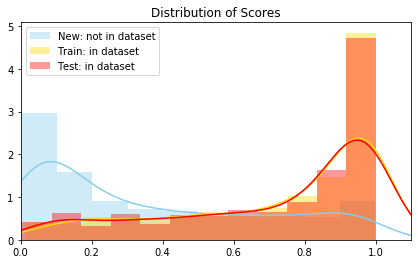

 40%|████      | 4003/10000 [44:27<11:03:59,  6.64s/it]

New score:  0.346125
Train score:  0.73745936
Test score:  0.72466797


 60%|█████▉    | 5999/10000 [1:05:30<03:24, 19.58it/s]   

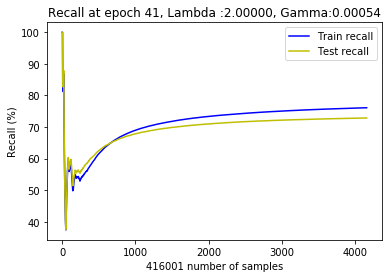

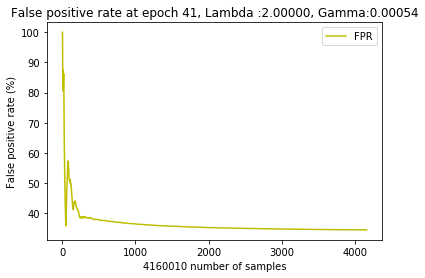

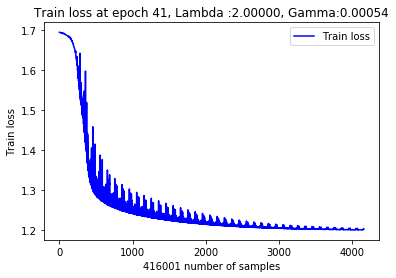

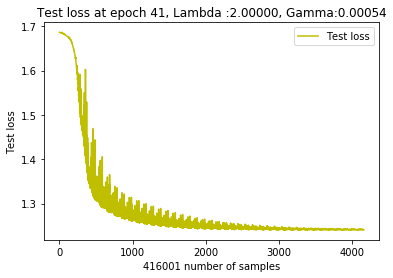

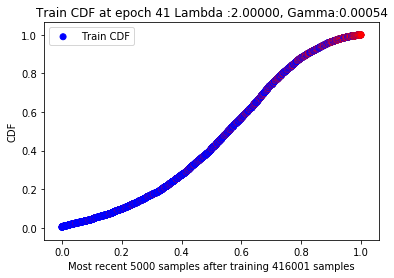

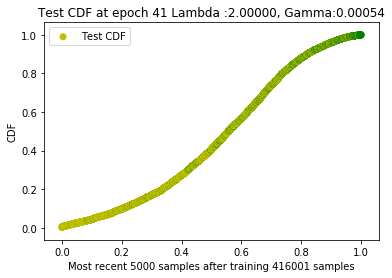

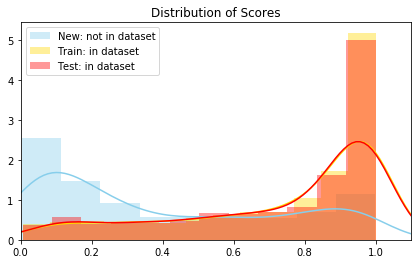

 60%|██████    | 6003/10000 [1:06:16<7:21:14,  6.62s/it] 

New score:  0.3924488
Train score:  0.73315054
Test score:  0.7439373


 80%|████████  | 8000/10000 [1:27:30<01:39, 20.16it/s]   

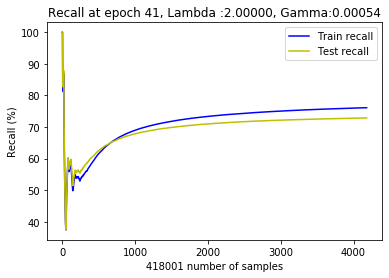

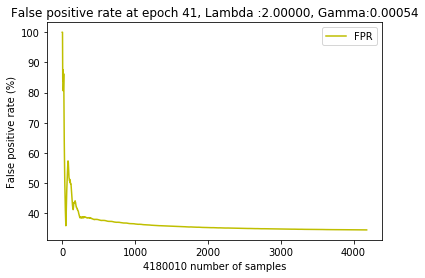

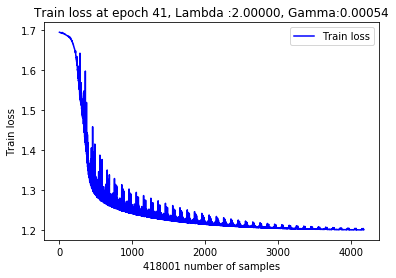

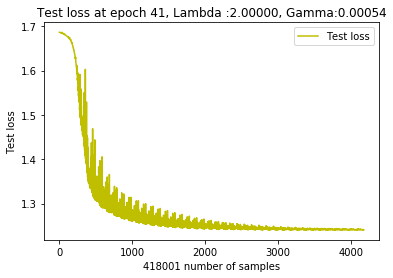

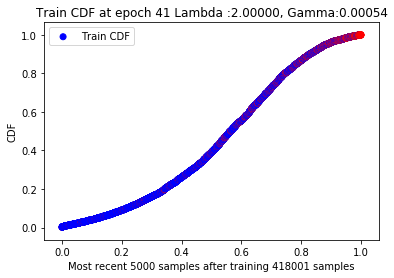

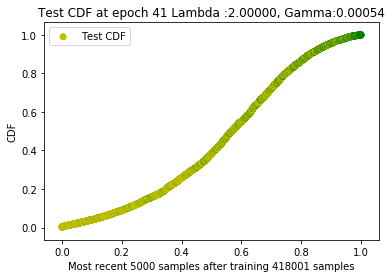

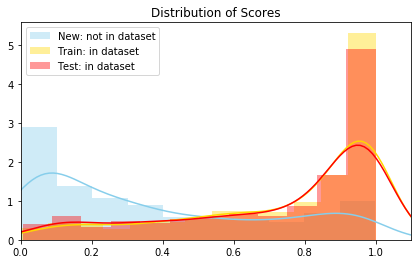

 80%|████████  | 8003/10000 [1:28:19<7:27:01, 13.43s/it] 

New score:  0.38247728
Train score:  0.74639106
Test score:  0.7320347


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  42  with learning rate:  0.0004848868648937625


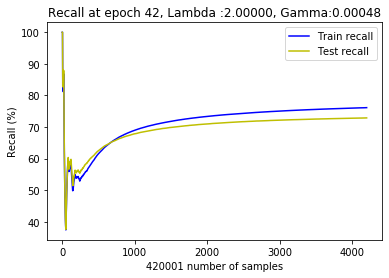

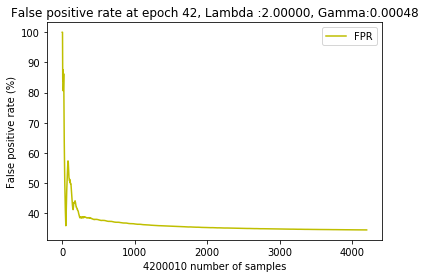

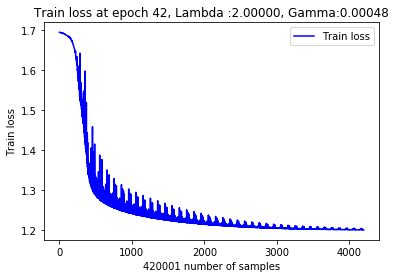

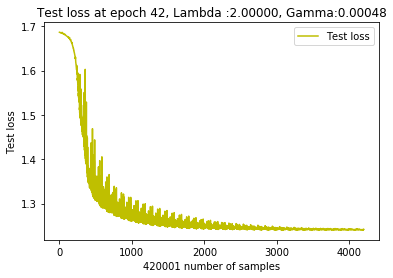

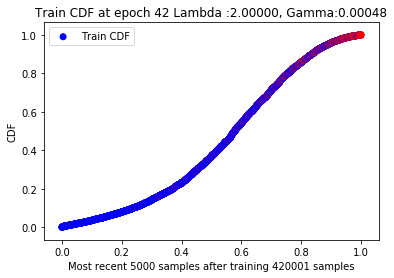

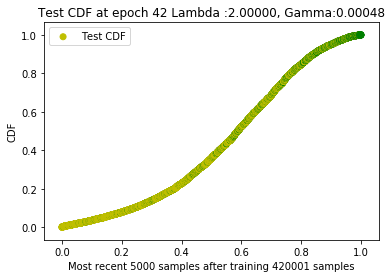

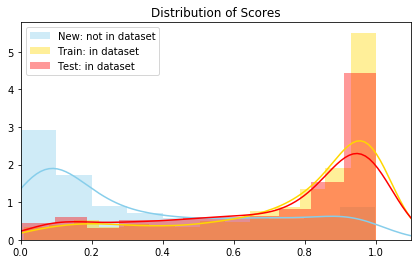

  0%|          | 3/10000 [01:04<125:23:32, 45.15s/it]

New score:  0.3444168
Train score:  0.7551976
Test score:  0.7203749


 20%|█▉        | 1999/10000 [22:10<07:26, 17.93it/s]   

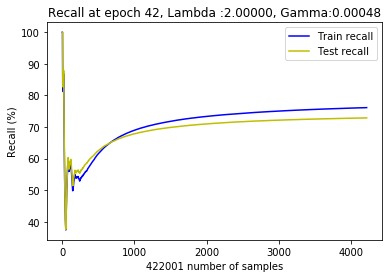

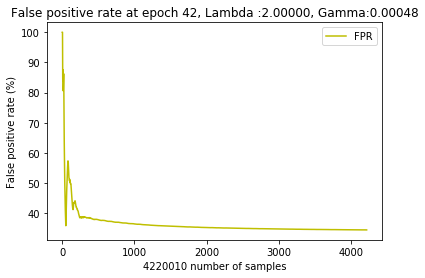

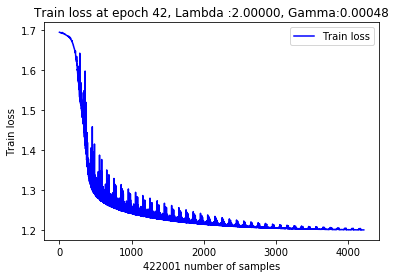

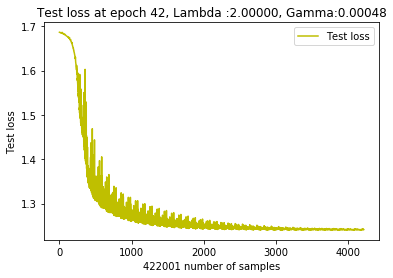

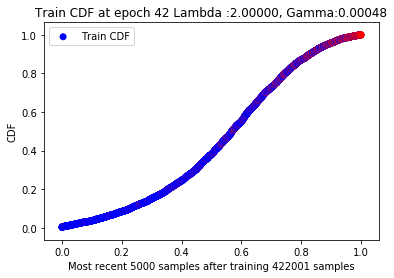

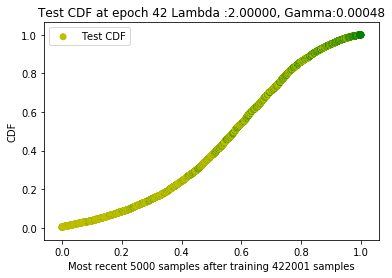

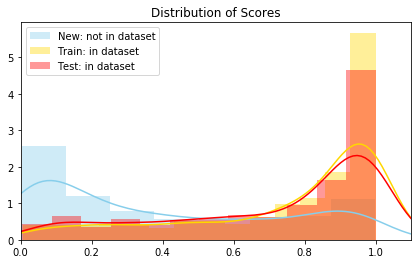

 20%|██        | 2004/10000 [22:53<14:27:31,  6.51s/it]

New score:  0.38607758
Train score:  0.7431419
Test score:  0.7253444


 40%|███▉      | 3999/10000 [44:10<05:05, 19.63it/s]   

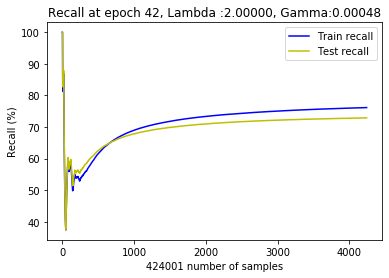

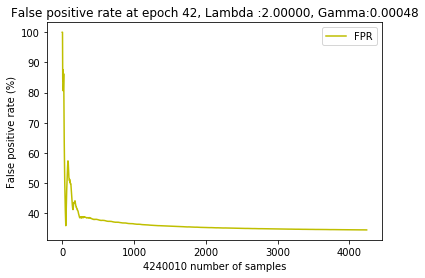

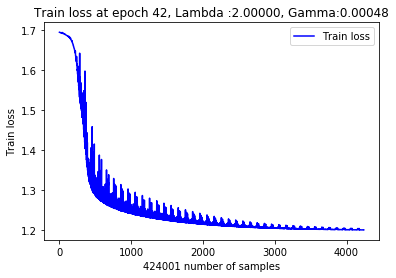

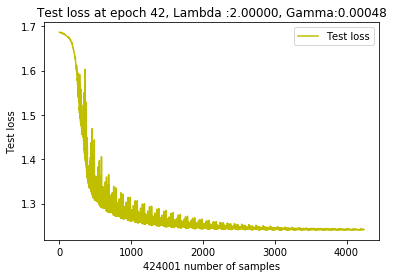

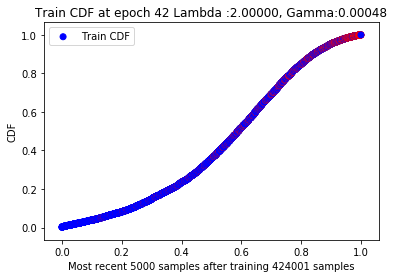

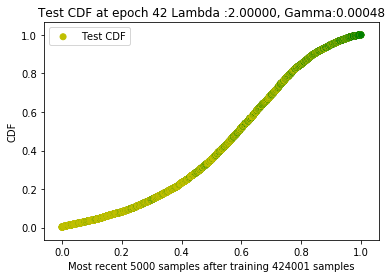

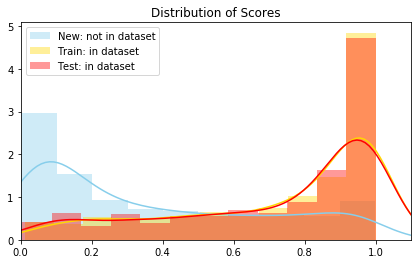

 40%|████      | 4003/10000 [44:58<11:02:51,  6.63s/it]

New score:  0.34678116
Train score:  0.7377147
Test score:  0.72491497


 60%|█████▉    | 5998/10000 [1:05:40<03:16, 20.35it/s]   

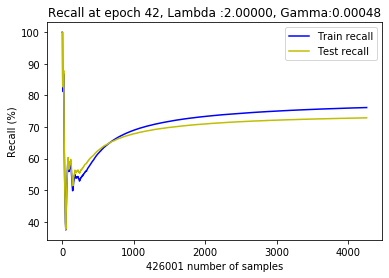

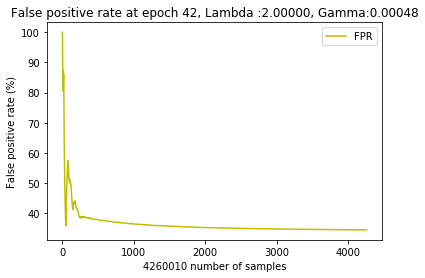

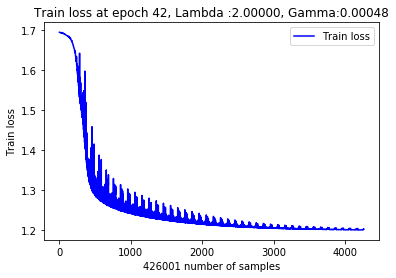

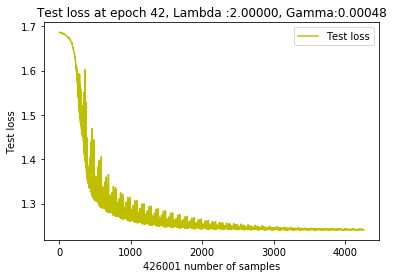

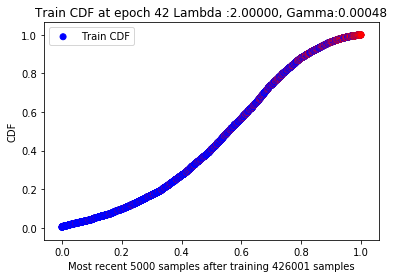

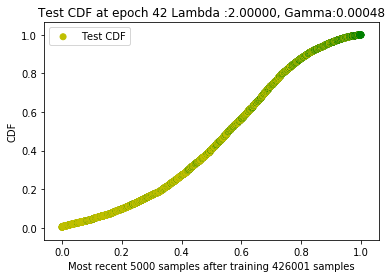

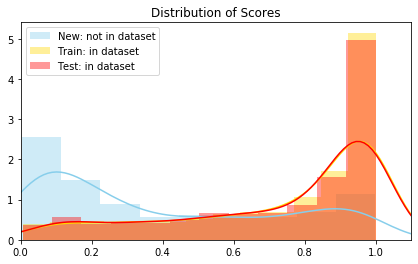

 60%|██████    | 6003/10000 [1:06:21<4:47:54,  4.32s/it]

New score:  0.39180186
Train score:  0.7322722
Test score:  0.7430184


 80%|███████▉  | 7998/10000 [1:26:50<01:40, 19.96it/s]   

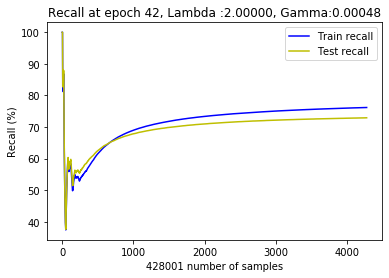

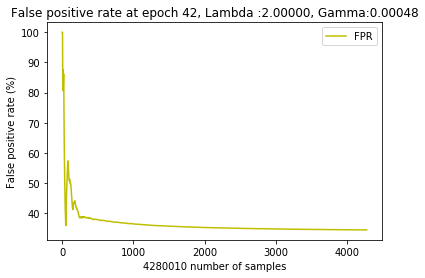

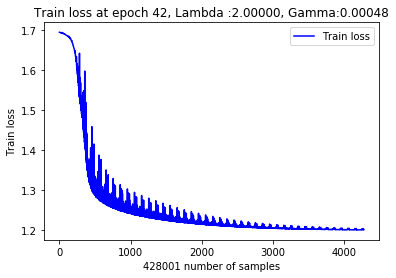

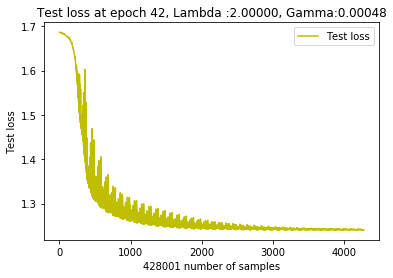

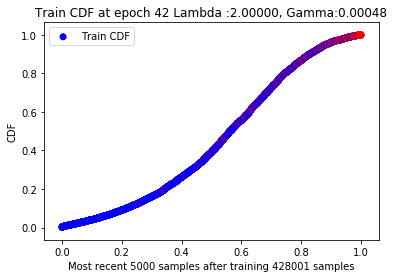

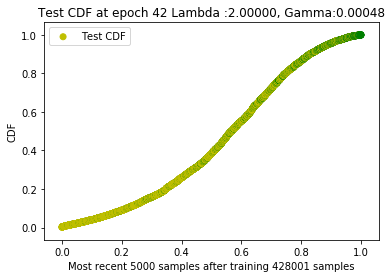

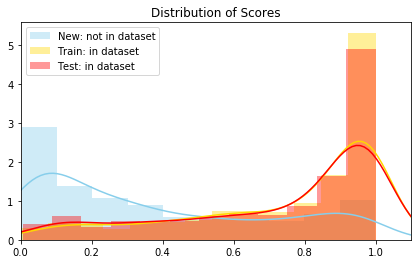

 80%|████████  | 8004/10000 [1:27:33<2:25:27,  4.37s/it]

New score:  0.3827959
Train score:  0.7470883
Test score:  0.7326349


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  43  with learning rate:  0.0004363981784043862


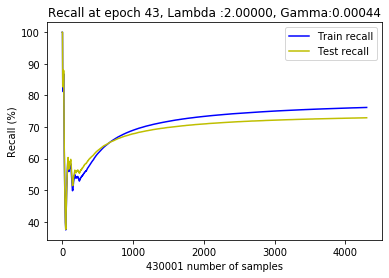

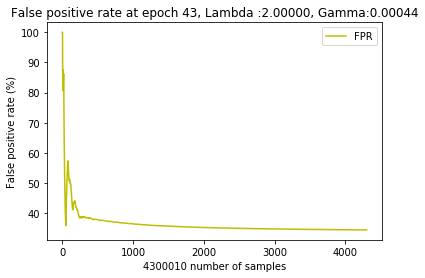

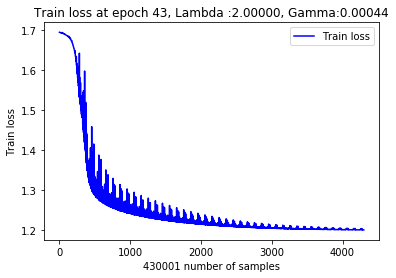

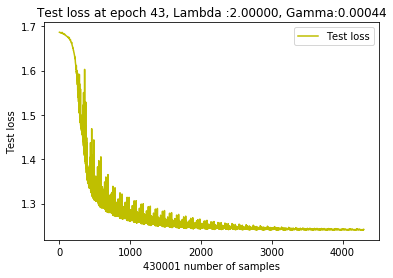

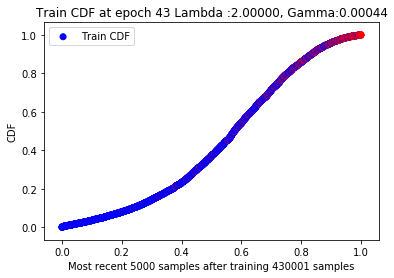

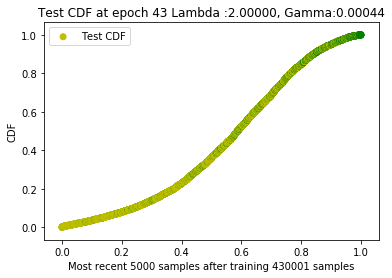

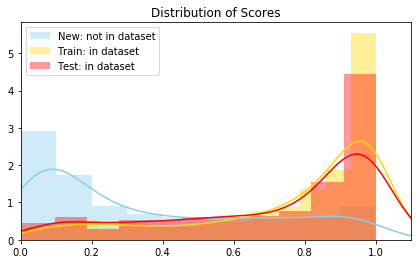

  0%|          | 4/10000 [01:01<119:46:20, 43.14s/it]

New score:  0.3450201
Train score:  0.75587267
Test score:  0.7210366


 20%|█▉        | 1999/10000 [21:40<07:33, 17.62it/s]   

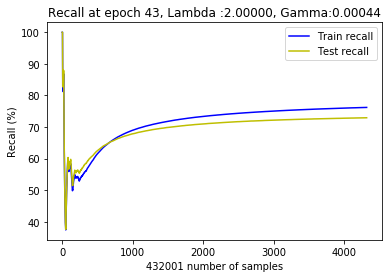

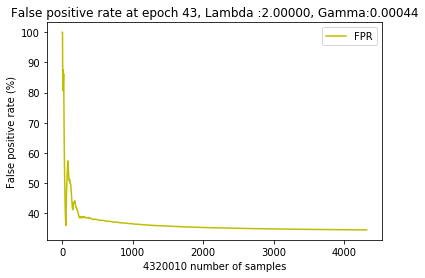

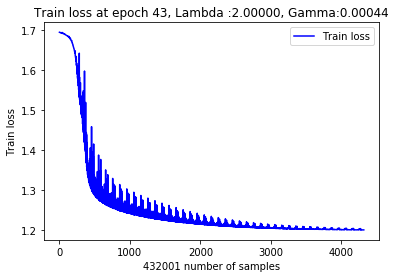

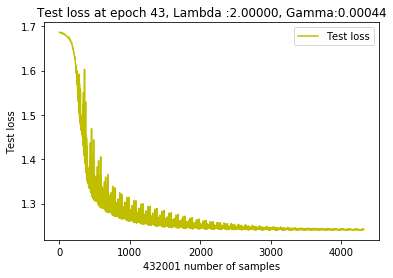

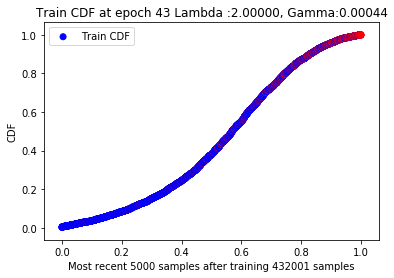

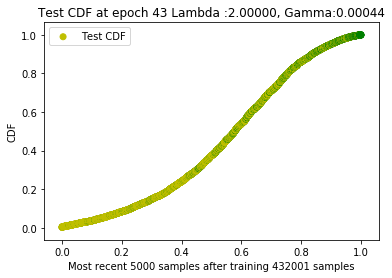

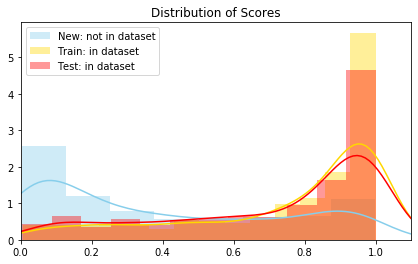

 20%|██        | 2003/10000 [22:27<14:43:17,  6.63s/it]

New score:  0.38574672
Train score:  0.7429834
Test score:  0.7251235


 40%|███▉      | 3998/10000 [43:10<05:08, 19.48it/s]   

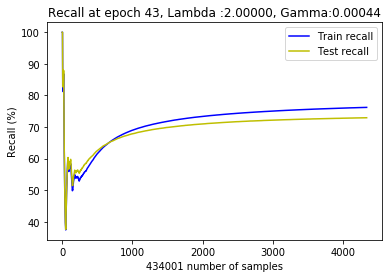

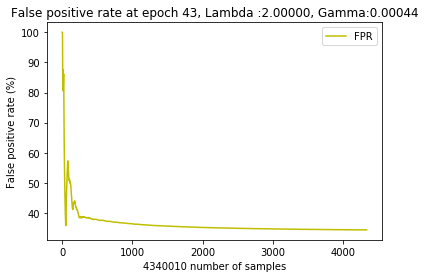

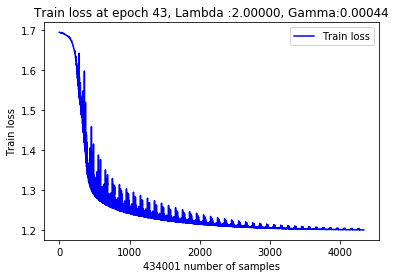

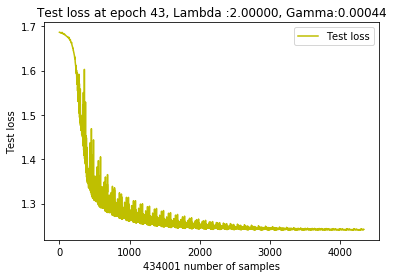

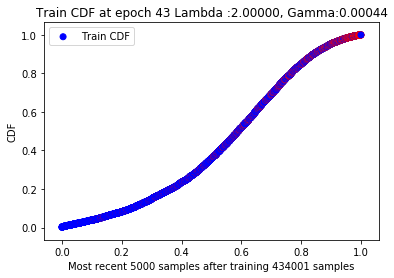

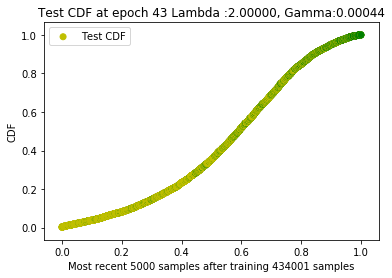

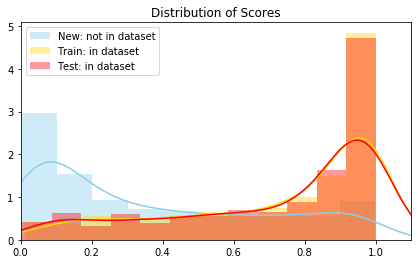

 40%|████      | 4005/10000 [44:00<7:11:26,  4.32s/it] 

New score:  0.34737146
Train score:  0.73792243
Test score:  0.72511536


 60%|█████▉    | 5998/10000 [1:04:50<03:49, 17.42it/s]   

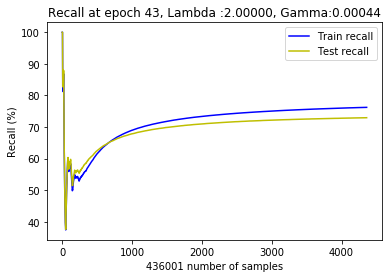

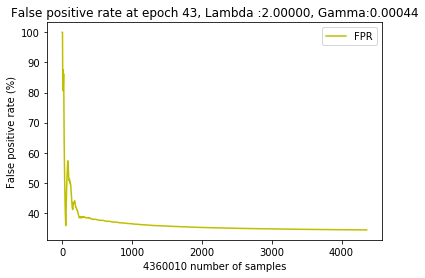

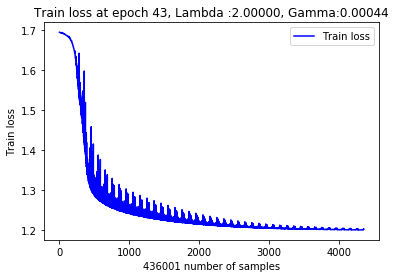

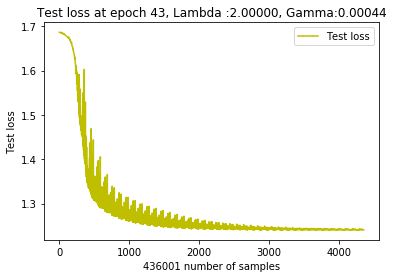

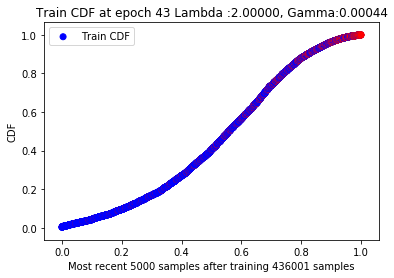

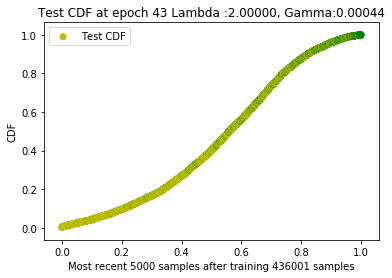

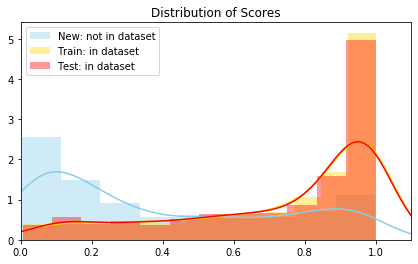

 60%|██████    | 6003/10000 [1:05:35<4:45:10,  4.28s/it]

New score:  0.39108405
Train score:  0.7313935
Test score:  0.7421021


 80%|███████▉  | 7999/10000 [1:26:10<01:14, 26.94it/s]   

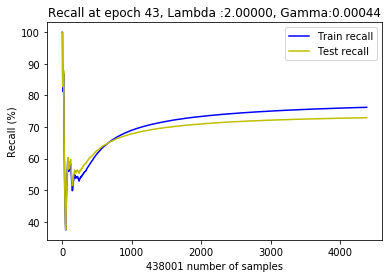

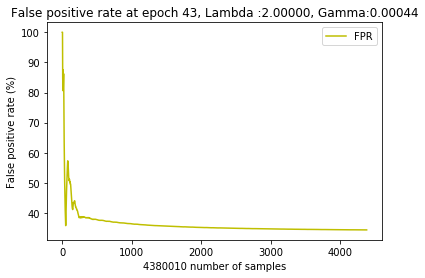

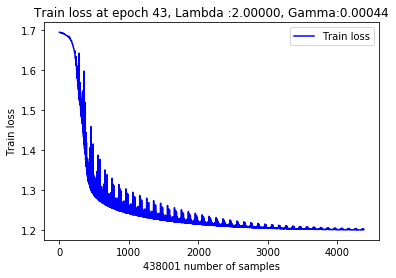

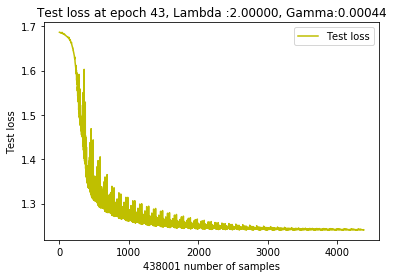

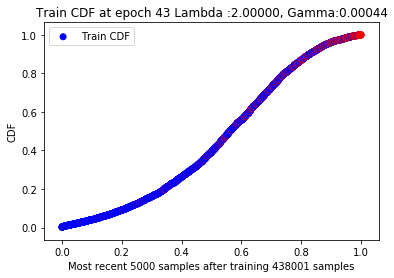

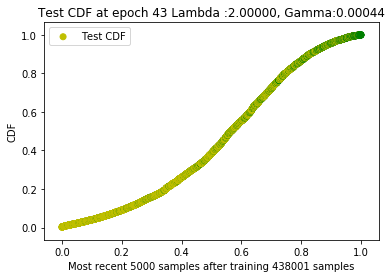

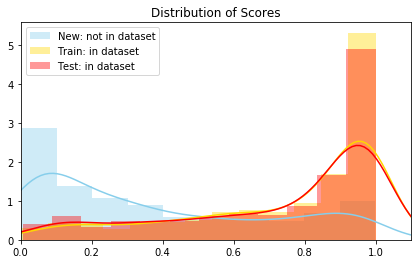

 80%|████████  | 8004/10000 [1:26:57<3:40:06,  6.62s/it]

New score:  0.38307044
Train score:  0.7476735
Test score:  0.7331335


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  44  with learning rate:  0.0003927583605639476


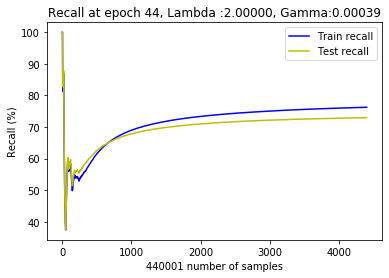

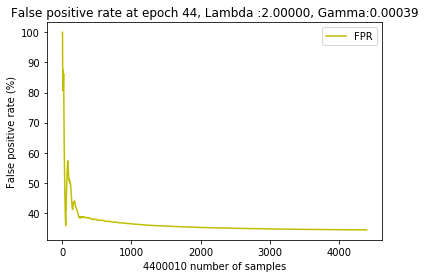

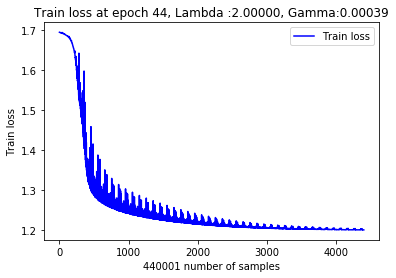

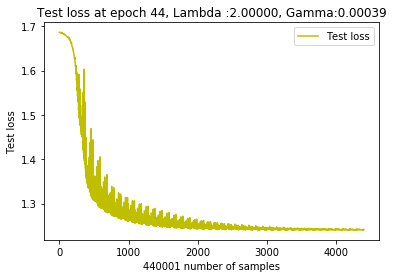

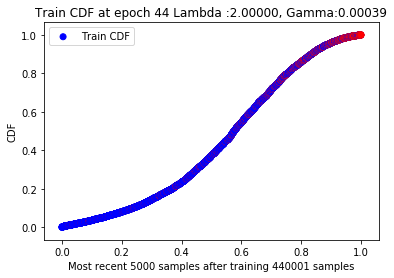

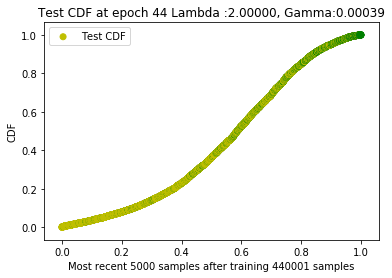

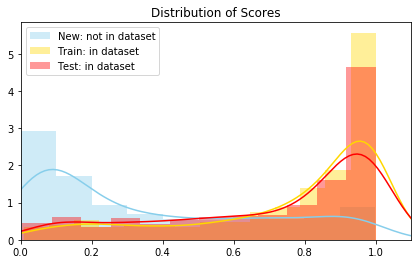

  0%|          | 5/10000 [01:01<119:07:15, 42.90s/it]

New score:  0.34570312
Train score:  0.7565782
Test score:  0.7217332


 20%|█▉        | 1999/10000 [22:00<07:19, 18.20it/s]   

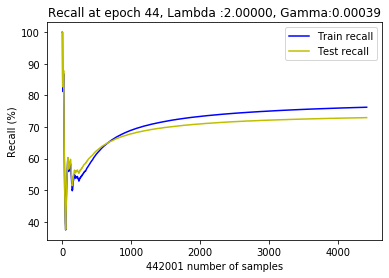

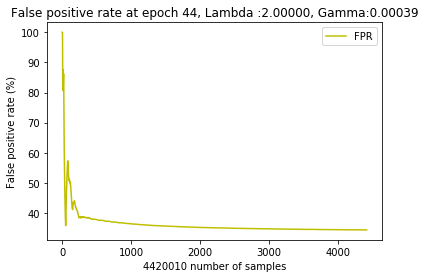

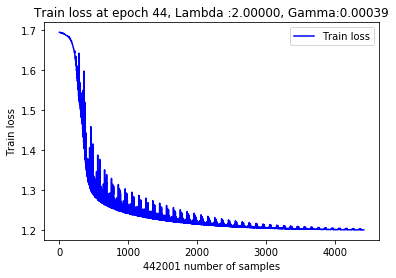

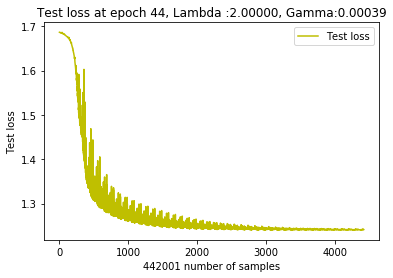

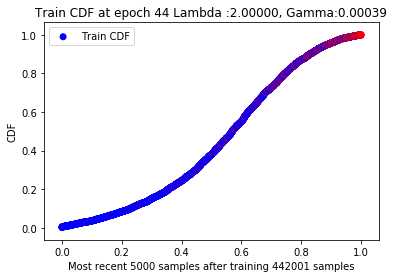

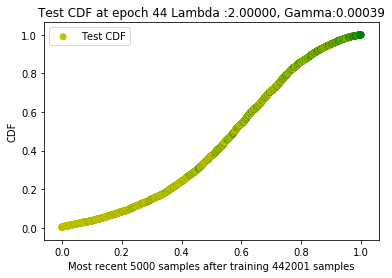

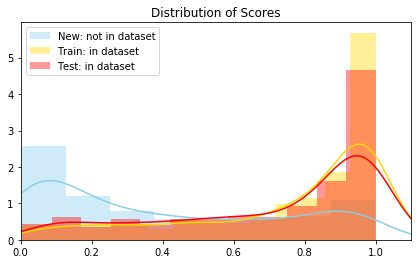

 20%|██        | 2003/10000 [22:50<14:41:33,  6.61s/it]

New score:  0.38546038
Train score:  0.74287415
Test score:  0.72495896


 40%|███▉      | 3998/10000 [41:30<04:03, 24.70it/s]   

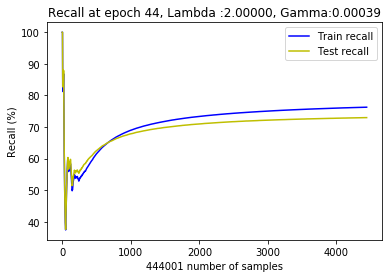

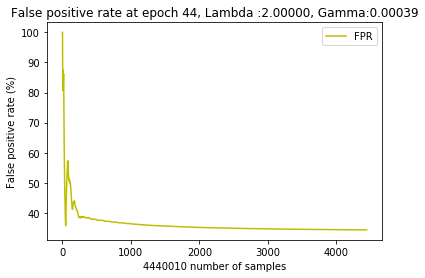

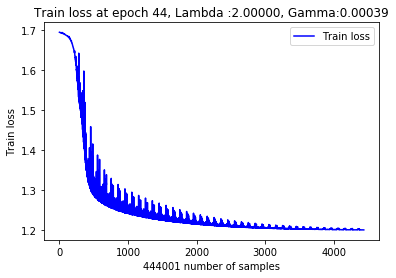

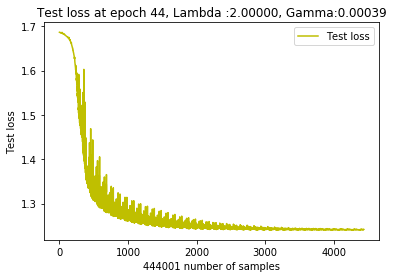

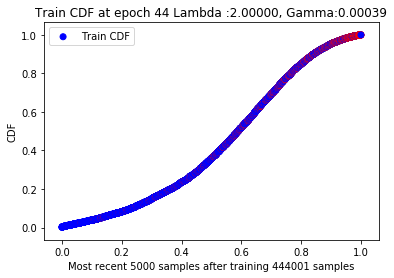

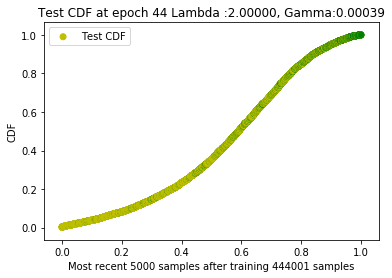

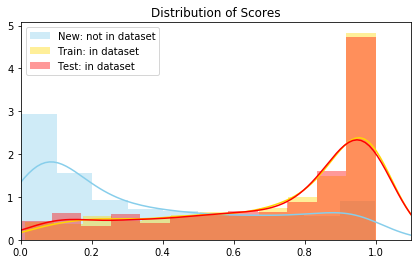

 40%|████      | 4004/10000 [42:08<6:14:48,  3.75s/it]

New score:  0.34789968
Train score:  0.7380877
Test score:  0.72527426


 60%|█████▉    | 5998/10000 [1:00:10<02:49, 23.57it/s] 

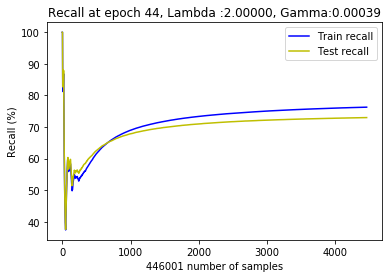

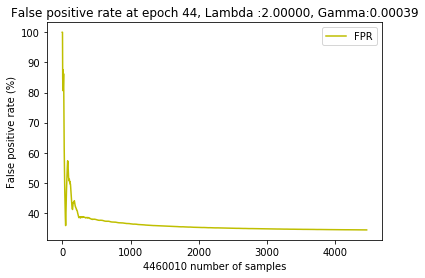

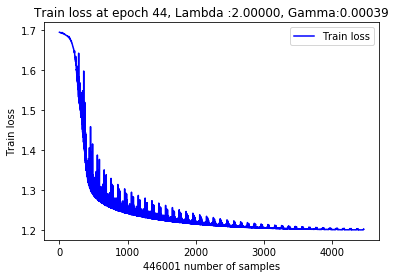

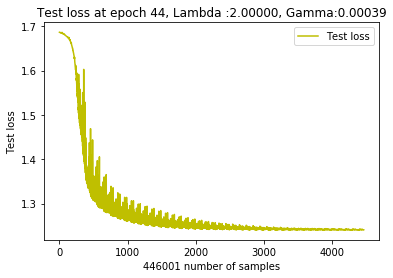

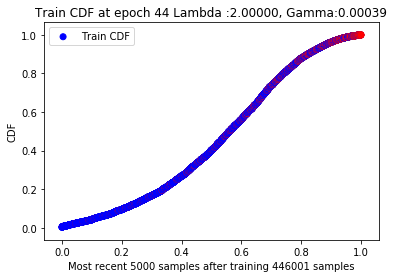

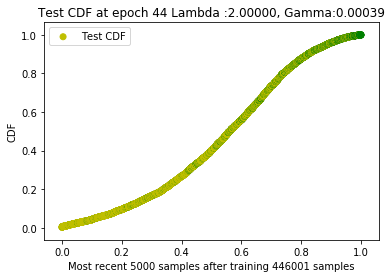

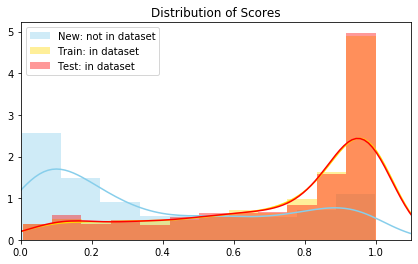

 60%|██████    | 6003/10000 [1:00:49<4:37:12,  4.16s/it]

New score:  0.3903142
Train score:  0.73050976
Test score:  0.7411848


 80%|███████▉  | 7999/10000 [1:18:40<01:18, 25.42it/s]   

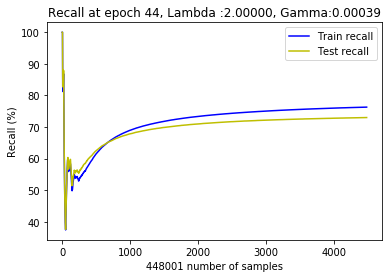

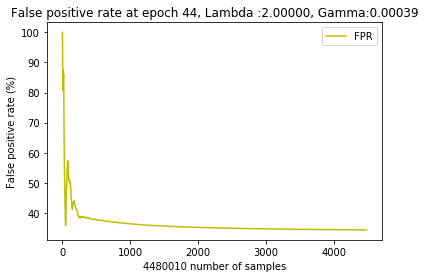

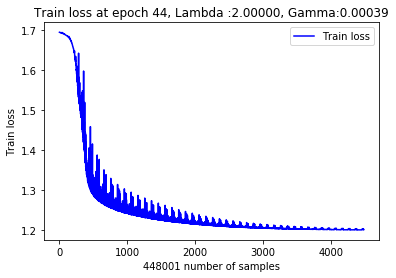

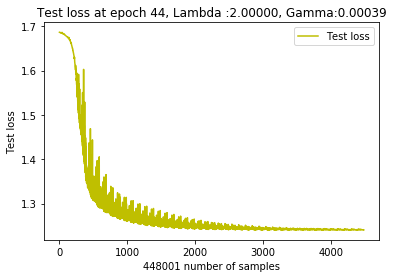

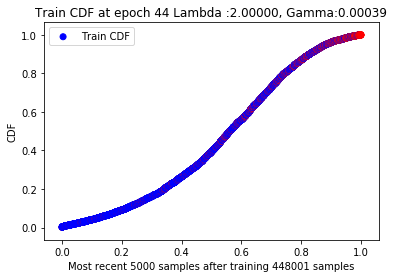

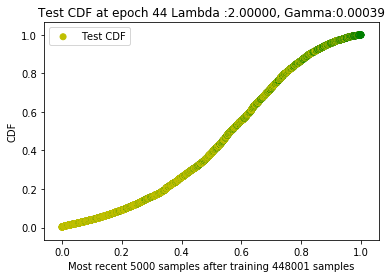

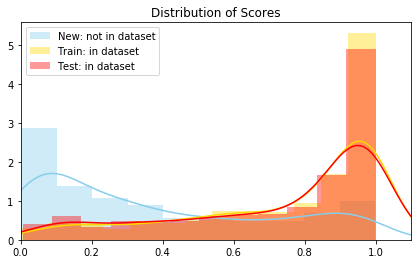

 80%|████████  | 8004/10000 [1:19:19<3:09:10,  5.69s/it]

New score:  0.38332698
Train score:  0.748178
Test score:  0.73355865


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  45  with learning rate:  0.00035348252450755286


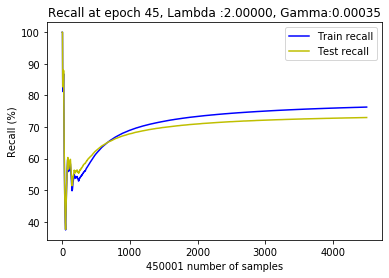

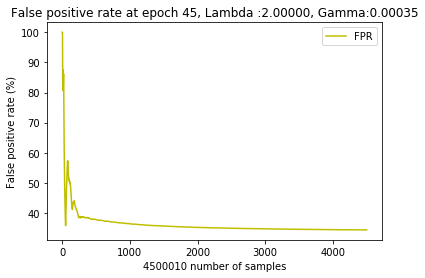

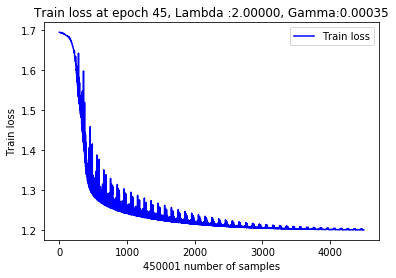

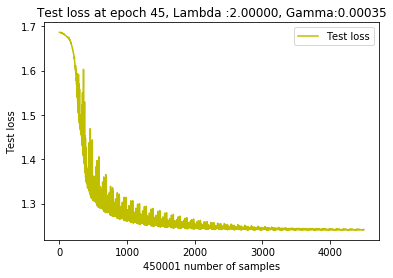

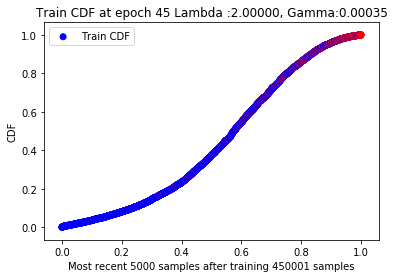

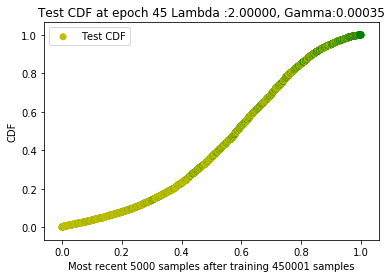

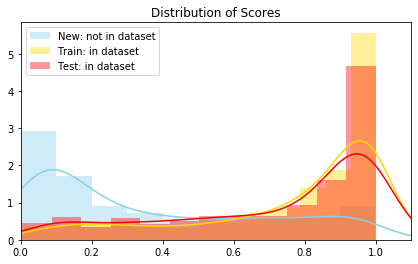

  0%|          | 3/10000 [01:00<116:33:04, 41.97s/it]

New score:  0.3464136
Train score:  0.7572979
Test score:  0.7224496


 20%|██        | 2000/10000 [18:50<06:45, 19.72it/s]   

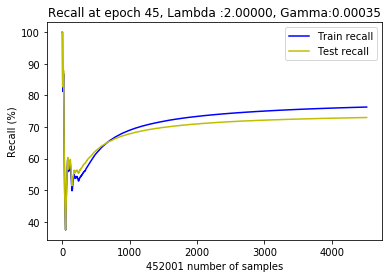

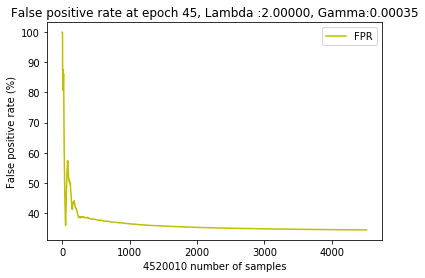

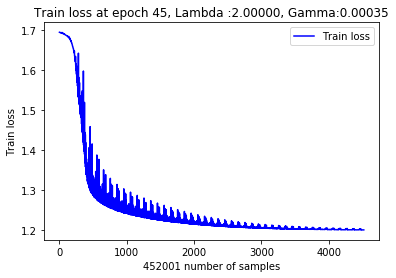

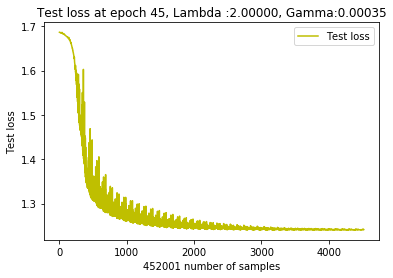

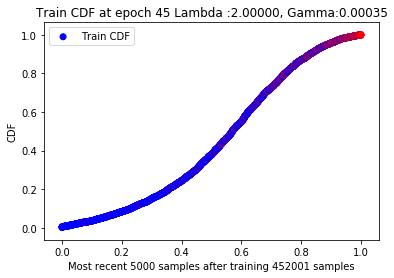

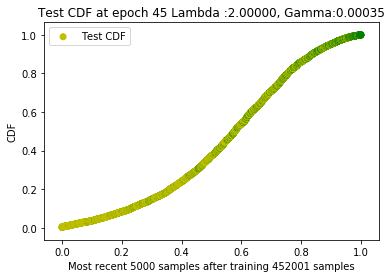

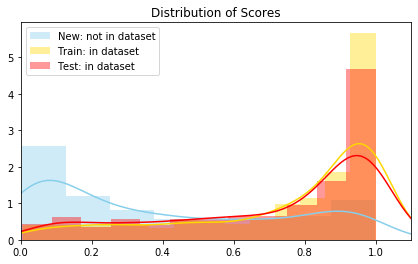

 20%|██        | 2003/10000 [19:28<24:52:04, 11.19s/it]

New score:  0.38523507
Train score:  0.74281764
Test score:  0.7248541


 40%|████      | 4000/10000 [38:10<04:39, 21.47it/s]   

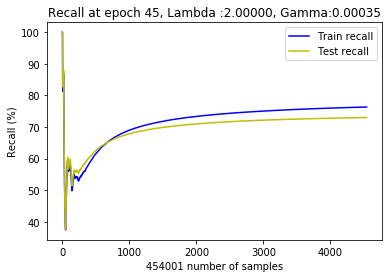

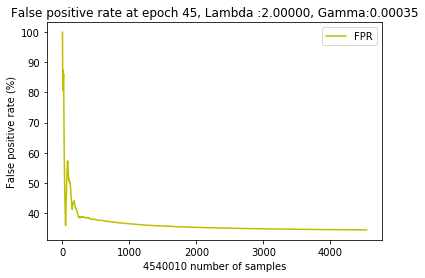

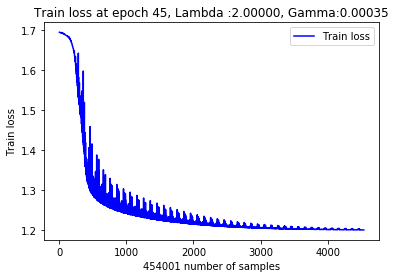

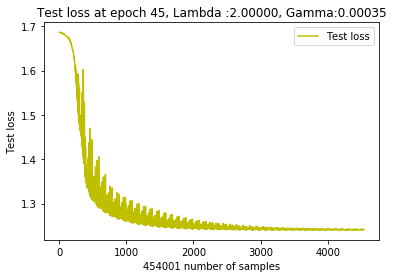

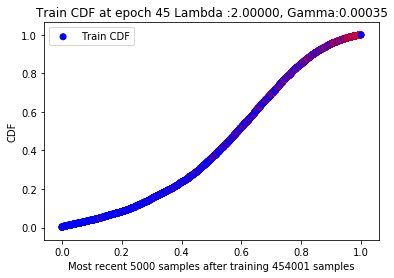

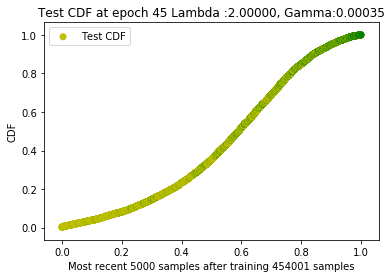

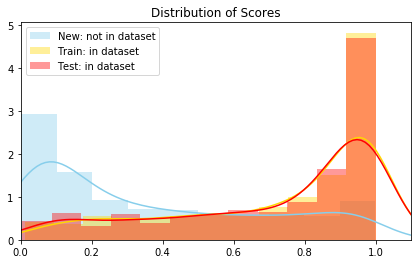

 40%|████      | 4003/10000 [38:54<20:57:50, 12.58s/it]

New score:  0.34833586
Train score:  0.73819005
Test score:  0.7253702


 60%|█████▉    | 5998/10000 [57:30<02:54, 22.89it/s]   

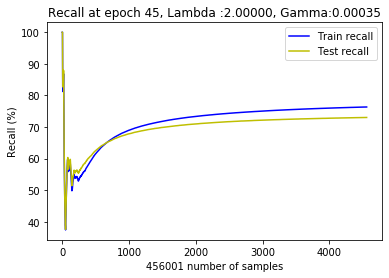

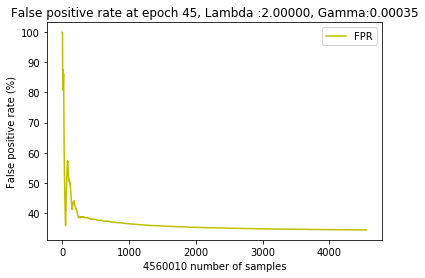

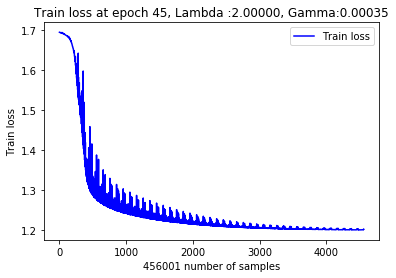

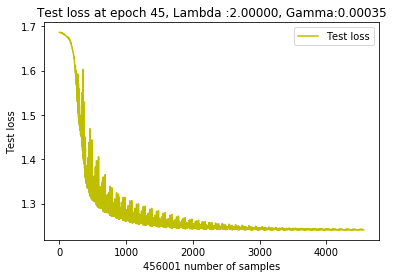

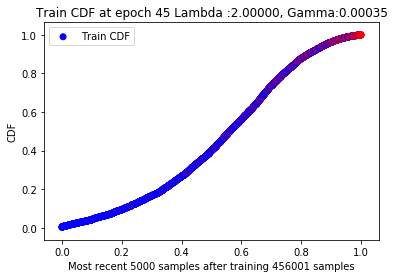

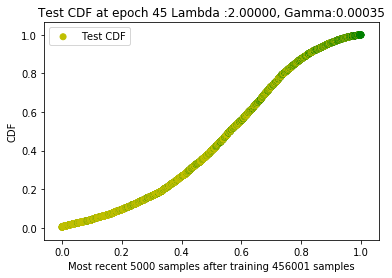

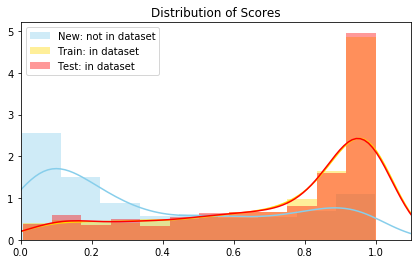

 60%|██████    | 6003/10000 [58:08<4:06:00,  3.69s/it]

New score:  0.38944635
Train score:  0.72958827
Test score:  0.74022853


 80%|███████▉  | 7998/10000 [1:19:00<01:45, 19.06it/s]   

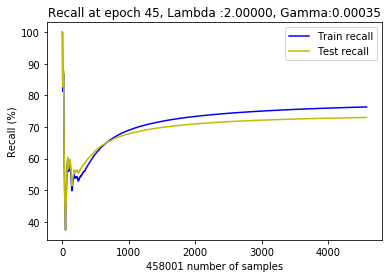

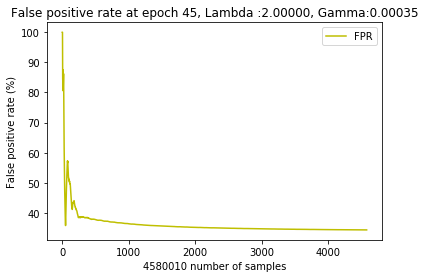

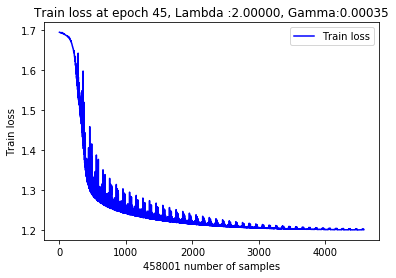

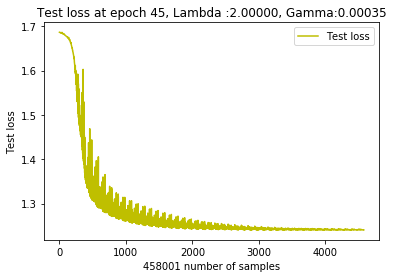

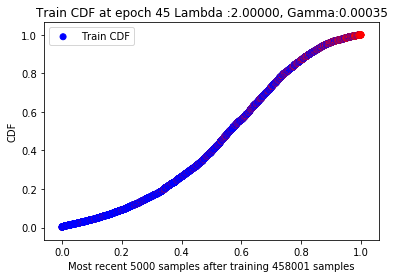

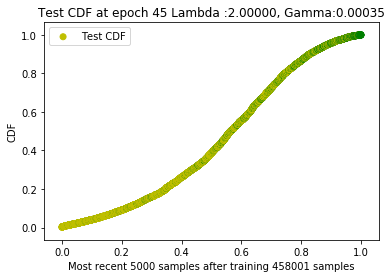

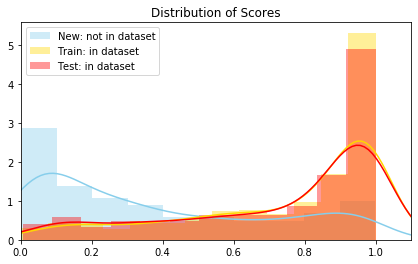

 80%|████████  | 8003/10000 [1:19:52<2:29:30,  4.49s/it]

New score:  0.38350308
Train score:  0.7485586
Test score:  0.7338675


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  46  with learning rate:  0.0003181342720567976


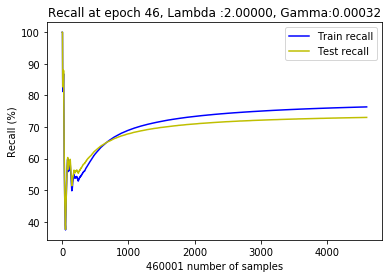

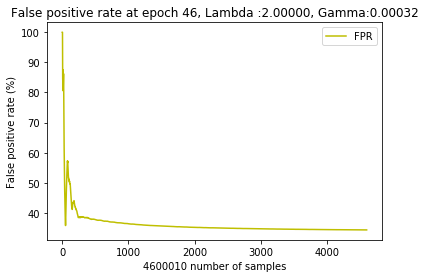

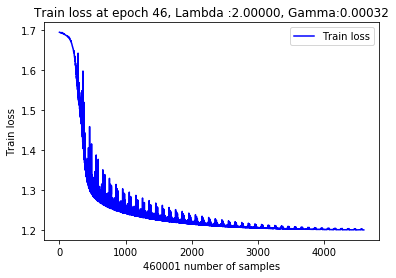

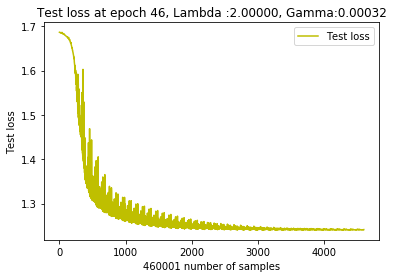

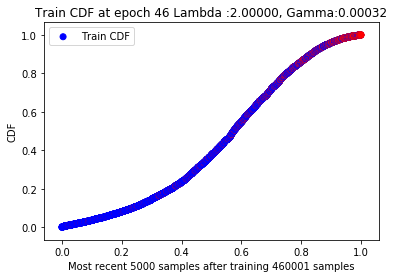

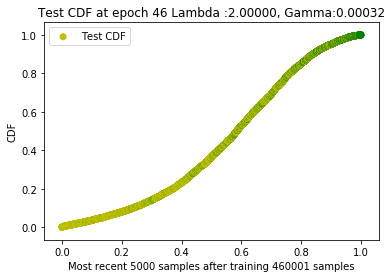

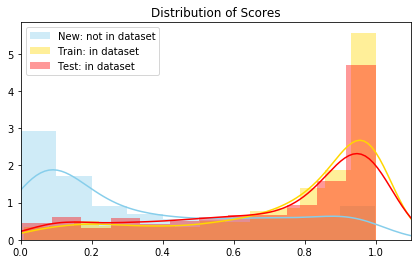

  0%|          | 3/10000 [01:01<120:01:46, 43.22s/it]

New score:  0.3471675
Train score:  0.75801504
Test score:  0.7231654


 20%|██        | 2000/10000 [21:30<07:16, 18.33it/s]   

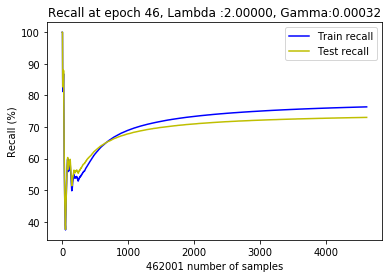

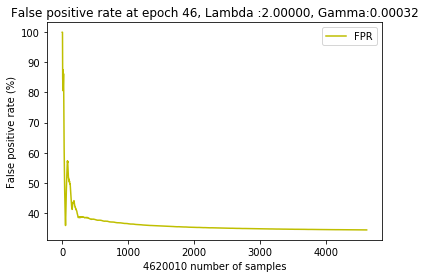

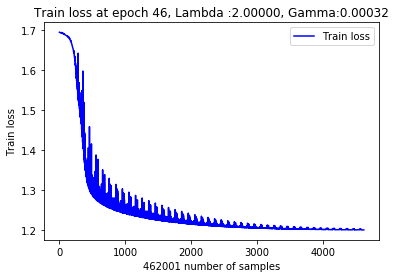

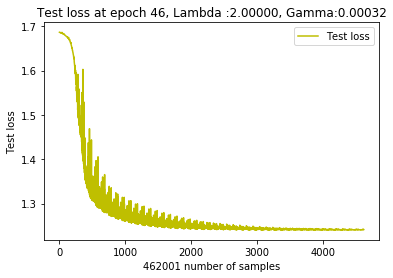

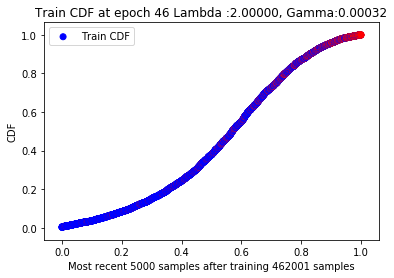

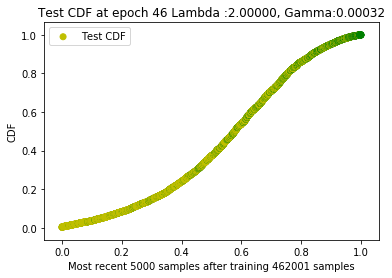

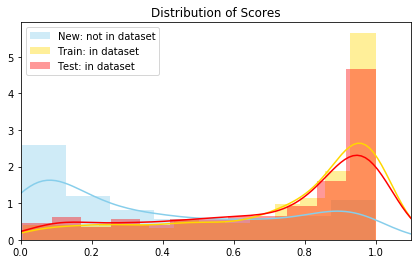

 20%|██        | 2005/10000 [22:22<29:58:00, 13.49s/it]

New score:  0.38509136
Train score:  0.74282706
Test score:  0.72481996


 40%|████      | 4000/10000 [43:20<05:17, 18.90it/s]   

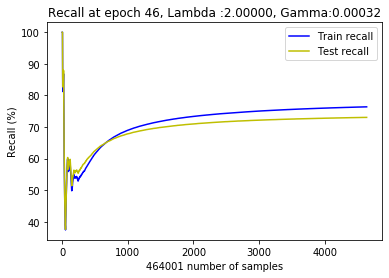

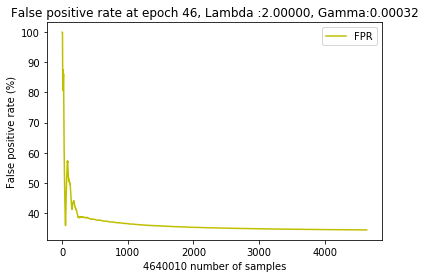

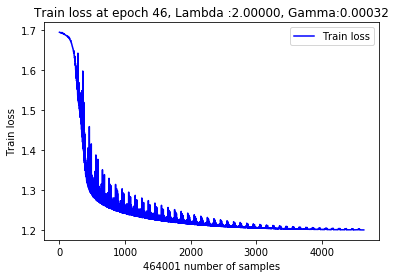

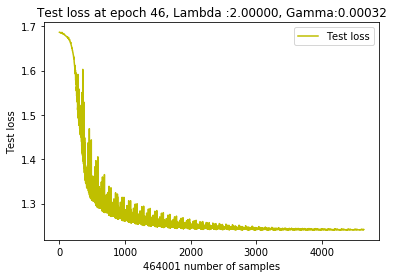

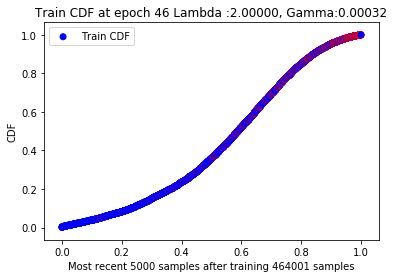

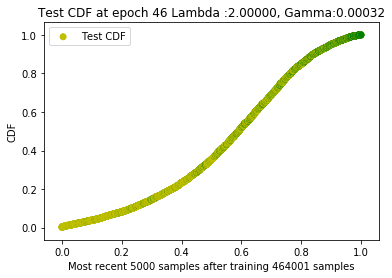

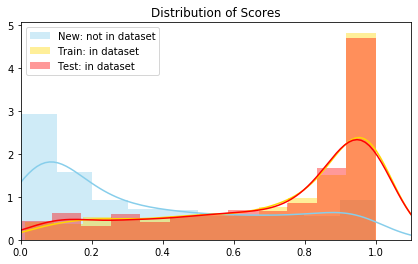

 40%|████      | 4003/10000 [44:17<23:54:39, 14.35s/it]

New score:  0.3487463
Train score:  0.73829275
Test score:  0.72546536


 60%|█████▉    | 5998/10000 [1:05:10<03:30, 19.01it/s]   

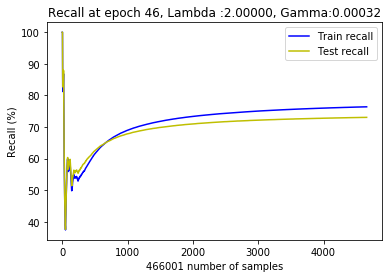

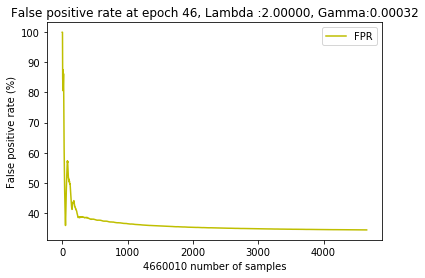

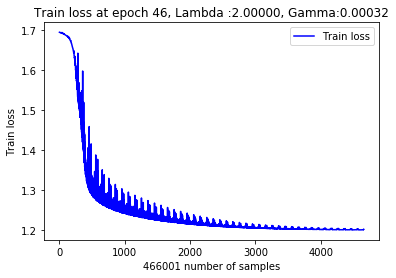

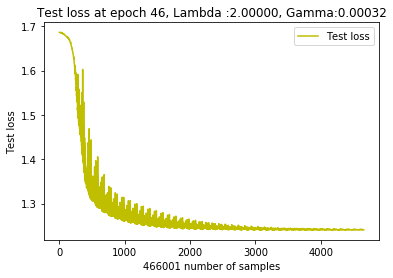

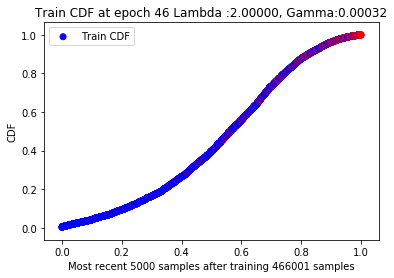

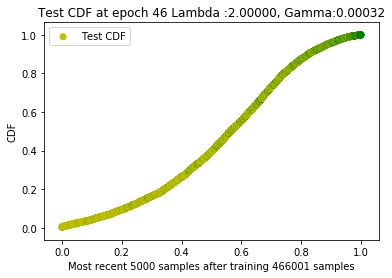

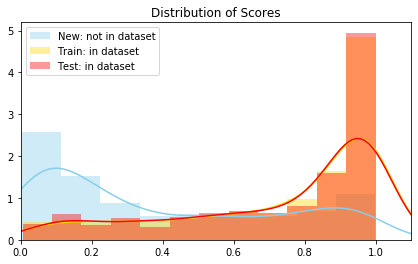

 60%|██████    | 6003/10000 [1:06:03<5:19:33,  4.80s/it]

New score:  0.38855407
Train score:  0.72868854
Test score:  0.73929614


 80%|███████▉  | 7999/10000 [1:26:40<01:32, 21.60it/s]   

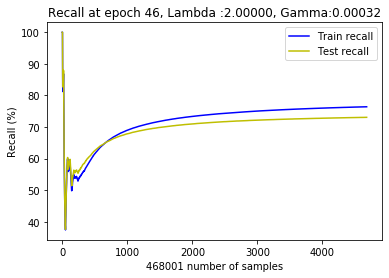

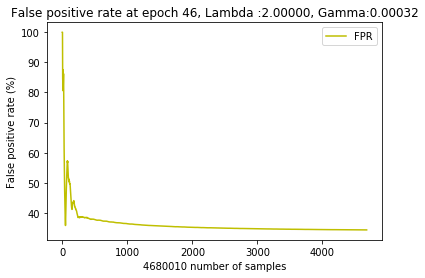

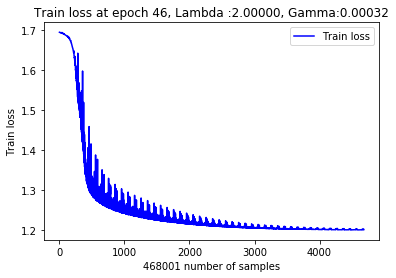

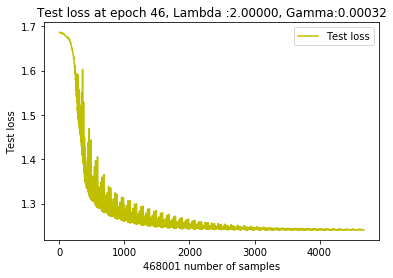

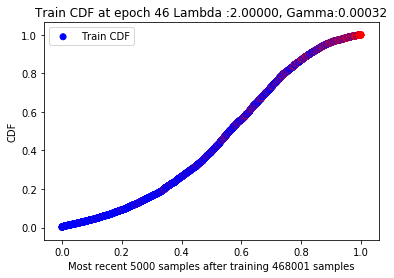

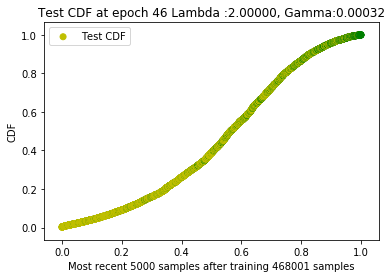

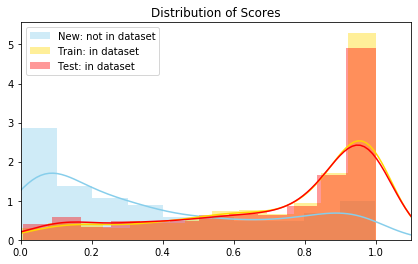

 80%|████████  | 8004/10000 [1:27:22<3:39:05,  6.59s/it]

New score:  0.38358477
Train score:  0.7488202
Test score:  0.7340642


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  47  with learning rate:  0.00028632084485111784


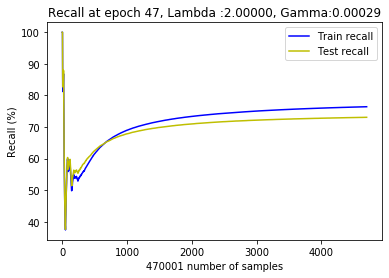

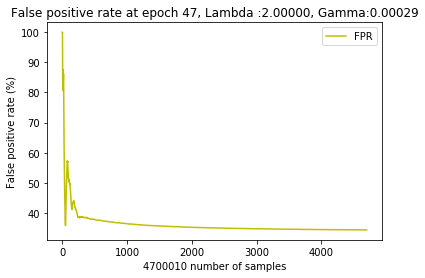

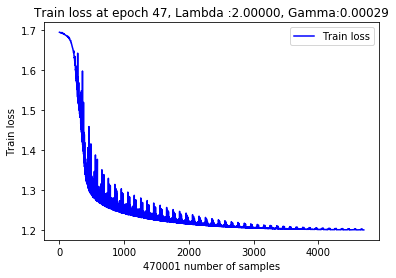

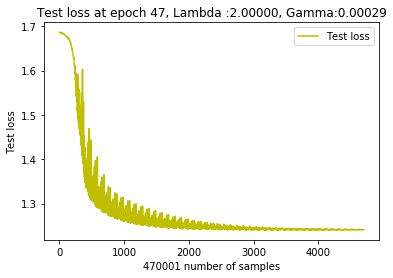

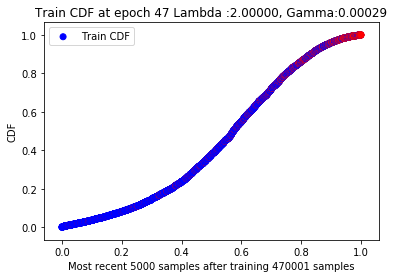

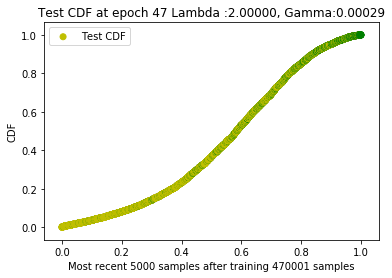

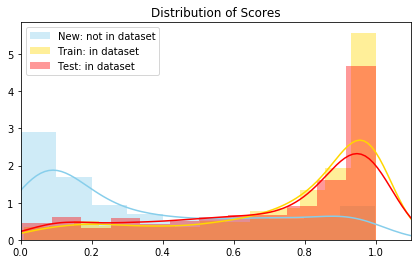

  0%|          | 4/10000 [01:01<120:15:24, 43.31s/it]

New score:  0.3479041
Train score:  0.7587035
Test score:  0.7238555


 20%|█▉        | 1999/10000 [21:50<07:10, 18.60it/s]   

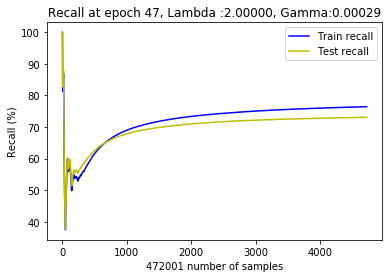

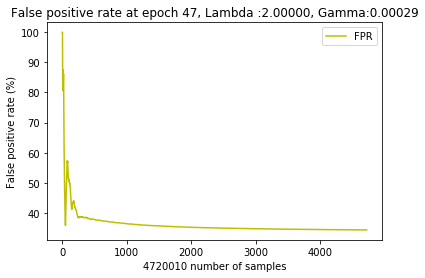

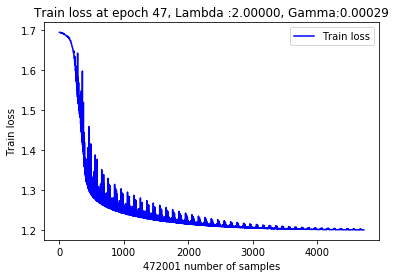

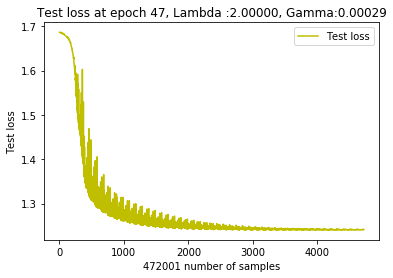

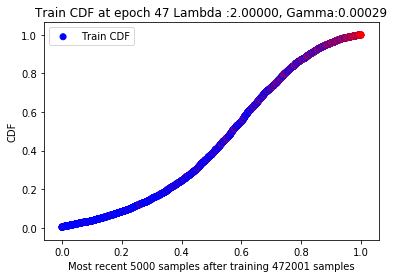

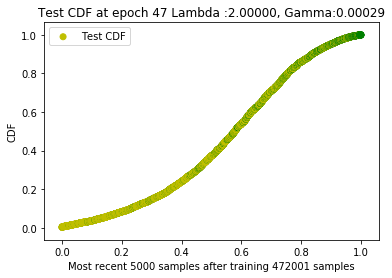

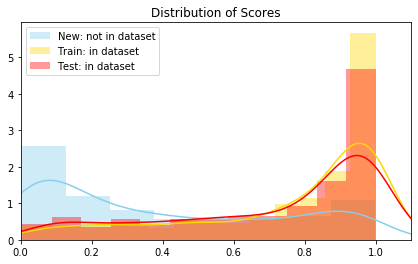

 20%|██        | 2003/10000 [22:32<14:10:41,  6.38s/it]

New score:  0.38500518
Train score:  0.7428918
Test score:  0.7248472


 40%|███▉      | 3999/10000 [43:10<04:50, 20.66it/s]   

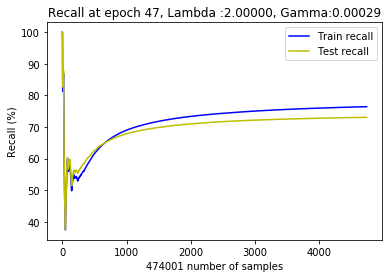

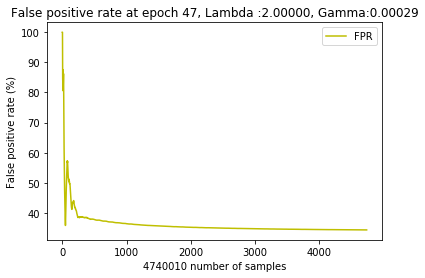

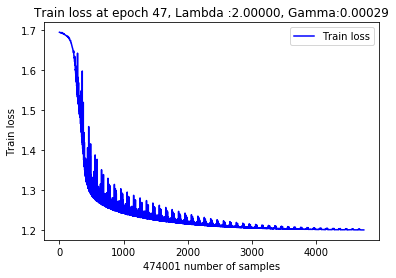

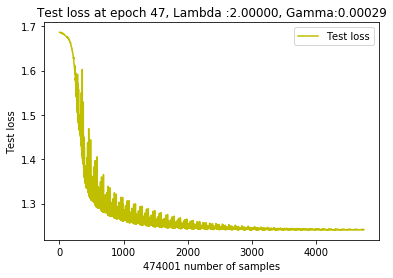

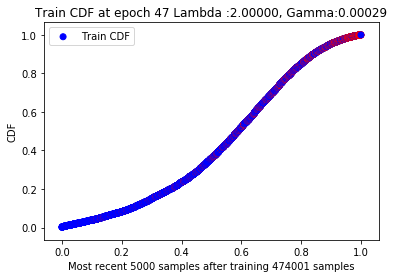

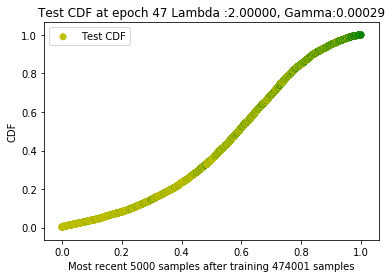

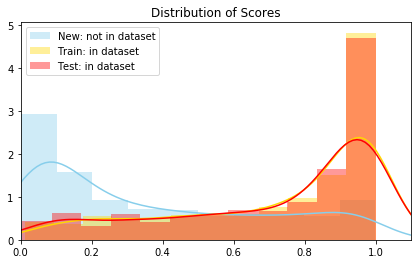

 40%|████      | 4003/10000 [43:55<10:54:52,  6.55s/it]

New score:  0.34910017
Train score:  0.738358
Test score:  0.72552425


 60%|█████▉    | 5999/10000 [1:04:20<02:59, 22.35it/s]  

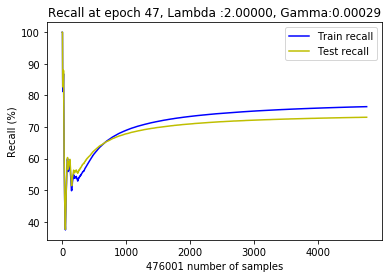

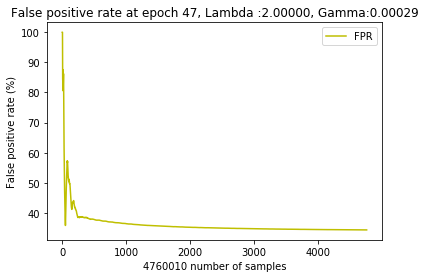

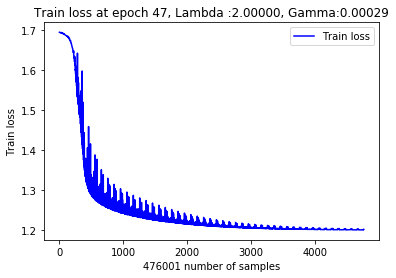

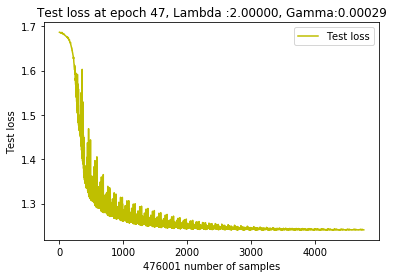

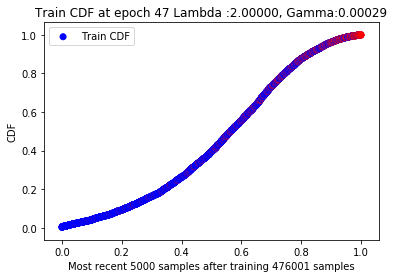

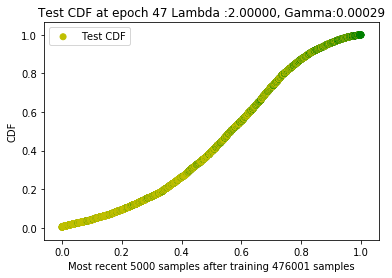

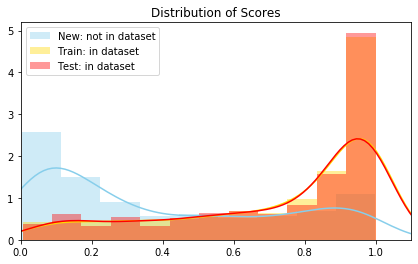

 60%|██████    | 6003/10000 [1:05:10<7:10:30,  6.46s/it] 

New score:  0.38765785
Train score:  0.7278075
Test score:  0.7383841


 80%|███████▉  | 7998/10000 [1:26:00<01:43, 19.42it/s]   

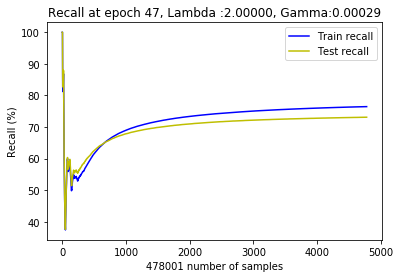

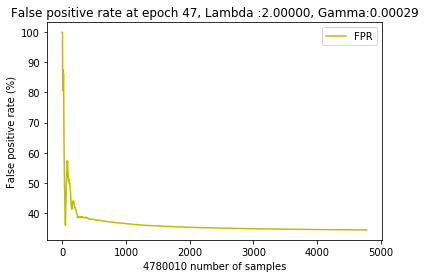

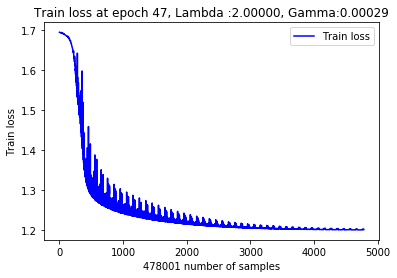

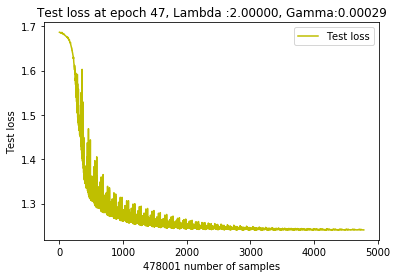

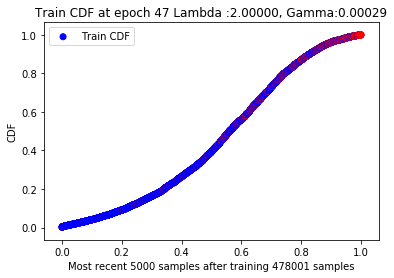

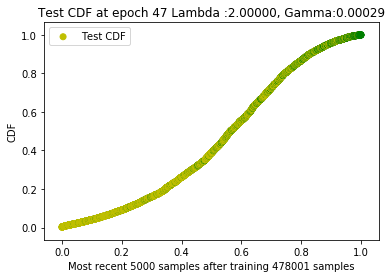

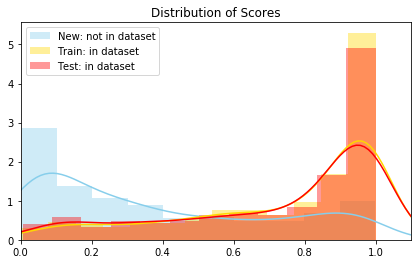

 80%|████████  | 8005/10000 [1:26:51<2:24:59,  4.36s/it]

New score:  0.38359725
Train score:  0.74898356
Test score:  0.7341699


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  48  with learning rate:  0.00025768876036600606


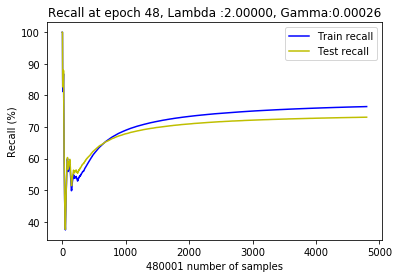

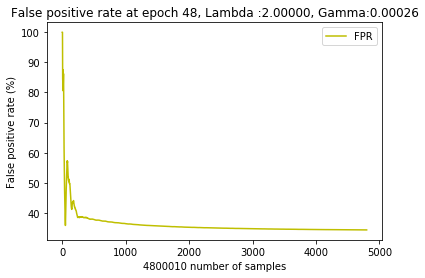

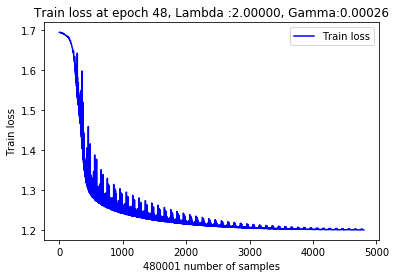

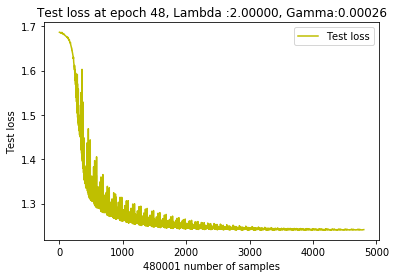

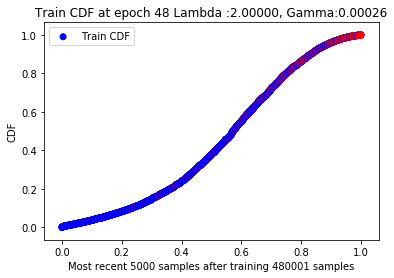

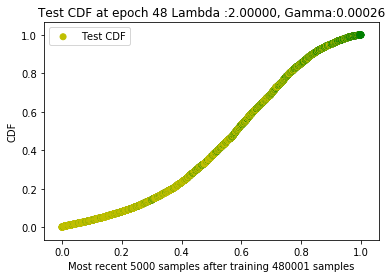

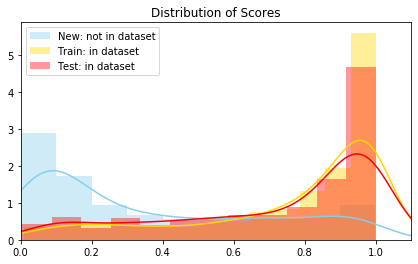

  0%|          | 3/10000 [01:00<117:40:48, 42.38s/it]

New score:  0.34863478
Train score:  0.7593688
Test score:  0.7245254


 20%|██        | 2000/10000 [21:30<07:44, 17.23it/s]   

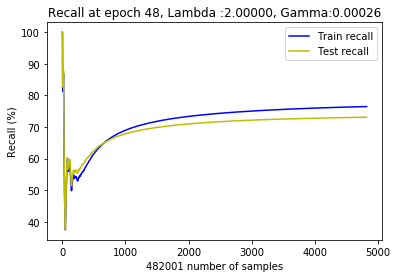

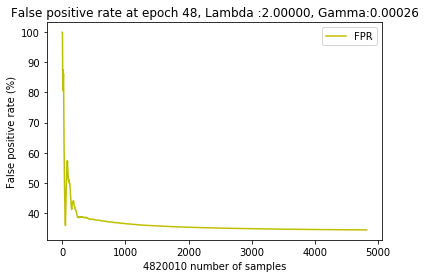

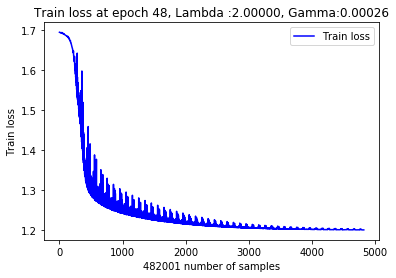

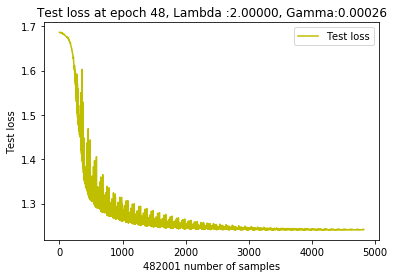

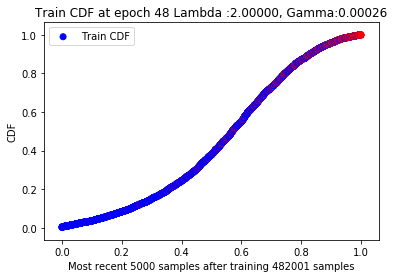

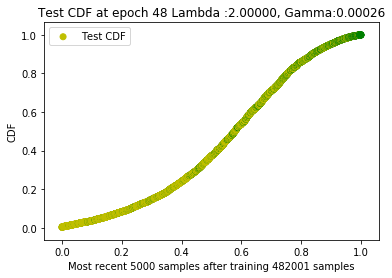

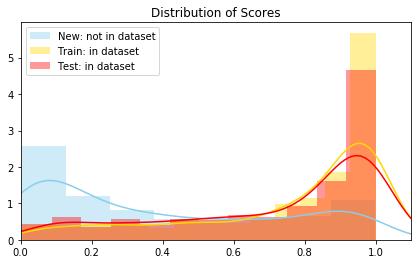

 20%|██        | 2003/10000 [22:21<29:16:58, 13.18s/it]

New score:  0.38499078
Train score:  0.7430111
Test score:  0.7249352


 40%|████      | 4000/10000 [43:00<05:39, 17.68it/s]   

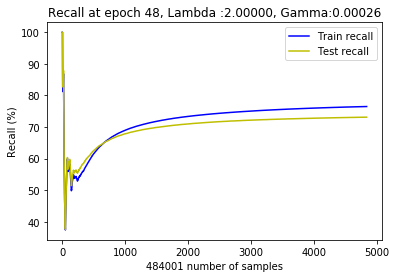

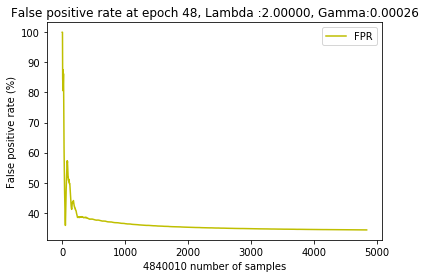

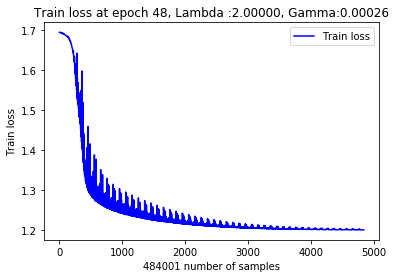

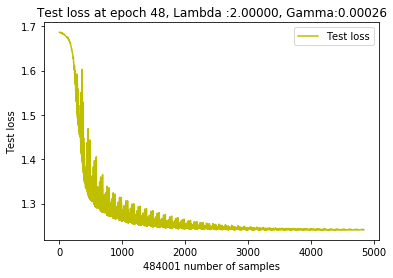

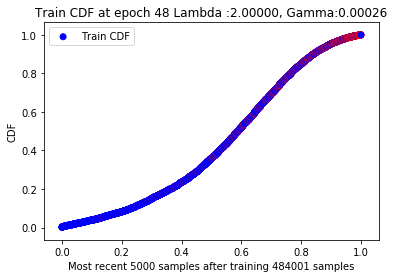

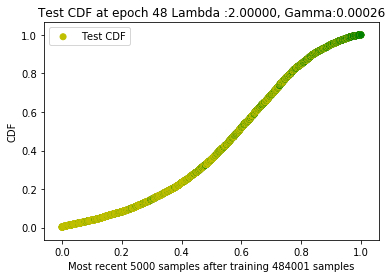

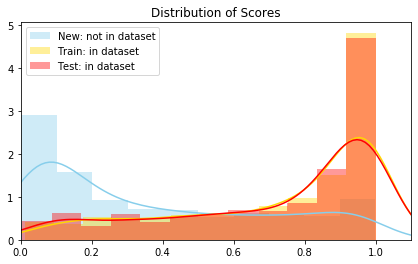

 40%|████      | 4003/10000 [43:43<21:51:24, 13.12s/it]

New score:  0.34943995
Train score:  0.73842764
Test score:  0.72558767


 60%|█████▉    | 5998/10000 [1:04:40<03:19, 20.06it/s]   

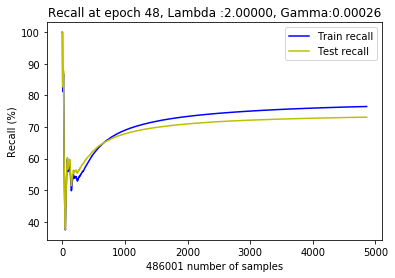

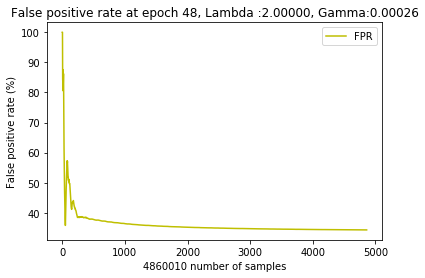

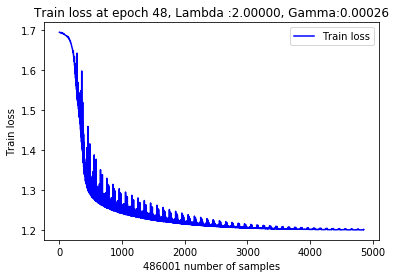

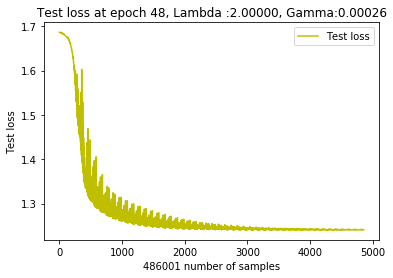

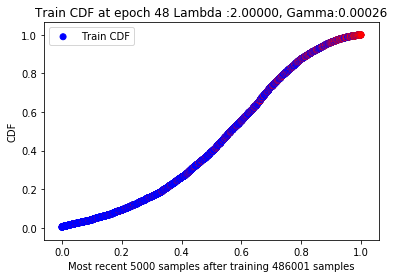

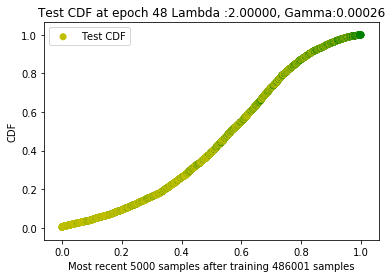

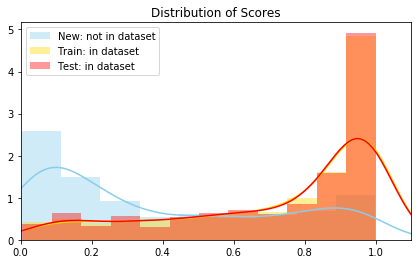

 60%|██████    | 6004/10000 [1:05:23<4:43:45,  4.26s/it]

New score:  0.38677382
Train score:  0.7269688
Test score:  0.7375164


 80%|████████  | 8000/10000 [1:26:00<01:38, 20.24it/s]   

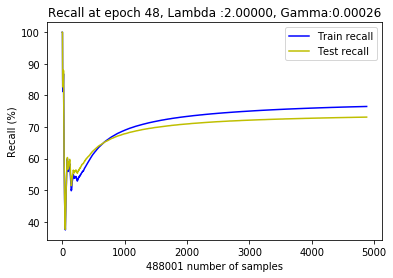

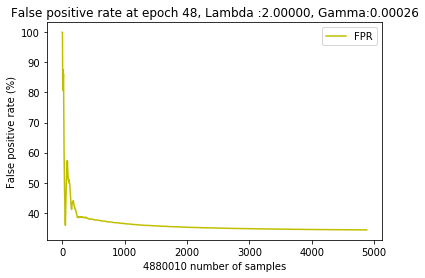

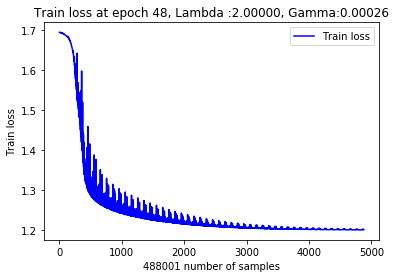

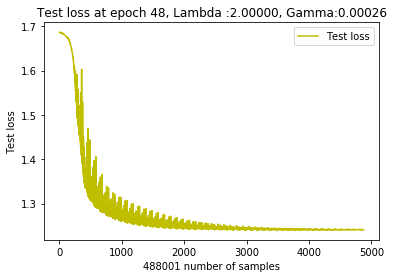

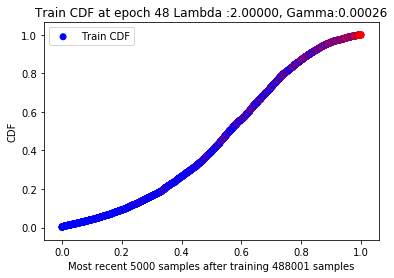

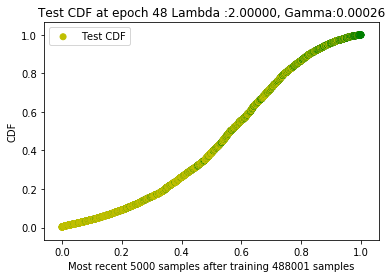

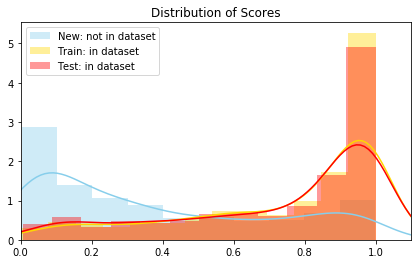

 80%|████████  | 8005/10000 [1:26:53<8:05:10, 14.59s/it] 

New score:  0.38353282
Train score:  0.7490468
Test score:  0.7341832


  0%|          | 0/10000 [00:00<?, ?it/s]

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth
Training Epoch:  49  with learning rate:  0.00023191988432940547


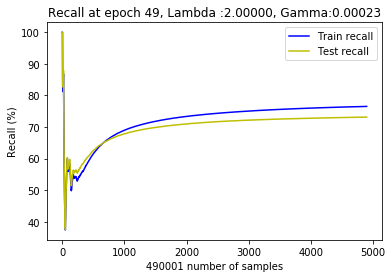

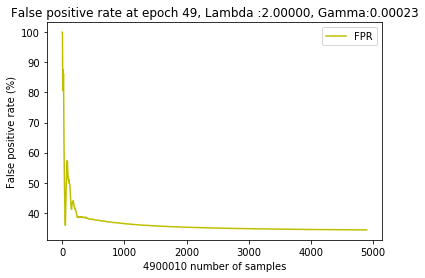

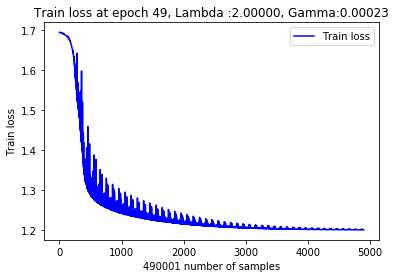

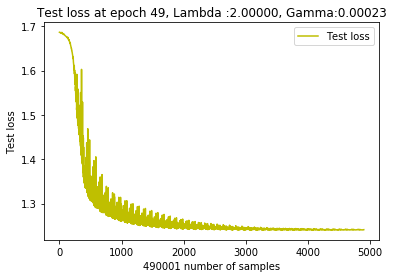

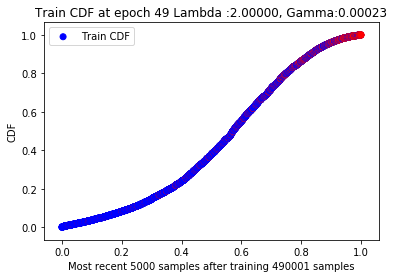

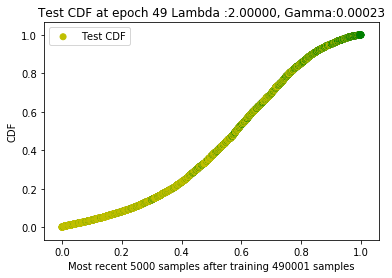

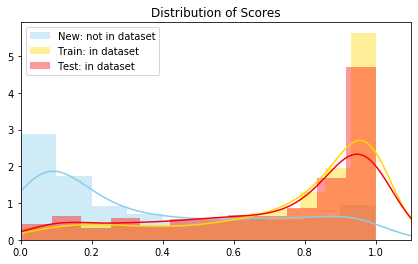

  0%|          | 3/10000 [01:01<119:14:35, 42.94s/it]

New score:  0.34935433
Train score:  0.7600033
Test score:  0.72516745


 20%|██        | 2000/10000 [21:30<08:03, 16.55it/s]   

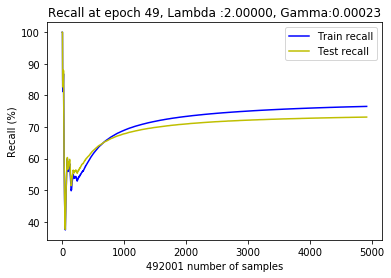

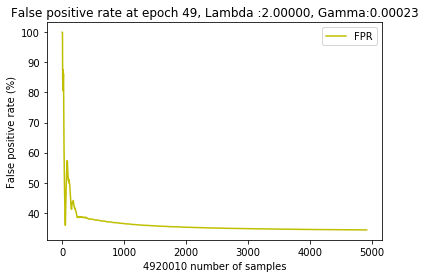

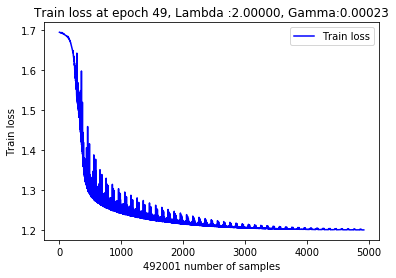

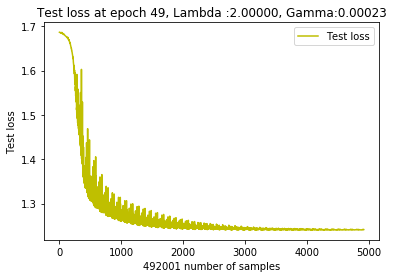

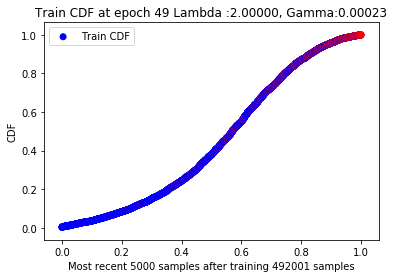

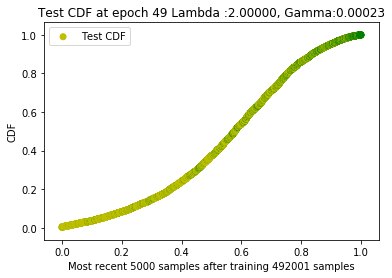

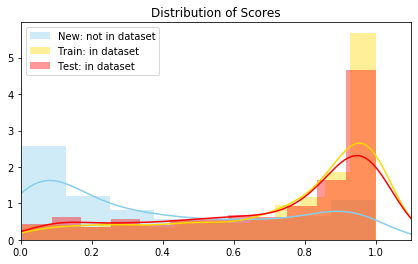

 20%|██        | 2005/10000 [22:12<28:06:56, 12.66s/it]

New score:  0.38505697
Train score:  0.74319494
Test score:  0.7250933


 40%|███▉      | 3998/10000 [42:20<03:39, 27.38it/s]   

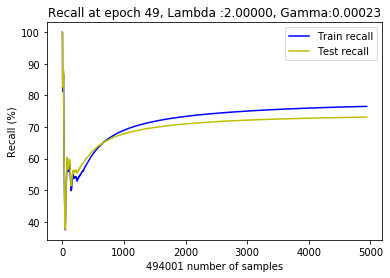

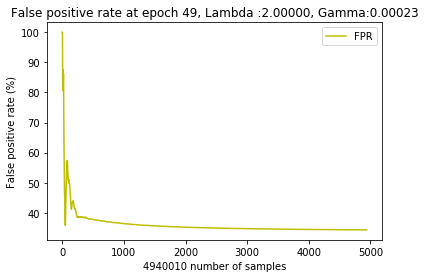

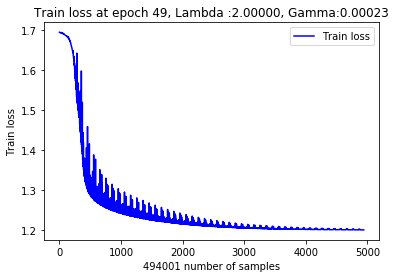

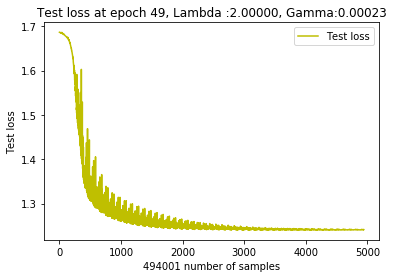

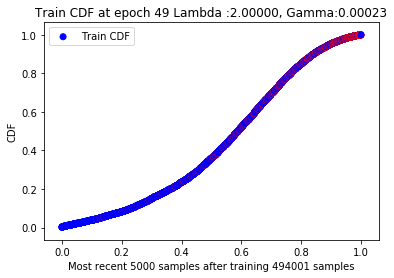

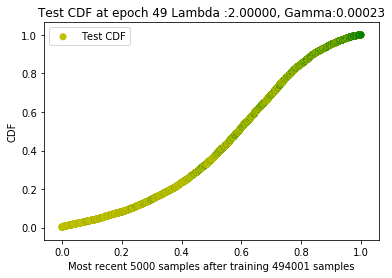

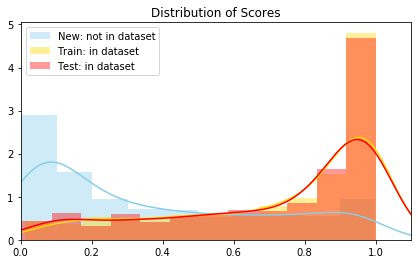

 40%|████      | 4002/10000 [43:03<7:26:04,  4.46s/it] 

New score:  0.34976062
Train score:  0.73851085
Test score:  0.72566587


 60%|█████▉    | 5999/10000 [1:03:30<02:28, 26.97it/s]   

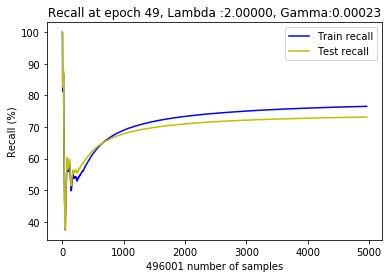

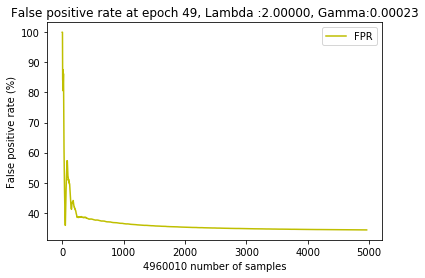

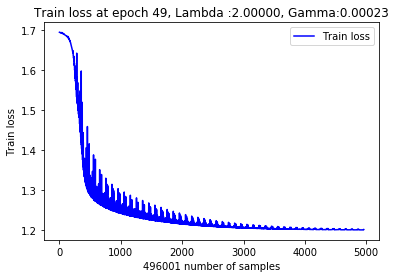

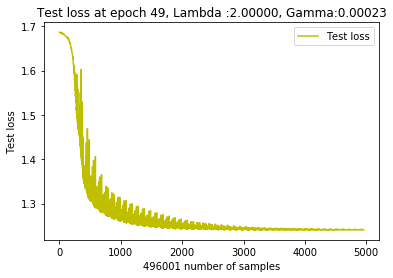

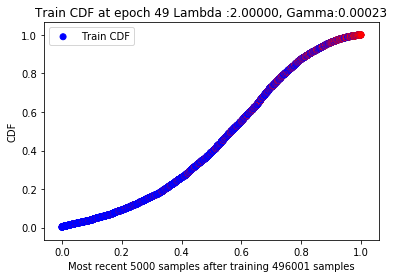

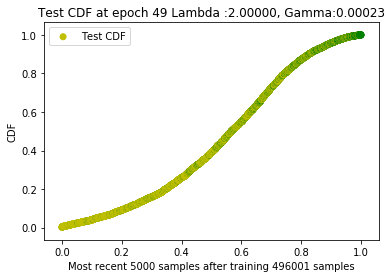

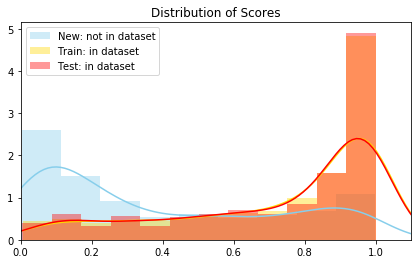

 60%|██████    | 6003/10000 [1:04:19<7:02:48,  6.35s/it] 

New score:  0.38590533
Train score:  0.7261697
Test score:  0.7366907


 80%|███████▉  | 7997/10000 [1:24:30<01:12, 27.55it/s]   

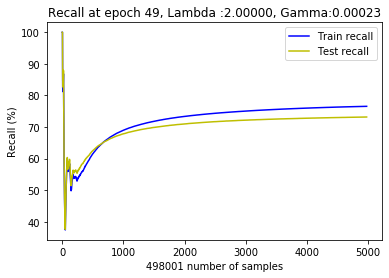

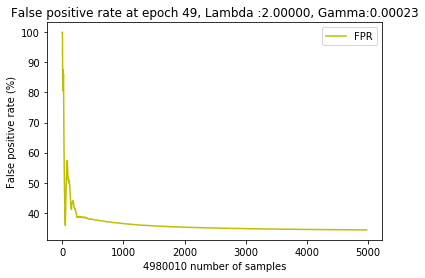

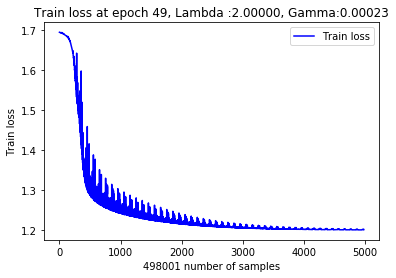

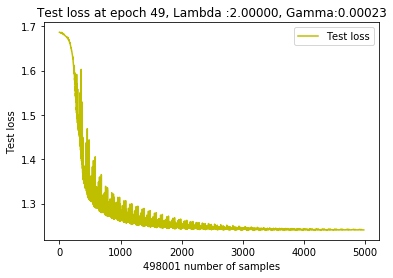

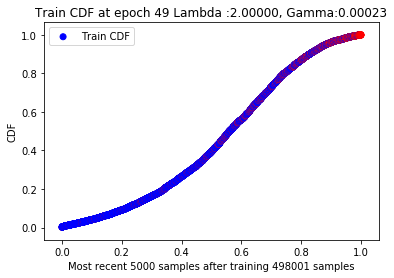

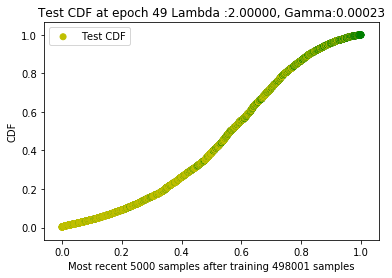

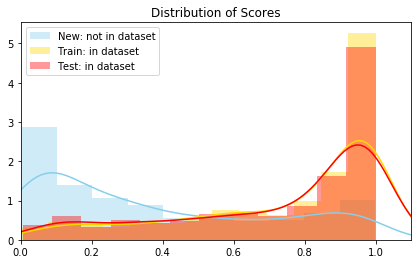

 80%|████████  | 8004/10000 [1:25:20<1:48:54,  3.27s/it]

New score:  0.3834028
Train score:  0.74903667
Test score:  0.73412937


100%|██████████| 10000/10000 [1:45:49<00:00,  1.57it/s] 

Saving to:  model_checkpoints/ConvNetSimpleBoost/05152020.pth


In [18]:
model = ConvNetSimpleBoost()
model.to(device)
model_name = model.name
checkpoint = None
save_path = 'model_checkpoints/%s/05152020.pth' %model_name

sgd(num_epochs=NUM_EPOCHS,
    batch_size=BATCH_SIZE,
    l=LAMBDA, 
    gamma=GAMMA,
    run_from_checkpoint=checkpoint, 
    save_checkpoints=save_path)